
# Neural ODE Training

This notebook performs training of latent NODE models on sine wave data.

In [1]:
%load_ext autoreload
%autoreload 2

In [1]:
import sys, os
sys.path.append(os.path.abspath('../src'))
sys.path.append(os.path.abspath('..'))

import torch
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader

device = torch.device('cuda:0')

import numpy as np
import matplotlib.pyplot as plt
from datetime import datetime
from tqdm import tqdm

# Custom lib
from utils import gpu, asnp

## Data Generation: Sine Family

The point of this data is to provide a "library" of possible sine waves to train our classifier with.

In [2]:
data_path = "../data/sine_data_2021-04-09 00:13:41.249505"
generator = torch.load(data_path)['generator']

In [3]:
train_time, train_data = generator.get_train_set()
val_time, val_data = generator.get_val_set()

train_data = train_data.reshape(len(train_data), -1, 1)
val_data = val_data.reshape(len(val_data), -1, 1)

train_data_tt = gpu(train_data)
train_time_tt = gpu(train_time)

val_data_tt = gpu(val_data)
val_time_tt = gpu(val_time)

In [4]:
class SineSet(Dataset):
    def __init__(self, data, time):
        self.data = data
        self.time = time
    def __len__(self):
        return len(self.data)
    def __getitem__(self, idx):
        return self.data[idx], self.time
    
train_dataset = SineSet(train_data_tt, train_time_tt)
val_dataset = SineSet(val_data_tt, val_time_tt)

train_loader = DataLoader(train_dataset, batch_size = 256, shuffle=True)
val_loader = DataLoader(train_dataset, batch_size = len(val_dataset))

# Training loop

In [5]:
from model import LatentNeuralODEBuilder

model_args = {
    'obs_dim': 1,
    'rec_latent_dim': 8,
    'node_latent_dim': 4,
    
    'rec_gru_unit': 100,
    'rec_node_hidden': 100,
    'rec_node_layer': 2,
    'rec_node_act': 'Tanh',
    
    'latent_node_hidden': 100,
    'latent_node_layer': 2,
    'latent_node_act': 'Tanh',
    
    'dec_type': 'NN',
    'dec_hidden': 100,
    'dec_layer': 1,
    'dec_act': 'ReLU',
}

elbo_type = 'iwae'

base_model = LatentNeuralODEBuilder(**model_args)
model = base_model.build_latent_node(elbo_type).to(device)

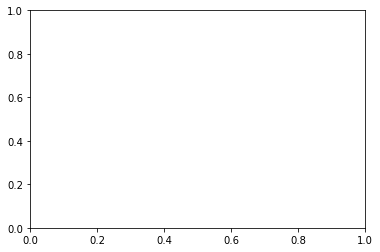

In [6]:
from train import TrainingLoop
from visualize_sine import plot_training_sine

main = TrainingLoop(model, train_loader, val_loader, plot_training_sine)

In [10]:
from torch.optim.lr_scheduler import ExponentialLR

lr = 1e-3

parameters = (model.parameters())
optimizer = optim.Adamax(parameters, lr=lr)
scheduler = ExponentialLR(optimizer, 0.995)

In [11]:
train_args = {
    'max_epoch': 500,
    'l_std': 0.1,
    'clip_norm': 5,
    'model_atol': 1e-4,
    'model_rtol': 1e-3,
    'plt_args': {'n_plot': 2},
    'K': 5,
    'M': 1,
    'method': 'dopri5'
}

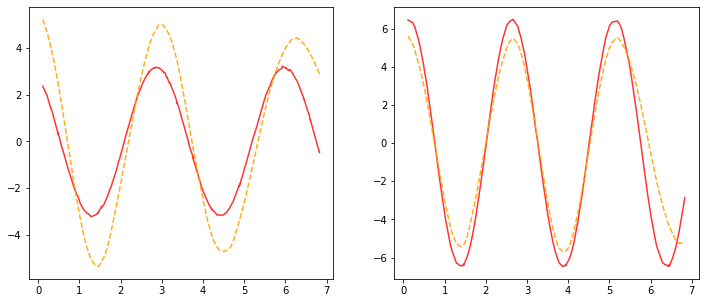

Current LR: [0.000995]


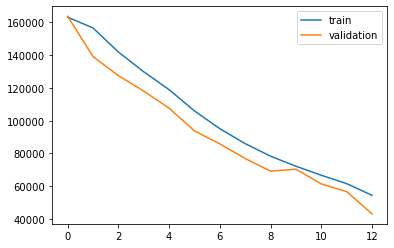

Epoch: 1, Train ELBO: -54487.548, Val ELBO: -154900.723


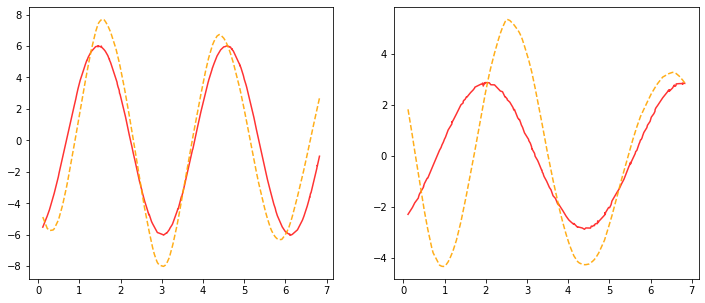

Current LR: [0.000990025]


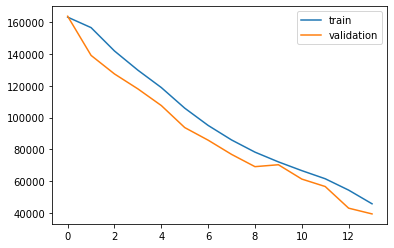

Epoch: 2, Train ELBO: -45899.789, Val ELBO: -153747.139


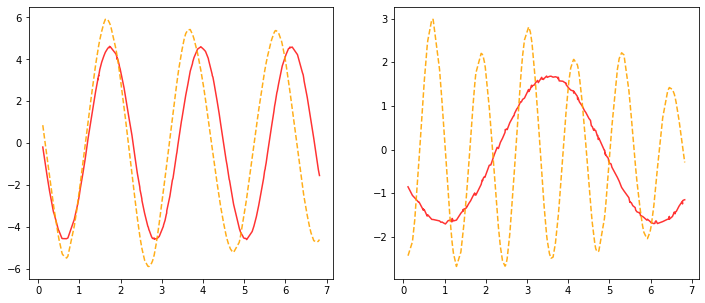

Current LR: [0.000985074875]


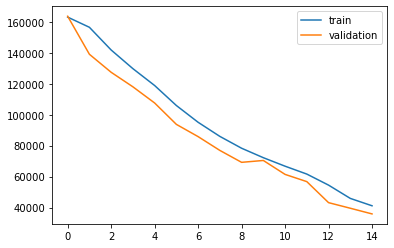

Epoch: 3, Train ELBO: -41131.491, Val ELBO: -152568.360


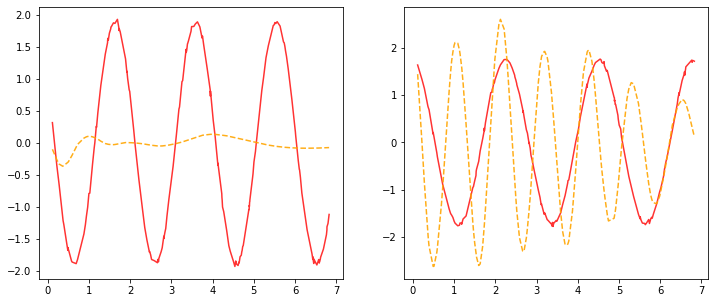

Current LR: [0.000980149500625]


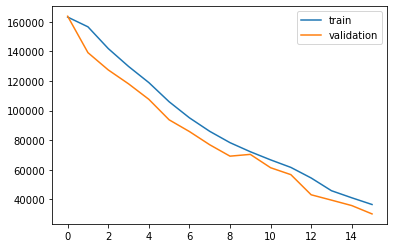

Epoch: 4, Train ELBO: -36589.899, Val ELBO: -151345.023


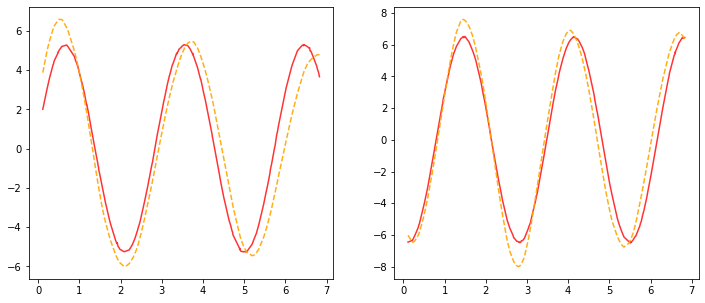

Current LR: [0.000975248753121875]


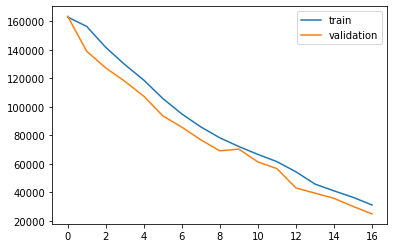

Epoch: 5, Train ELBO: -31212.077, Val ELBO: -150081.015


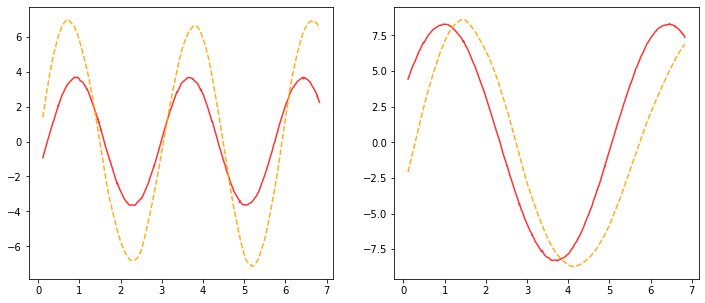

Current LR: [0.0009703725093562657]


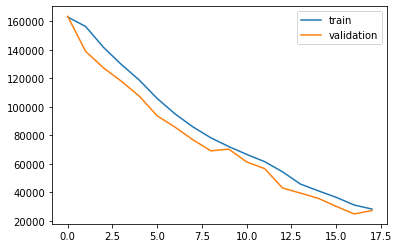

Epoch: 6, Train ELBO: -28332.743, Val ELBO: -148853.382


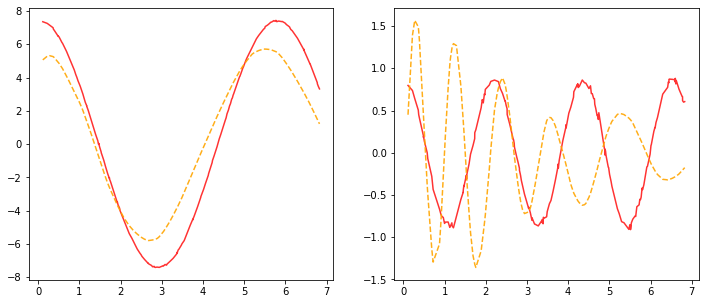

Current LR: [0.0009655206468094843]


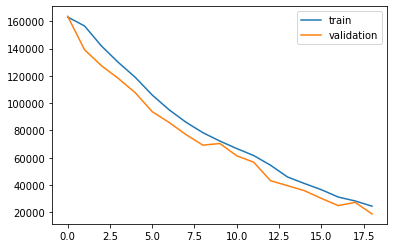

Epoch: 7, Train ELBO: -24519.892, Val ELBO: -147553.231


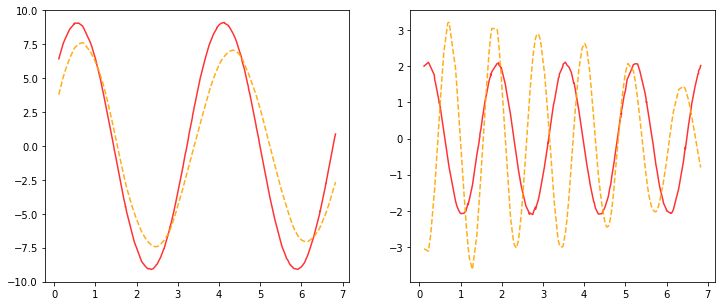

Current LR: [0.0009606930435754369]


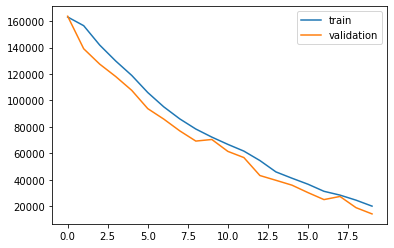

Epoch: 8, Train ELBO: -19992.795, Val ELBO: -146218.776


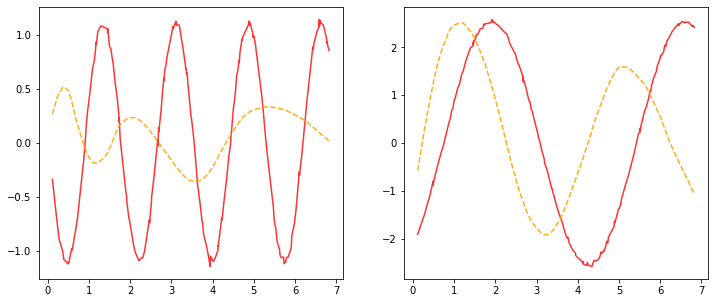

Current LR: [0.0009558895783575597]


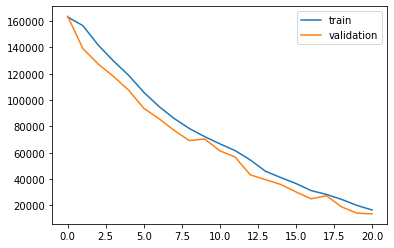

Epoch: 9, Train ELBO: -16495.253, Val ELBO: -144891.558


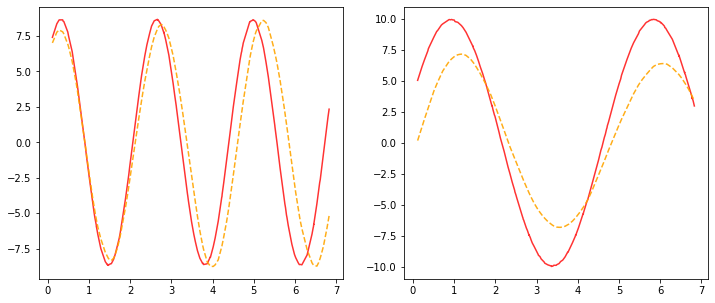

Current LR: [0.0009511101304657719]


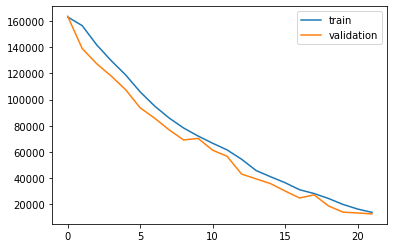

Epoch: 10, Train ELBO: -13916.749, Val ELBO: -143570.191


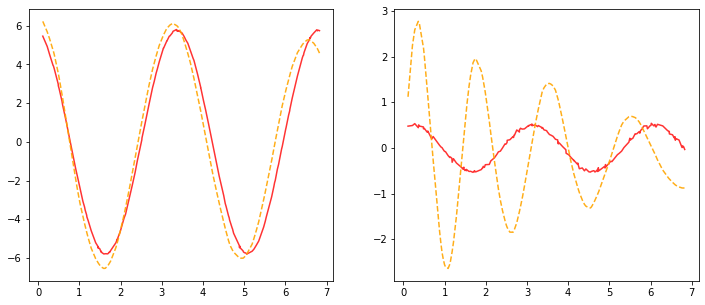

Current LR: [0.000946354579813443]


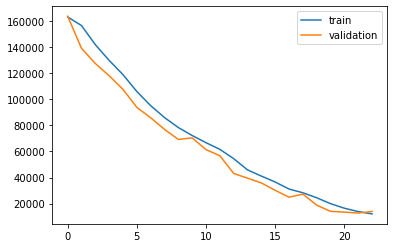

Epoch: 11, Train ELBO: -12125.265, Val ELBO: -142274.497


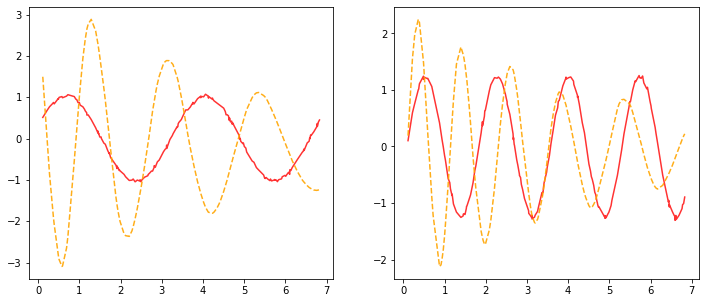

Current LR: [0.0009416228069143757]


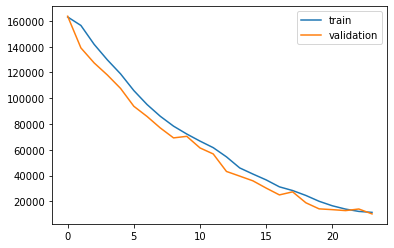

Epoch: 12, Train ELBO: -11378.326, Val ELBO: -140953.576


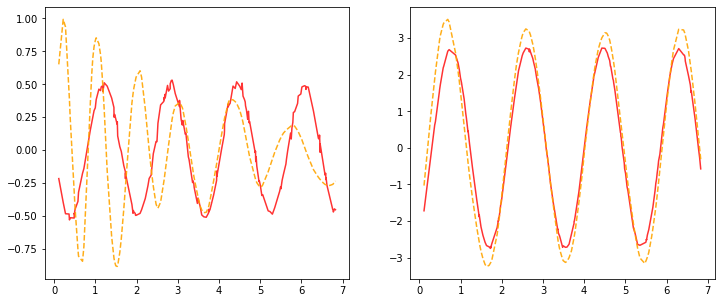

Current LR: [0.0009369146928798038]


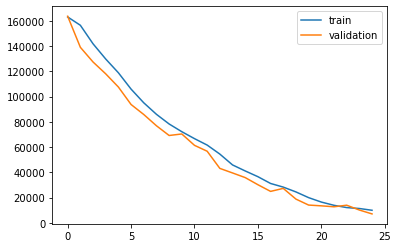

Epoch: 13, Train ELBO: -9990.663, Val ELBO: -139615.030


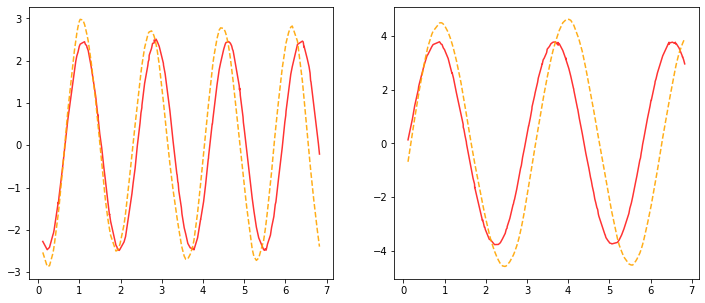

Current LR: [0.0009322301194154048]


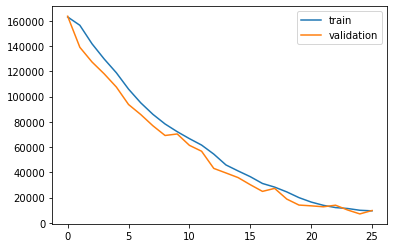

Epoch: 14, Train ELBO: -9533.127, Val ELBO: -138316.717


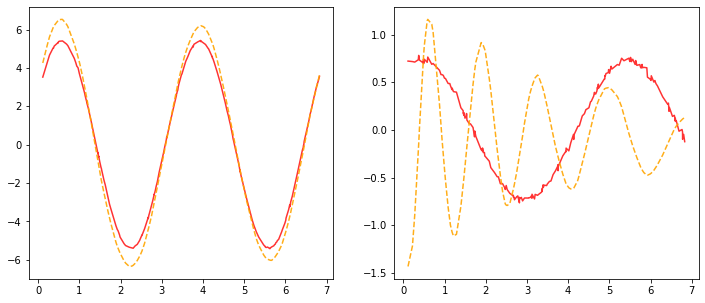

Current LR: [0.0009275689688183278]


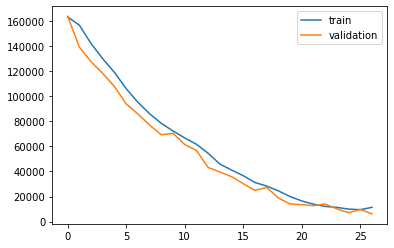

Epoch: 15, Train ELBO: -11406.378, Val ELBO: -136995.148


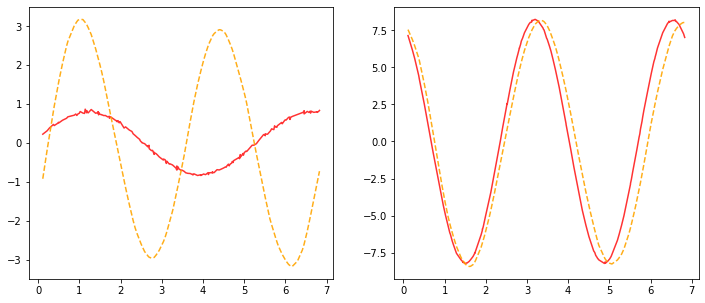

Current LR: [0.0009229311239742361]


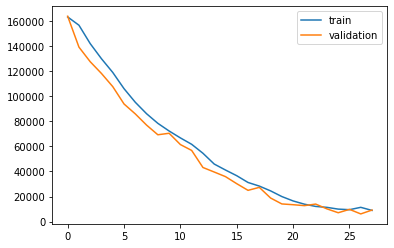

Epoch: 16, Train ELBO: -8944.348, Val ELBO: -135717.624


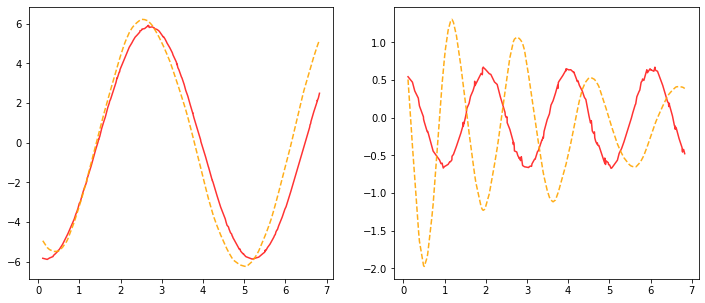

Current LR: [0.0009183164683543649]


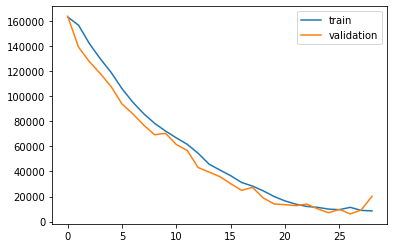

Epoch: 17, Train ELBO: -8575.408, Val ELBO: -134563.013


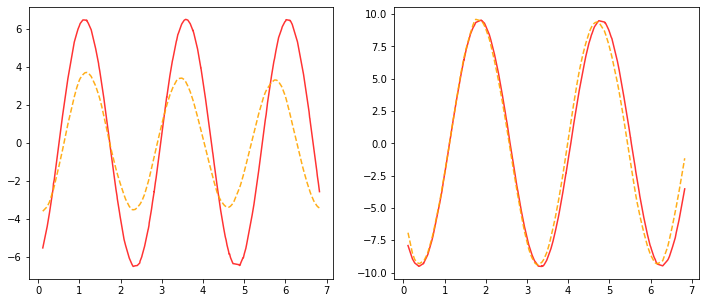

Current LR: [0.0009137248860125931]


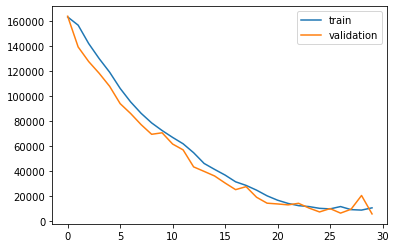

Epoch: 18, Train ELBO: -10374.767, Val ELBO: -133272.563


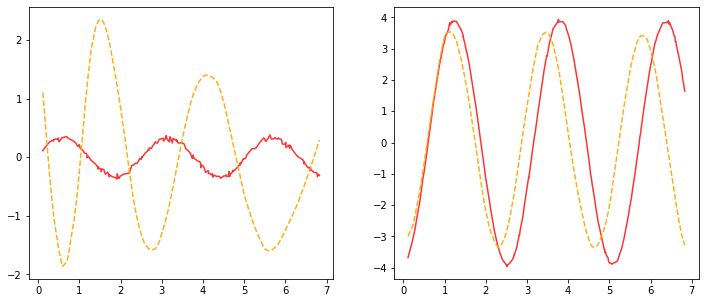

Current LR: [0.0009091562615825302]


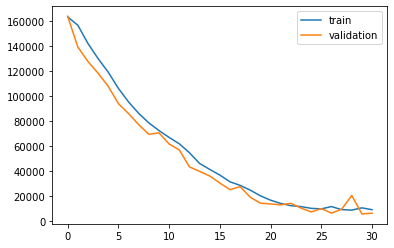

Epoch: 19, Train ELBO: -8903.402, Val ELBO: -132000.287


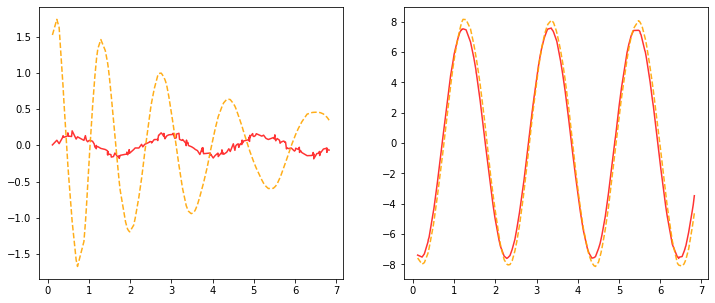

Current LR: [0.0009046104802746175]


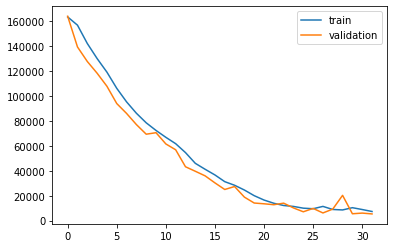

Epoch: 20, Train ELBO: -7332.860, Val ELBO: -130734.171


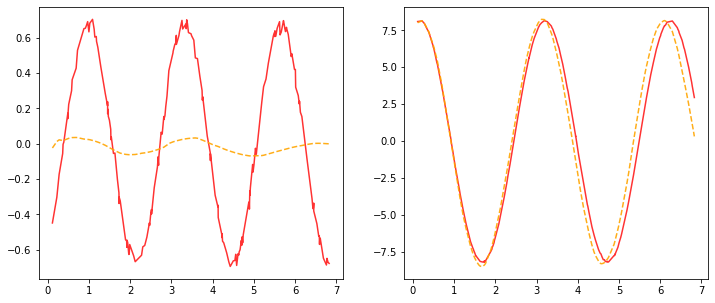

Current LR: [0.0009000874278732445]


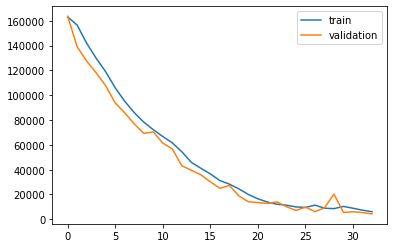

Epoch: 21, Train ELBO: -6070.955, Val ELBO: -129470.107


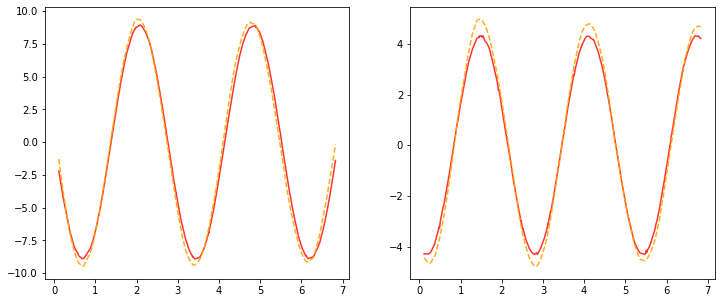

Current LR: [0.0008955869907338783]


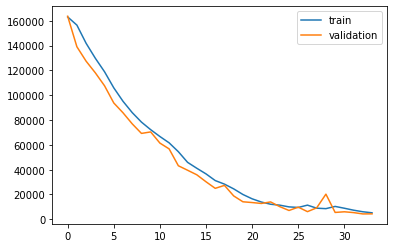

Epoch: 22, Train ELBO: -5226.421, Val ELBO: -128219.184


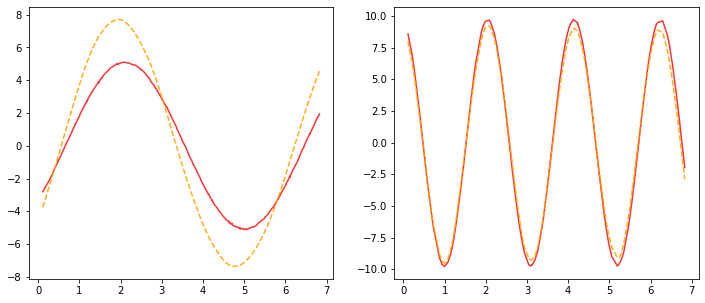

Current LR: [0.0008911090557802089]


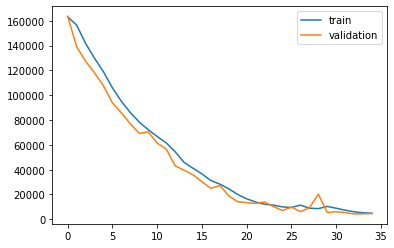

Epoch: 23, Train ELBO: -4900.874, Val ELBO: -126983.136


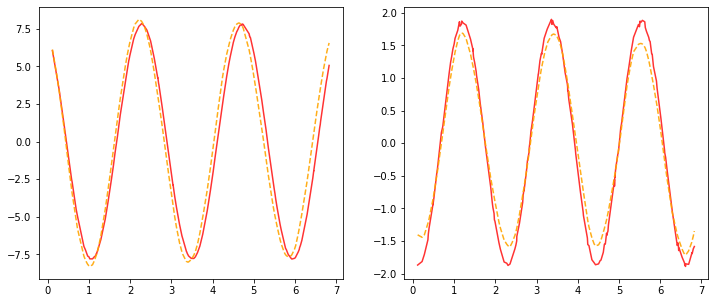

Current LR: [0.0008866535105013078]


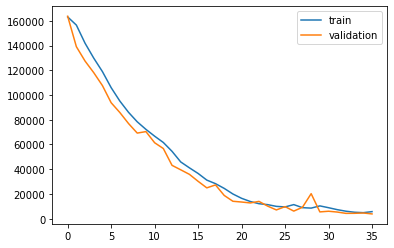

Epoch: 24, Train ELBO: -5728.807, Val ELBO: -125752.144


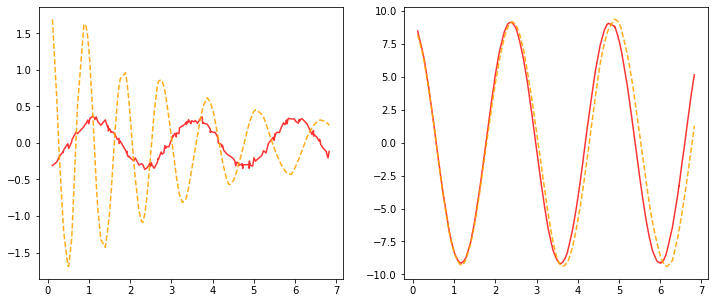

Current LR: [0.0008822202429488013]


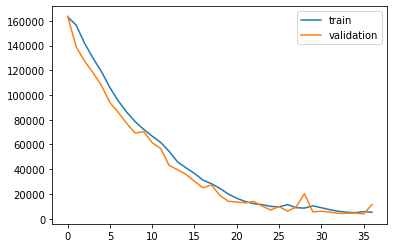

Epoch: 25, Train ELBO: -5212.061, Val ELBO: -124609.287


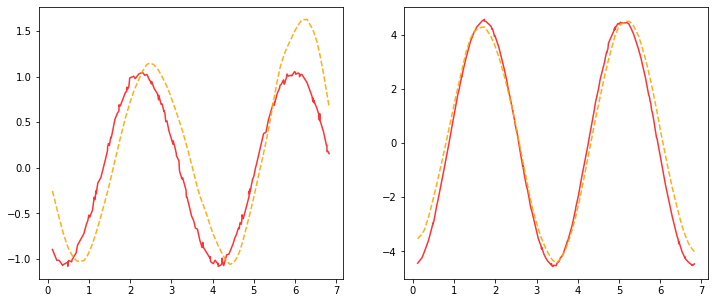

Current LR: [0.0008778091417340573]


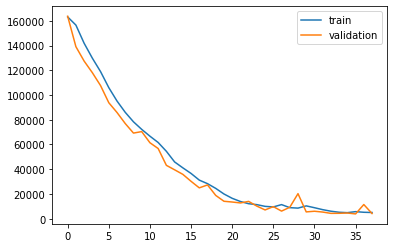

Epoch: 26, Train ELBO: -5022.925, Val ELBO: -123405.113


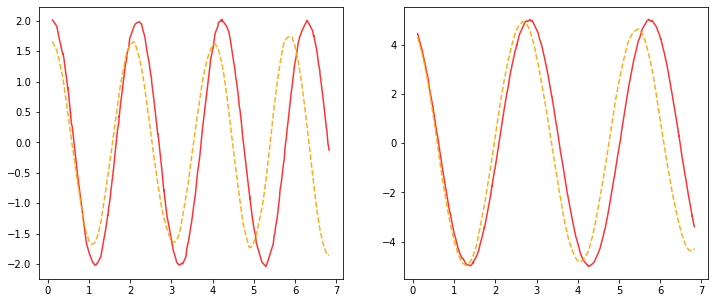

Current LR: [0.000873420096025387]


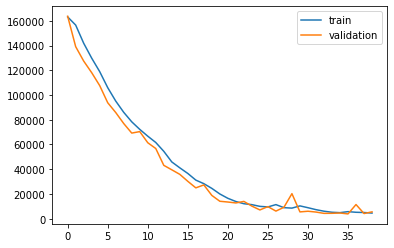

Epoch: 27, Train ELBO: -4566.984, Val ELBO: -122226.489


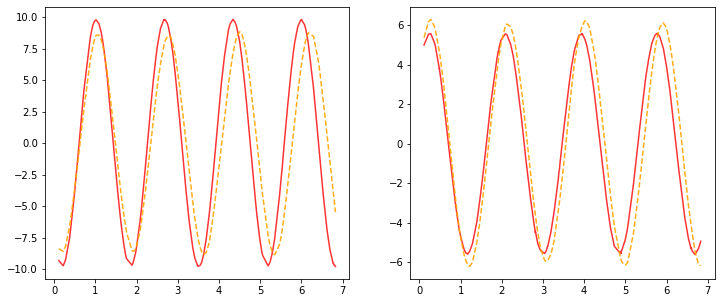

Current LR: [0.0008690529955452601]


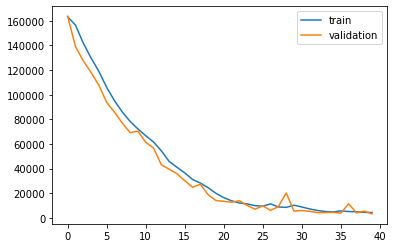

Epoch: 28, Train ELBO: -4413.553, Val ELBO: -121036.978


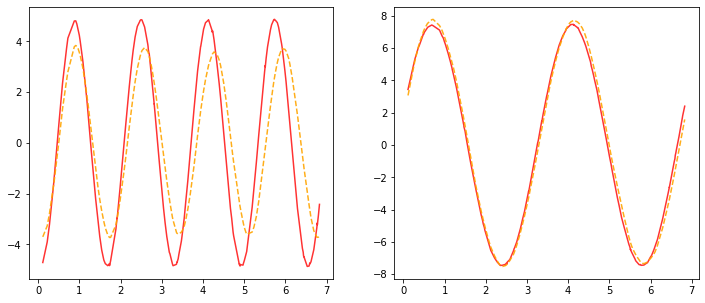

Current LR: [0.0008647077305675338]


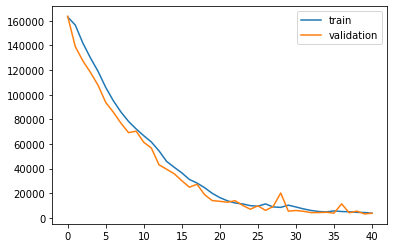

Epoch: 29, Train ELBO: -3826.449, Val ELBO: -119864.385


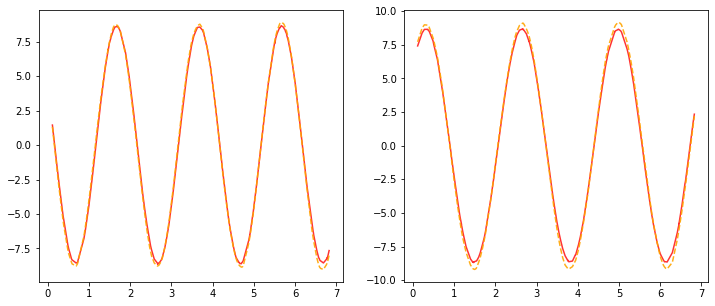

Current LR: [0.0008603841919146961]


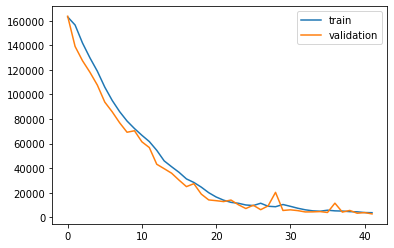

Epoch: 30, Train ELBO: -3716.561, Val ELBO: -118692.874


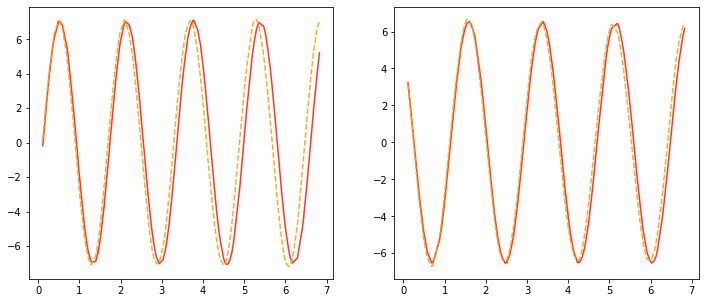

Current LR: [0.0008560822709551226]


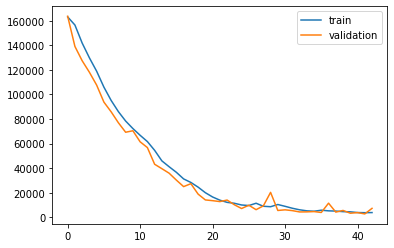

Epoch: 31, Train ELBO: -3810.631, Val ELBO: -117578.444


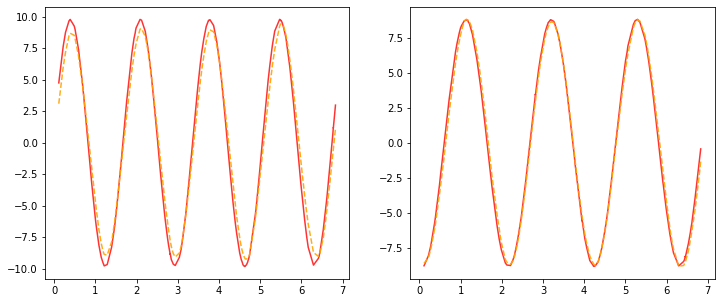

Current LR: [0.000851801859600347]


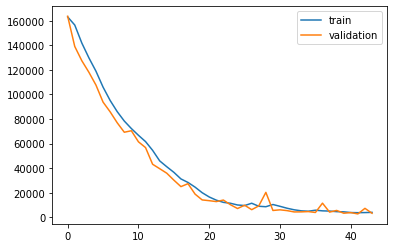

Epoch: 32, Train ELBO: -3957.264, Val ELBO: -116435.001


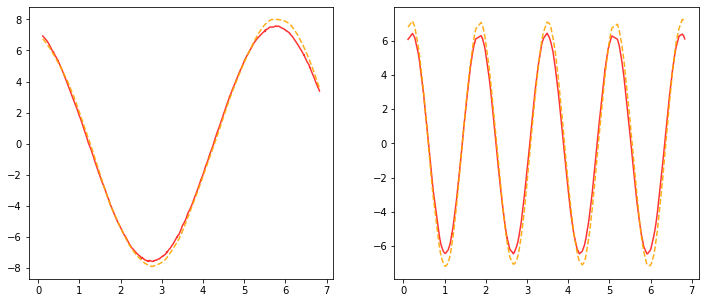

Current LR: [0.0008475428503023452]


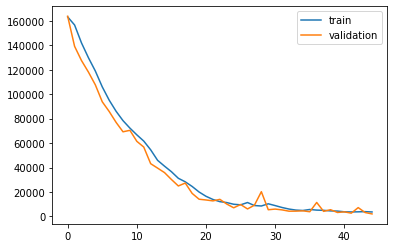

Epoch: 33, Train ELBO: -3701.965, Val ELBO: -115291.641


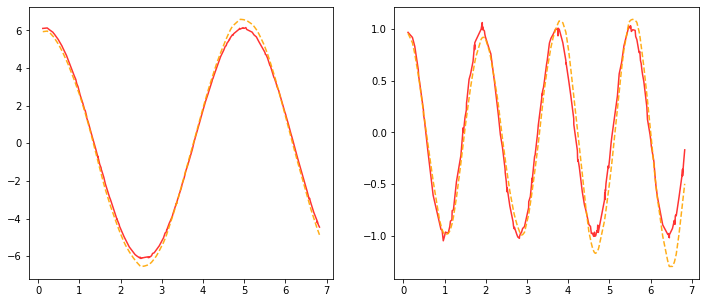

Current LR: [0.0008433051360508335]


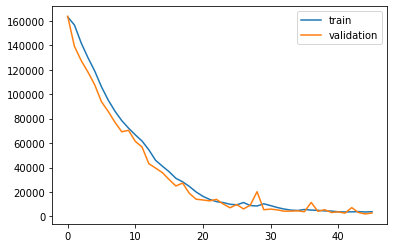

Epoch: 34, Train ELBO: -3884.181, Val ELBO: -114167.269


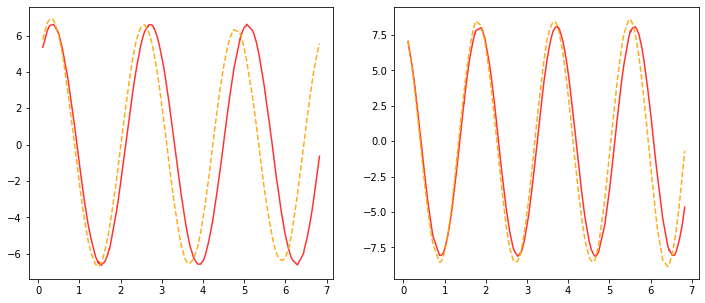

Current LR: [0.0008390886103705794]


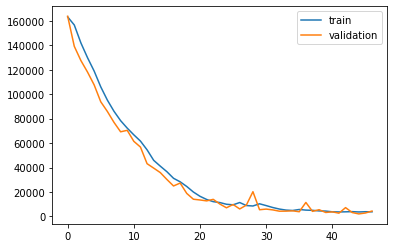

Epoch: 35, Train ELBO: -3820.668, Val ELBO: -113070.010


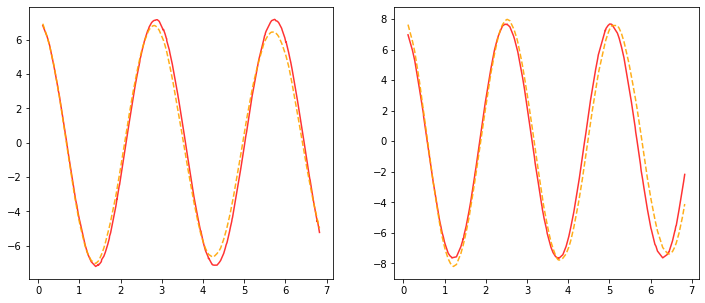

Current LR: [0.0008348931673187264]


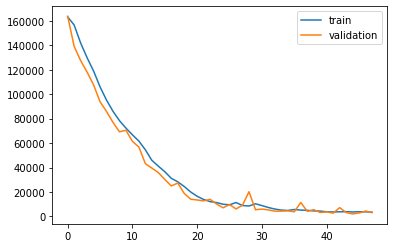

Epoch: 36, Train ELBO: -3526.887, Val ELBO: -111970.918


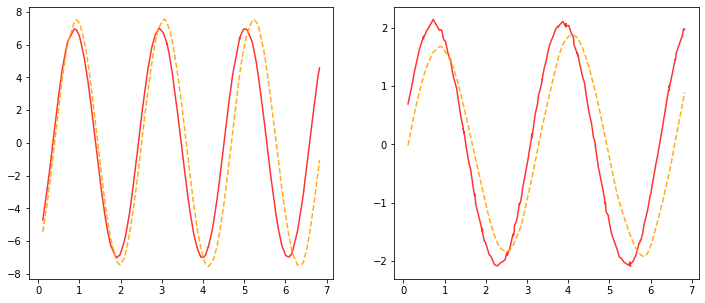

Current LR: [0.0008307187014821328]


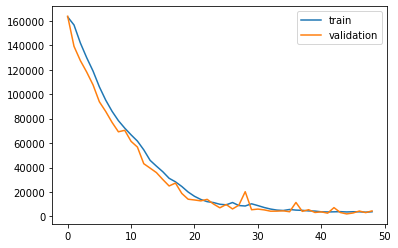

Epoch: 37, Train ELBO: -3840.378, Val ELBO: -110896.728


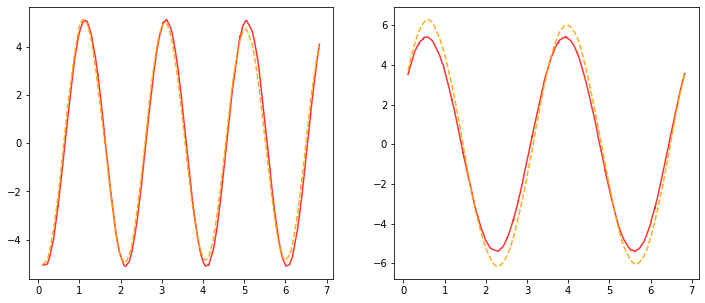

Current LR: [0.0008265651079747222]


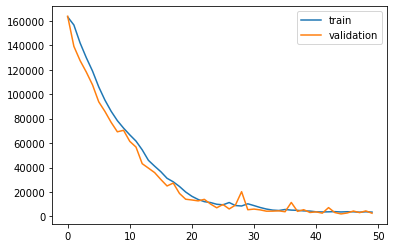

Epoch: 38, Train ELBO: -3576.238, Val ELBO: -109814.428


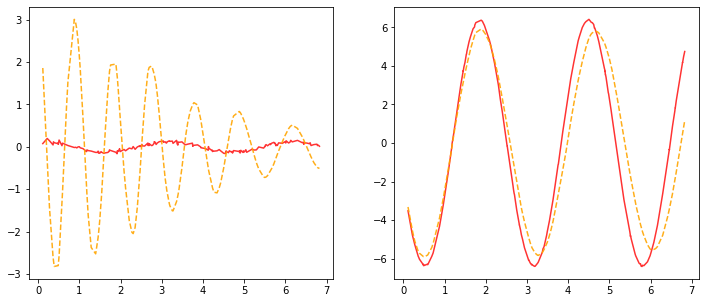

Current LR: [0.0008224322824348485]


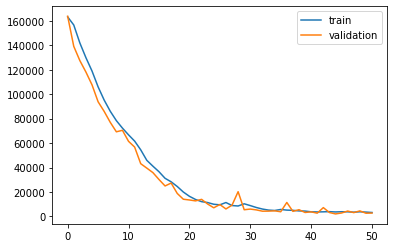

Epoch: 39, Train ELBO: -3256.819, Val ELBO: -108744.389


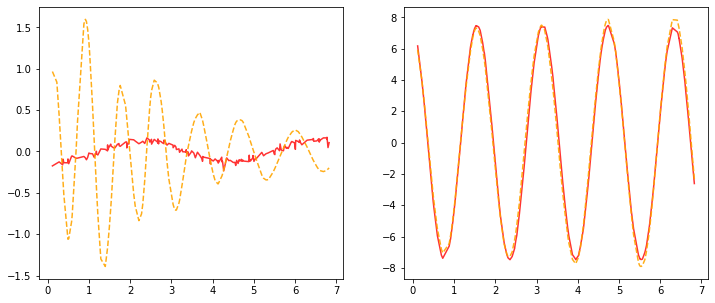

Current LR: [0.0008183201210226743]


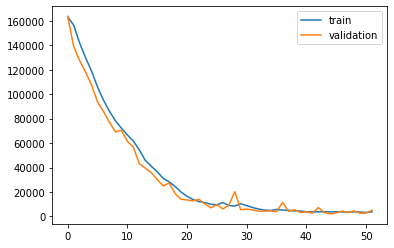

Epoch: 40, Train ELBO: -3829.888, Val ELBO: -107707.568


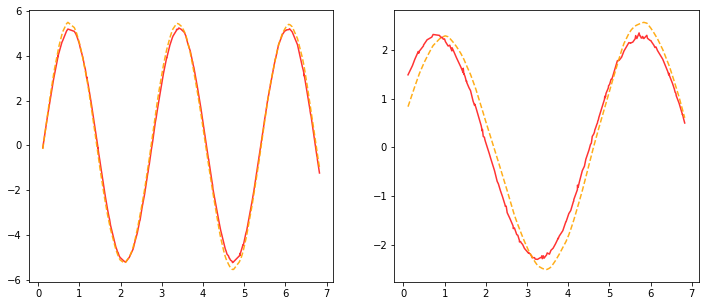

Current LR: [0.0008142285204175609]


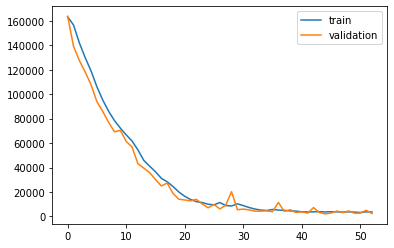

Epoch: 41, Train ELBO: -3662.398, Val ELBO: -106654.692


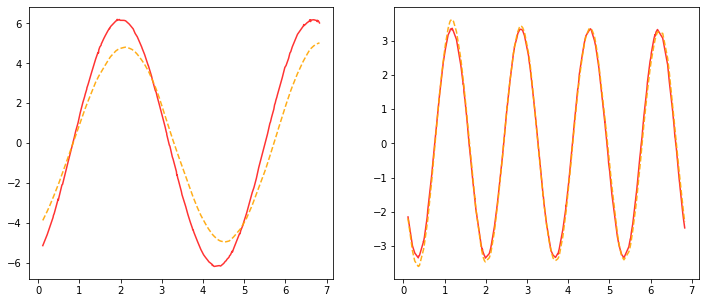

Current LR: [0.0008101573778154731]


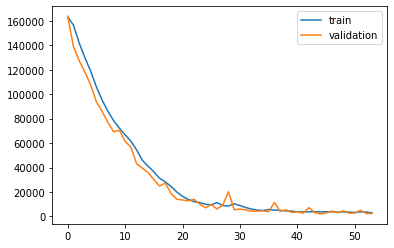

Epoch: 42, Train ELBO: -2884.014, Val ELBO: -105612.480


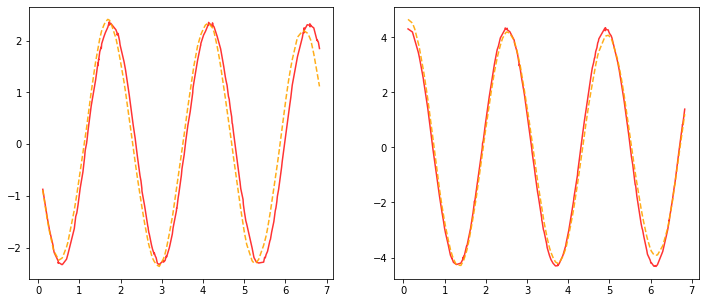

Current LR: [0.0008061065909263957]


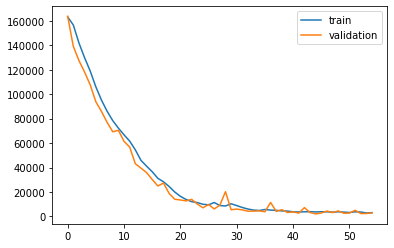

Epoch: 43, Train ELBO: -3159.943, Val ELBO: -104585.891


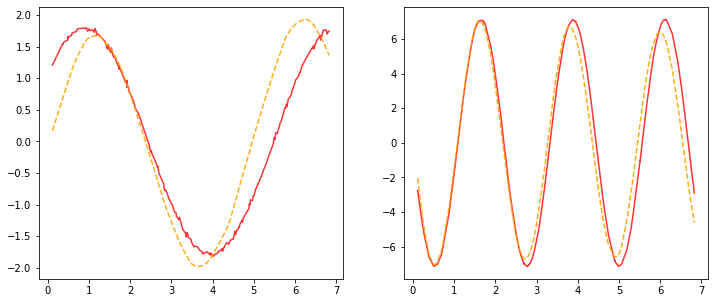

Current LR: [0.0008020760579717638]


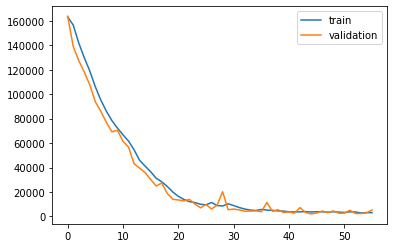

Epoch: 44, Train ELBO: -3110.376, Val ELBO: -103592.823


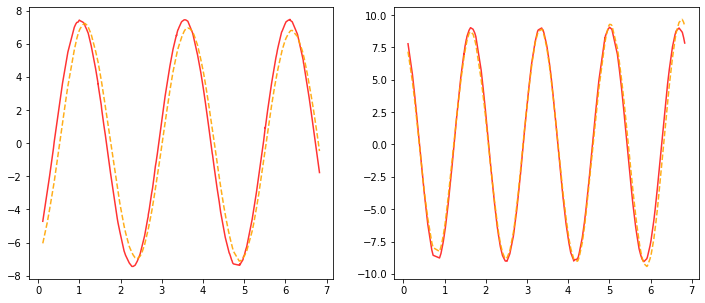

Current LR: [0.000798065677681905]


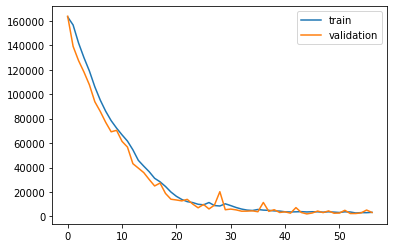

Epoch: 45, Train ELBO: -3385.561, Val ELBO: -102589.366


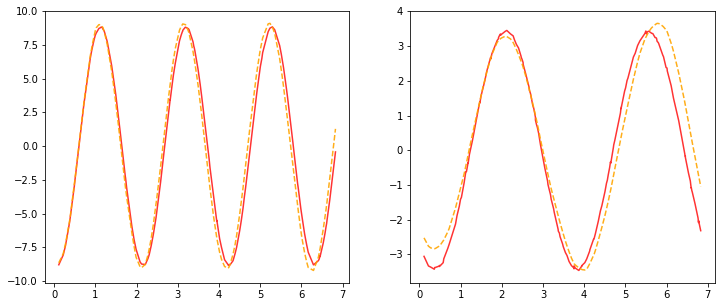

Current LR: [0.0007940753492934955]


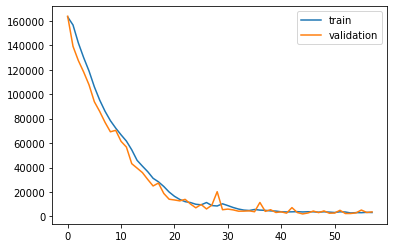

Epoch: 46, Train ELBO: -3235.359, Val ELBO: -101601.033


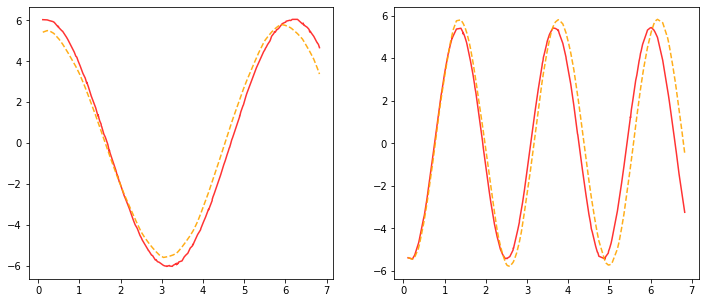

Current LR: [0.000790104972547028]


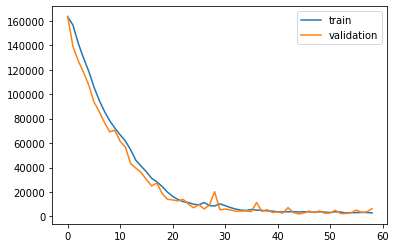

Epoch: 47, Train ELBO: -2941.125, Val ELBO: -100649.200


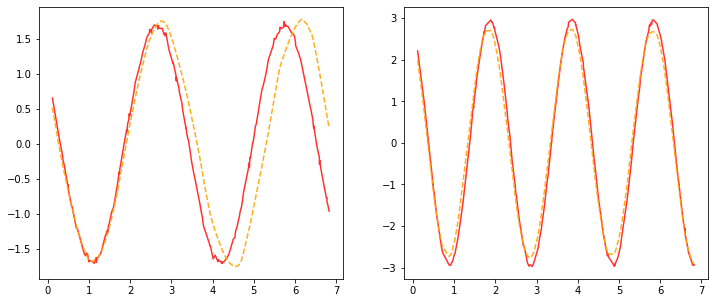

Current LR: [0.0007861544476842928]


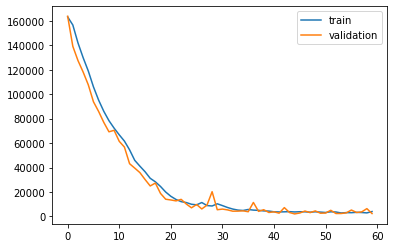

Epoch: 48, Train ELBO: -4035.950, Val ELBO: -99666.652


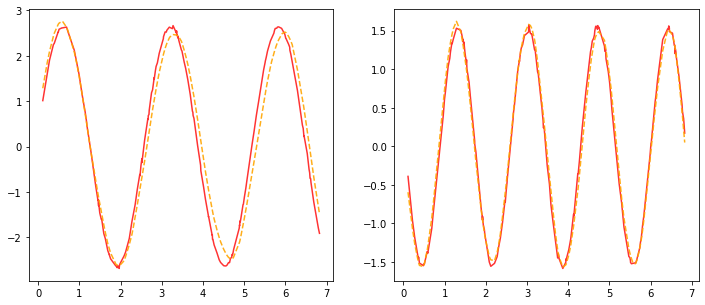

Current LR: [0.0007822236754458713]


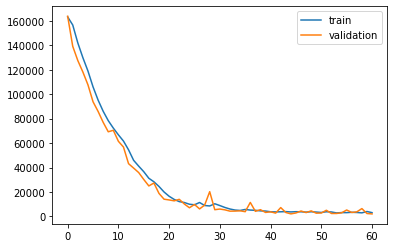

Epoch: 49, Train ELBO: -3121.327, Val ELBO: -98690.670


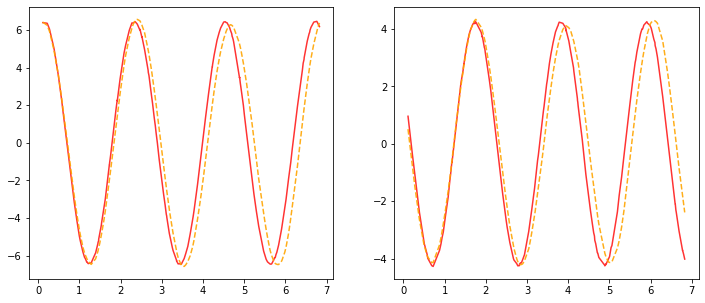

Current LR: [0.0007783125570686419]


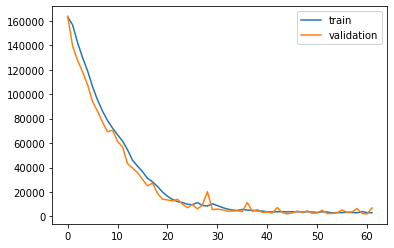

Epoch: 50, Train ELBO: -3055.224, Val ELBO: -97772.998


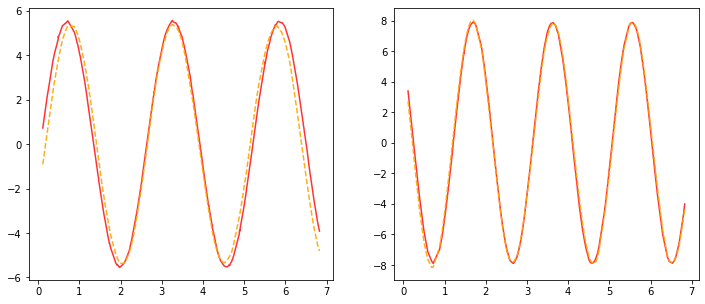

Current LR: [0.0007744209942832988]


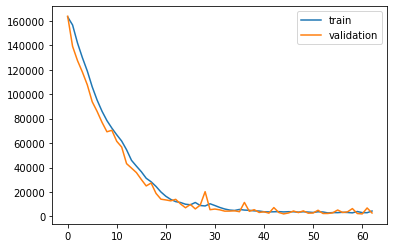

Epoch: 51, Train ELBO: -4443.233, Val ELBO: -96823.461


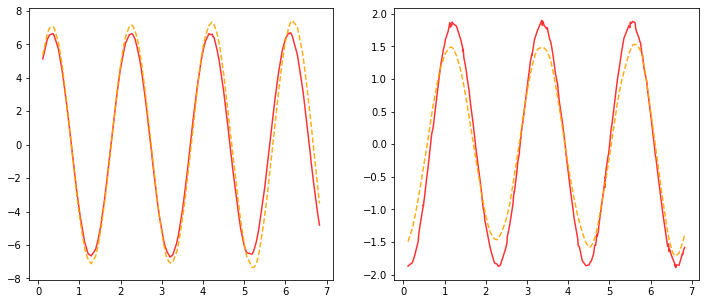

Current LR: [0.0007705488893118823]


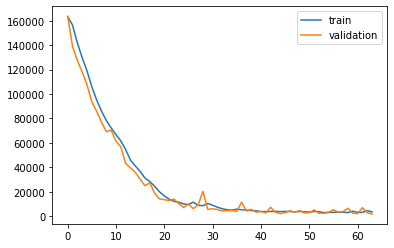

Epoch: 52, Train ELBO: -3511.603, Val ELBO: -95873.519


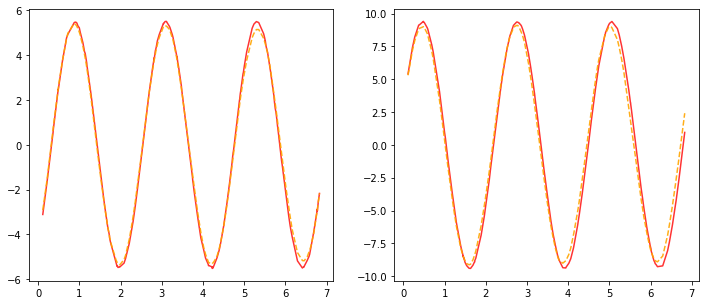

Current LR: [0.0007666961448653228]


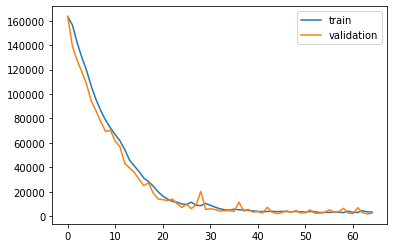

Epoch: 53, Train ELBO: -3359.731, Val ELBO: -94938.538


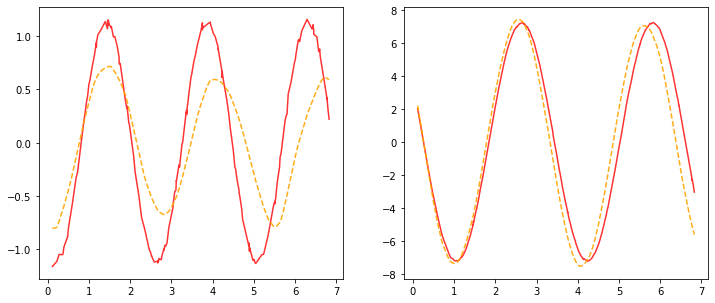

Current LR: [0.0007628626641409962]


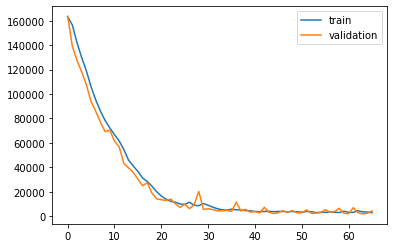

Epoch: 54, Train ELBO: -2849.175, Val ELBO: -94031.907


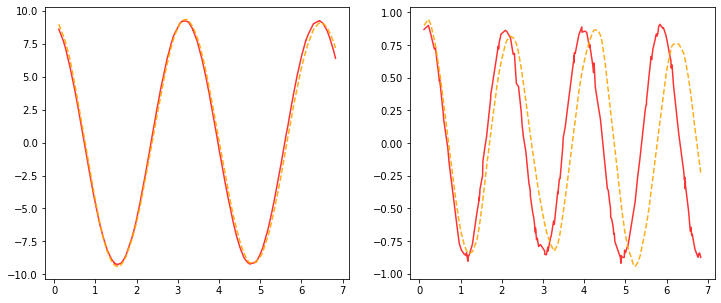

Current LR: [0.0007590483508202912]


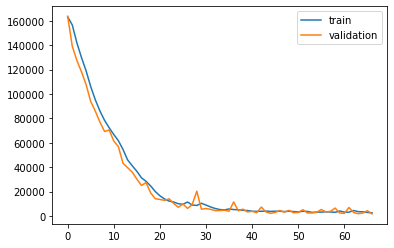

Epoch: 55, Train ELBO: -2533.952, Val ELBO: -93108.020


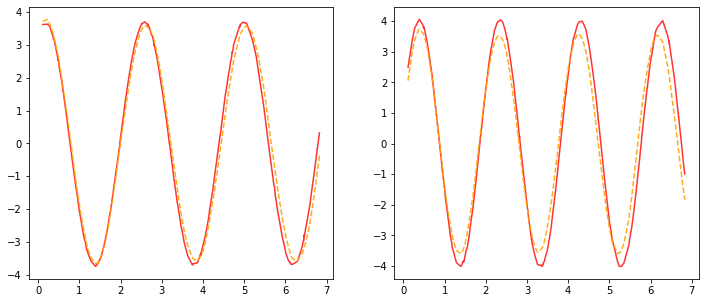

Current LR: [0.0007552531090661898]


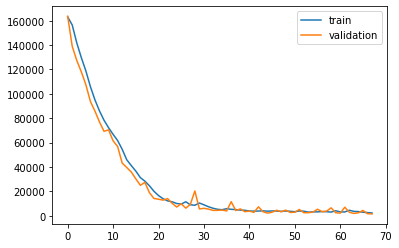

Epoch: 56, Train ELBO: -2193.762, Val ELBO: -92191.354


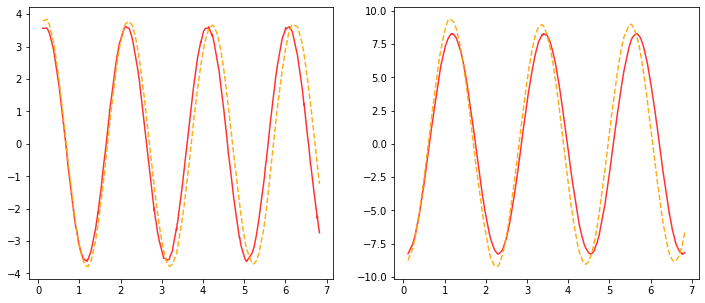

Current LR: [0.0007514768435208588]


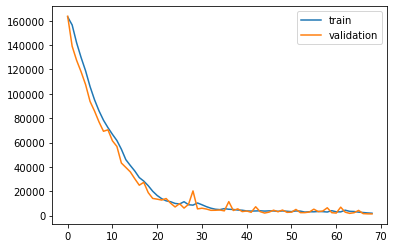

Epoch: 57, Train ELBO: -1950.315, Val ELBO: -91283.254


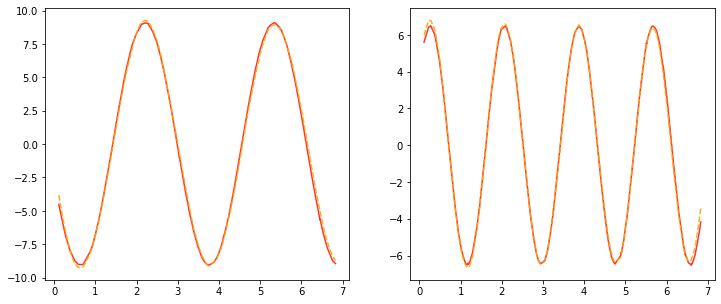

Current LR: [0.0007477194593032545]


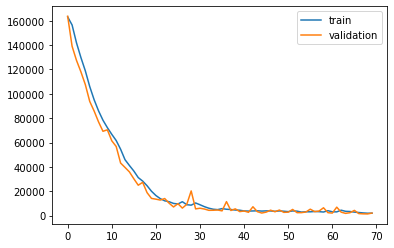

Epoch: 58, Train ELBO: -1992.568, Val ELBO: -90391.152


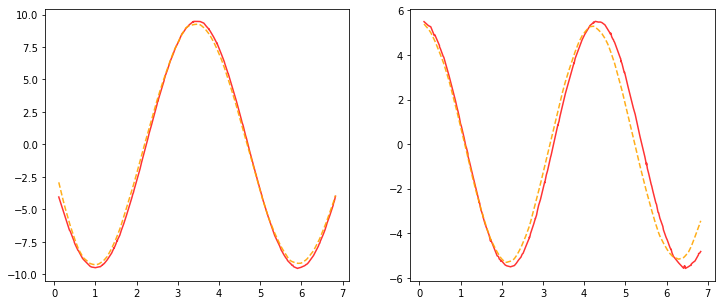

Current LR: [0.0007439808620067382]


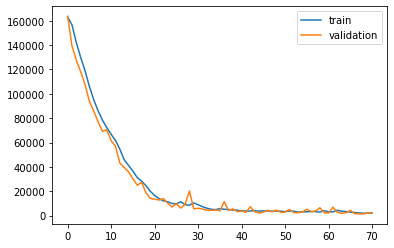

Epoch: 59, Train ELBO: -2059.719, Val ELBO: -89511.544


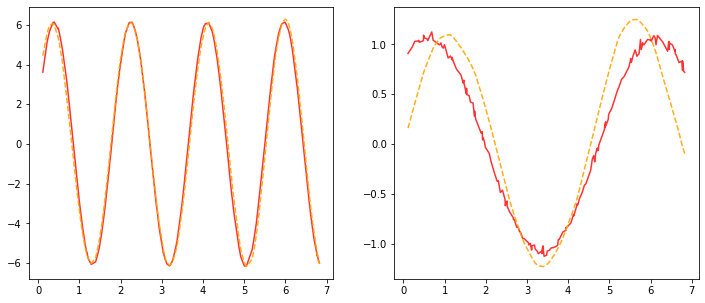

Current LR: [0.0007402609576967046]


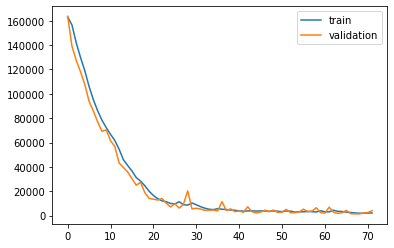

Epoch: 60, Train ELBO: -2188.600, Val ELBO: -88657.019


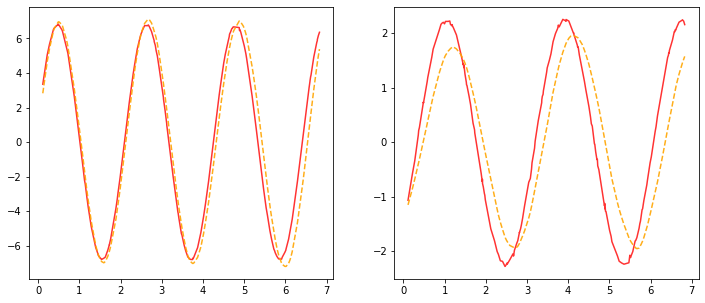

Current LR: [0.000736559652908221]


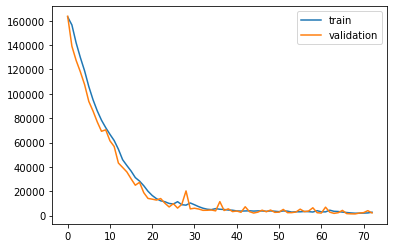

Epoch: 61, Train ELBO: -2770.426, Val ELBO: -87791.925


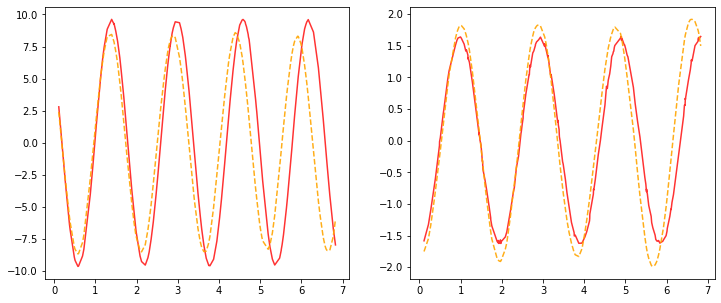

Current LR: [0.0007328768546436799]


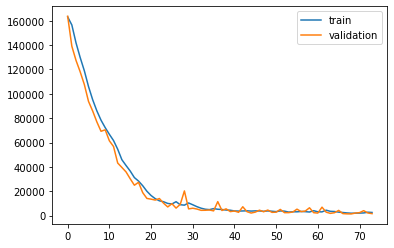

Epoch: 62, Train ELBO: -2563.291, Val ELBO: -86930.163


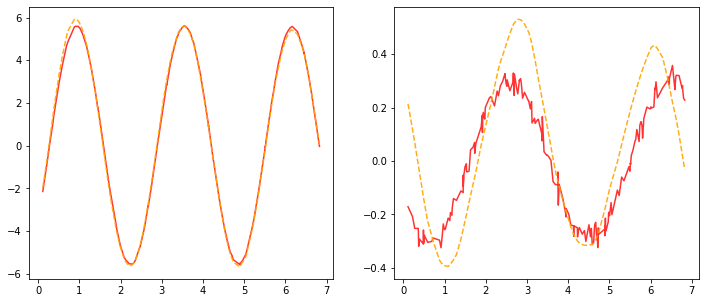

Current LR: [0.0007292124703704615]


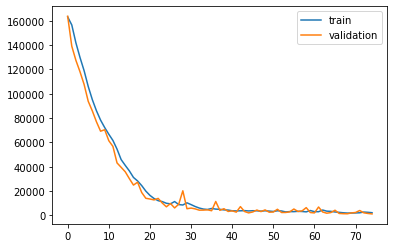

Epoch: 63, Train ELBO: -2252.078, Val ELBO: -86073.381


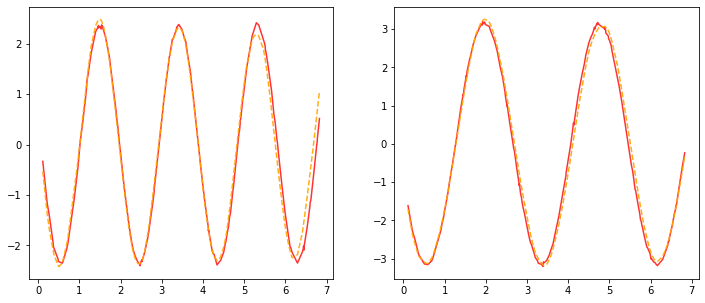

Current LR: [0.0007255664080186091]


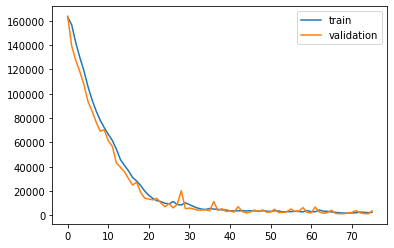

Epoch: 64, Train ELBO: -2587.003, Val ELBO: -85249.043


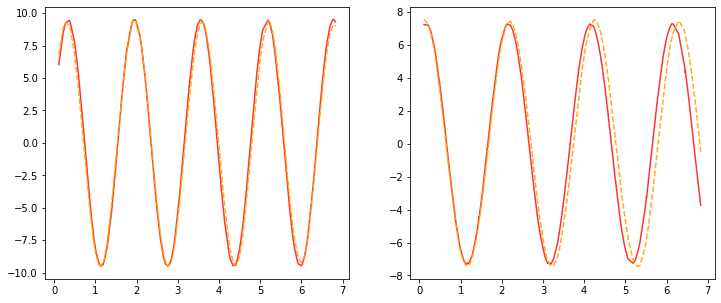

Current LR: [0.0007219385759785161]


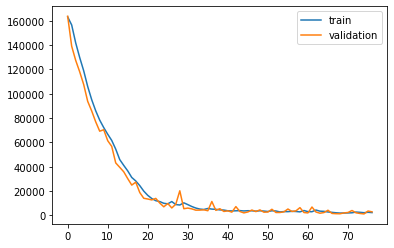

Epoch: 65, Train ELBO: -2340.665, Val ELBO: -84426.061


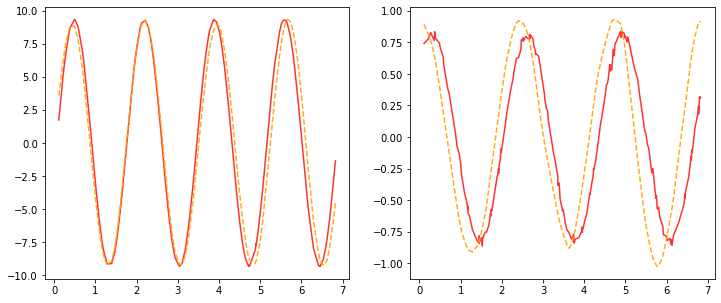

Current LR: [0.0007183288830986235]


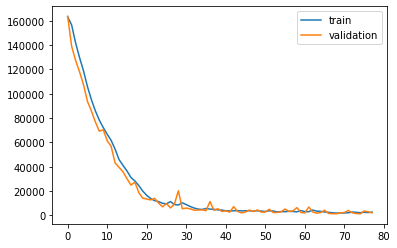

Epoch: 66, Train ELBO: -2753.496, Val ELBO: -83603.012


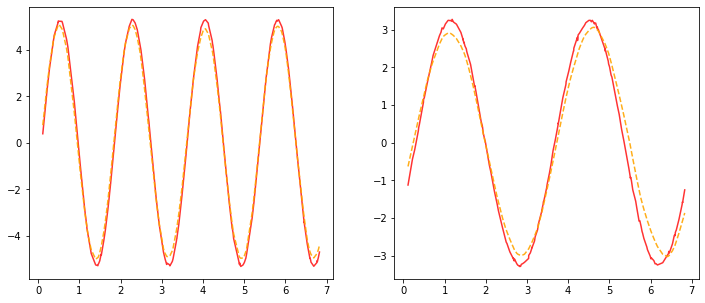

Current LR: [0.0007147372386831303]


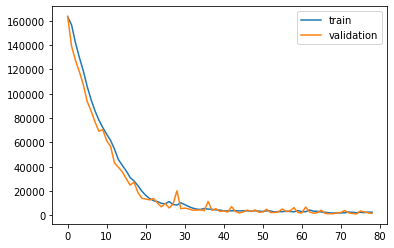

Epoch: 67, Train ELBO: -2680.228, Val ELBO: -82783.786


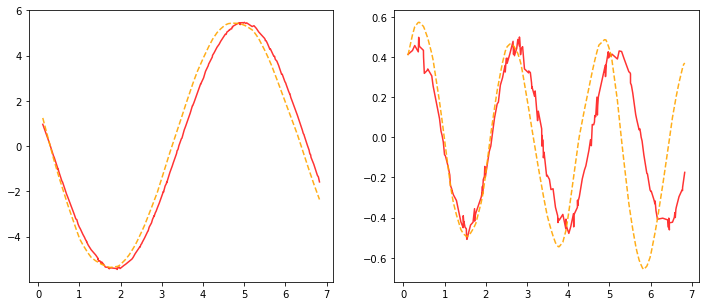

Current LR: [0.0007111635524897147]


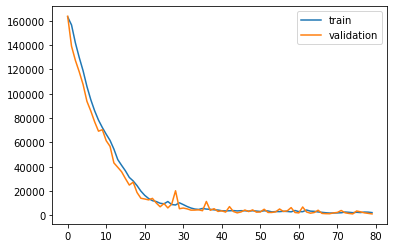

Epoch: 68, Train ELBO: -2310.802, Val ELBO: -81968.259


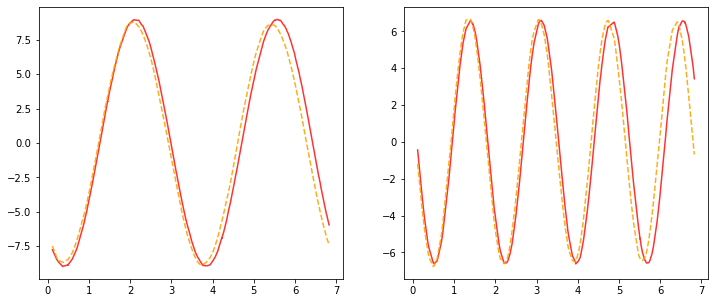

Current LR: [0.0007076077347272661]


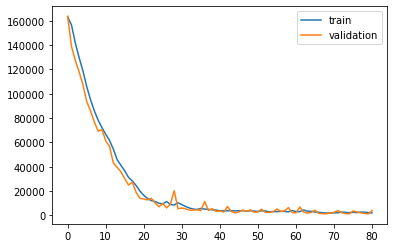

Epoch: 69, Train ELBO: -2099.738, Val ELBO: -81188.222


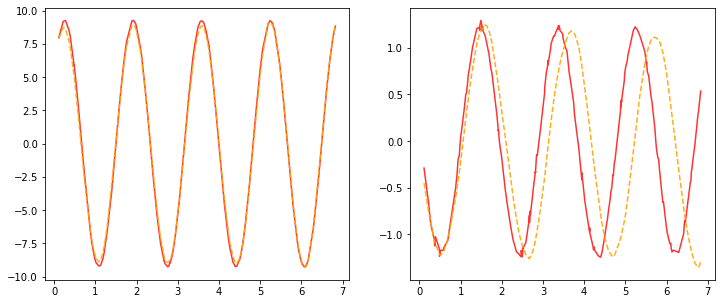

Current LR: [0.0007040696960536298]


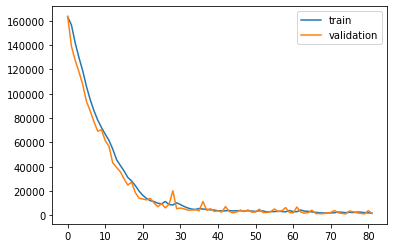

Epoch: 70, Train ELBO: -1836.974, Val ELBO: -80392.973


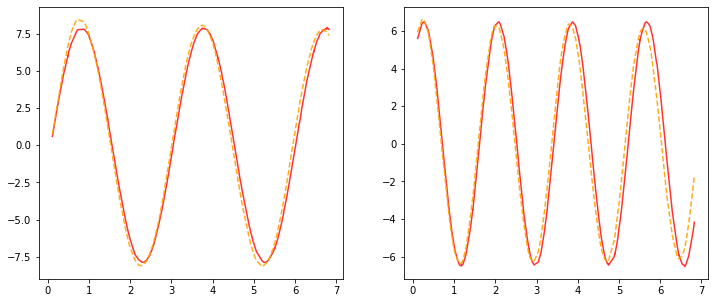

Current LR: [0.0007005493475733617]


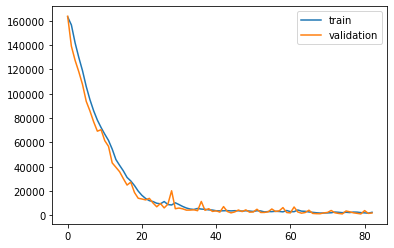

Epoch: 71, Train ELBO: -2556.681, Val ELBO: -79609.087


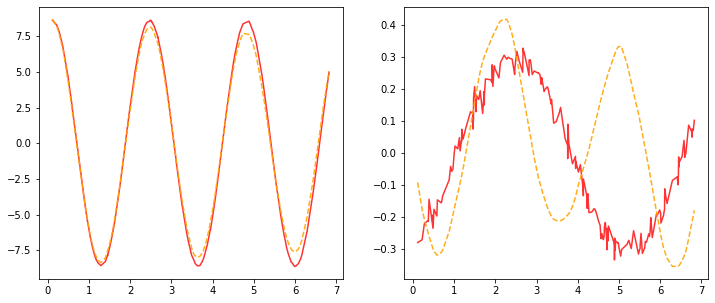

Current LR: [0.0006970466008354948]


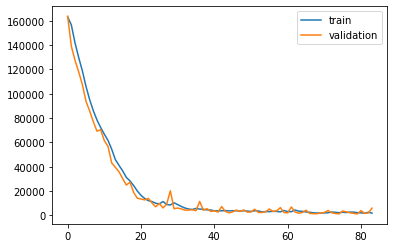

Epoch: 72, Train ELBO: -1901.160, Val ELBO: -78872.947


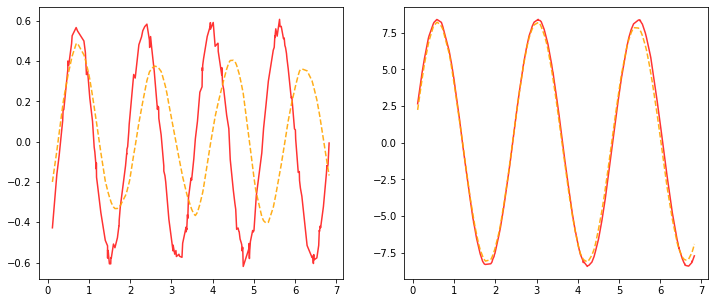

Current LR: [0.0006935613678313174]


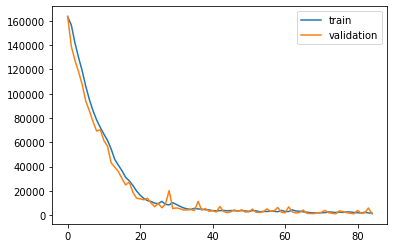

Epoch: 73, Train ELBO: -1828.718, Val ELBO: -78095.451


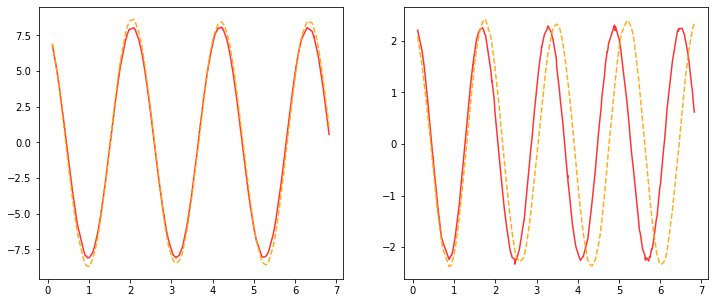

Current LR: [0.0006900935609921607]


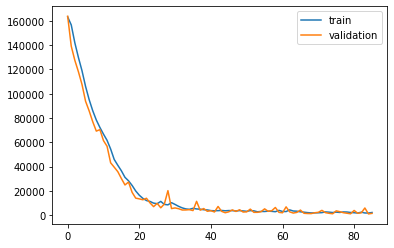

Epoch: 74, Train ELBO: -2291.956, Val ELBO: -77330.158


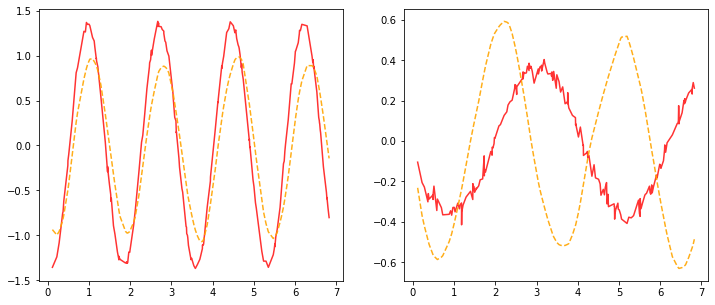

Current LR: [0.0006866430931872]


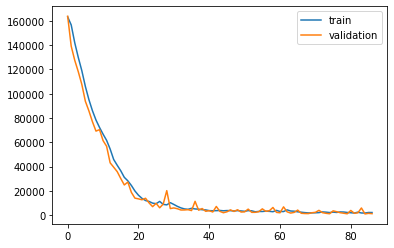

Epoch: 75, Train ELBO: -2264.094, Val ELBO: -76570.229


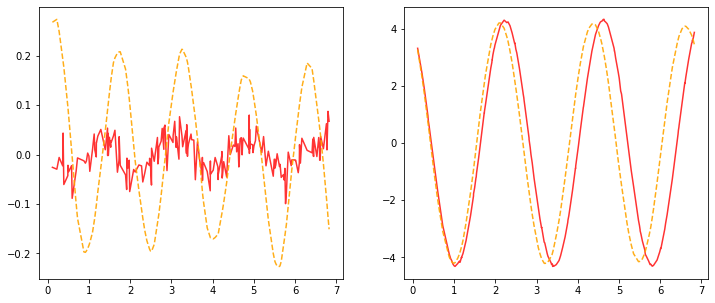

Current LR: [0.000683209877721264]


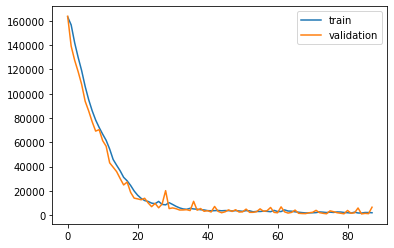

Epoch: 76, Train ELBO: -2082.532, Val ELBO: -75870.867


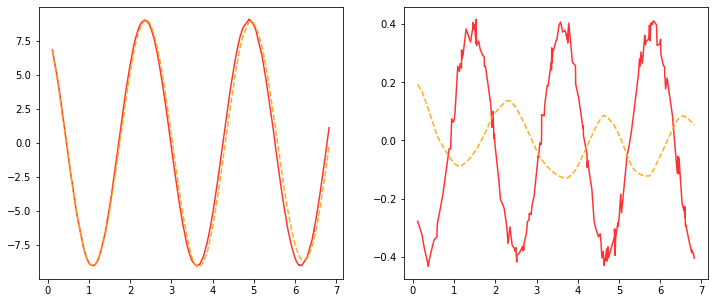

Current LR: [0.0006797938283326577]


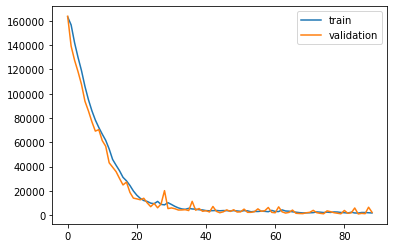

Epoch: 77, Train ELBO: -1899.085, Val ELBO: -75136.321


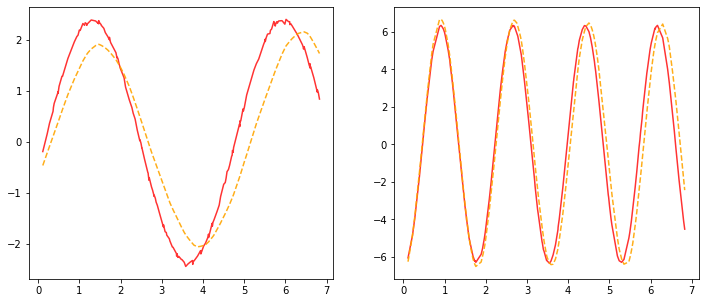

Current LR: [0.0006763948591909945]


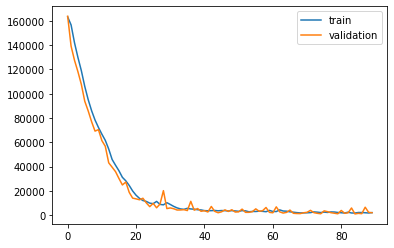

Epoch: 78, Train ELBO: -2196.170, Val ELBO: -74405.945


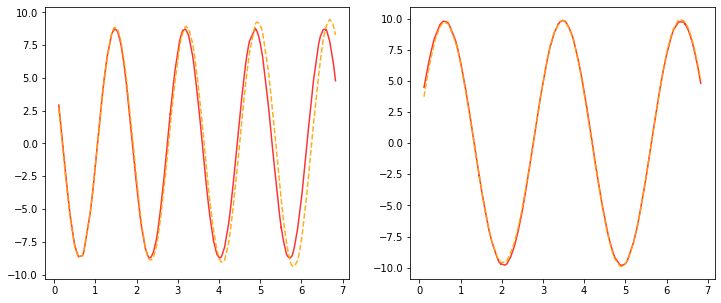

Current LR: [0.0006730128848950395]


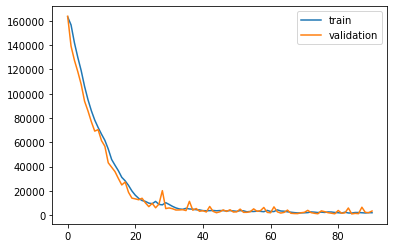

Epoch: 79, Train ELBO: -2092.508, Val ELBO: -73697.113


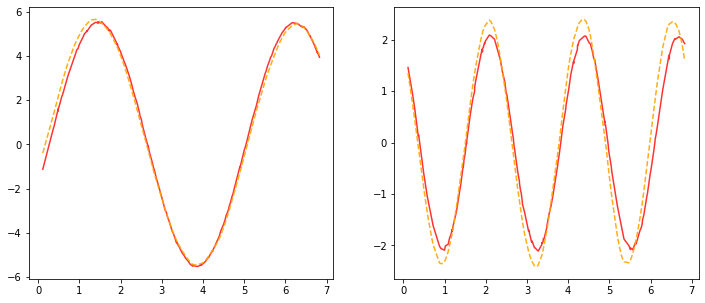

Current LR: [0.0006696478204705643]


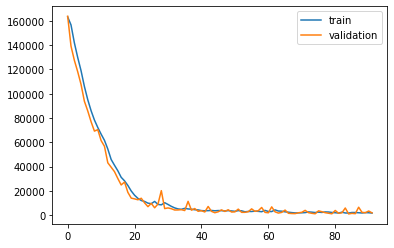

Epoch: 80, Train ELBO: -1821.048, Val ELBO: -72979.687


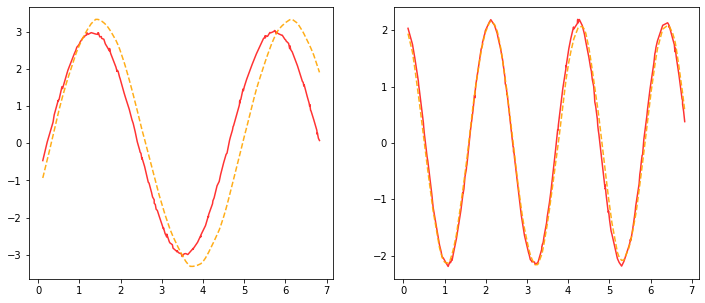

Current LR: [0.0006662995813682115]


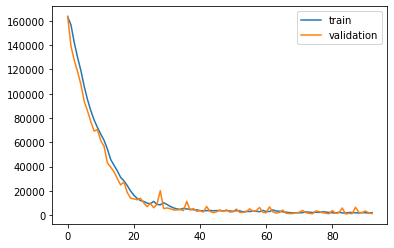

Epoch: 81, Train ELBO: -2188.738, Val ELBO: -72263.464


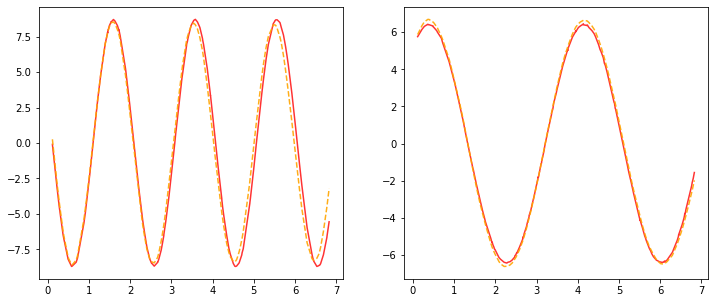

Current LR: [0.0006629680834613704]


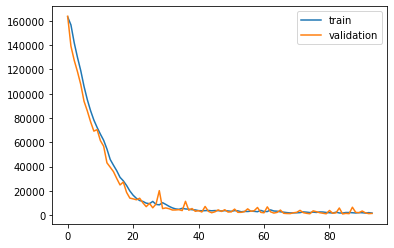

Epoch: 82, Train ELBO: -1833.912, Val ELBO: -71556.178


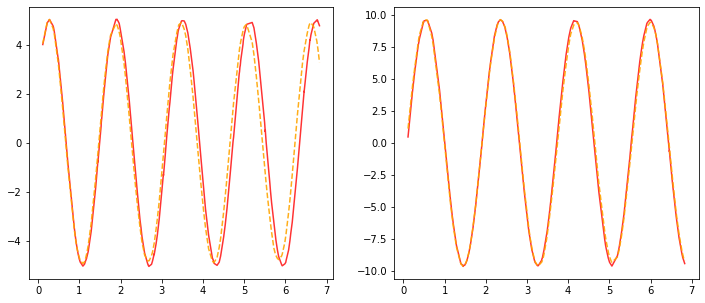

Current LR: [0.0006596532430440636]


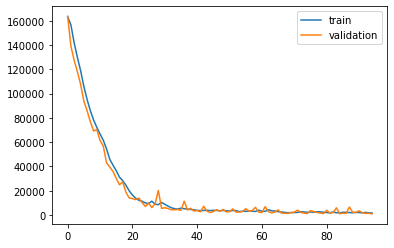

Epoch: 83, Train ELBO: -1723.582, Val ELBO: -70850.149


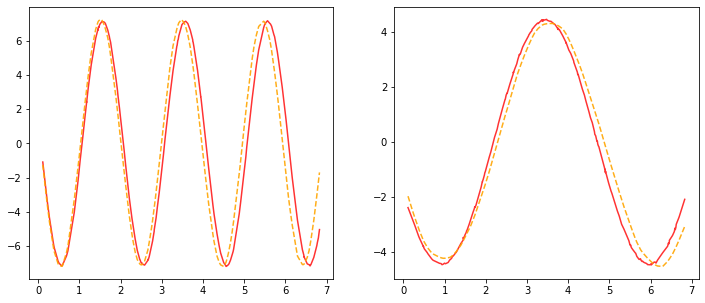

Current LR: [0.0006563549768288432]


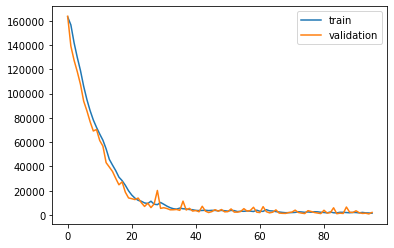

Epoch: 84, Train ELBO: -1499.627, Val ELBO: -70163.516


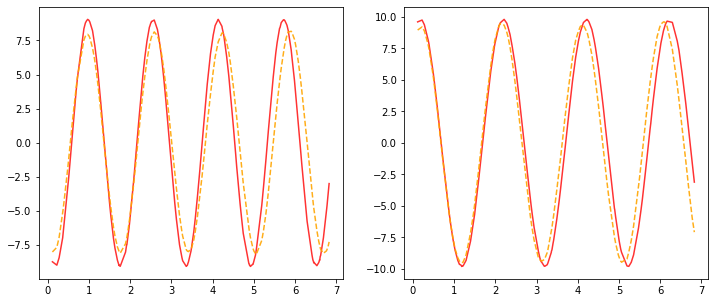

Current LR: [0.000653073201944699]


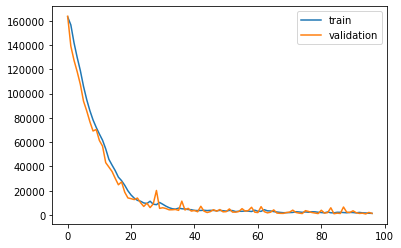

Epoch: 85, Train ELBO: -1396.611, Val ELBO: -69475.673


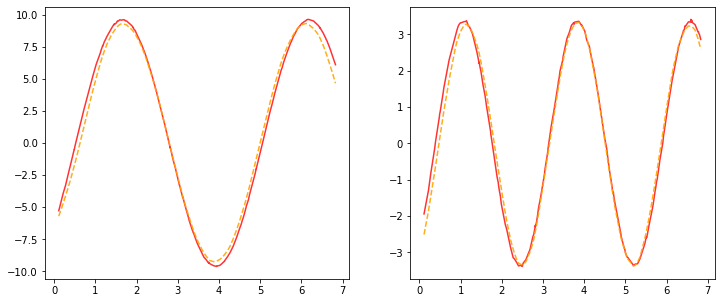

Current LR: [0.0006498078359349755]


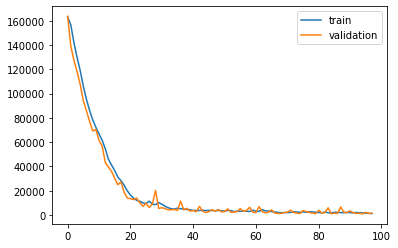

Epoch: 86, Train ELBO: -1255.906, Val ELBO: -68796.513


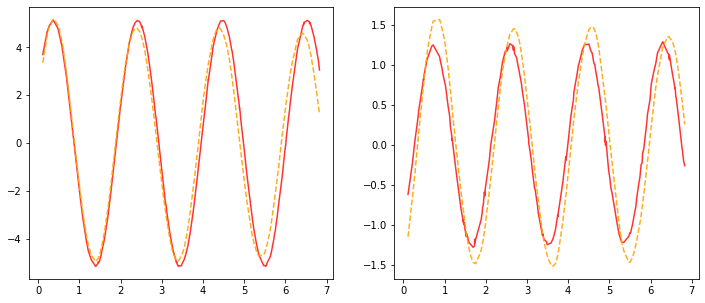

Current LR: [0.0006465587967553006]


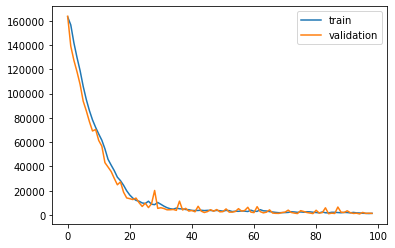

Epoch: 87, Train ELBO: -1429.642, Val ELBO: -68122.525


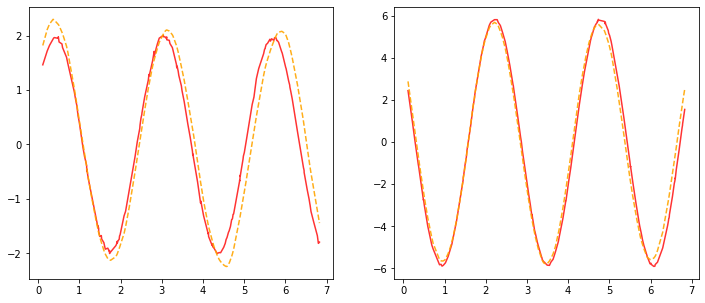

Current LR: [0.0006433260027715241]


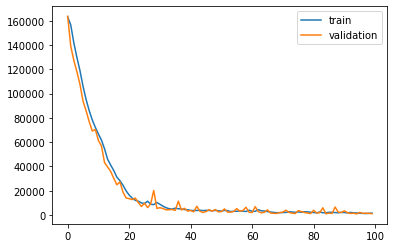

Epoch: 88, Train ELBO: -1579.968, Val ELBO: -67453.237


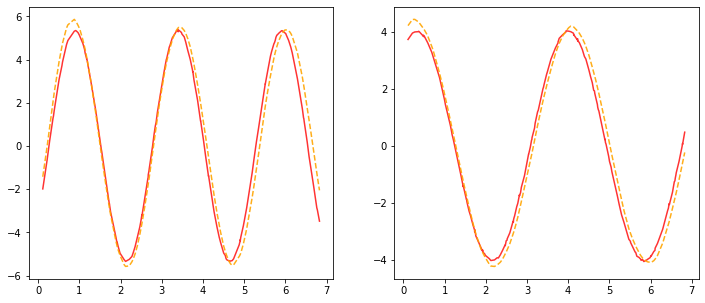

Current LR: [0.0006401093727576665]


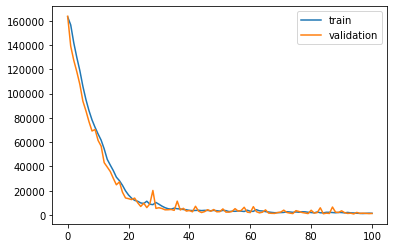

Epoch: 89, Train ELBO: -1449.752, Val ELBO: -66792.239


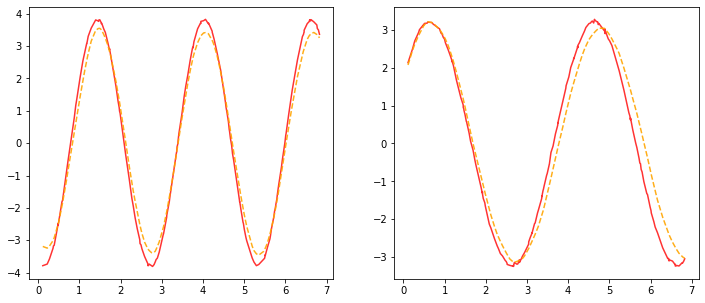

Current LR: [0.0006369088258938781]


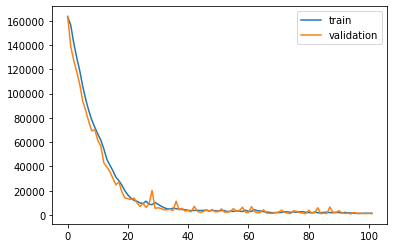

Epoch: 90, Train ELBO: -1414.216, Val ELBO: -66138.441


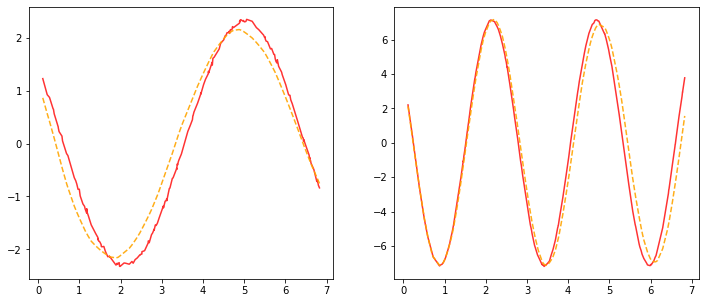

Current LR: [0.0006337242817644087]


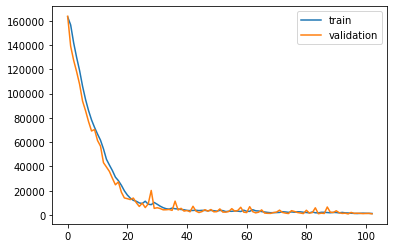

Epoch: 91, Train ELBO: -1321.707, Val ELBO: -65487.161


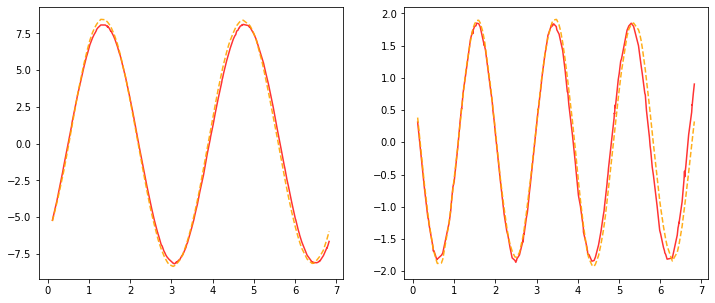

Current LR: [0.0006305556603555866]


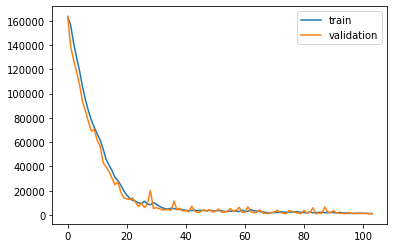

Epoch: 92, Train ELBO: -1276.395, Val ELBO: -64843.332


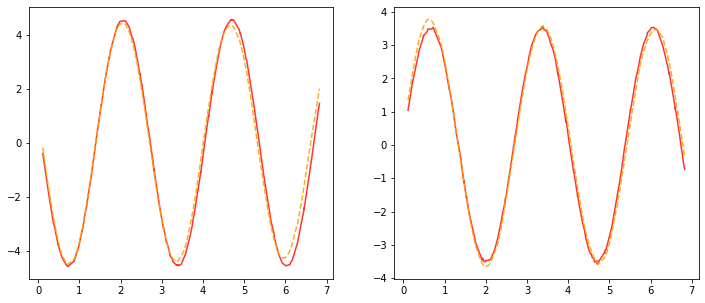

Current LR: [0.0006274028820538087]


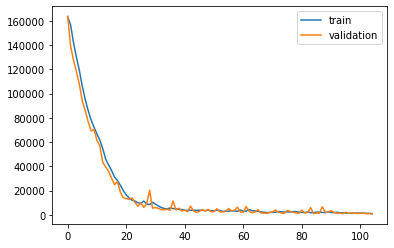

Epoch: 93, Train ELBO: -1062.040, Val ELBO: -64203.063


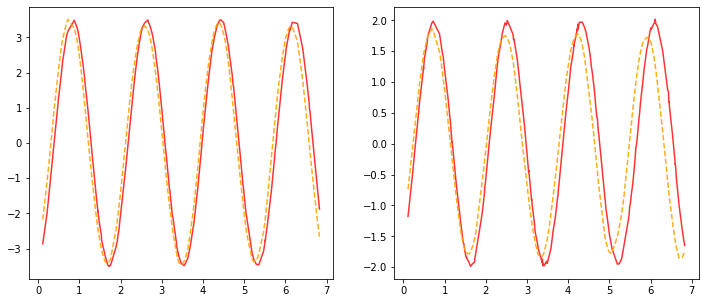

Current LR: [0.0006242658676435396]


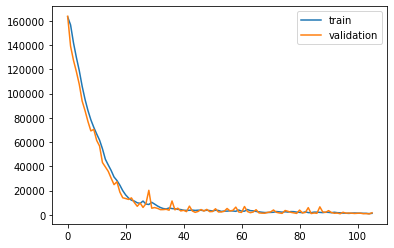

Epoch: 94, Train ELBO: -1291.158, Val ELBO: -63578.258


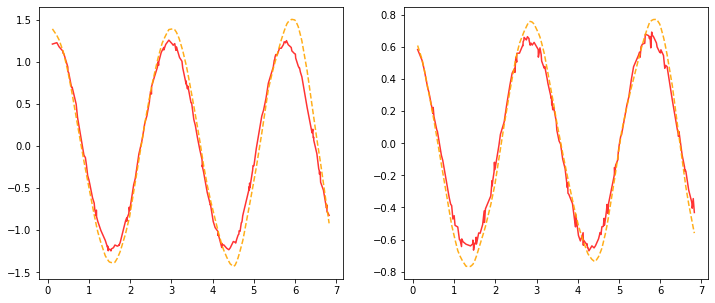

Current LR: [0.0006211445383053219]


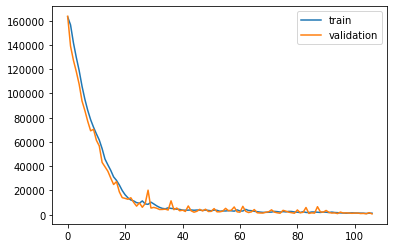

Epoch: 95, Train ELBO: -1280.816, Val ELBO: -62949.306


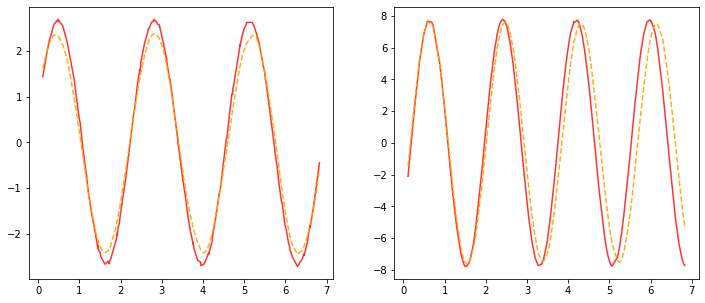

Current LR: [0.0006180388156137953]


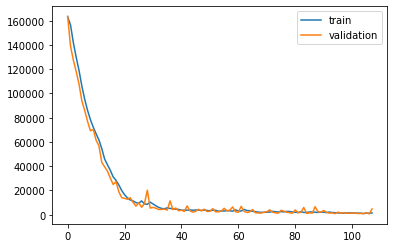

Epoch: 96, Train ELBO: -1450.260, Val ELBO: -62367.558


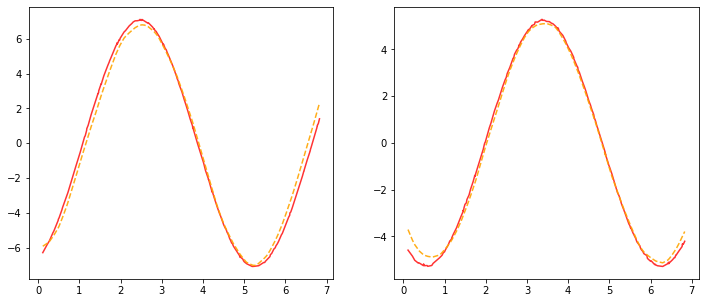

Current LR: [0.0006149486215357262]


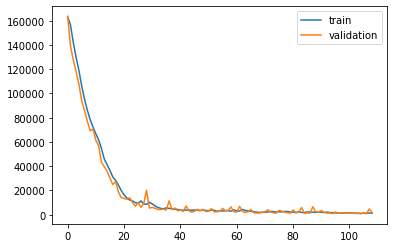

Epoch: 97, Train ELBO: -1292.941, Val ELBO: -61764.157


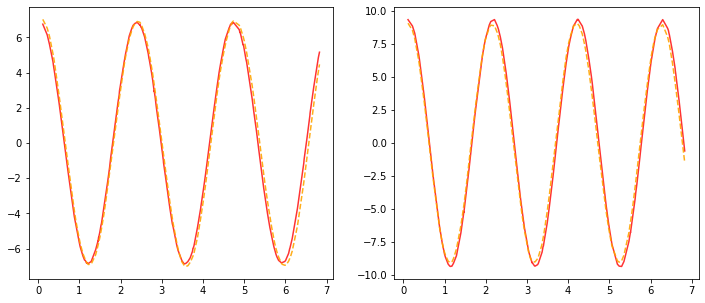

Current LR: [0.0006118738784280476]


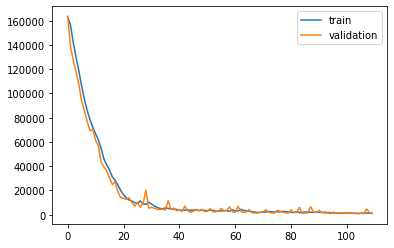

Epoch: 98, Train ELBO: -1239.499, Val ELBO: -61155.225


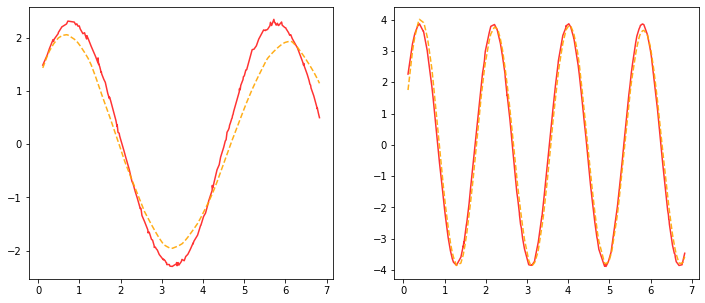

Current LR: [0.0006088145090359073]


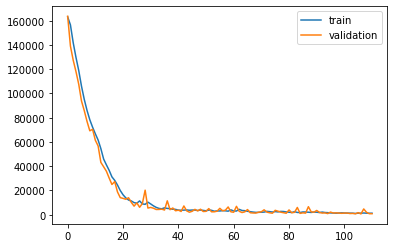

Epoch: 99, Train ELBO: -1267.161, Val ELBO: -60552.231


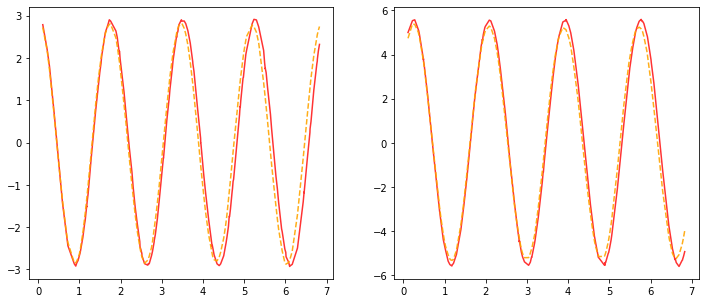

Current LR: [0.0006057704364907278]


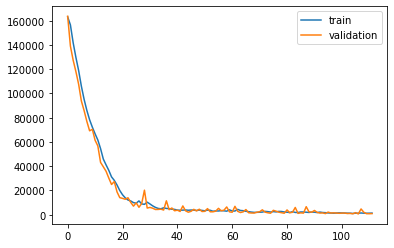

Epoch: 100, Train ELBO: -1353.767, Val ELBO: -59956.284


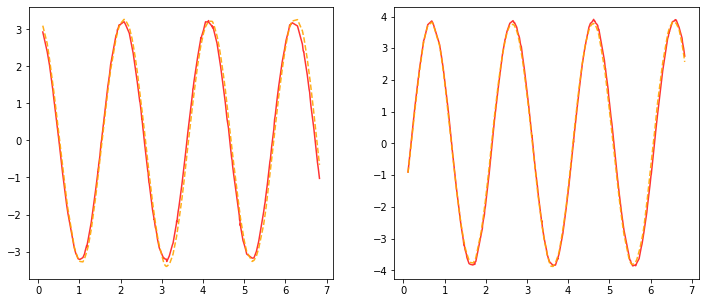

Current LR: [0.0006027415843082742]


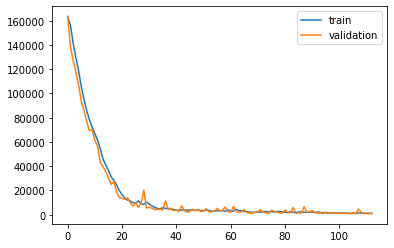

Epoch: 101, Train ELBO: -1140.825, Val ELBO: -59366.029


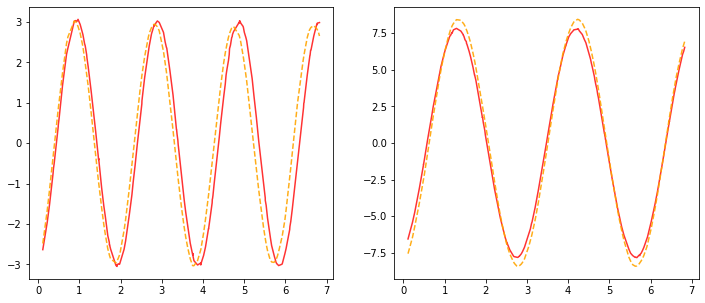

Current LR: [0.0005997278763867329]


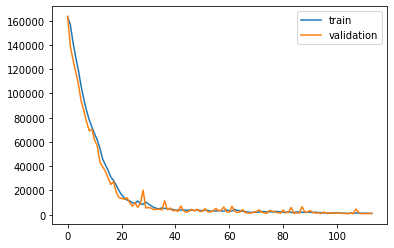

Epoch: 102, Train ELBO: -1082.090, Val ELBO: -58783.793


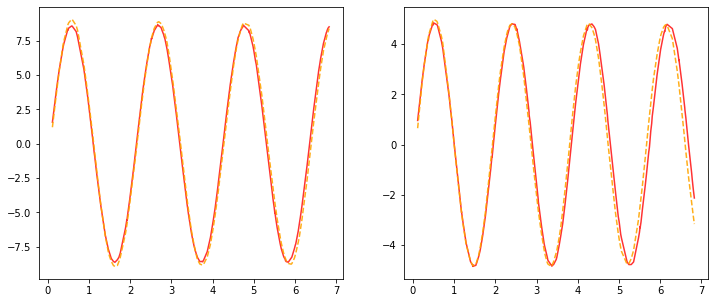

Current LR: [0.0005967292370047993]


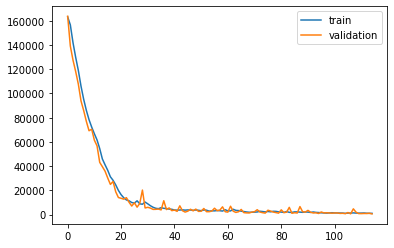

Epoch: 103, Train ELBO: -1065.246, Val ELBO: -58201.868


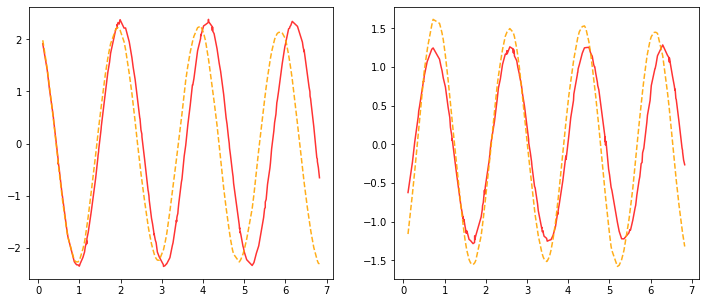

Current LR: [0.0005937455908197753]


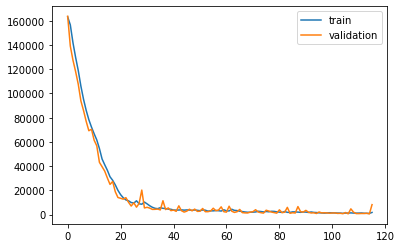

Epoch: 104, Train ELBO: -1799.984, Val ELBO: -57702.249


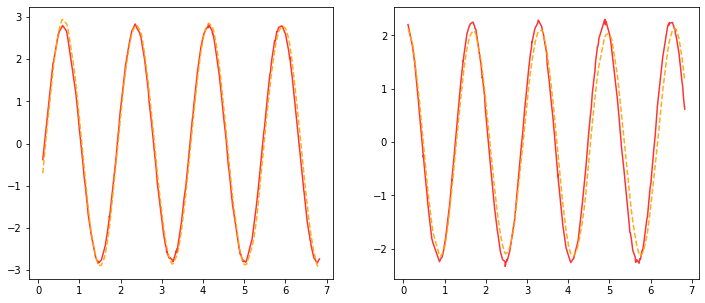

Current LR: [0.0005907768628656764]


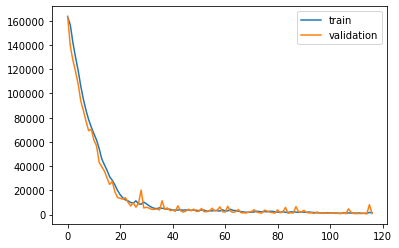

Epoch: 105, Train ELBO: -1532.503, Val ELBO: -57134.433


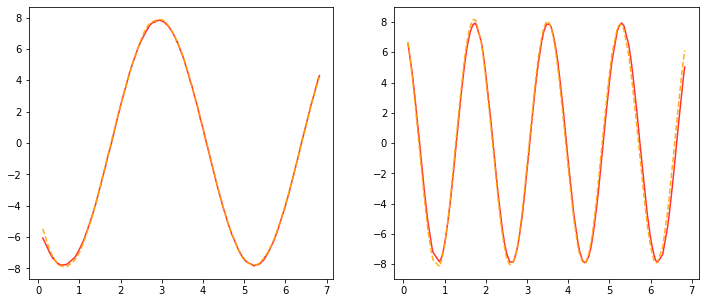

Current LR: [0.000587822978551348]


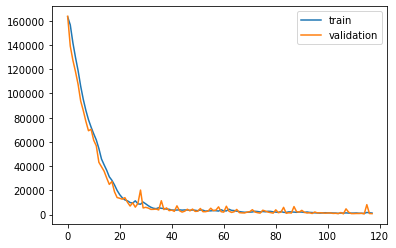

Epoch: 106, Train ELBO: -1312.956, Val ELBO: -56571.194


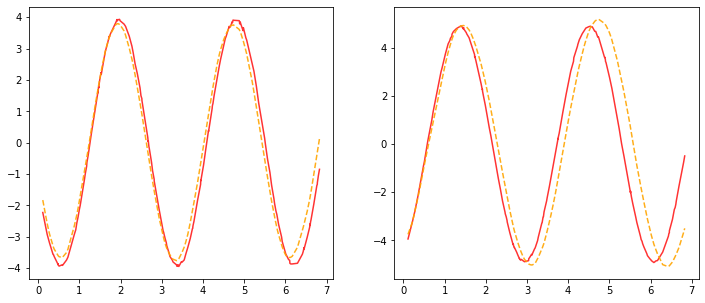

Current LR: [0.0005848838636585913]


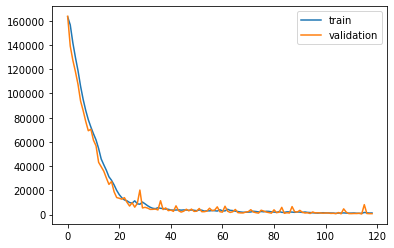

Epoch: 107, Train ELBO: -1372.807, Val ELBO: -56013.580


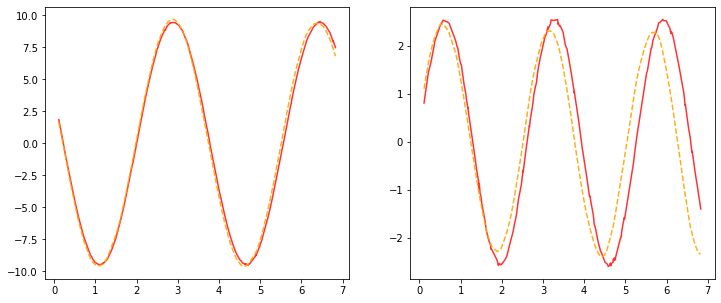

Current LR: [0.0005819594443402983]


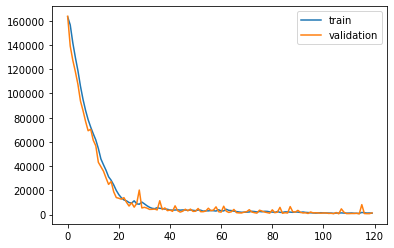

Epoch: 108, Train ELBO: -1165.534, Val ELBO: -55467.868


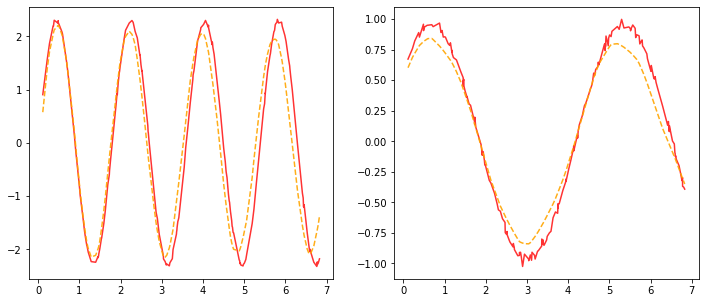

Current LR: [0.0005790496471185969]


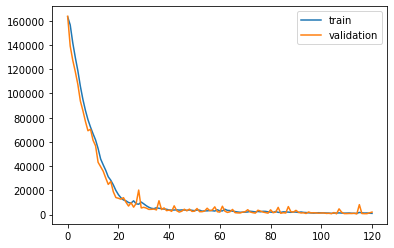

Epoch: 109, Train ELBO: -1050.456, Val ELBO: -54934.213


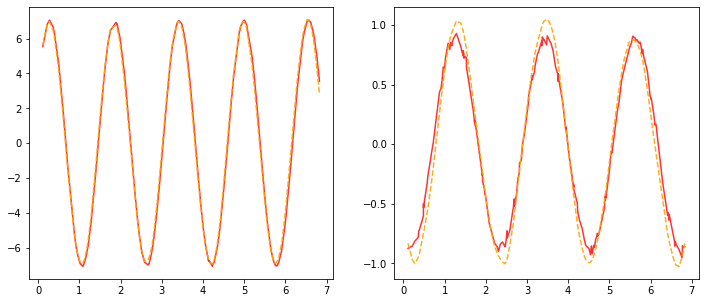

Current LR: [0.0005761543988830039]


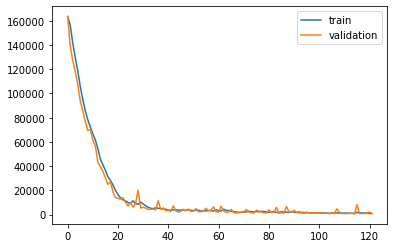

Epoch: 110, Train ELBO: -1034.903, Val ELBO: -54392.194


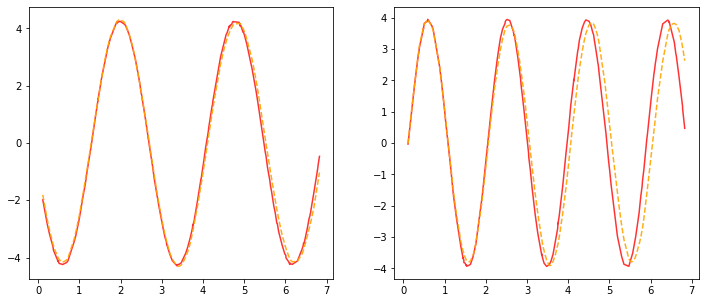

Current LR: [0.0005732736268885889]


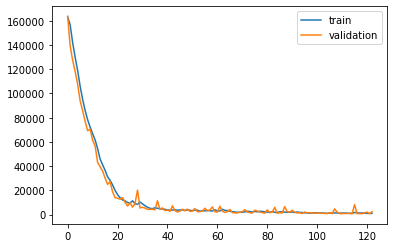

Epoch: 111, Train ELBO: -1029.017, Val ELBO: -53872.646


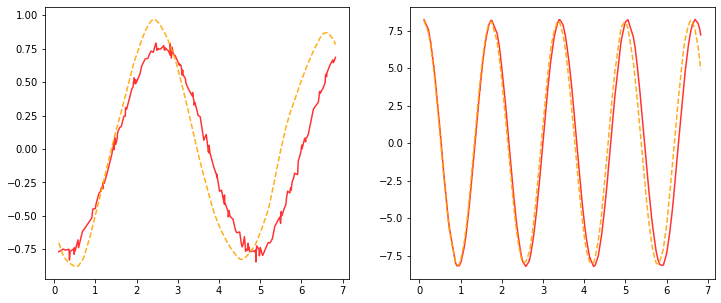

Current LR: [0.0005704072587541459]


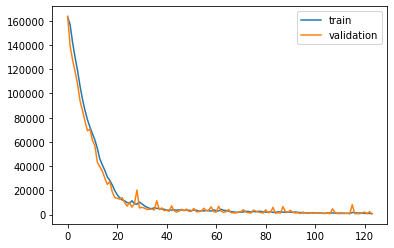

Epoch: 112, Train ELBO: -862.650, Val ELBO: -53339.969


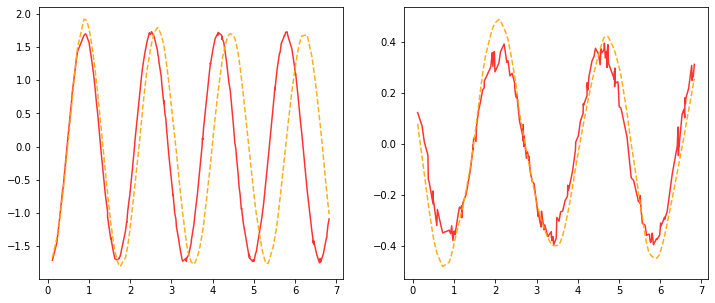

Current LR: [0.0005675552224603752]


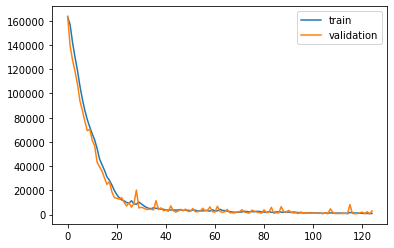

Epoch: 113, Train ELBO: -1017.825, Val ELBO: -52837.812


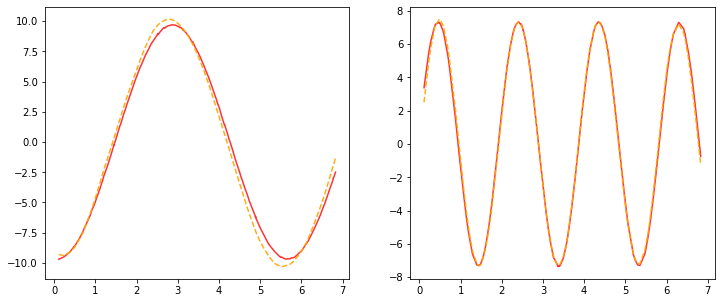

Current LR: [0.0005647174463480733]


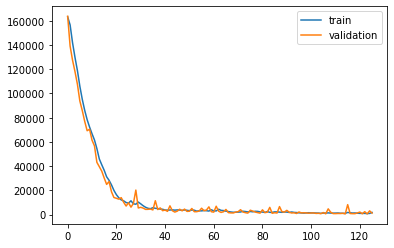

Epoch: 114, Train ELBO: -1787.573, Val ELBO: -52322.150


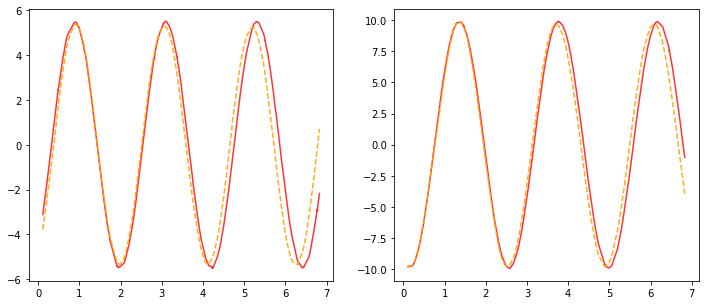

Current LR: [0.0005618938591163329]


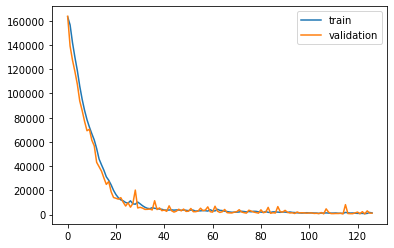

Epoch: 115, Train ELBO: -1415.844, Val ELBO: -51811.143


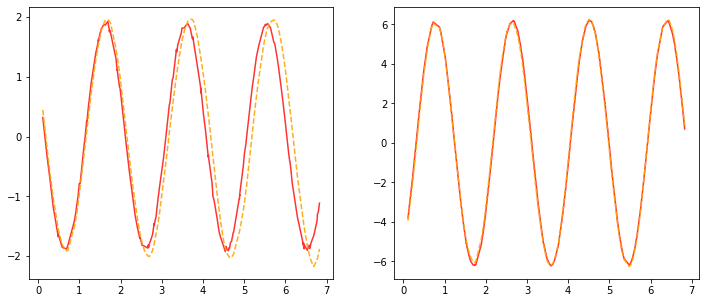

Current LR: [0.0005590843898207513]


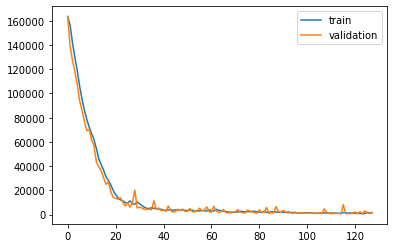

Epoch: 116, Train ELBO: -1305.901, Val ELBO: -51312.017


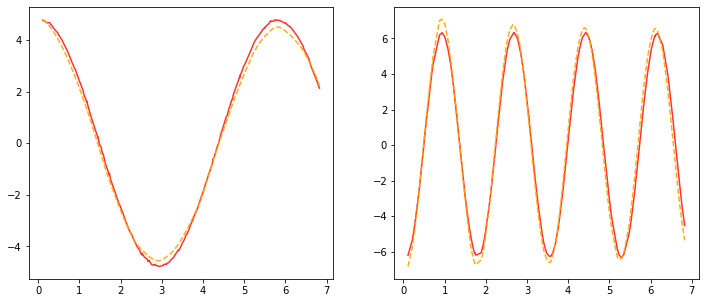

Current LR: [0.0005562889678716475]


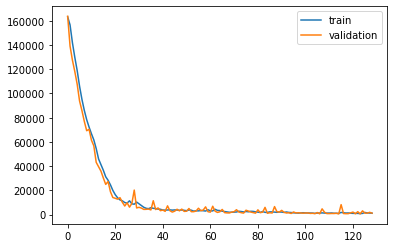

Epoch: 117, Train ELBO: -1191.198, Val ELBO: -50810.892


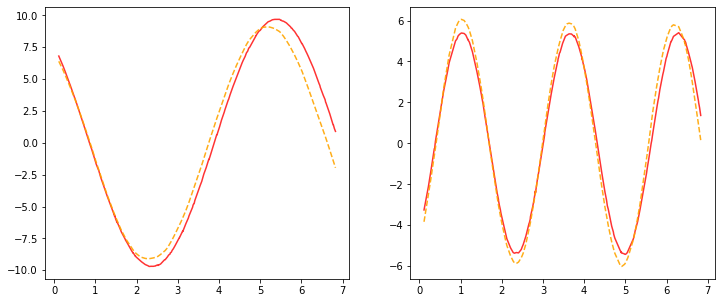

Current LR: [0.0005535075230322892]


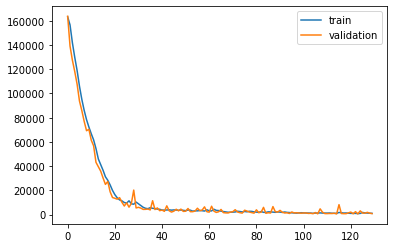

Epoch: 118, Train ELBO: -1052.640, Val ELBO: -50311.448


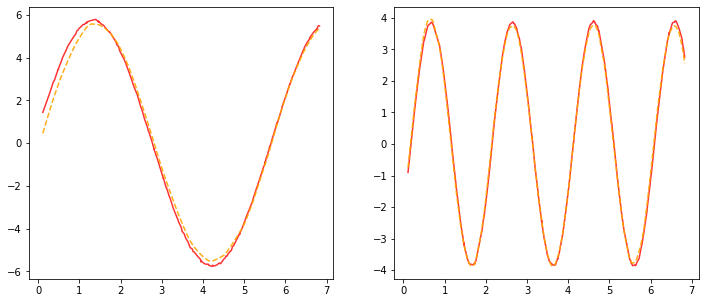

Current LR: [0.0005507399854171277]


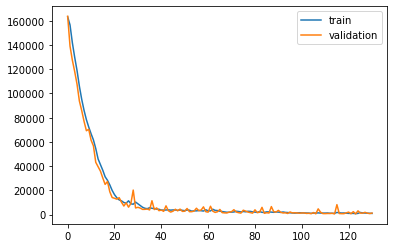

Epoch: 119, Train ELBO: -1000.916, Val ELBO: -49821.339


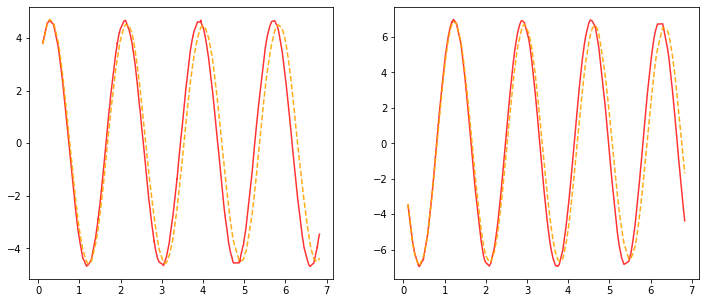

Current LR: [0.0005479862854900421]


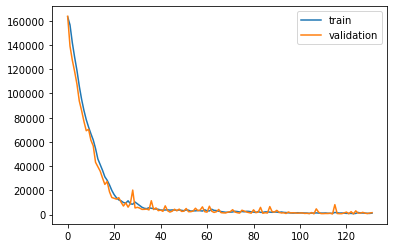

Epoch: 120, Train ELBO: -1239.600, Val ELBO: -49339.225


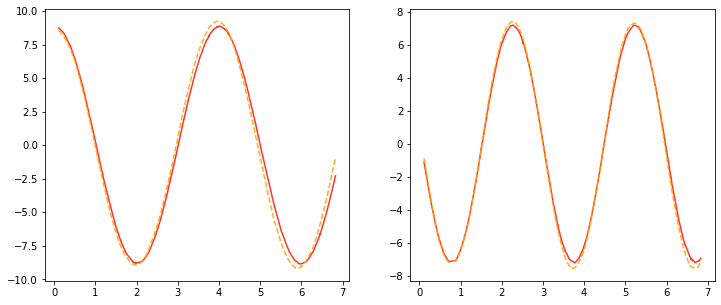

Current LR: [0.0005452463540625918]


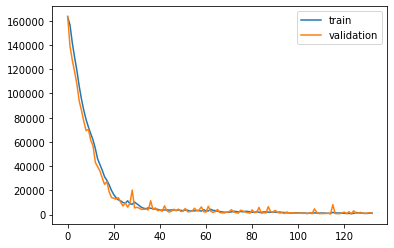

Epoch: 121, Train ELBO: -1386.019, Val ELBO: -48855.766


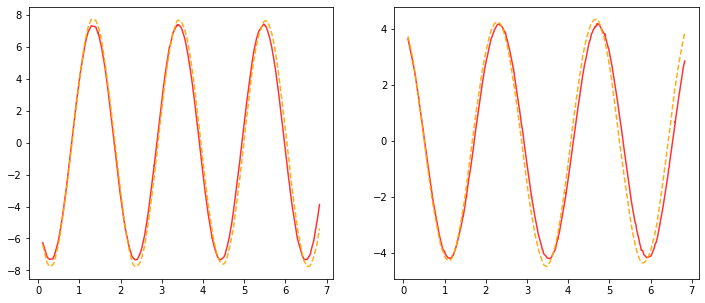

Current LR: [0.0005425201222922788]


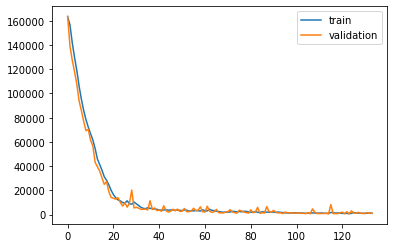

Epoch: 122, Train ELBO: -1092.260, Val ELBO: -48379.262


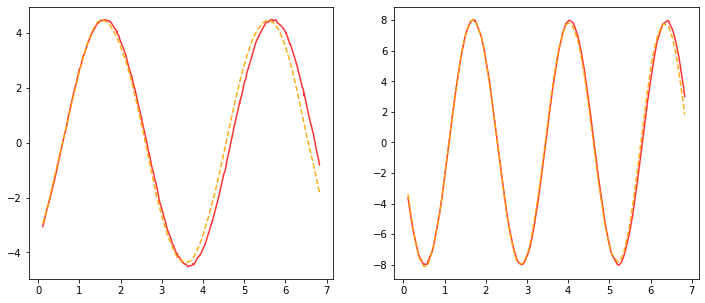

Current LR: [0.0005398075216808175]


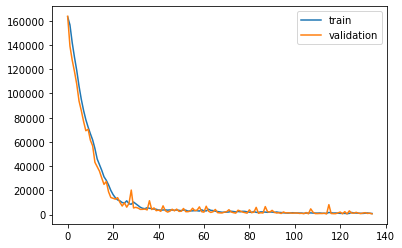

Epoch: 123, Train ELBO: -936.351, Val ELBO: -47901.954


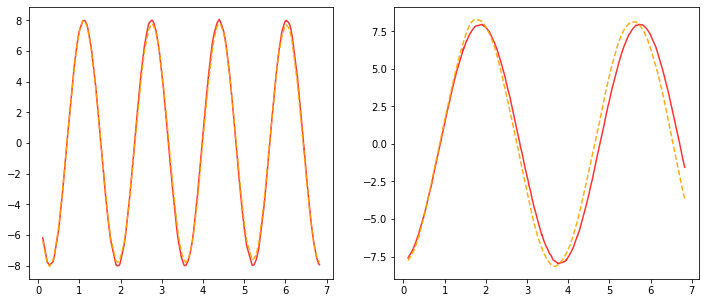

Current LR: [0.0005371084840724133]


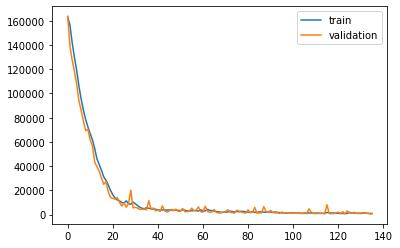

Epoch: 124, Train ELBO: -964.311, Val ELBO: -47429.477


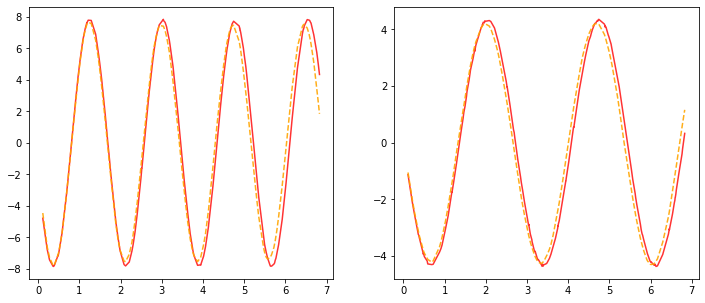

Current LR: [0.0005344229416520513]


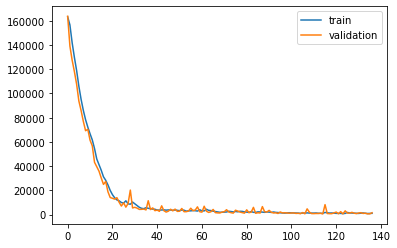

Epoch: 125, Train ELBO: -1078.483, Val ELBO: -46970.570


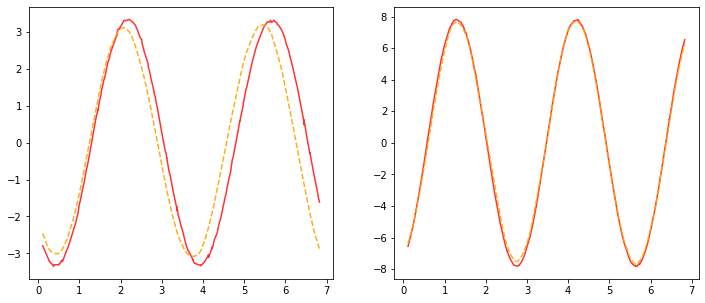

Current LR: [0.000531750826943791]


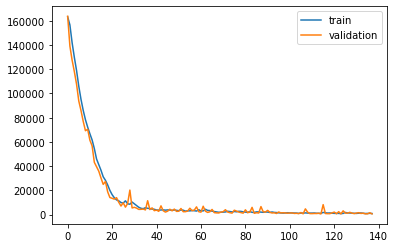

Epoch: 126, Train ELBO: -921.116, Val ELBO: -46506.803


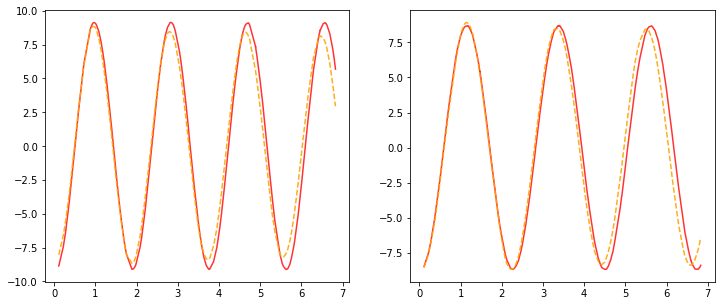

Current LR: [0.000529092072809072]


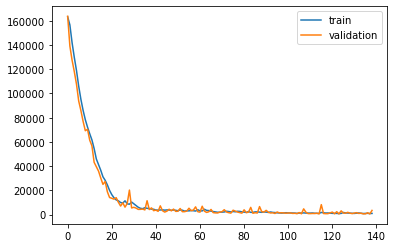

Epoch: 127, Train ELBO: -996.839, Val ELBO: -46076.609


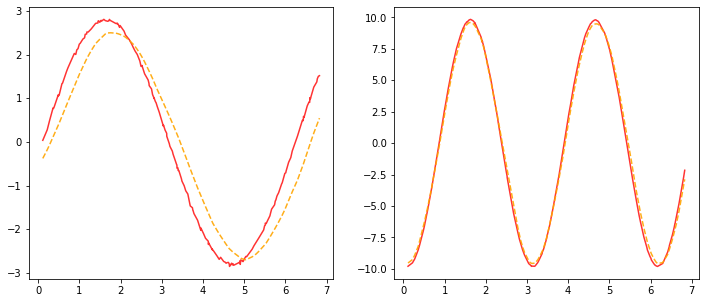

Current LR: [0.0005264466124450266]


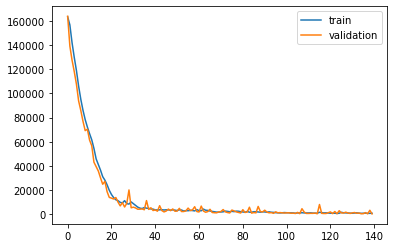

Epoch: 128, Train ELBO: -1007.408, Val ELBO: -45620.469


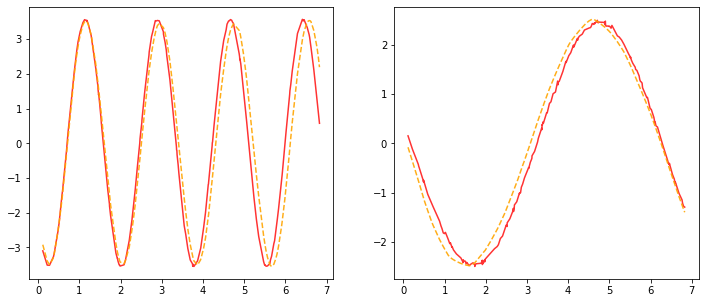

Current LR: [0.0005238143793828015]


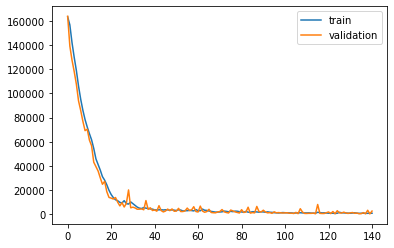

Epoch: 129, Train ELBO: -1027.907, Val ELBO: -45192.504


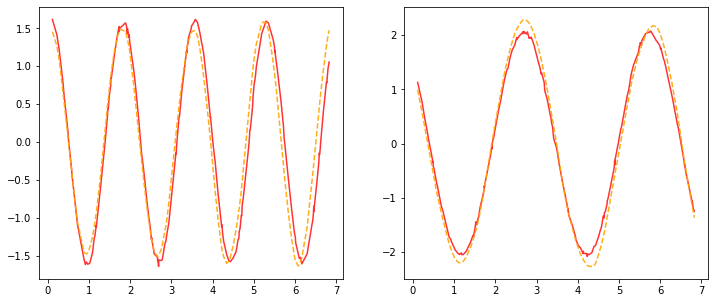

Current LR: [0.0005211953074858875]


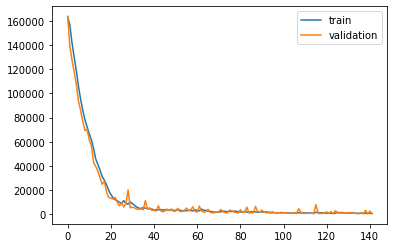

Epoch: 130, Train ELBO: -900.518, Val ELBO: -44746.632


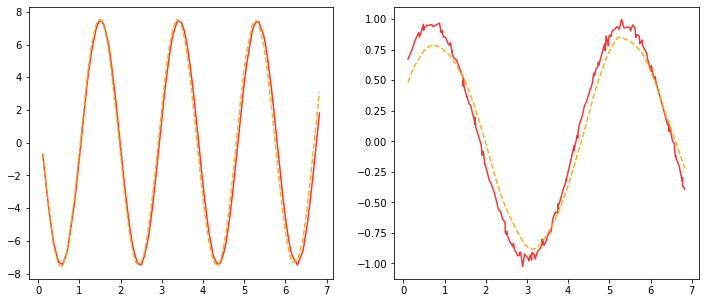

Current LR: [0.0005185893309484581]


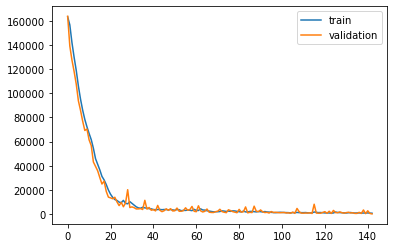

Epoch: 131, Train ELBO: -793.470, Val ELBO: -44301.412


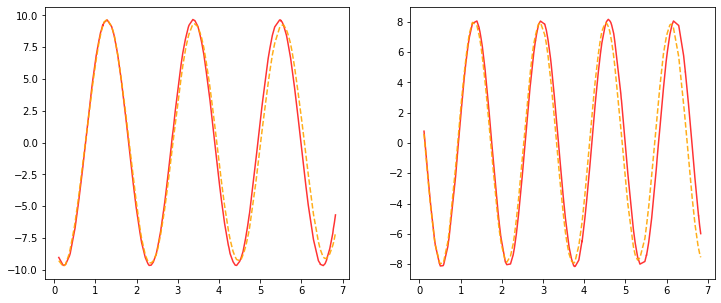

Current LR: [0.0005159963842937158]


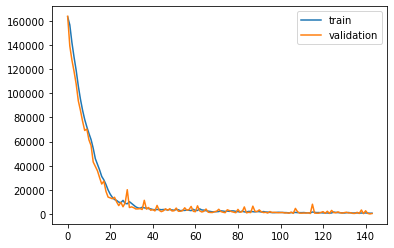

Epoch: 132, Train ELBO: -795.901, Val ELBO: -43864.120


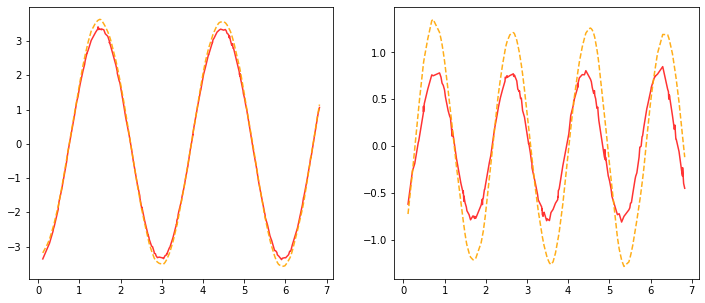

Current LR: [0.0005134164023722472]


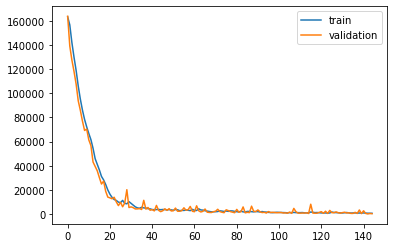

Epoch: 133, Train ELBO: -729.790, Val ELBO: -43429.723


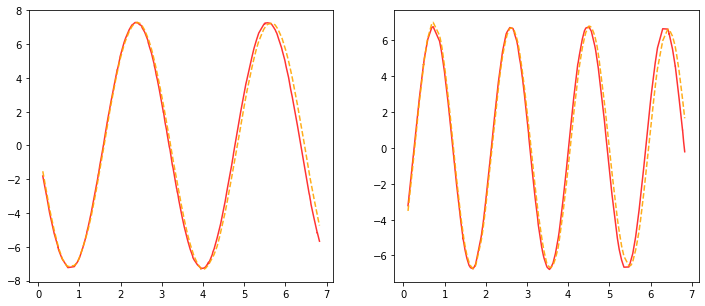

Current LR: [0.000510849320360386]


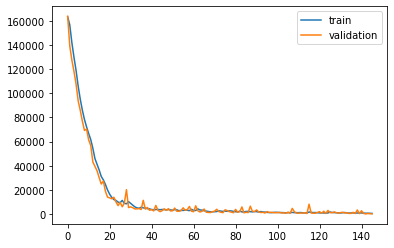

Epoch: 134, Train ELBO: -624.343, Val ELBO: -42998.168


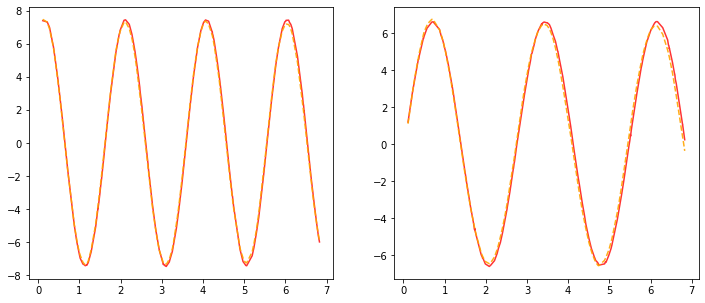

Current LR: [0.0005082950737585841]


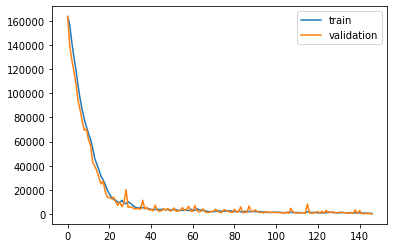

Epoch: 135, Train ELBO: -510.767, Val ELBO: -42569.421


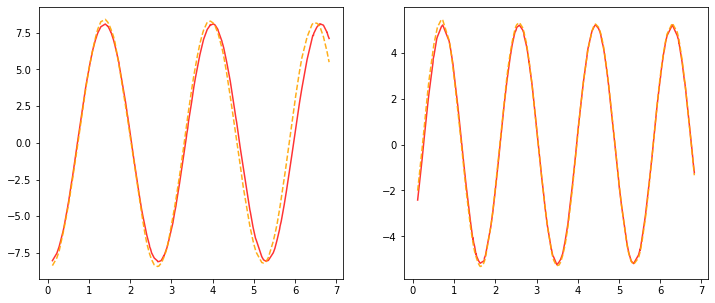

Current LR: [0.0005057535983897911]


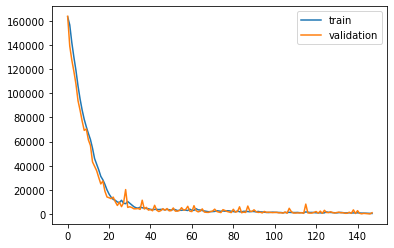

Epoch: 136, Train ELBO: -496.831, Val ELBO: -42154.494


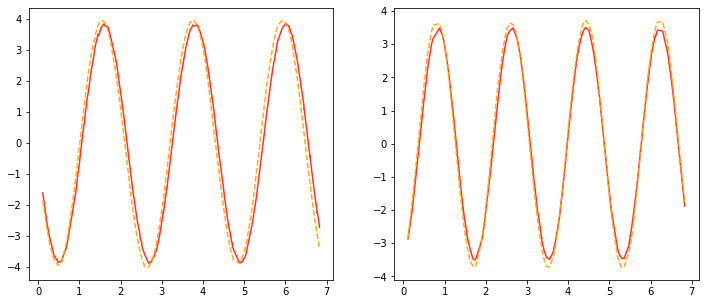

Current LR: [0.0005032248303978422]


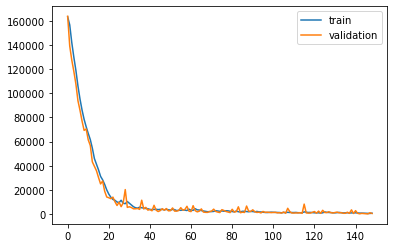

Epoch: 137, Train ELBO: -739.530, Val ELBO: -41737.790


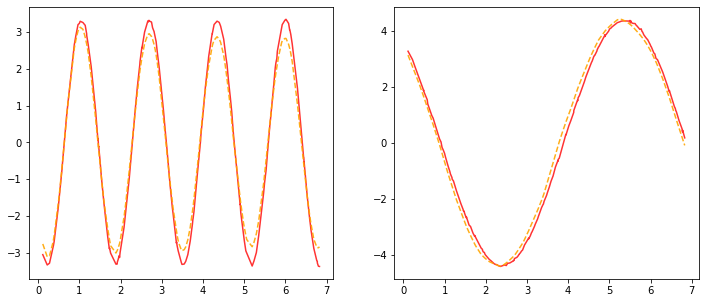

Current LR: [0.000500708706245853]


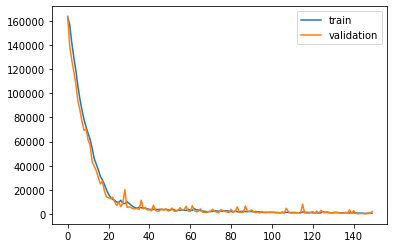

Epoch: 138, Train ELBO: -680.669, Val ELBO: -41341.783


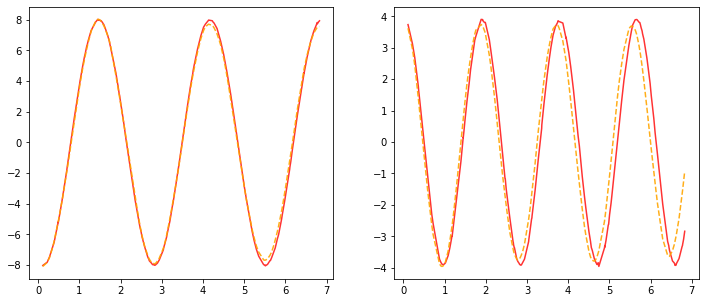

Current LR: [0.0004982051627146237]


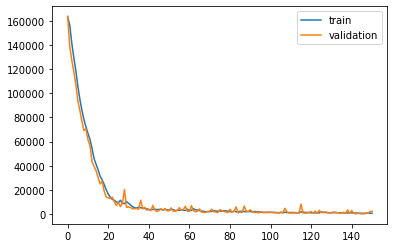

Epoch: 139, Train ELBO: -784.715, Val ELBO: -40951.671


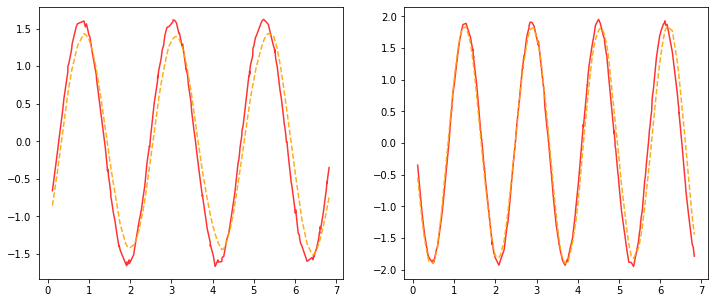

Current LR: [0.0004957141369010506]


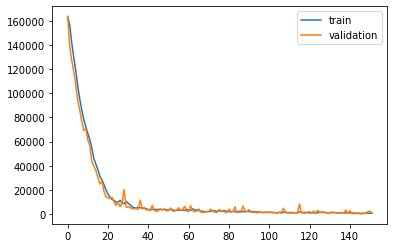

Epoch: 140, Train ELBO: -834.990, Val ELBO: -40549.837


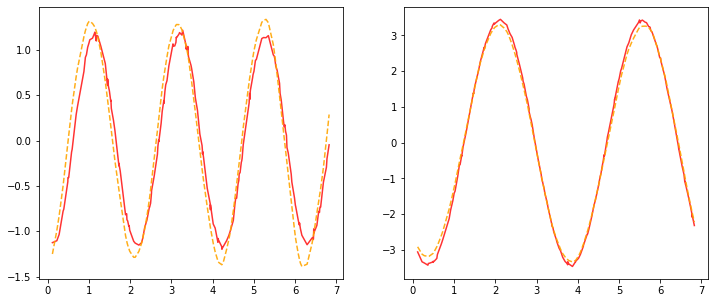

Current LR: [0.0004932355662165453]


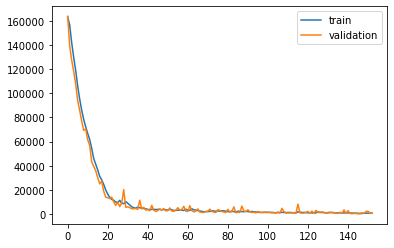

Epoch: 141, Train ELBO: -799.736, Val ELBO: -40151.078


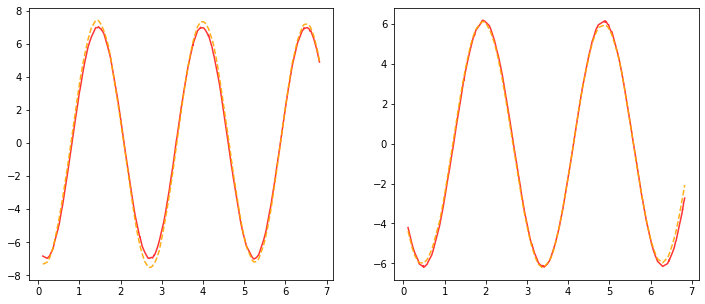

Current LR: [0.0004907693883854625]


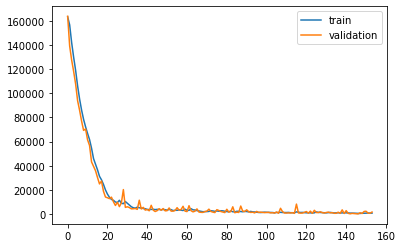

Epoch: 142, Train ELBO: -776.862, Val ELBO: -39766.398


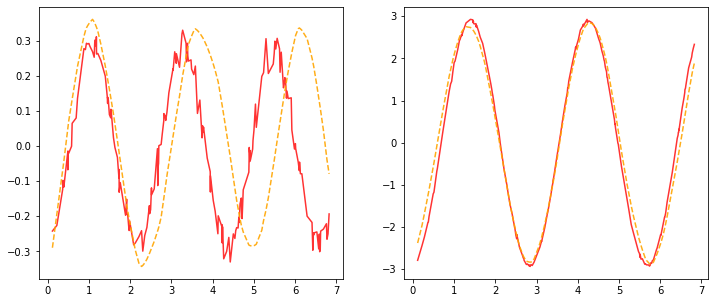

Current LR: [0.0004883155414435352]


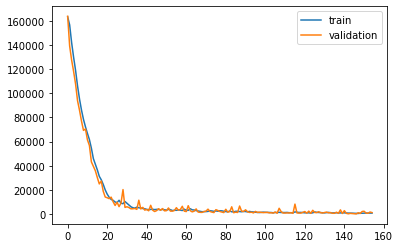

Epoch: 143, Train ELBO: -793.912, Val ELBO: -39380.909


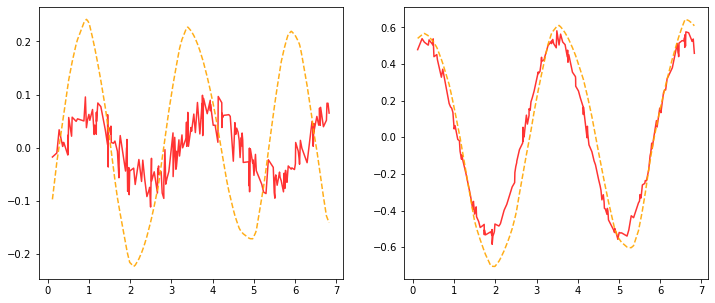

Current LR: [0.00048587396373631753]


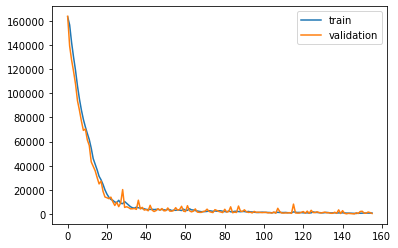

Epoch: 144, Train ELBO: -874.800, Val ELBO: -38992.026


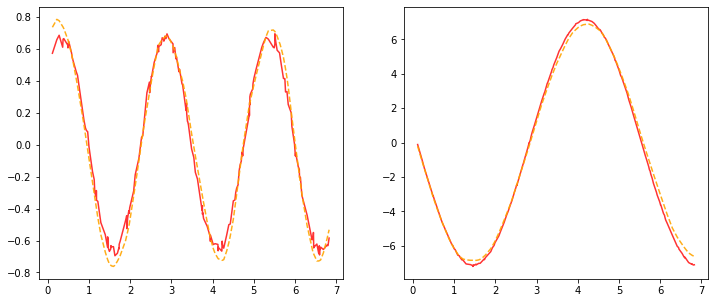

Current LR: [0.00048344459391763597]


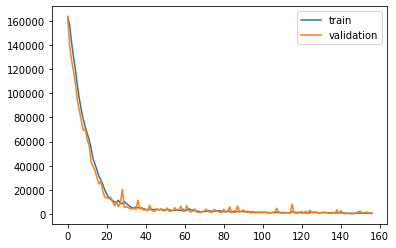

Epoch: 145, Train ELBO: -735.441, Val ELBO: -38606.936


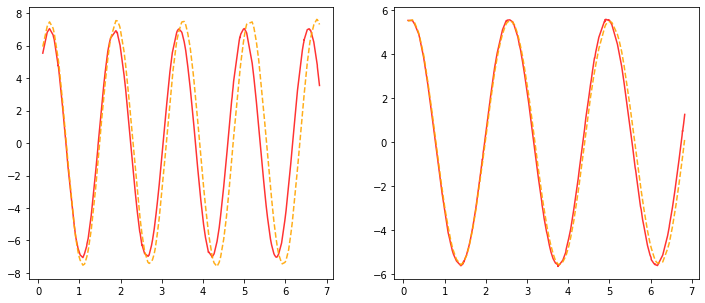

Current LR: [0.0004810273709480478]


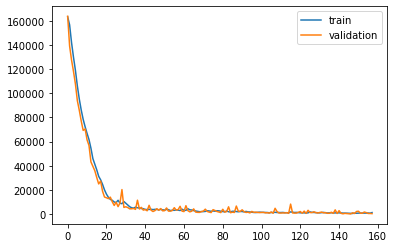

Epoch: 146, Train ELBO: -1237.439, Val ELBO: -38224.612


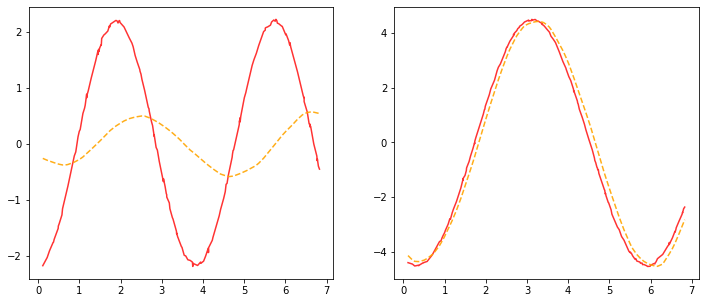

Current LR: [0.00047862223409330756]


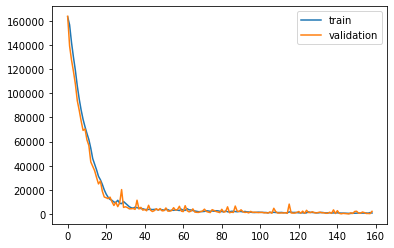

Epoch: 147, Train ELBO: -869.076, Val ELBO: -37865.045


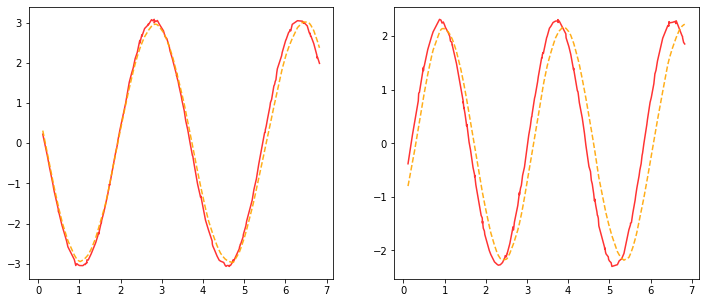

Current LR: [0.000476229122922841]


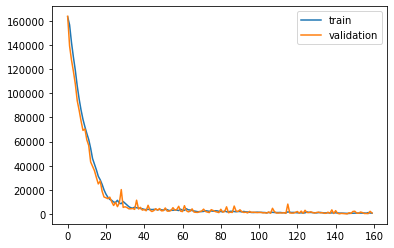

Epoch: 148, Train ELBO: -727.170, Val ELBO: -37494.841


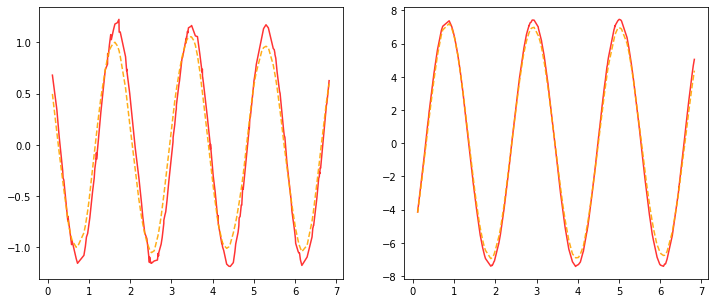

Current LR: [0.0004738479773082268]


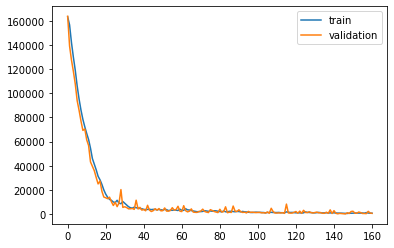

Epoch: 149, Train ELBO: -710.951, Val ELBO: -37125.883


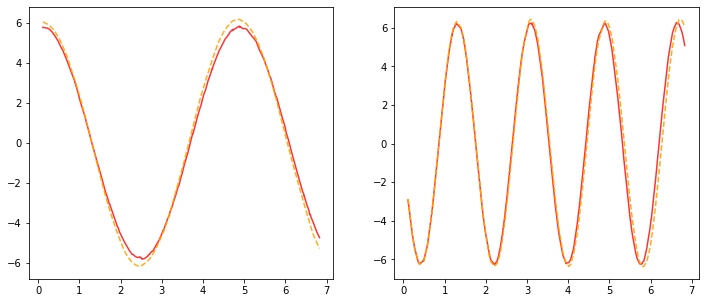

Current LR: [0.0004714787374216857]


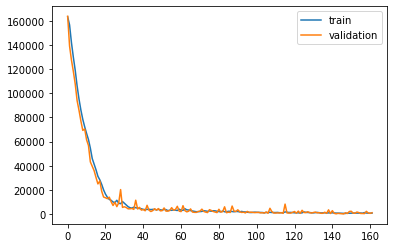

Epoch: 150, Train ELBO: -795.758, Val ELBO: -36765.422


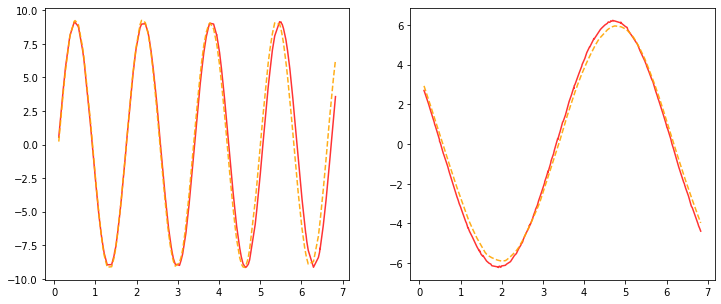

Current LR: [0.00046912134373457723]


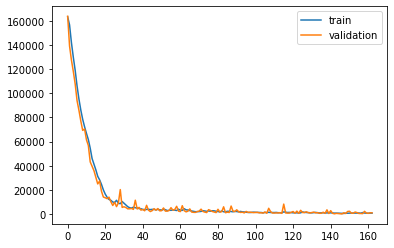

Epoch: 151, Train ELBO: -755.291, Val ELBO: -36407.724


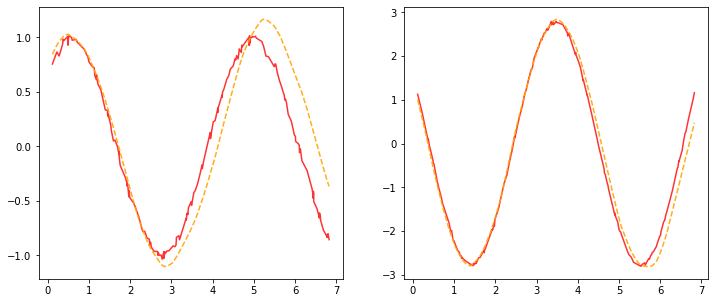

Current LR: [0.00046677573701590436]


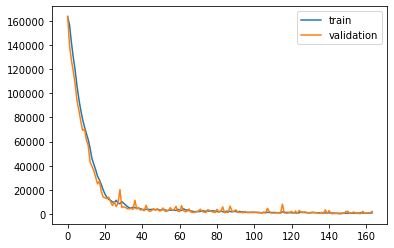

Epoch: 152, Train ELBO: -1015.245, Val ELBO: -36065.830


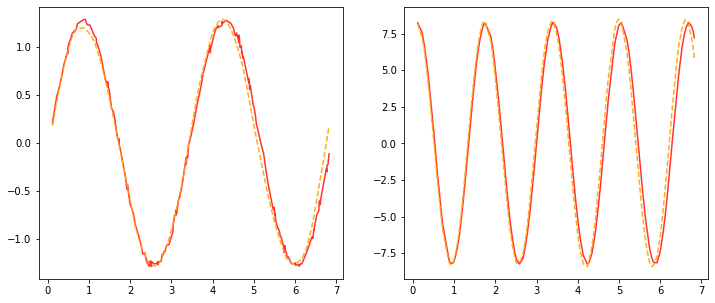

Current LR: [0.0004644418583308248]


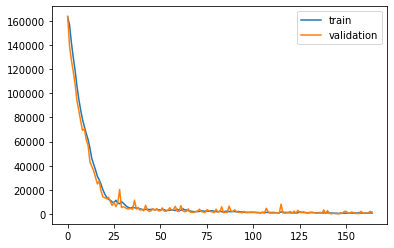

Epoch: 153, Train ELBO: -703.050, Val ELBO: -35722.346


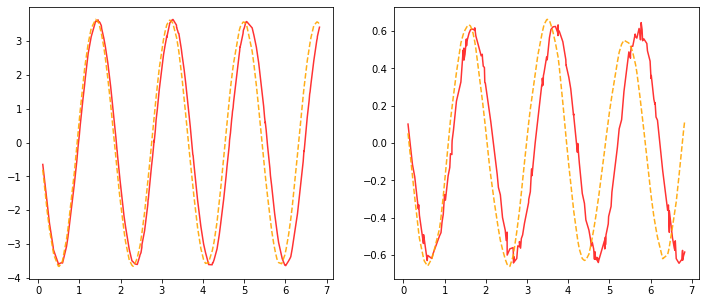

Current LR: [0.0004621196490391707]


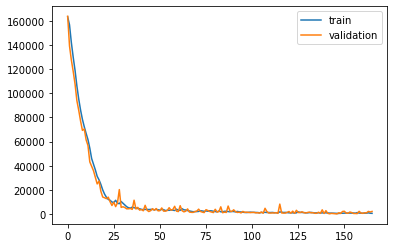

Epoch: 154, Train ELBO: -605.887, Val ELBO: -35386.914


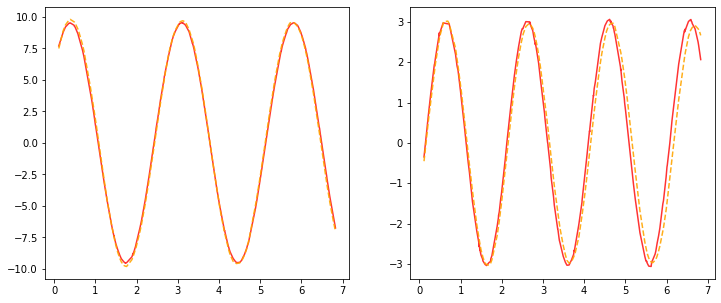

Current LR: [0.00045980905079397486]


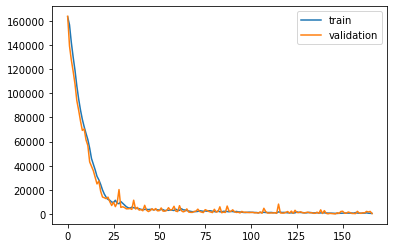

Epoch: 155, Train ELBO: -545.497, Val ELBO: -35036.969


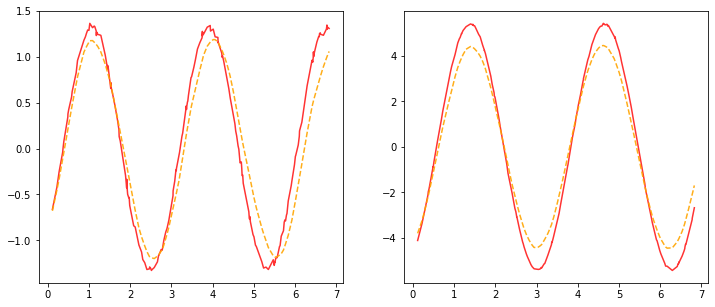

Current LR: [0.000457510005540005]


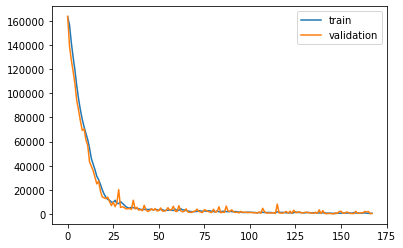

Epoch: 156, Train ELBO: -643.378, Val ELBO: -34691.901


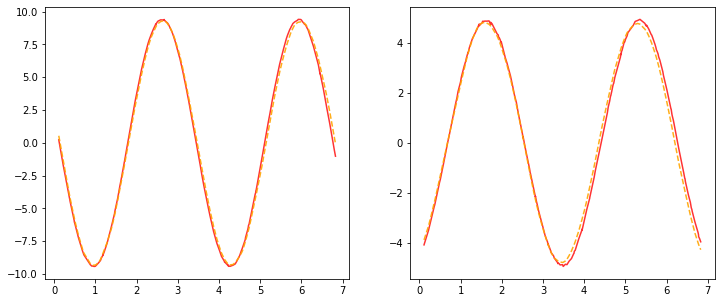

Current LR: [0.00045522245551230493]


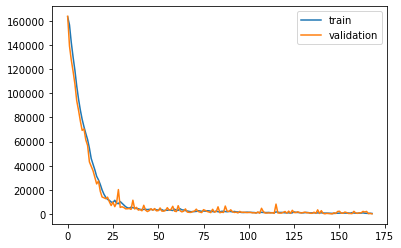

Epoch: 157, Train ELBO: -502.540, Val ELBO: -34346.898


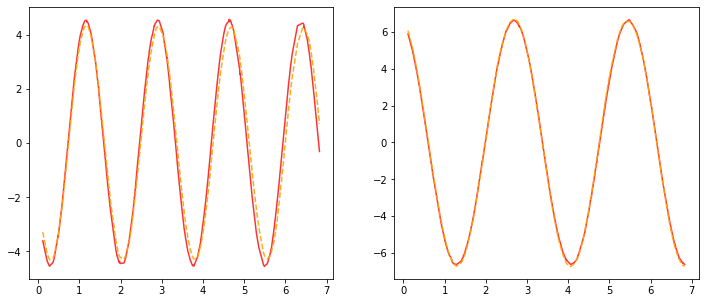

Current LR: [0.0004529463432347434]


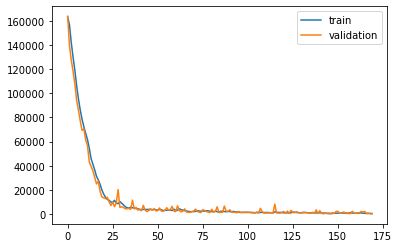

Epoch: 158, Train ELBO: -448.489, Val ELBO: -34005.336


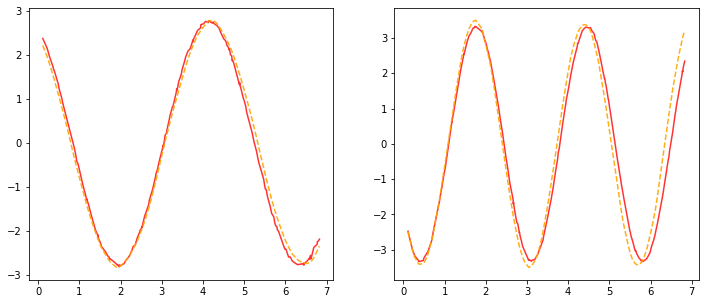

Current LR: [0.00045068161151856965]


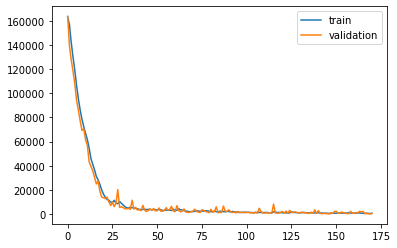

Epoch: 159, Train ELBO: -567.860, Val ELBO: -33671.105


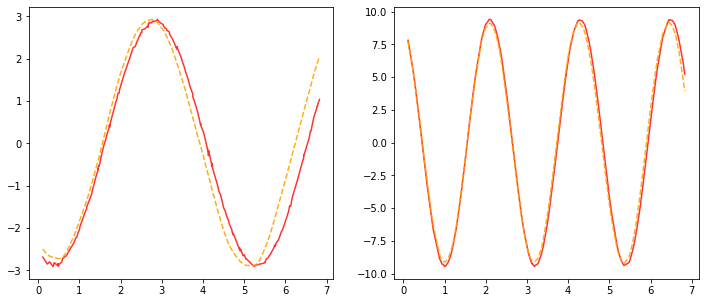

Current LR: [0.0004484282034609768]


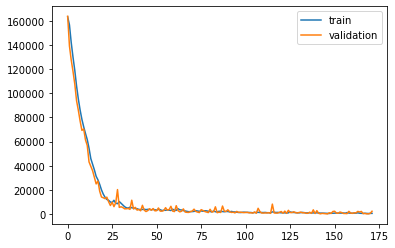

Epoch: 160, Train ELBO: -578.697, Val ELBO: -33357.908


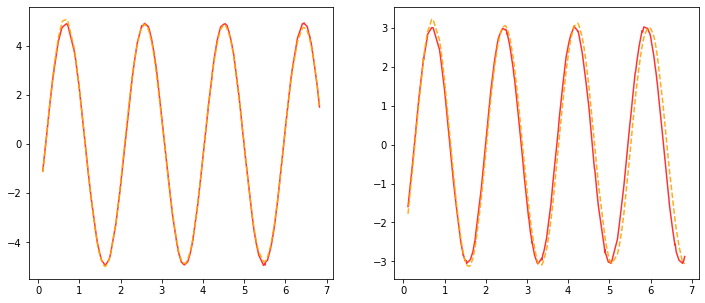

Current LR: [0.0004461860624436719]


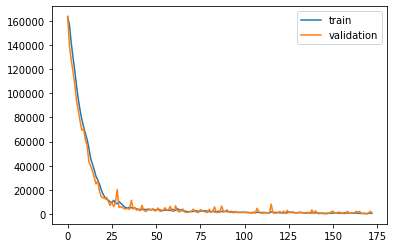

Epoch: 161, Train ELBO: -666.406, Val ELBO: -33031.754


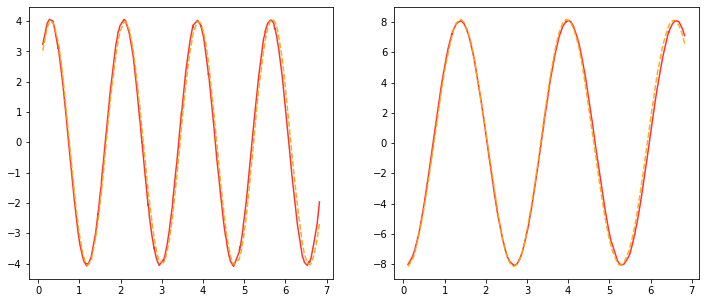

Current LR: [0.00044395513213145357]


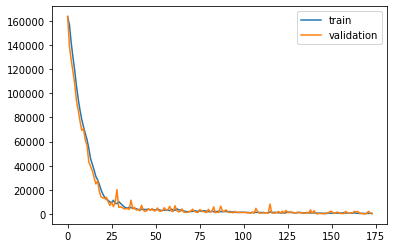

Epoch: 162, Train ELBO: -572.157, Val ELBO: -32703.914


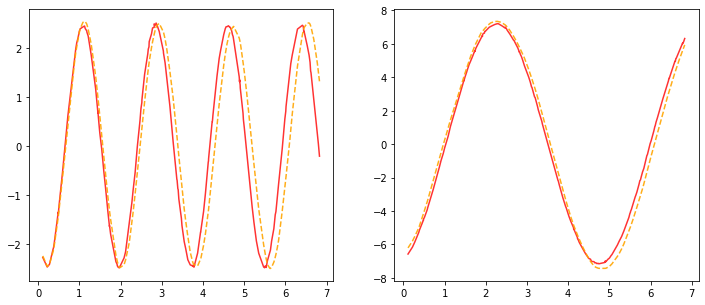

Current LR: [0.0004417353564707963]


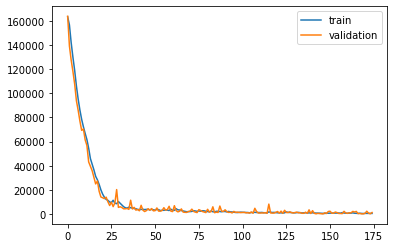

Epoch: 163, Train ELBO: -535.236, Val ELBO: -32389.630


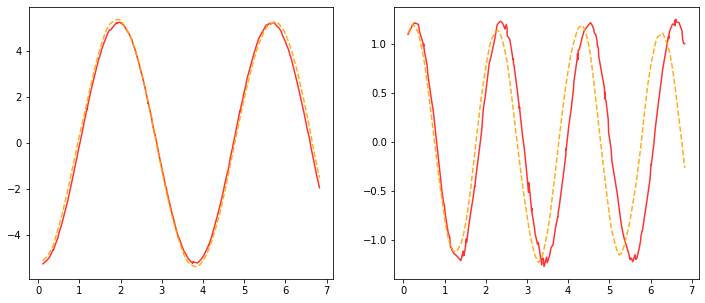

Current LR: [0.00043952667968844234]


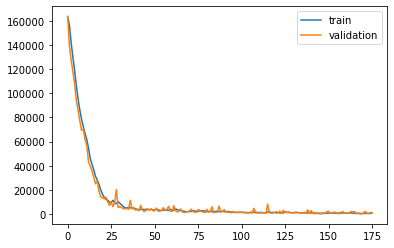

Epoch: 164, Train ELBO: -917.535, Val ELBO: -32076.425


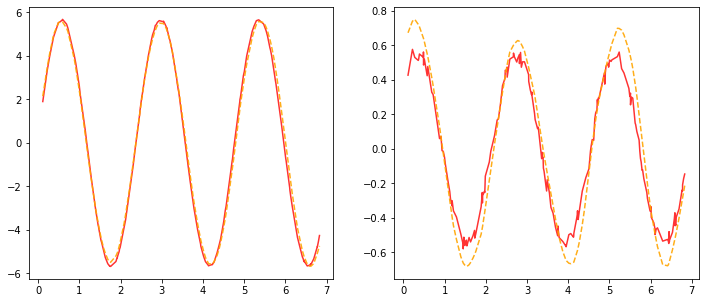

Current LR: [0.0004373290462900001]


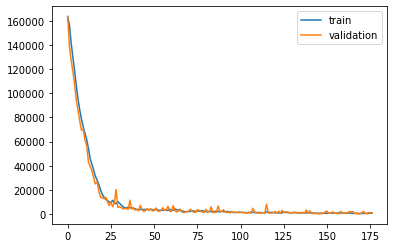

Epoch: 165, Train ELBO: -681.238, Val ELBO: -31764.314


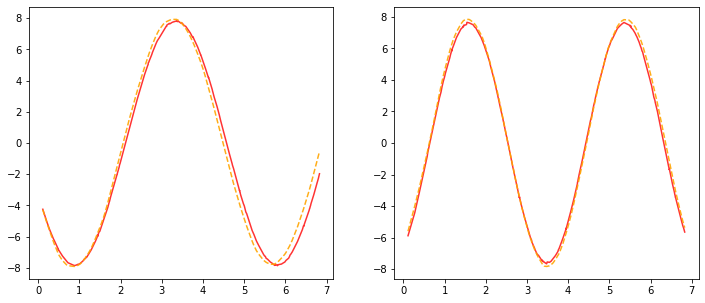

Current LR: [0.0004351424010585501]


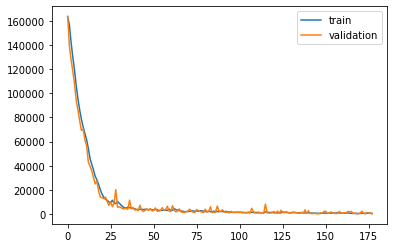

Epoch: 166, Train ELBO: -583.069, Val ELBO: -31447.664


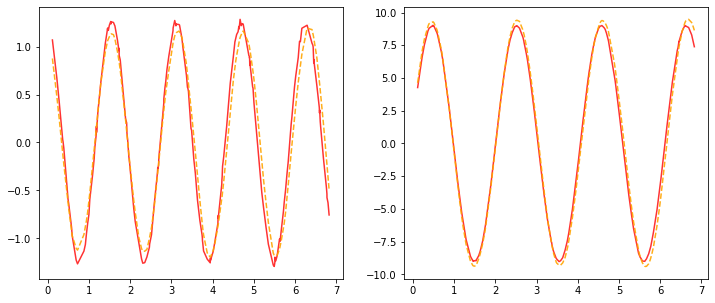

Current LR: [0.00043296668905325734]


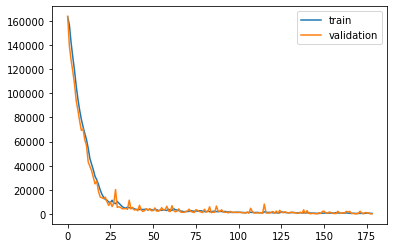

Epoch: 167, Train ELBO: -505.986, Val ELBO: -31135.776


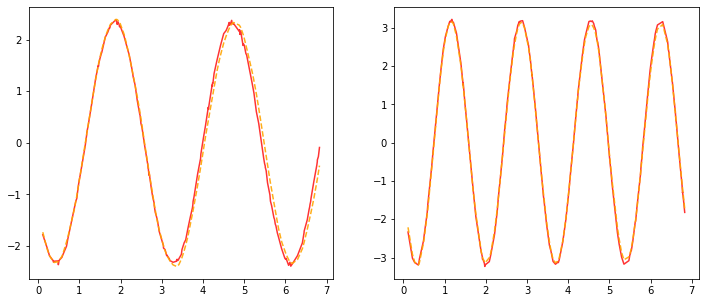

Current LR: [0.00043080185560799106]


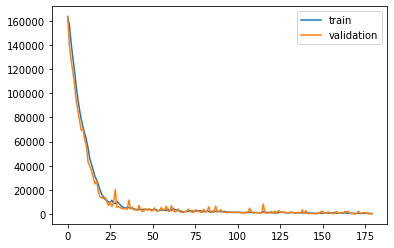

Epoch: 168, Train ELBO: -385.884, Val ELBO: -30826.576


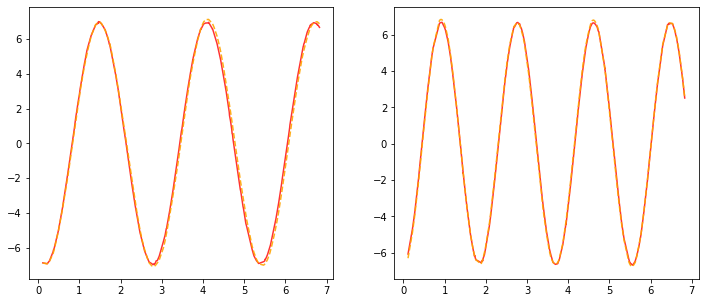

Current LR: [0.0004286478463299511]


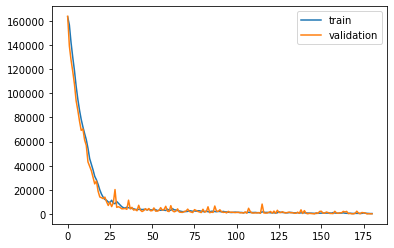

Epoch: 169, Train ELBO: -413.042, Val ELBO: -30520.054


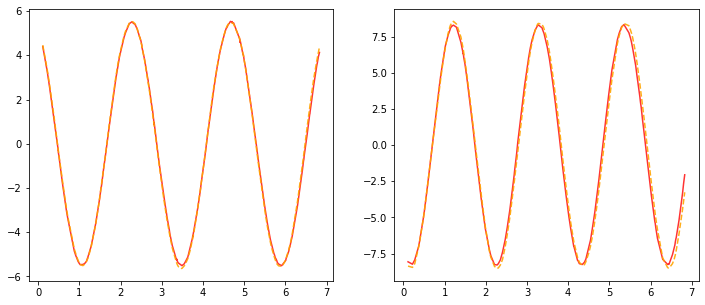

Current LR: [0.00042650460709830134]


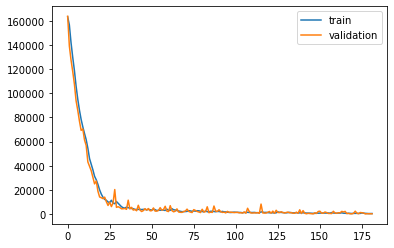

Epoch: 170, Train ELBO: -437.068, Val ELBO: -30216.895


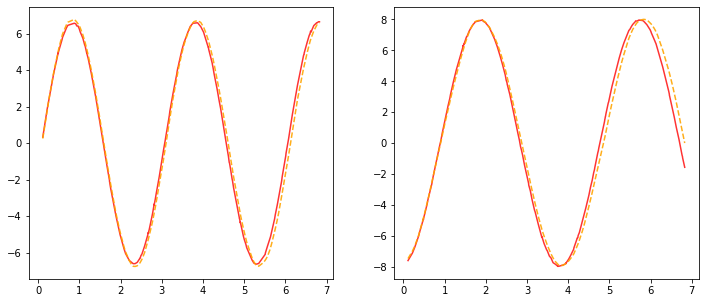

Current LR: [0.00042437208406280984]


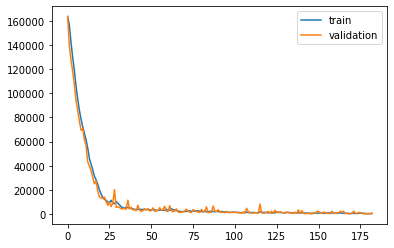

Epoch: 171, Train ELBO: -427.952, Val ELBO: -29921.280


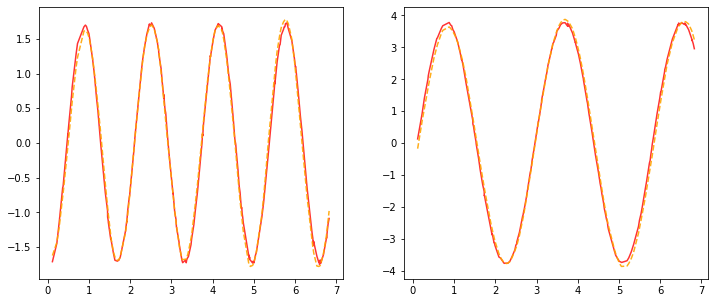

Current LR: [0.0004222502236424958]


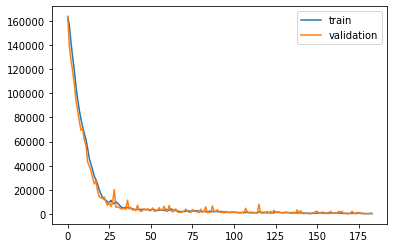

Epoch: 172, Train ELBO: -480.967, Val ELBO: -29624.894


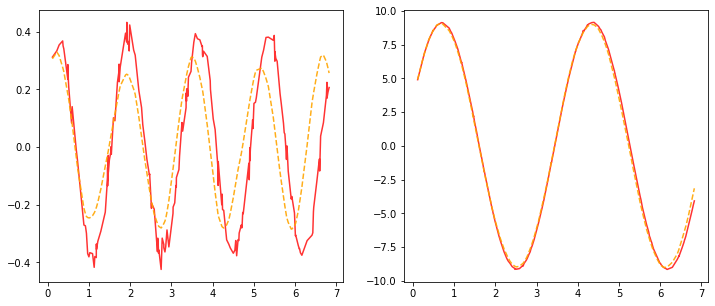

Current LR: [0.0004201389725242833]


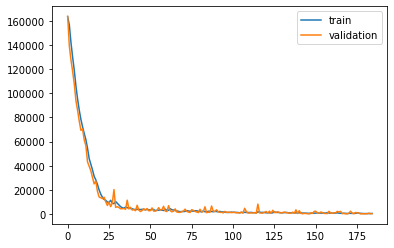

Epoch: 173, Train ELBO: -430.090, Val ELBO: -29332.083


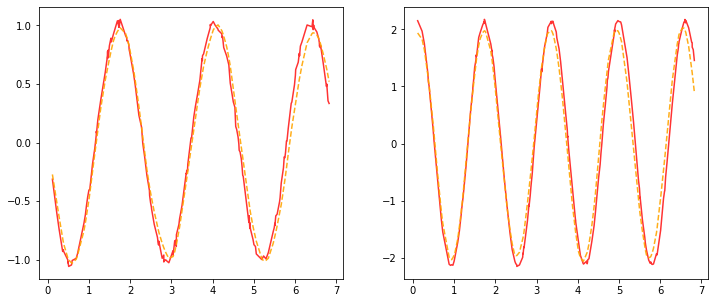

Current LR: [0.00041803827766166186]


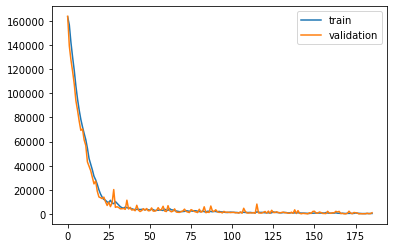

Epoch: 174, Train ELBO: -470.400, Val ELBO: -29049.075


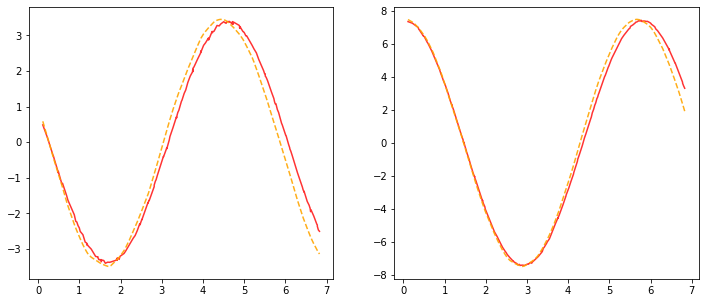

Current LR: [0.00041594808627335356]


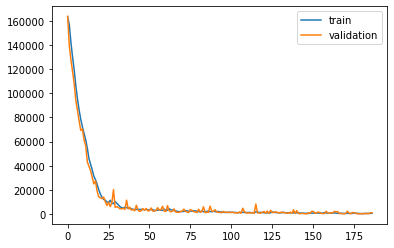

Epoch: 175, Train ELBO: -577.624, Val ELBO: -28768.207


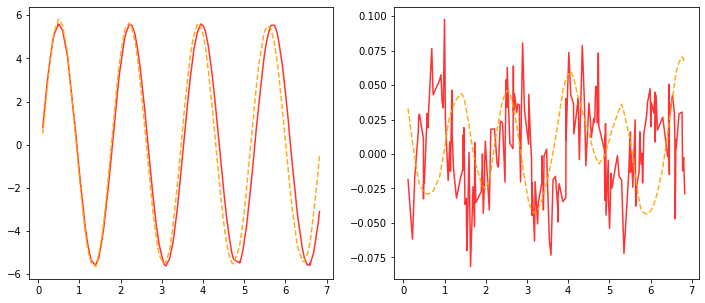

Current LR: [0.0004138683458419868]


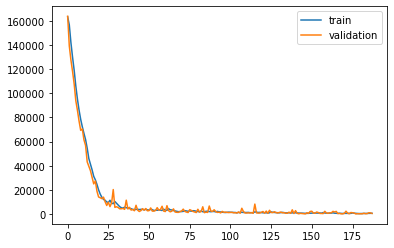

Epoch: 176, Train ELBO: -612.016, Val ELBO: -28485.504


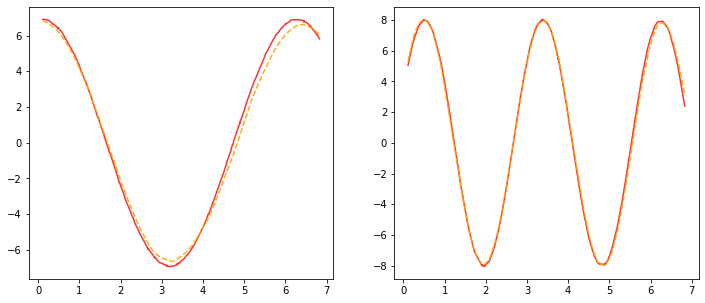

Current LR: [0.00041179900411277687]


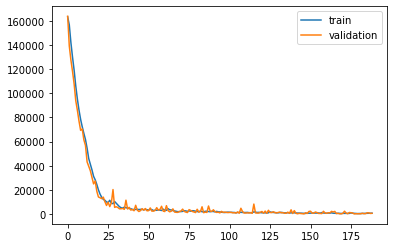

Epoch: 177, Train ELBO: -709.985, Val ELBO: -28206.797


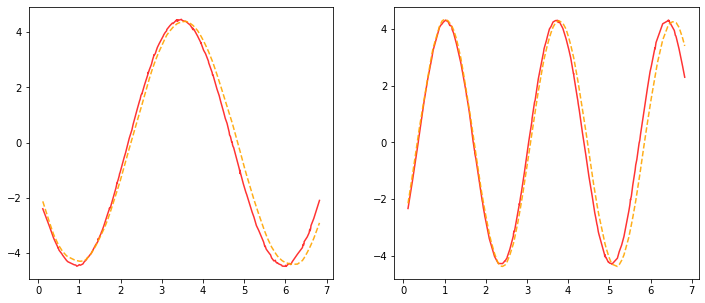

Current LR: [0.000409740009092213]


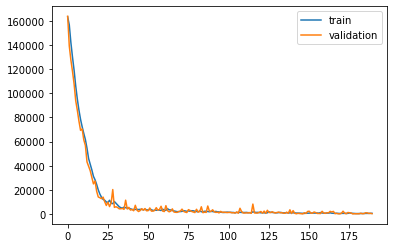

Epoch: 178, Train ELBO: -582.524, Val ELBO: -27927.973


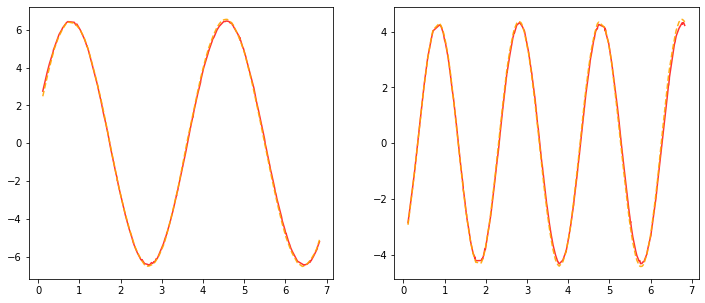

Current LR: [0.00040769130904675196]


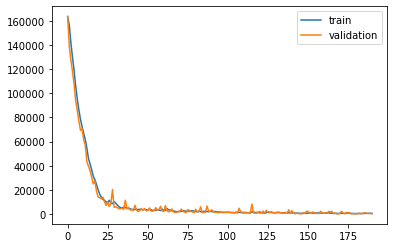

Epoch: 179, Train ELBO: -553.191, Val ELBO: -27651.019


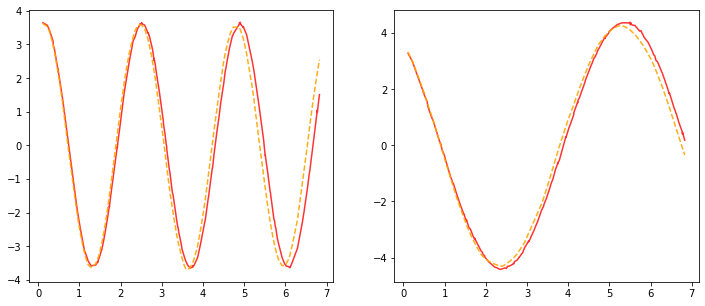

Current LR: [0.0004056528525015182]


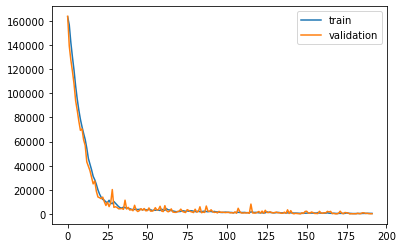

Epoch: 180, Train ELBO: -501.133, Val ELBO: -27377.304


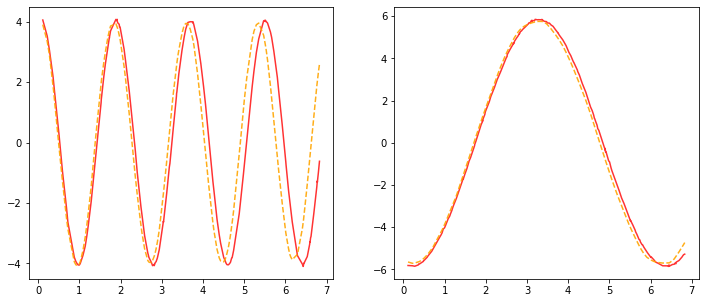

Current LR: [0.0004036245882390106]


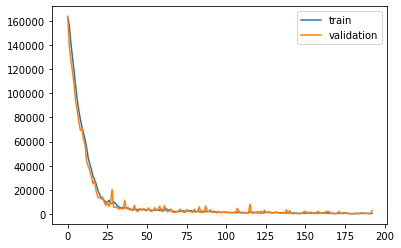

Epoch: 181, Train ELBO: -601.085, Val ELBO: -27132.316


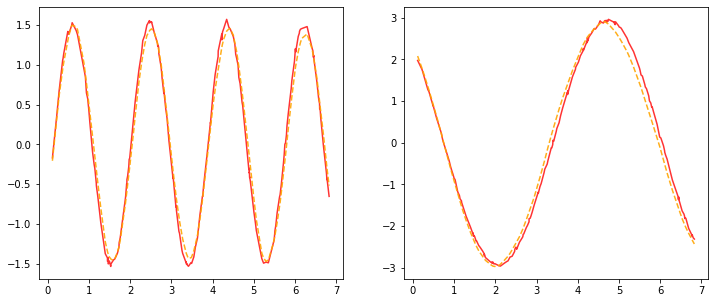

Current LR: [0.00040160646529781557]


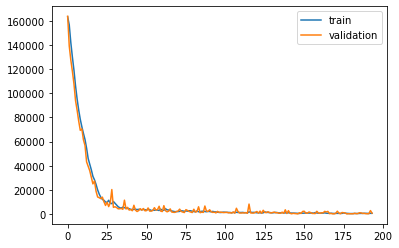

Epoch: 182, Train ELBO: -605.944, Val ELBO: -26868.038


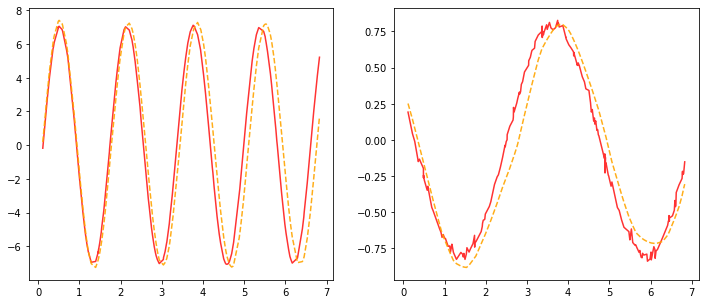

Current LR: [0.00039959843297132647]


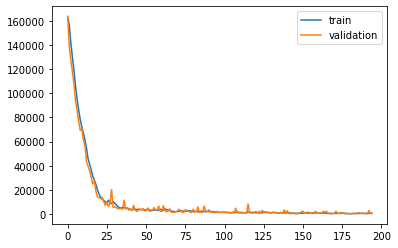

Epoch: 183, Train ELBO: -458.079, Val ELBO: -26606.045


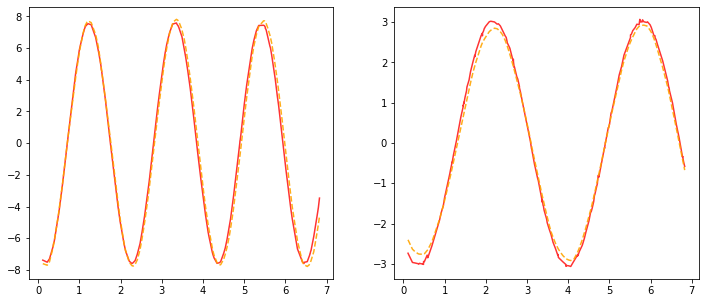

Current LR: [0.00039760044080646985]


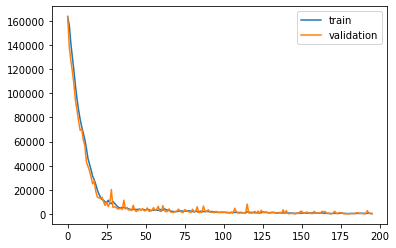

Epoch: 184, Train ELBO: -431.653, Val ELBO: -26341.559


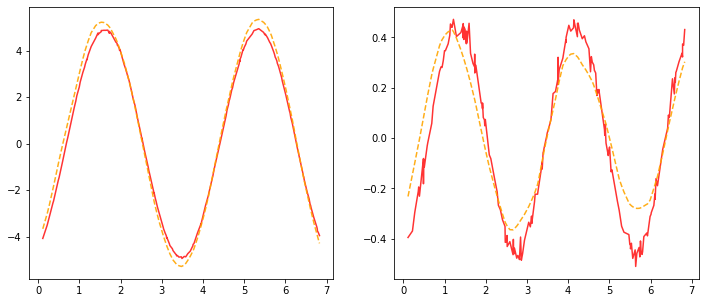

Current LR: [0.0003956124386024375]


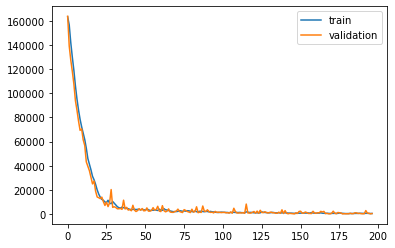

Epoch: 185, Train ELBO: -455.093, Val ELBO: -26082.375


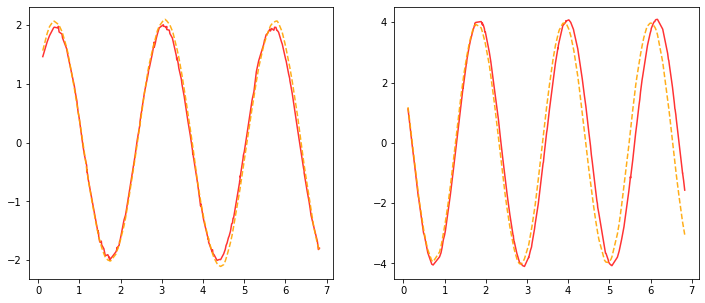

Current LR: [0.0003936343764094253]


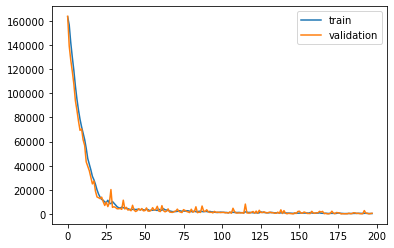

Epoch: 186, Train ELBO: -407.593, Val ELBO: -25827.917


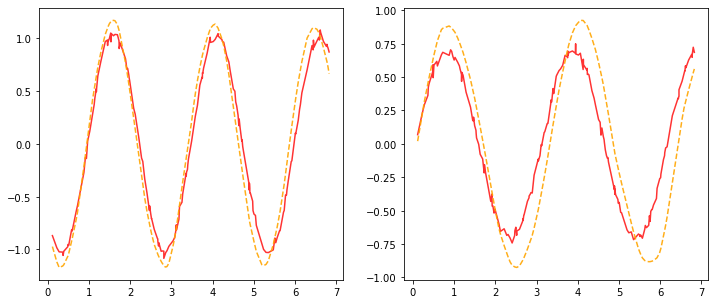

Current LR: [0.00039166620452737815]


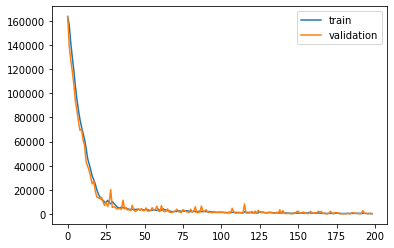

Epoch: 187, Train ELBO: -339.449, Val ELBO: -25571.160


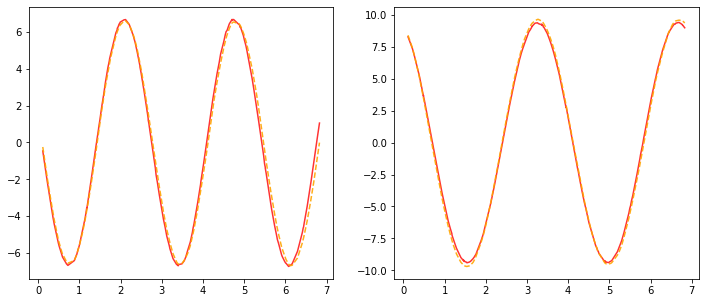

Current LR: [0.00038970787350474124]


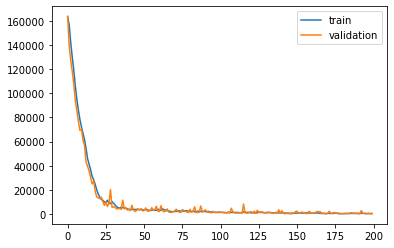

Epoch: 188, Train ELBO: -351.311, Val ELBO: -25320.343


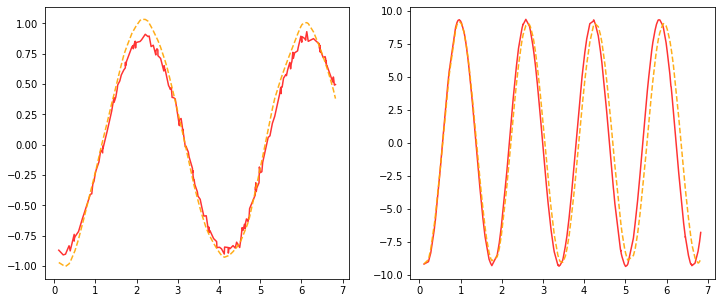

Current LR: [0.0003877593341372175]


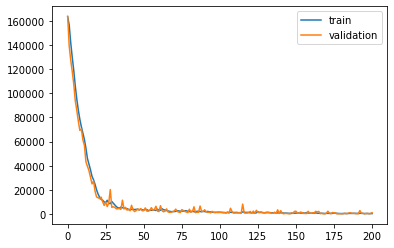

Epoch: 189, Train ELBO: -355.616, Val ELBO: -25078.282


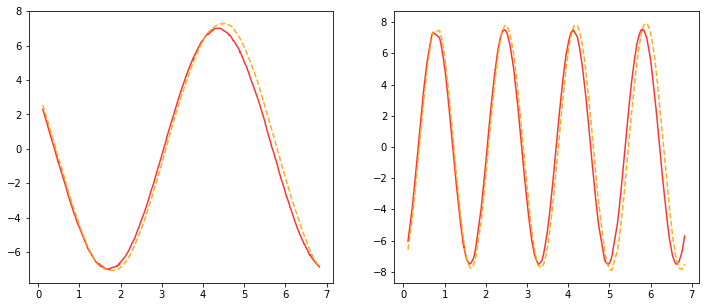

Current LR: [0.00038582053746653145]


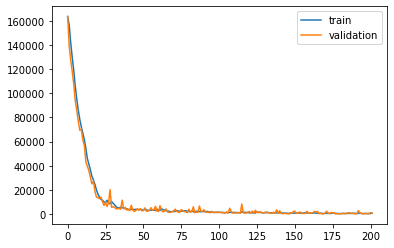

Epoch: 190, Train ELBO: -800.167, Val ELBO: -24833.555


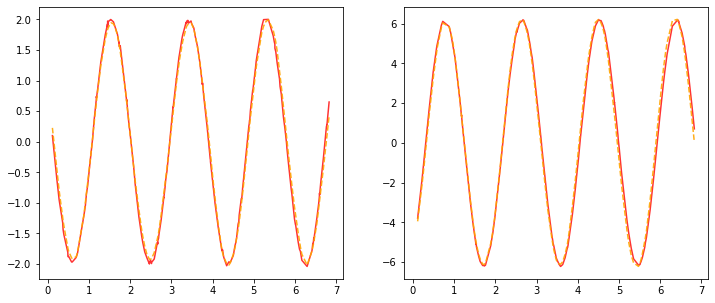

Current LR: [0.0003838914347791988]


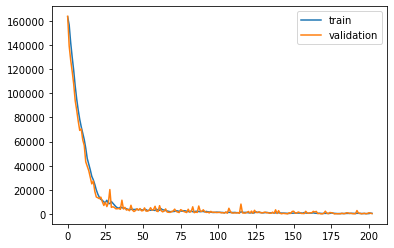

Epoch: 191, Train ELBO: -520.826, Val ELBO: -24589.362


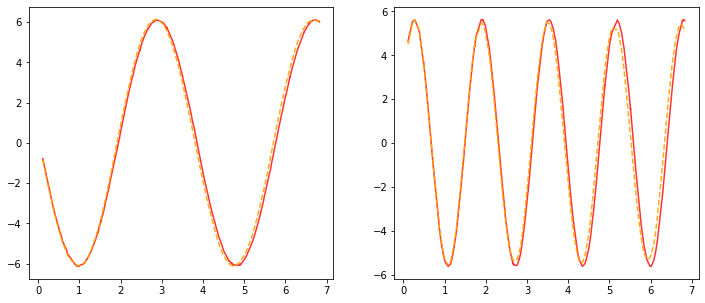

Current LR: [0.0003819719776053028]


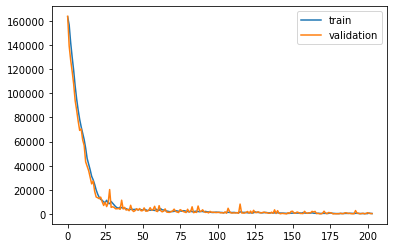

Epoch: 192, Train ELBO: -413.468, Val ELBO: -24347.236


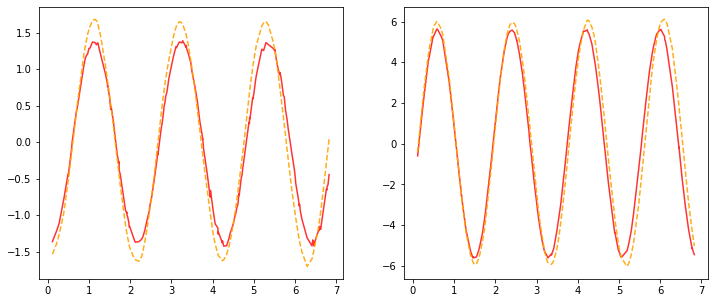

Current LR: [0.00038006211771727627]


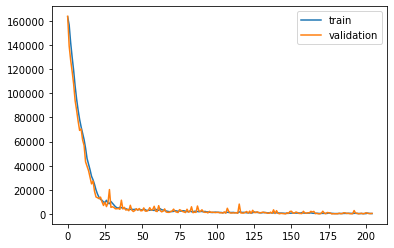

Epoch: 193, Train ELBO: -380.970, Val ELBO: -24109.075


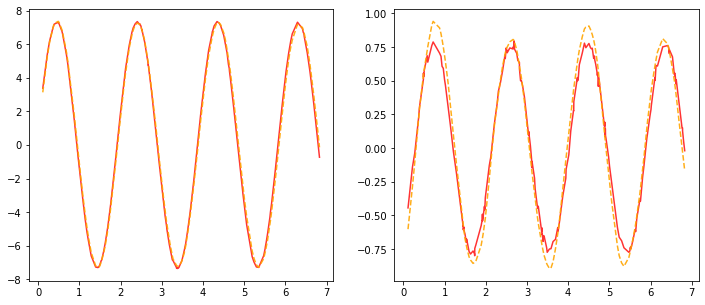

Current LR: [0.0003781618071286899]


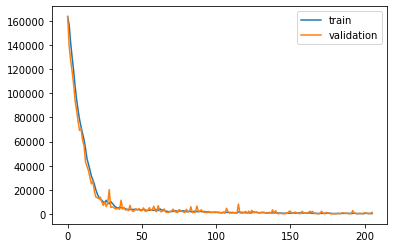

Epoch: 194, Train ELBO: -399.253, Val ELBO: -23882.087


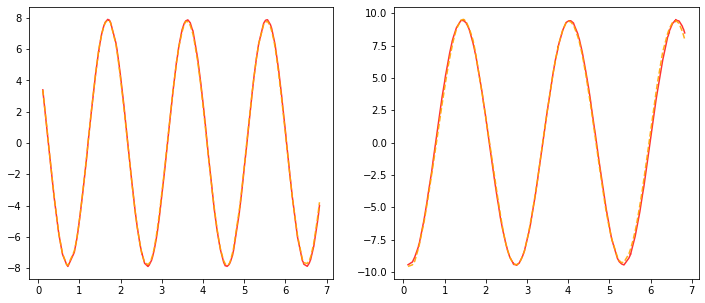

Current LR: [0.00037627099809304647]


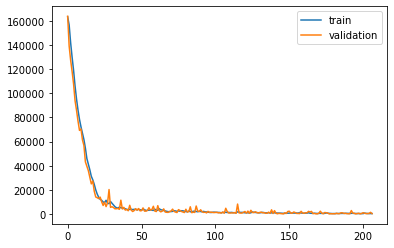

Epoch: 195, Train ELBO: -401.772, Val ELBO: -23646.531


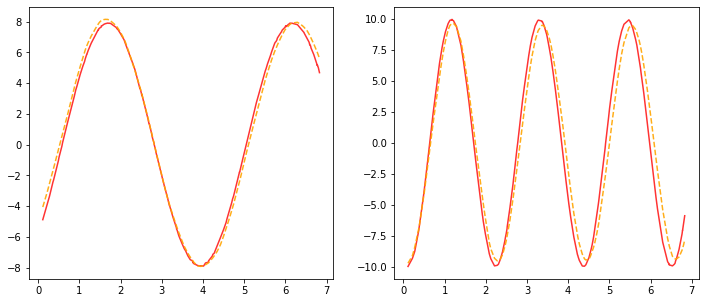

Current LR: [0.00037438964310258126]


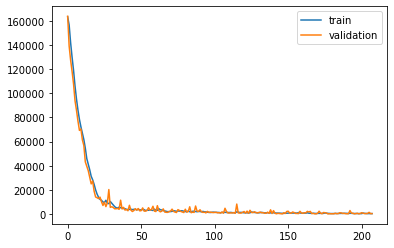

Epoch: 196, Train ELBO: -364.405, Val ELBO: -23413.728


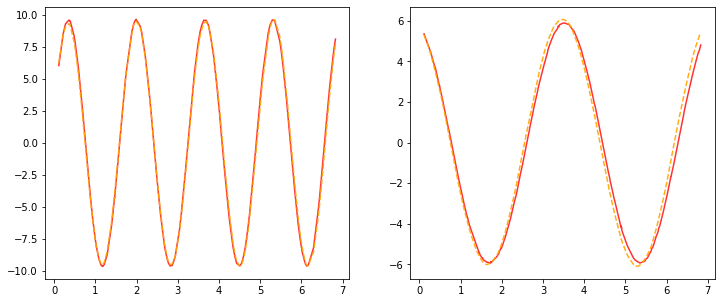

Current LR: [0.00037251769488706835]


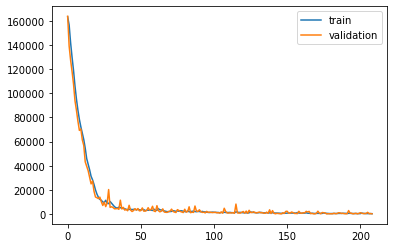

Epoch: 197, Train ELBO: -296.750, Val ELBO: -23181.749


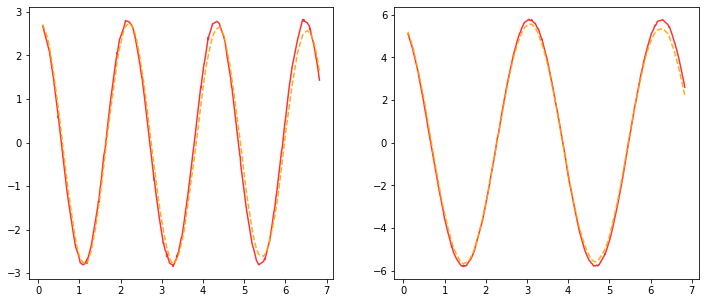

Current LR: [0.000370655106412633]


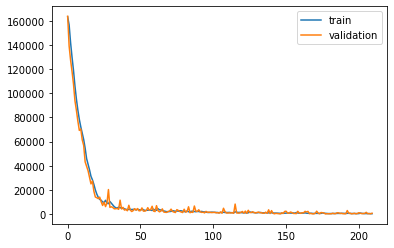

Epoch: 198, Train ELBO: -276.574, Val ELBO: -22956.549


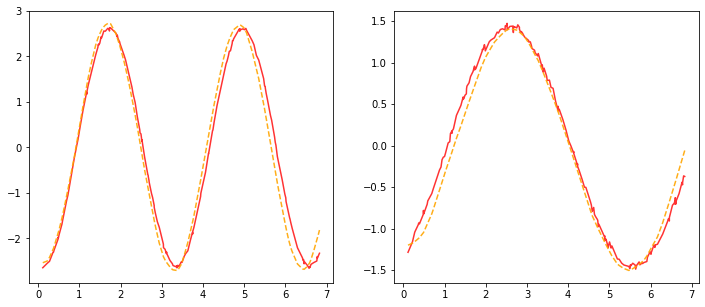

Current LR: [0.00036880183088056984]


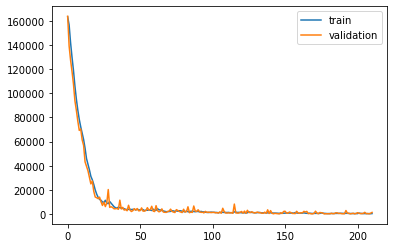

Epoch: 199, Train ELBO: -396.395, Val ELBO: -22740.456


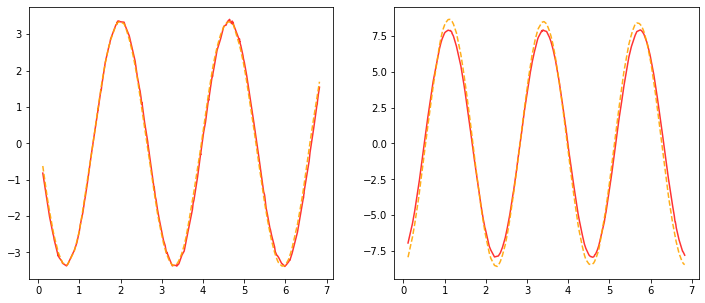

Current LR: [0.000366957821726167]


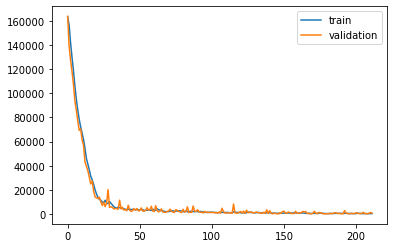

Epoch: 200, Train ELBO: -355.497, Val ELBO: -22519.550


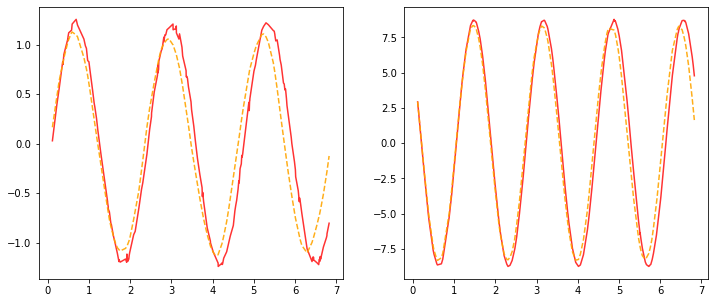

Current LR: [0.00036512303261753613]


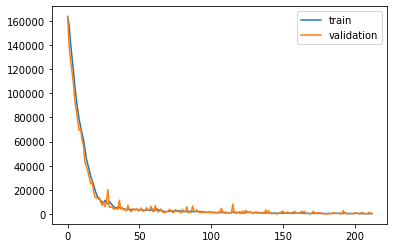

Epoch: 201, Train ELBO: -282.983, Val ELBO: -22297.986


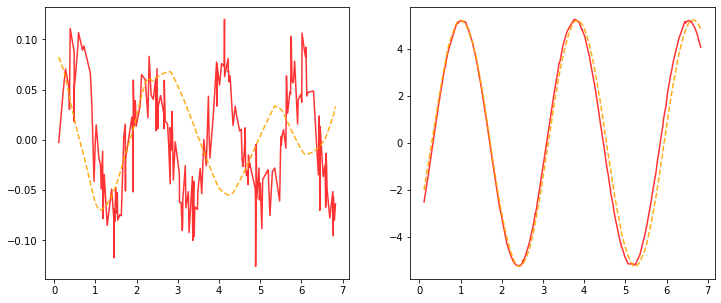

Current LR: [0.00036329741745444845]


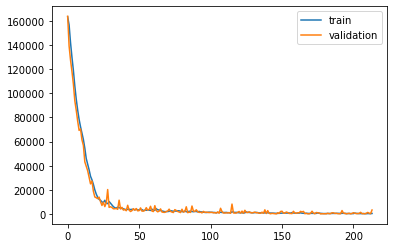

Epoch: 202, Train ELBO: -470.742, Val ELBO: -22108.350


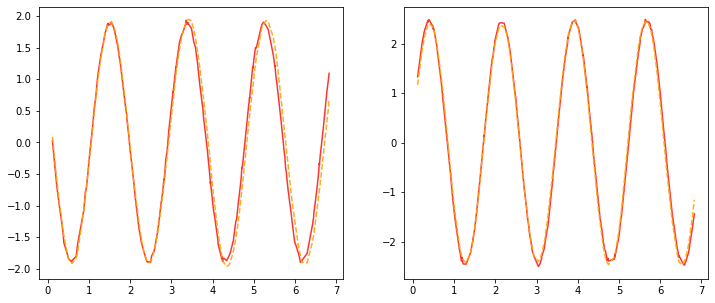

Current LR: [0.0003614809303671762]


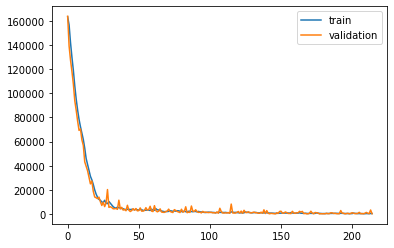

Epoch: 203, Train ELBO: -414.918, Val ELBO: -21889.765


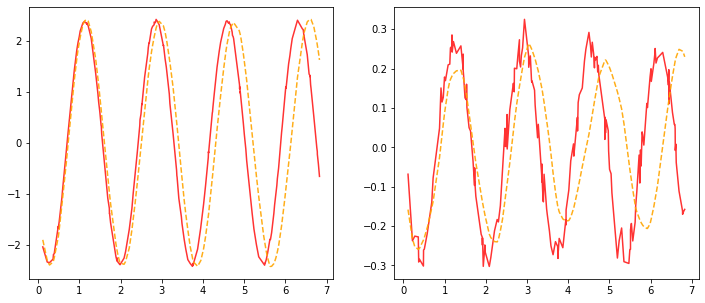

Current LR: [0.0003596735257153403]


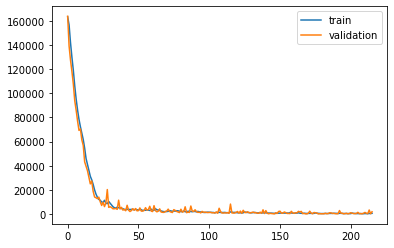

Epoch: 204, Train ELBO: -602.400, Val ELBO: -21689.811


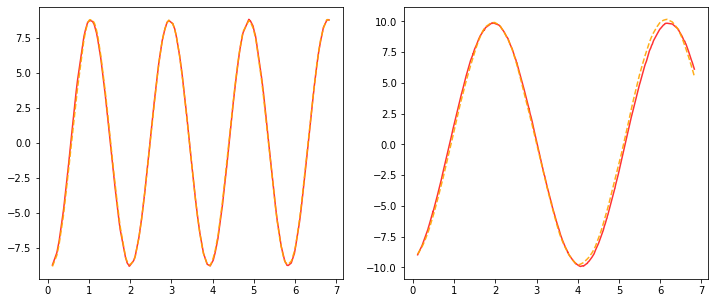

Current LR: [0.00035787515808676363]


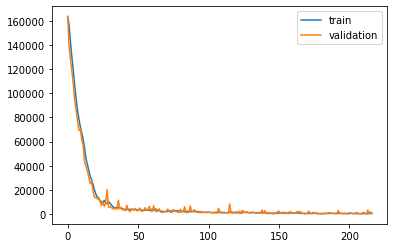

Epoch: 205, Train ELBO: -496.661, Val ELBO: -21477.255


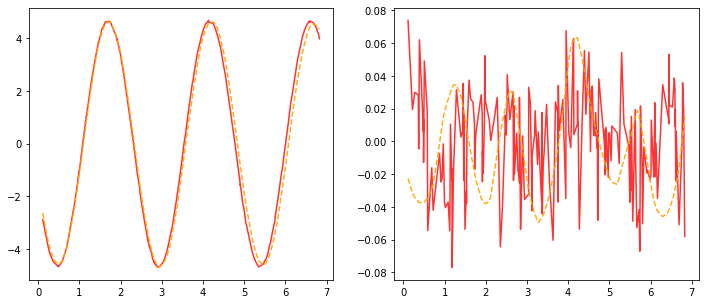

Current LR: [0.00035608578229632984]


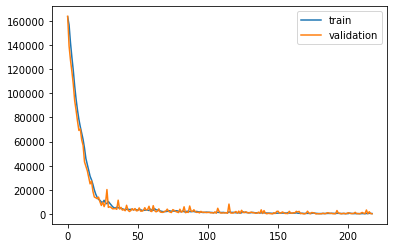

Epoch: 206, Train ELBO: -422.935, Val ELBO: -21264.616


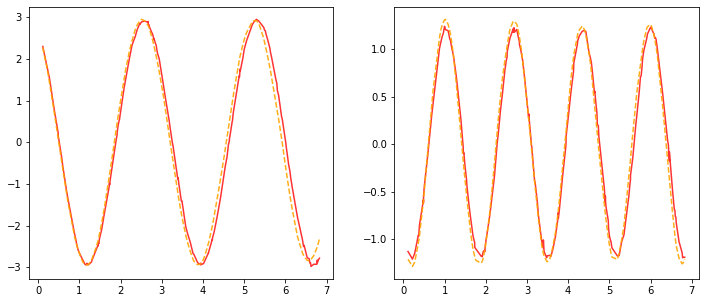

Current LR: [0.0003543053533848482]


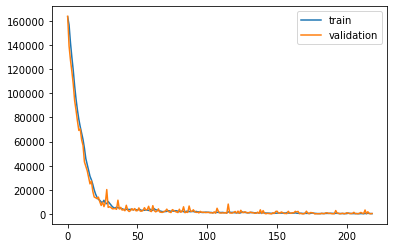

Epoch: 207, Train ELBO: -324.190, Val ELBO: -21056.494


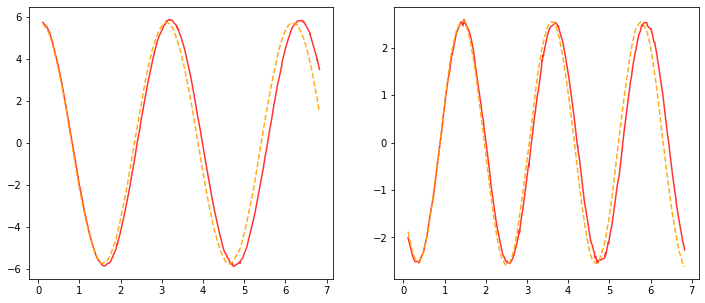

Current LR: [0.00035253382661792394]


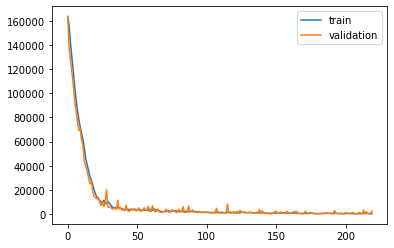

Epoch: 208, Train ELBO: -307.007, Val ELBO: -20870.731


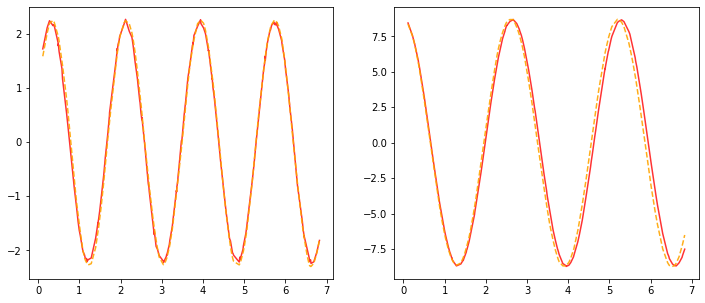

Current LR: [0.0003507711574848343]


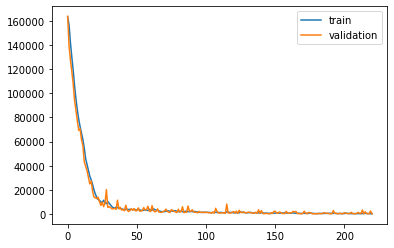

Epoch: 209, Train ELBO: -320.139, Val ELBO: -20663.055


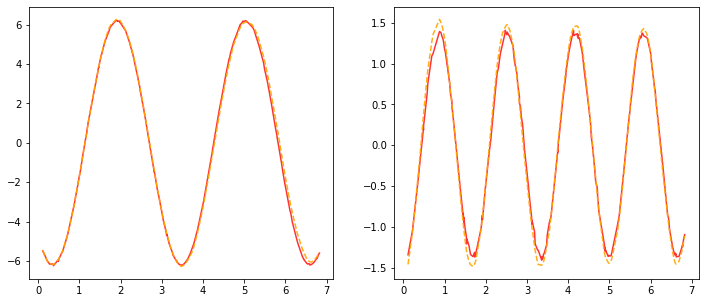

Current LR: [0.00034901730169741013]


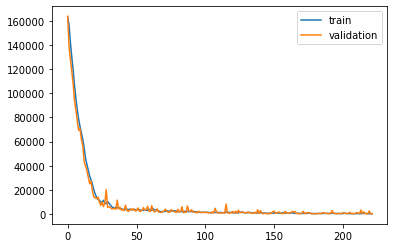

Epoch: 210, Train ELBO: -278.466, Val ELBO: -20460.266


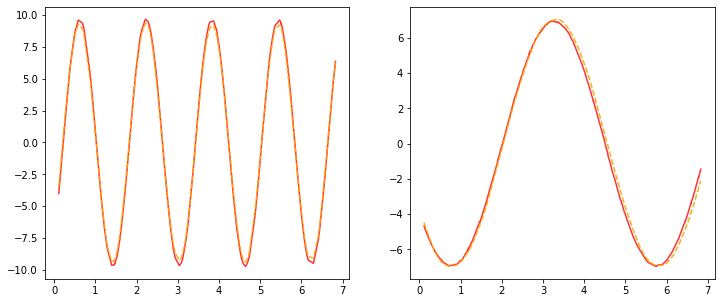

Current LR: [0.0003472722151889231]


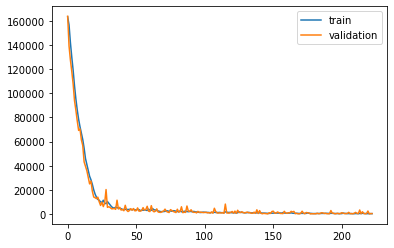

Epoch: 211, Train ELBO: -333.260, Val ELBO: -20259.513


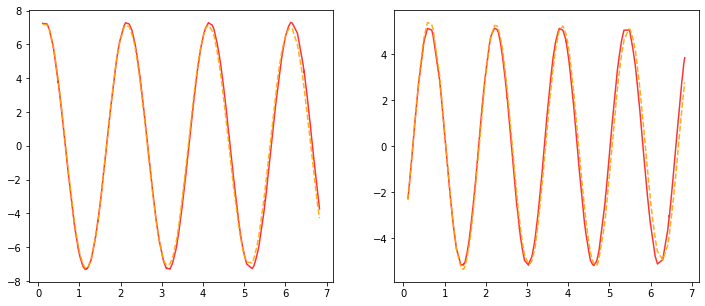

Current LR: [0.0003455358541129785]


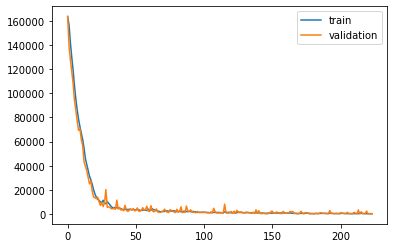

Epoch: 212, Train ELBO: -230.667, Val ELBO: -20059.969


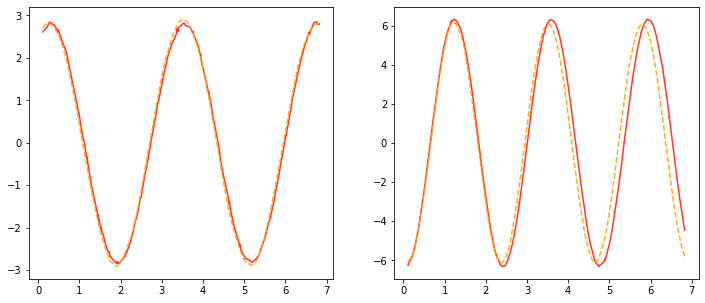

Current LR: [0.0003438081748424136]


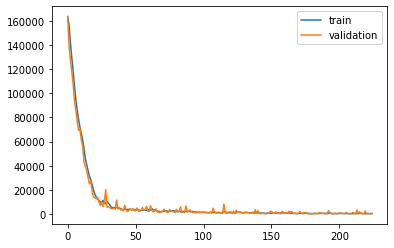

Epoch: 213, Train ELBO: -302.974, Val ELBO: -19866.935


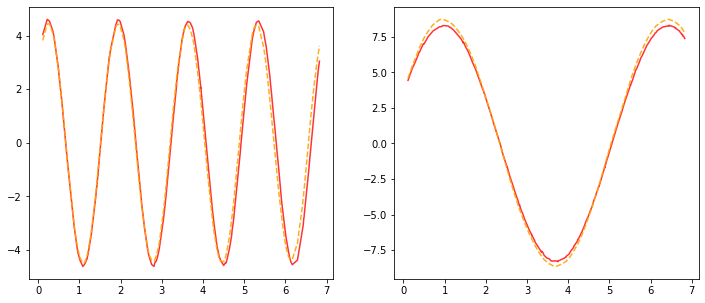

Current LR: [0.0003420891339682015]


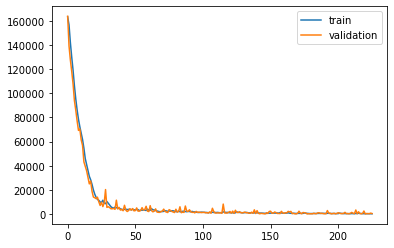

Epoch: 214, Train ELBO: -232.739, Val ELBO: -19672.419


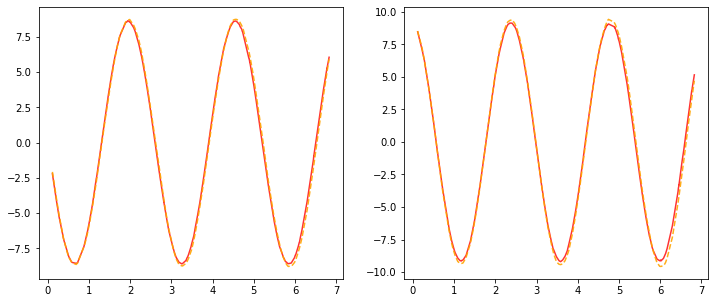

Current LR: [0.0003403786882983605]


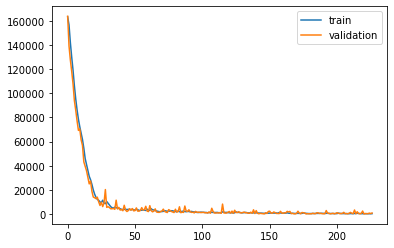

Epoch: 215, Train ELBO: -324.130, Val ELBO: -19484.195


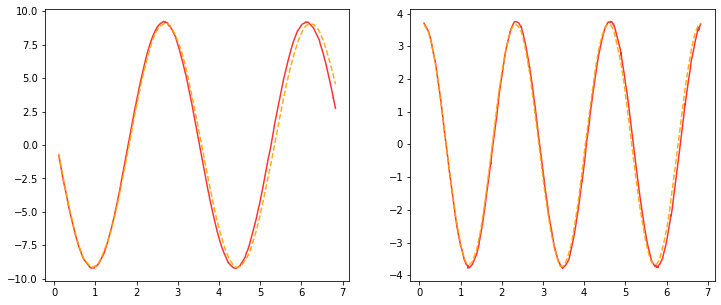

Current LR: [0.0003386767948568687]


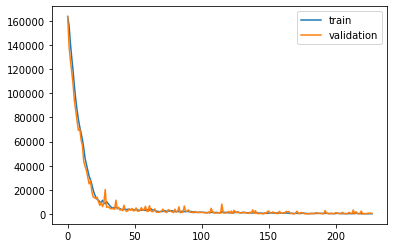

Epoch: 216, Train ELBO: -311.151, Val ELBO: -19291.774


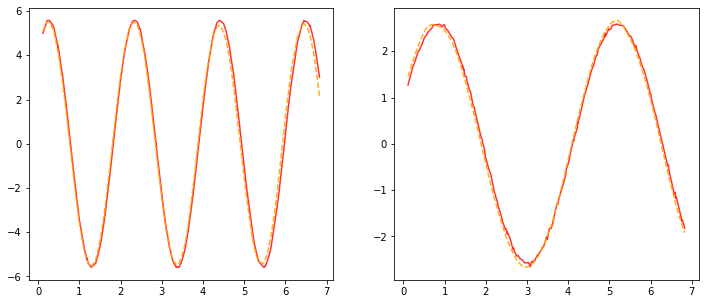

Current LR: [0.00033698341088258437]


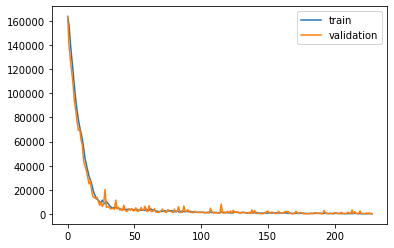

Epoch: 217, Train ELBO: -303.323, Val ELBO: -19099.495


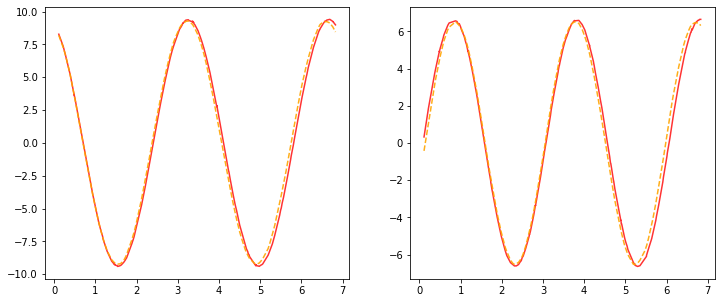

Current LR: [0.00033529849382817143]


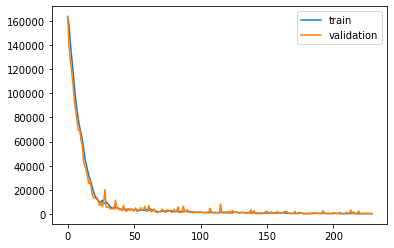

Epoch: 218, Train ELBO: -273.098, Val ELBO: -18911.182


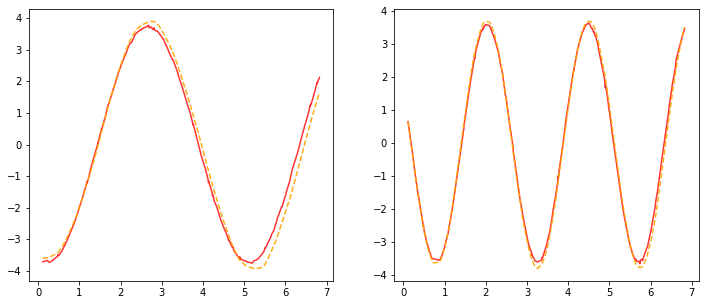

Current LR: [0.00033362200135903056]


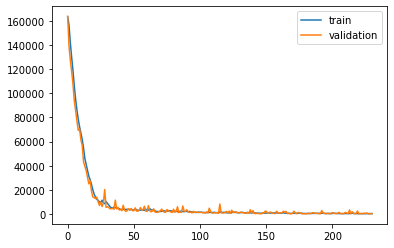

Epoch: 219, Train ELBO: -341.322, Val ELBO: -18723.839


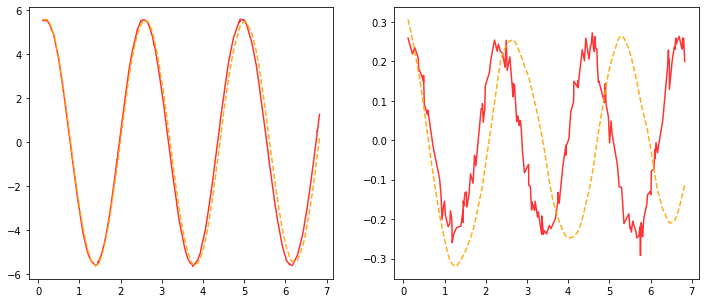

Current LR: [0.0003319538913522354]


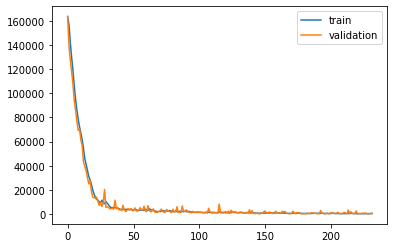

Epoch: 220, Train ELBO: -337.368, Val ELBO: -18543.973


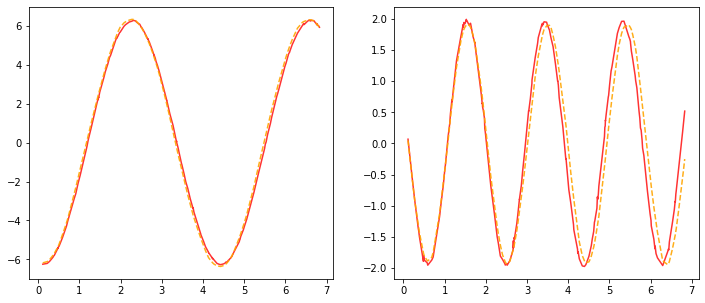

Current LR: [0.00033029412189547426]


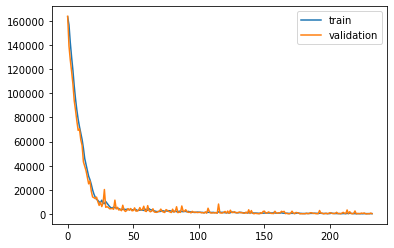

Epoch: 221, Train ELBO: -306.656, Val ELBO: -18361.134


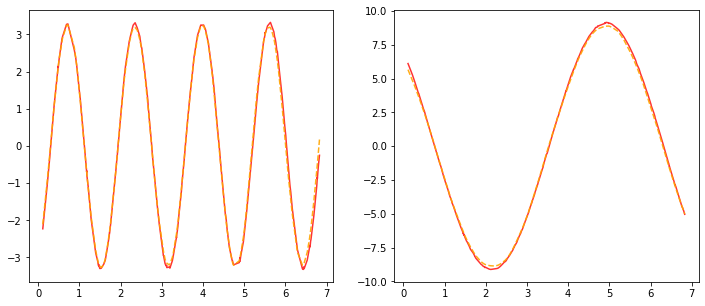

Current LR: [0.0003286426512859969]


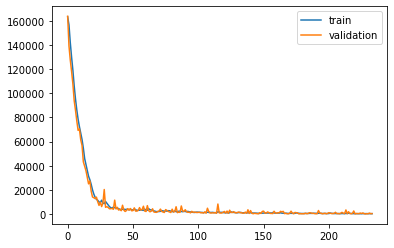

Epoch: 222, Train ELBO: -270.418, Val ELBO: -18180.828


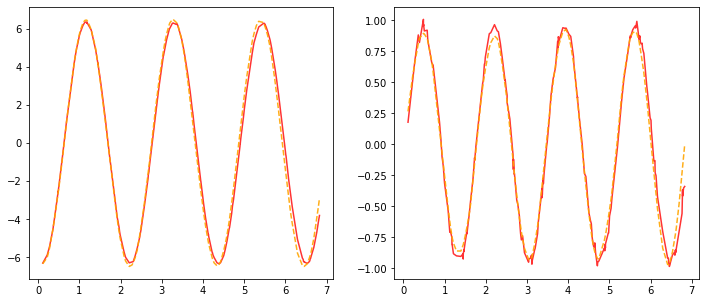

Current LR: [0.0003269994380295669]


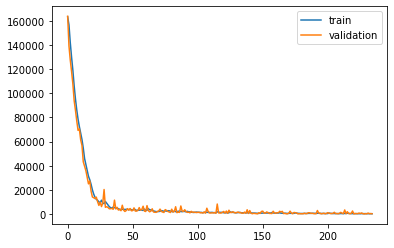

Epoch: 223, Train ELBO: -218.474, Val ELBO: -18001.383


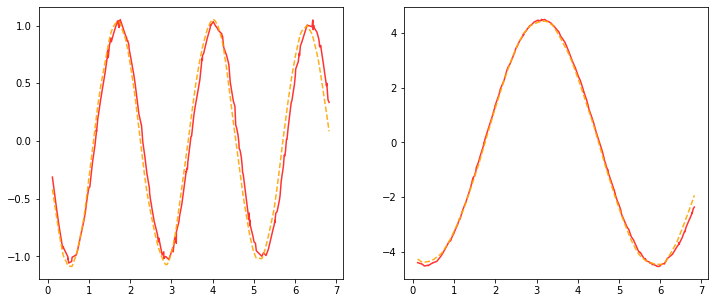

Current LR: [0.0003253644408394191]


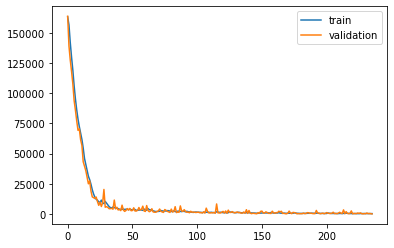

Epoch: 224, Train ELBO: -262.146, Val ELBO: -17821.398


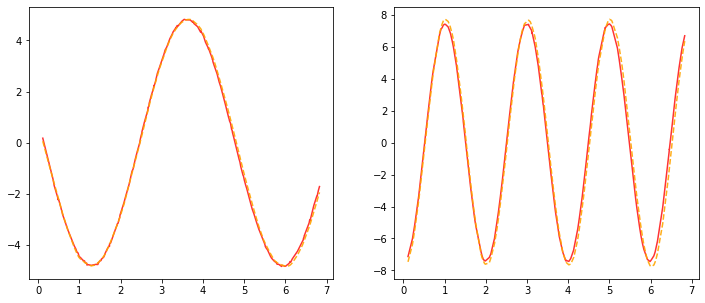

Current LR: [0.000323737618635222]


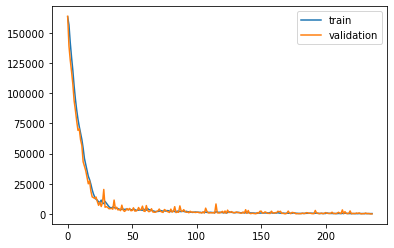

Epoch: 225, Train ELBO: -298.844, Val ELBO: -17643.458


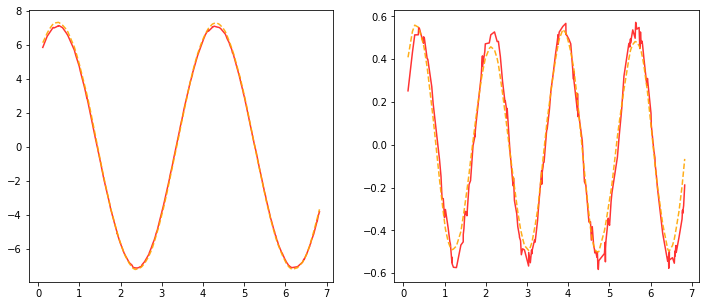

Current LR: [0.00032211893054204585]


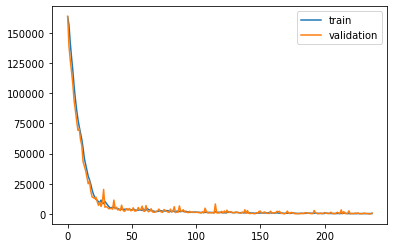

Epoch: 226, Train ELBO: -350.862, Val ELBO: -17474.670


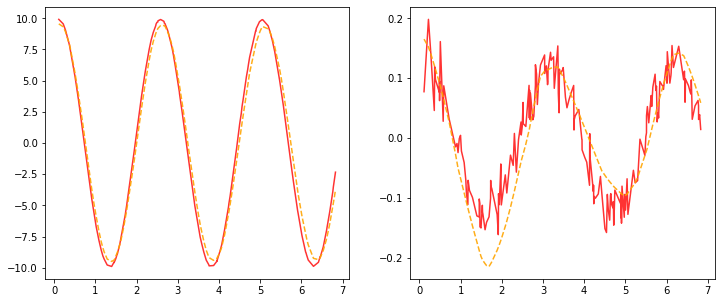

Current LR: [0.0003205083358893356]


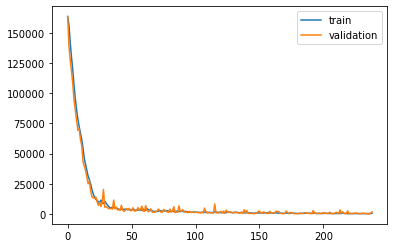

Epoch: 227, Train ELBO: -627.620, Val ELBO: -17316.234


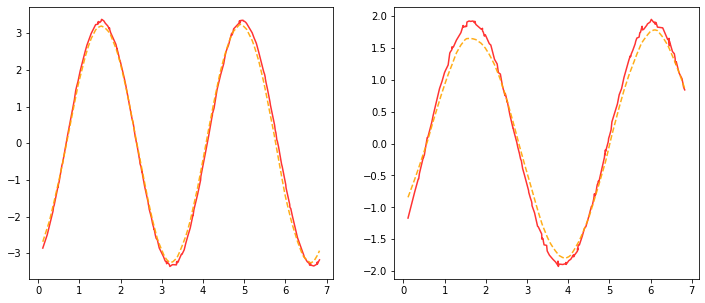

Current LR: [0.0003189057942098889]


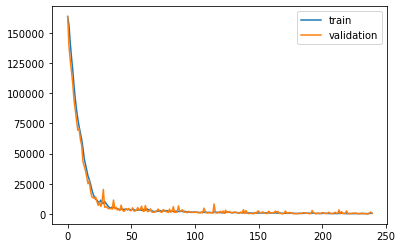

Epoch: 228, Train ELBO: -620.981, Val ELBO: -17146.492


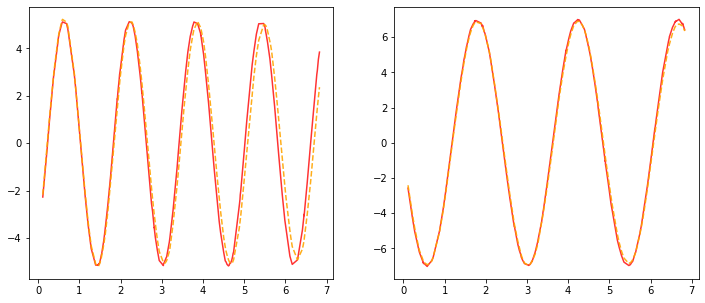

Current LR: [0.00031731126523883944]


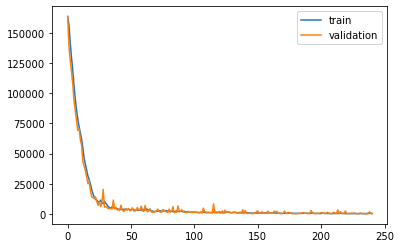

Epoch: 229, Train ELBO: -398.127, Val ELBO: -16976.780


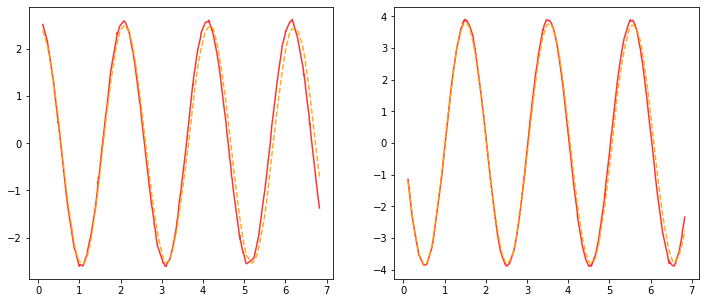

Current LR: [0.00031572470891264525]


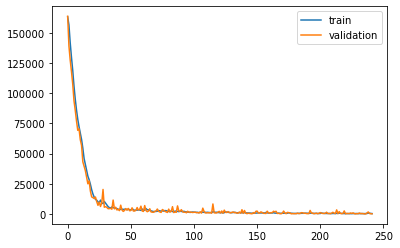

Epoch: 230, Train ELBO: -293.848, Val ELBO: -16808.089


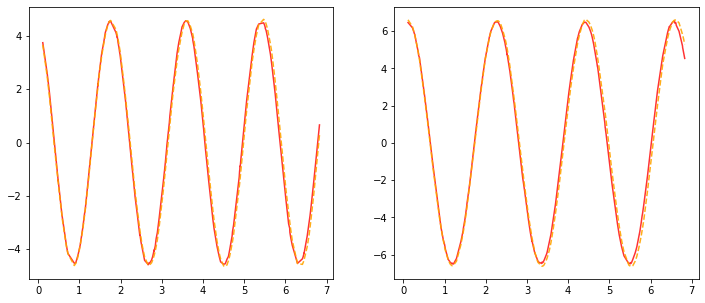

Current LR: [0.000314146085368082]


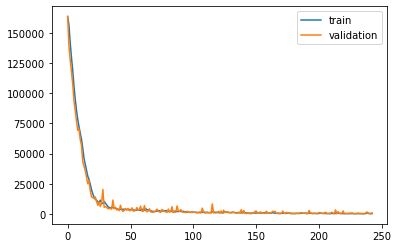

Epoch: 231, Train ELBO: -252.223, Val ELBO: -16648.872


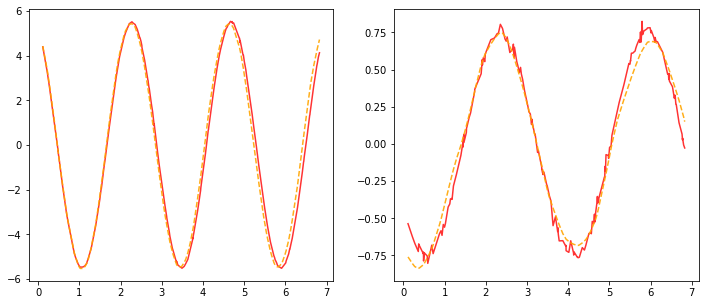

Current LR: [0.0003125753549412416]


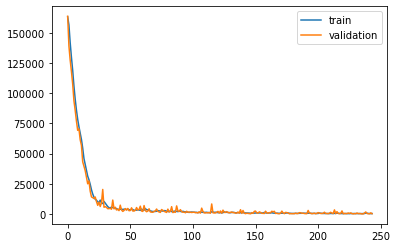

Epoch: 232, Train ELBO: -322.482, Val ELBO: -16483.897


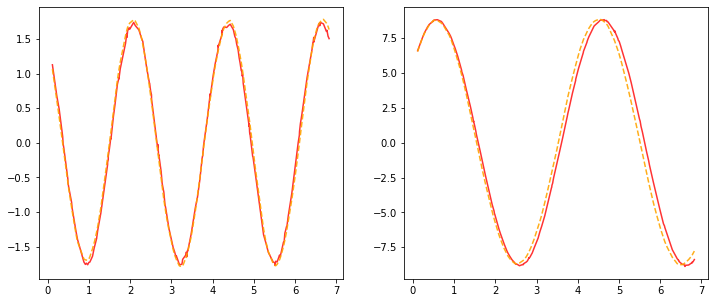

Current LR: [0.0003110124781665354]


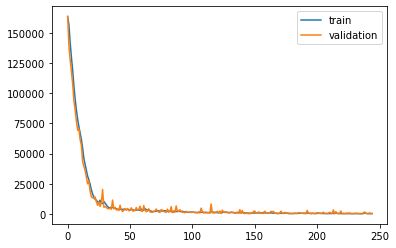

Epoch: 233, Train ELBO: -334.049, Val ELBO: -16320.939


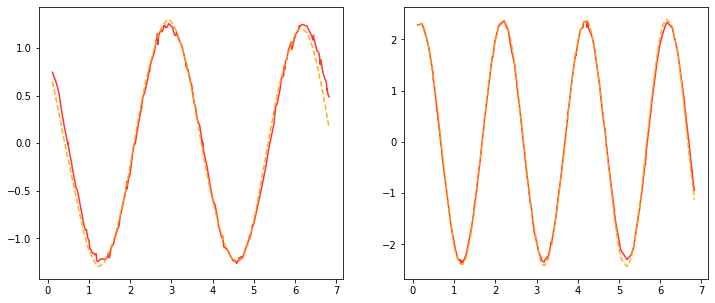

Current LR: [0.00030945741577570273]


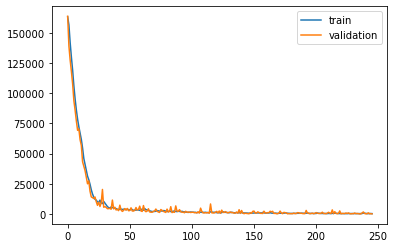

Epoch: 234, Train ELBO: -253.504, Val ELBO: -16158.299


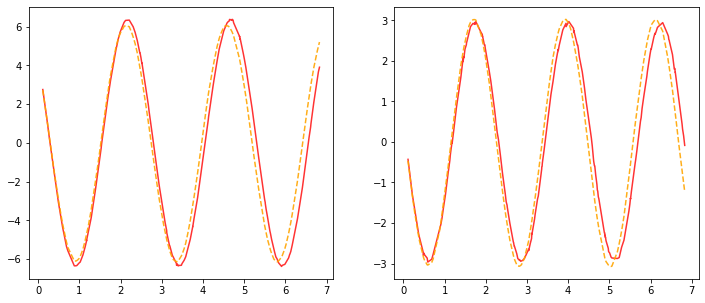

Current LR: [0.0003079101286968242]


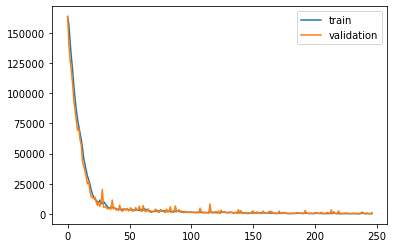

Epoch: 235, Train ELBO: -249.539, Val ELBO: -16006.580


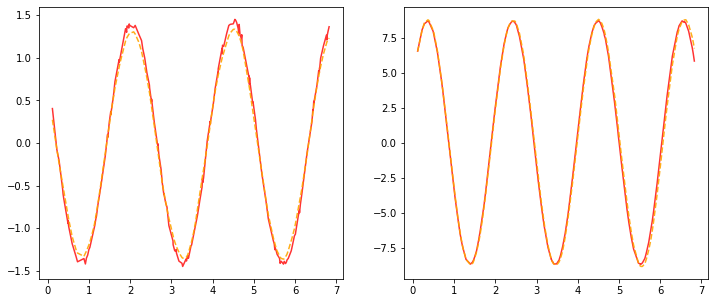

Current LR: [0.0003063705780533401]


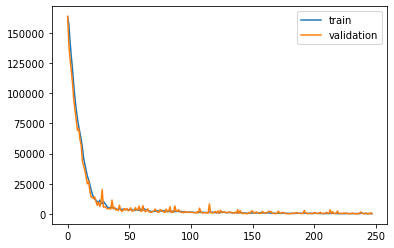

Epoch: 236, Train ELBO: -282.672, Val ELBO: -15848.371


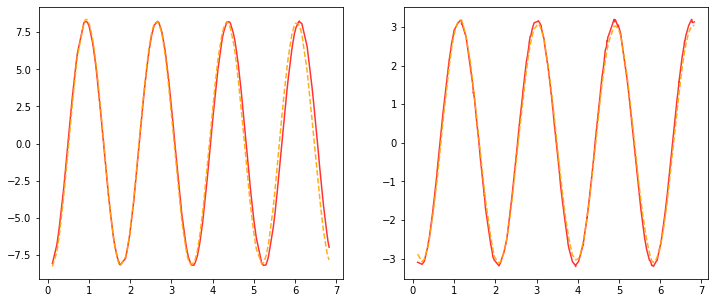

Current LR: [0.0003048387251630734]


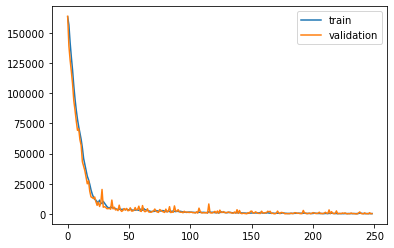

Epoch: 237, Train ELBO: -266.400, Val ELBO: -15692.422


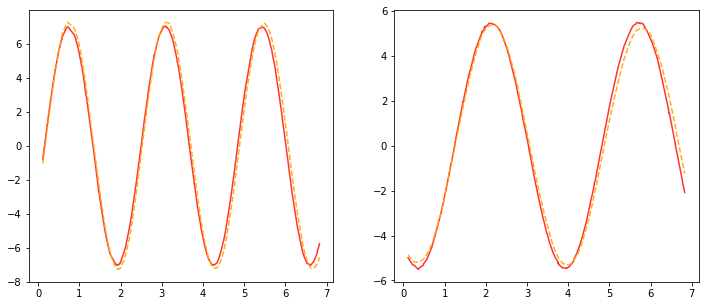

Current LR: [0.000303314531537258]


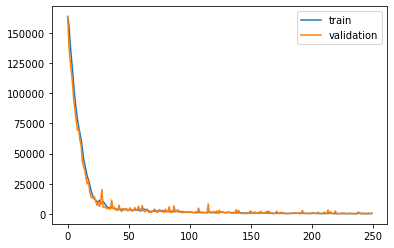

Epoch: 238, Train ELBO: -409.530, Val ELBO: -15540.927


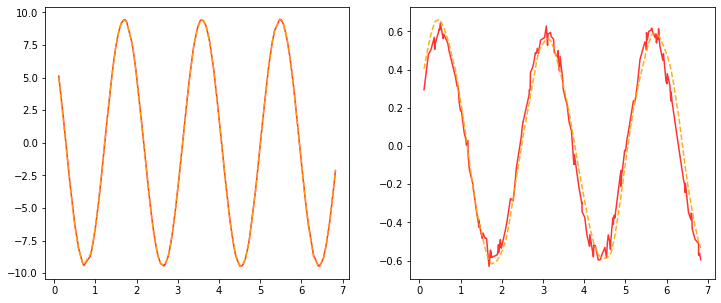

Current LR: [0.0003017979588795717]


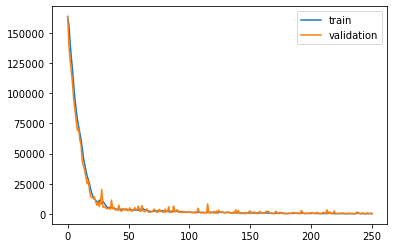

Epoch: 239, Train ELBO: -267.719, Val ELBO: -15385.898


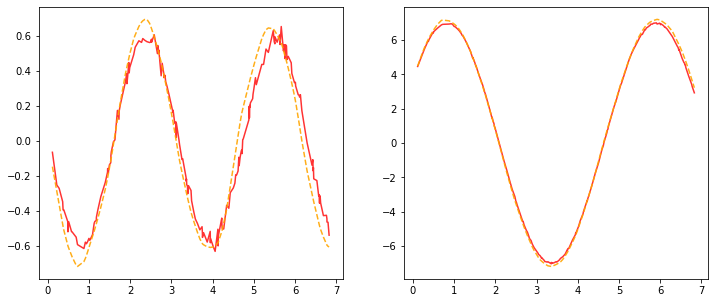

Current LR: [0.0003002889690851738]


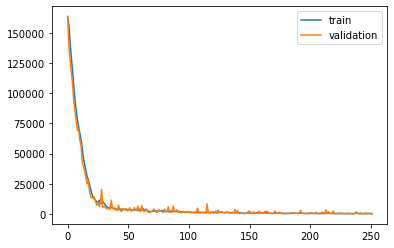

Epoch: 240, Train ELBO: -215.444, Val ELBO: -15232.608


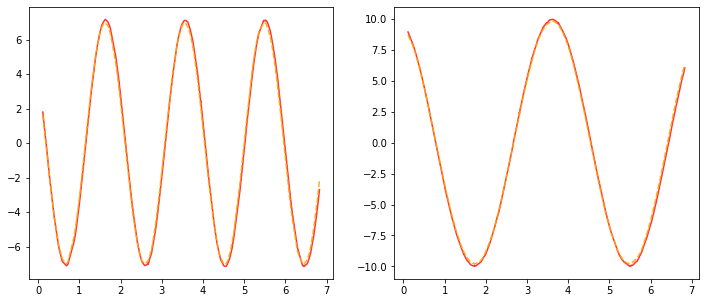

Current LR: [0.000298787524239748]


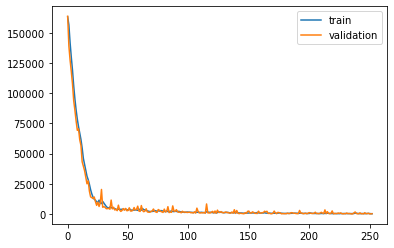

Epoch: 241, Train ELBO: -152.699, Val ELBO: -15082.220


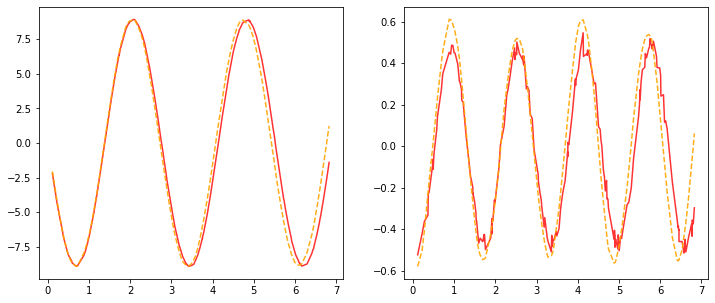

Current LR: [0.0002972935866185492]


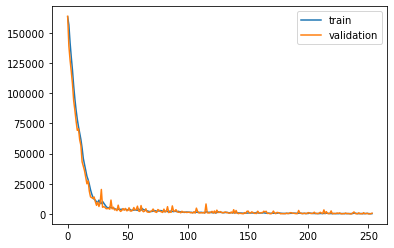

Epoch: 242, Train ELBO: -262.637, Val ELBO: -14937.187


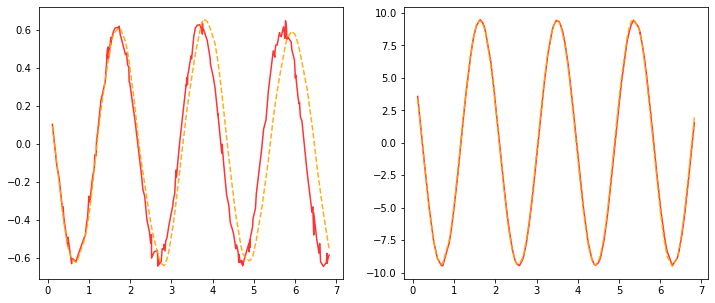

Current LR: [0.00029580711868545646]


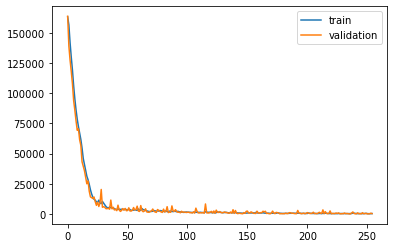

Epoch: 243, Train ELBO: -310.552, Val ELBO: -14790.384


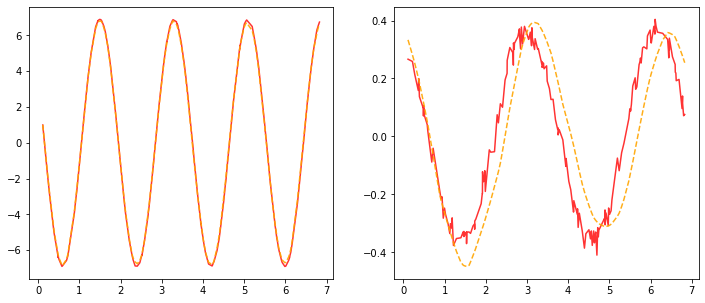

Current LR: [0.0002943280830920292]


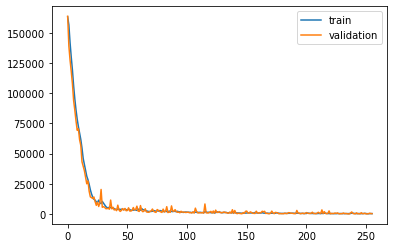

Epoch: 244, Train ELBO: -254.937, Val ELBO: -14644.938


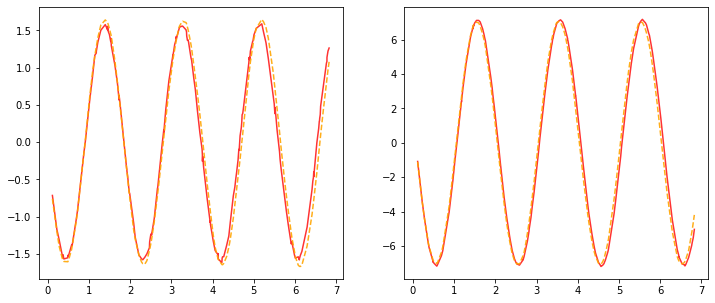

Current LR: [0.00029285644267656904]


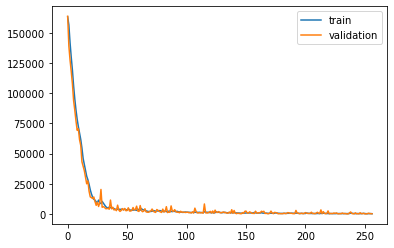

Epoch: 245, Train ELBO: -178.119, Val ELBO: -14500.068


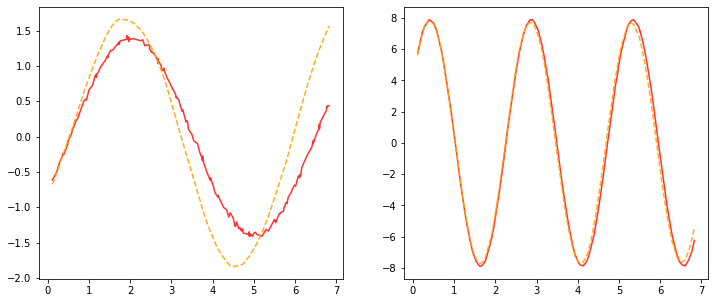

Current LR: [0.0002913921604631862]


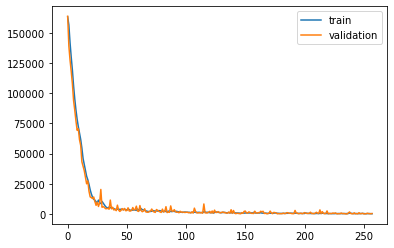

Epoch: 246, Train ELBO: -162.960, Val ELBO: -14358.266


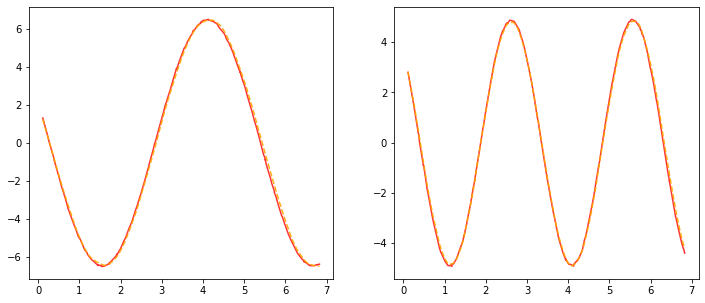

Current LR: [0.00028993519966087026]


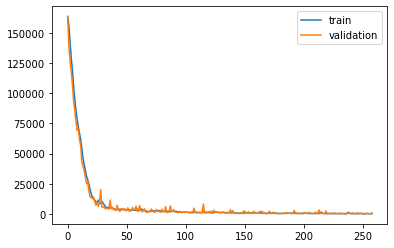

Epoch: 247, Train ELBO: -151.827, Val ELBO: -14222.650


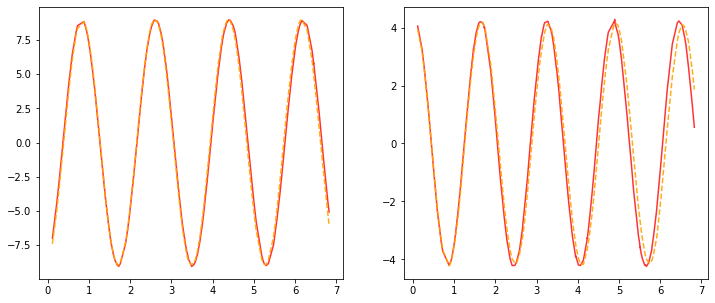

Current LR: [0.0002884855236625659]


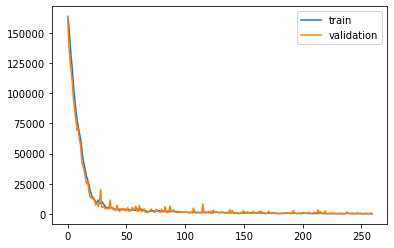

Epoch: 248, Train ELBO: -179.162, Val ELBO: -14082.125


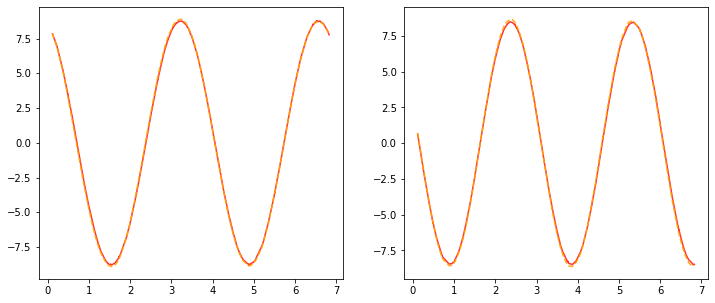

Current LR: [0.00028704309604425307]


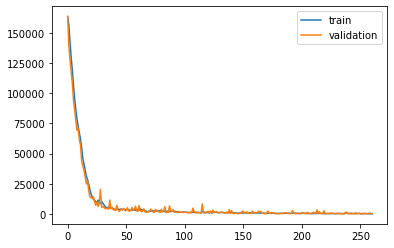

Epoch: 249, Train ELBO: -230.737, Val ELBO: -13941.636


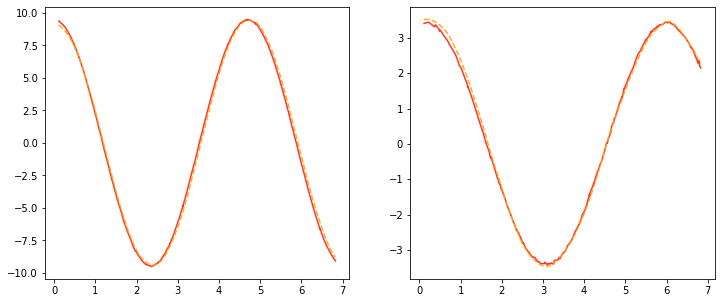

Current LR: [0.0002856078805640318]


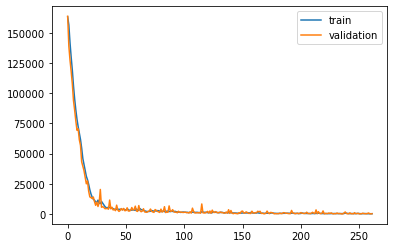

Epoch: 250, Train ELBO: -175.180, Val ELBO: -13804.152


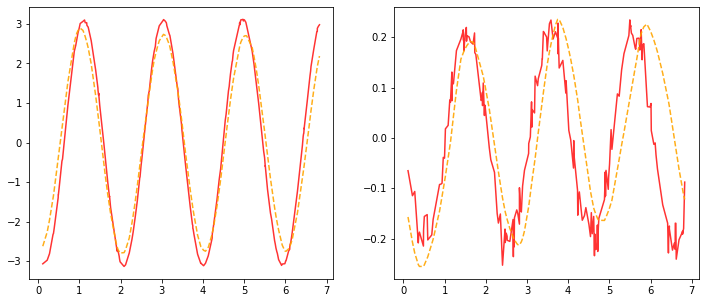

Current LR: [0.0002841798411612116]


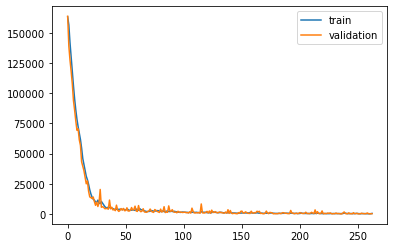

Epoch: 251, Train ELBO: -414.411, Val ELBO: -13668.035


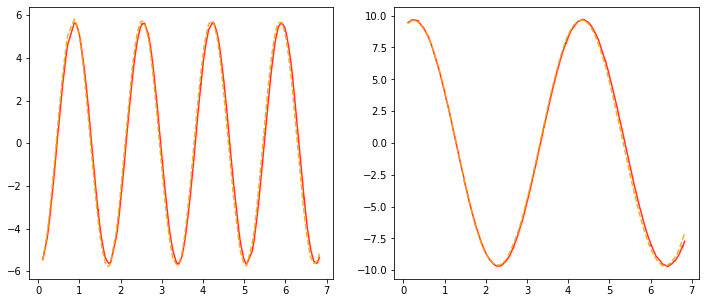

Current LR: [0.0002827589419554055]


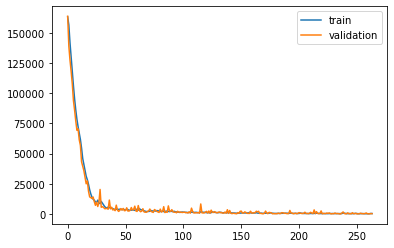

Epoch: 252, Train ELBO: -303.422, Val ELBO: -13533.796


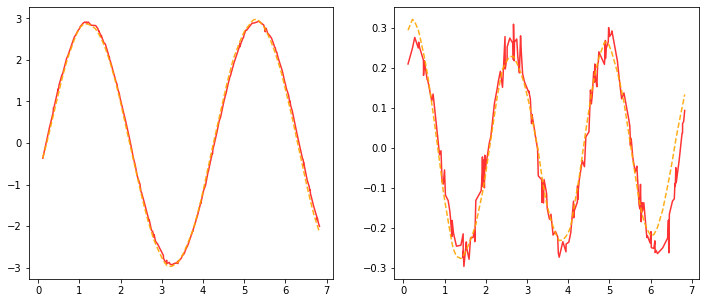

Current LR: [0.0002813451472456285]


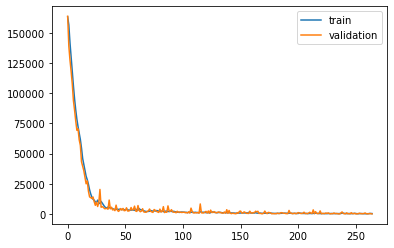

Epoch: 253, Train ELBO: -276.440, Val ELBO: -13398.402


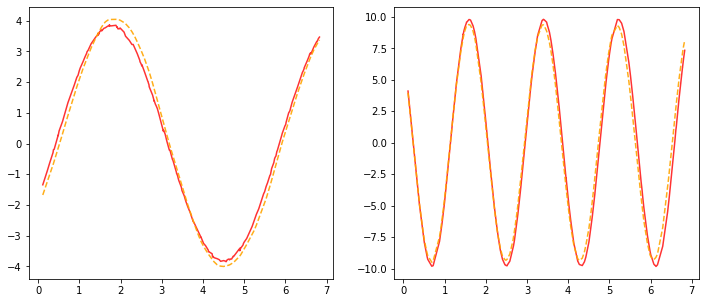

Current LR: [0.0002799384215094004]


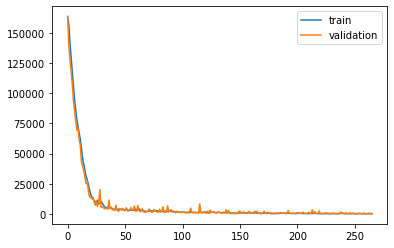

Epoch: 254, Train ELBO: -251.258, Val ELBO: -13266.146


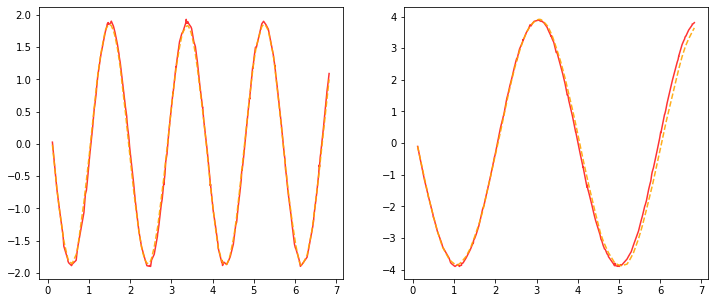

Current LR: [0.00027853872940185336]


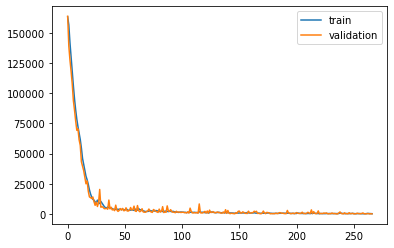

Epoch: 255, Train ELBO: -180.523, Val ELBO: -13133.939


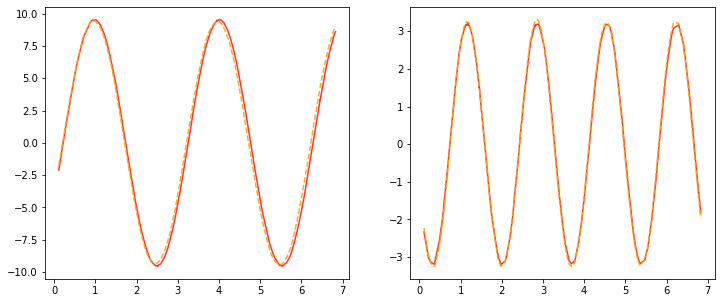

Current LR: [0.0002771460357548441]


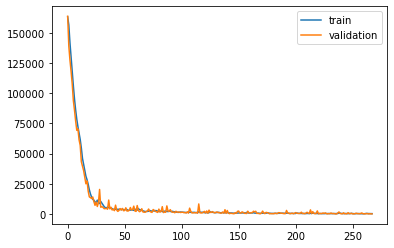

Epoch: 256, Train ELBO: -226.264, Val ELBO: -13002.985


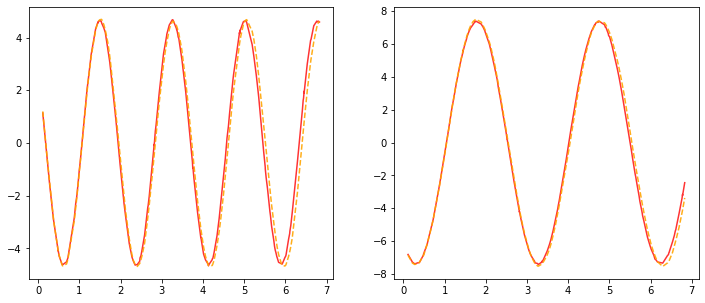

Current LR: [0.0002757603055760699]


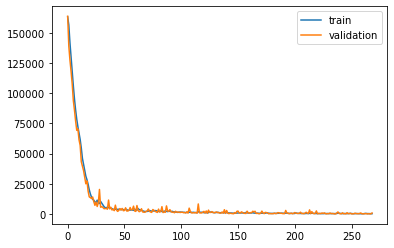

Epoch: 257, Train ELBO: -181.791, Val ELBO: -12880.563


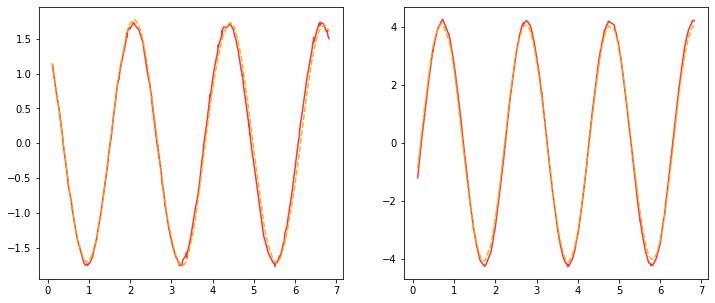

Current LR: [0.0002743815040481895]


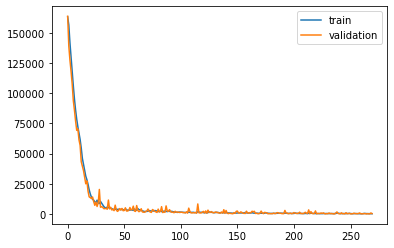

Epoch: 258, Train ELBO: -162.141, Val ELBO: -12754.373


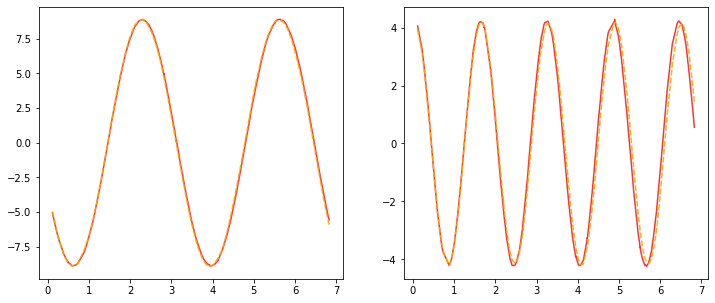

Current LR: [0.00027300959652794857]


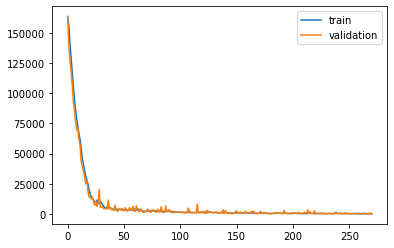

Epoch: 259, Train ELBO: -135.230, Val ELBO: -12627.335


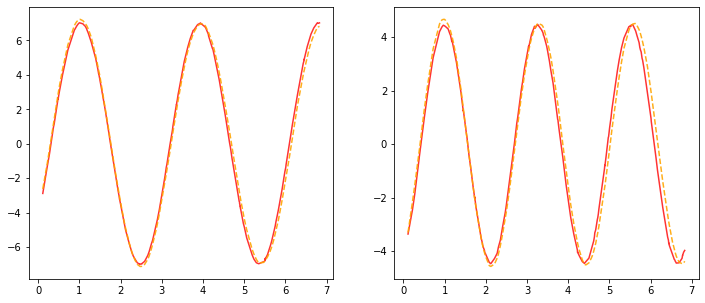

Current LR: [0.0002716445485453088]


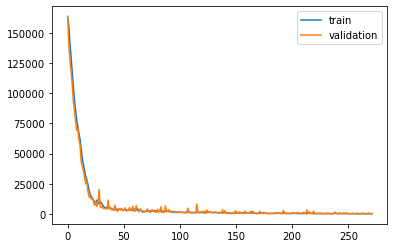

Epoch: 260, Train ELBO: -80.050, Val ELBO: -12503.861


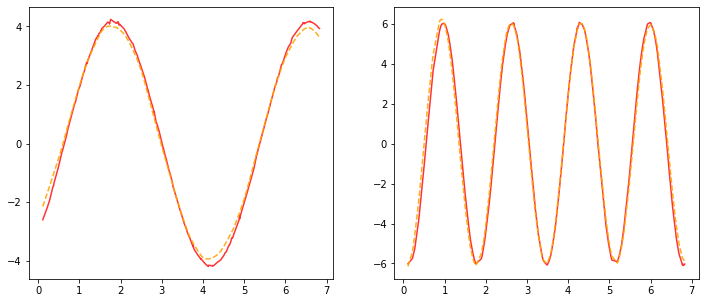

Current LR: [0.0002702863258025823]


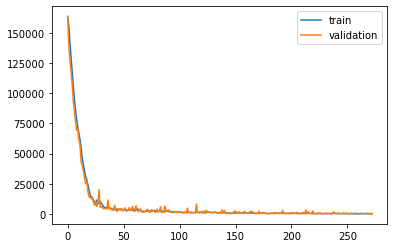

Epoch: 261, Train ELBO: -93.603, Val ELBO: -12382.889


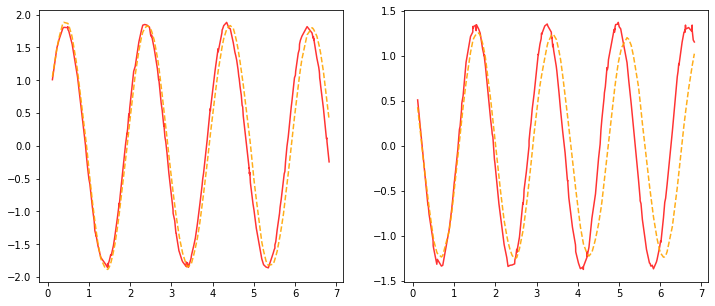

Current LR: [0.00026893489417356936]


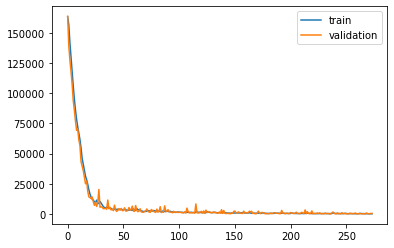

Epoch: 262, Train ELBO: -160.634, Val ELBO: -12262.570


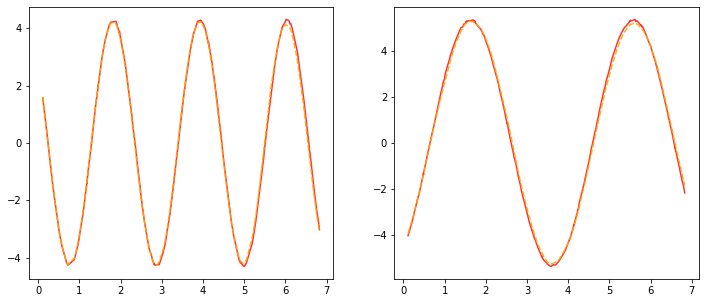

Current LR: [0.0002675902197027015]


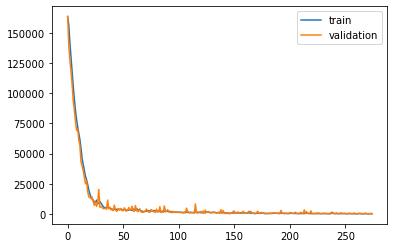

Epoch: 263, Train ELBO: -166.197, Val ELBO: -12140.775


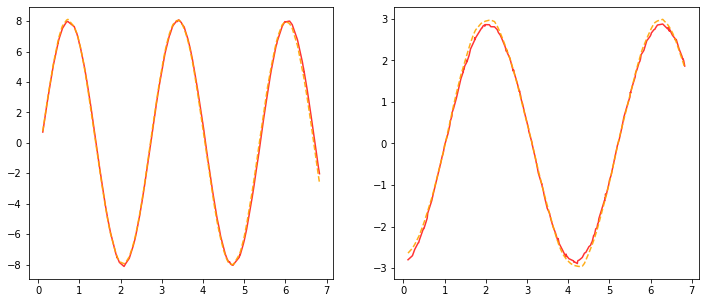

Current LR: [0.000266252268604188]


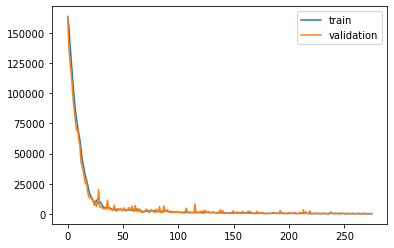

Epoch: 264, Train ELBO: -172.558, Val ELBO: -12022.816


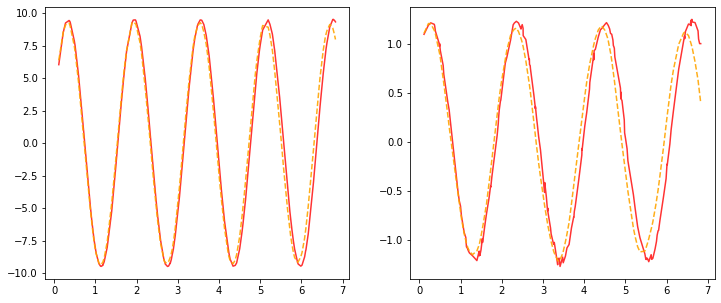

Current LR: [0.0002649210072611671]


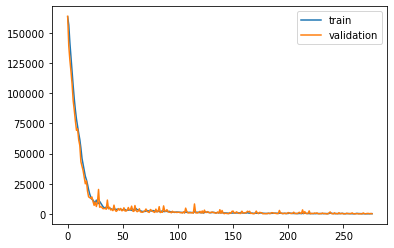

Epoch: 265, Train ELBO: -198.662, Val ELBO: -11904.087


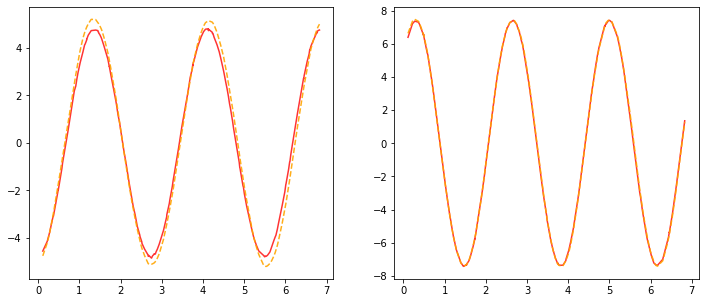

Current LR: [0.0002635964022248612]


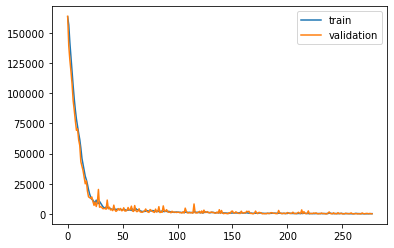

Epoch: 266, Train ELBO: -220.254, Val ELBO: -11786.232


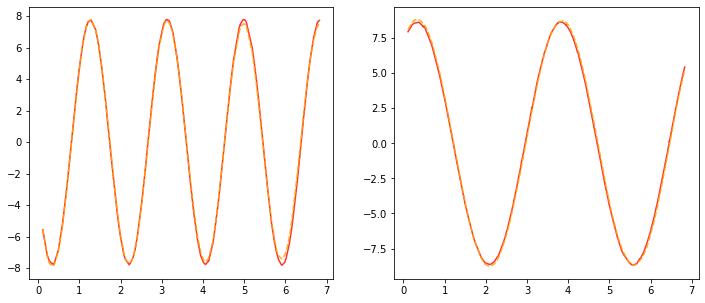

Current LR: [0.0002622784202137369]


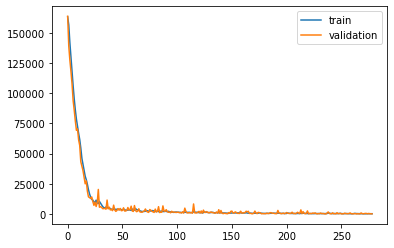

Epoch: 267, Train ELBO: -164.597, Val ELBO: -11669.014


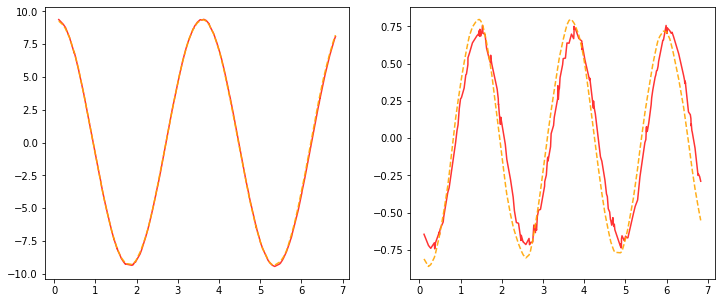

Current LR: [0.00026096702811266825]


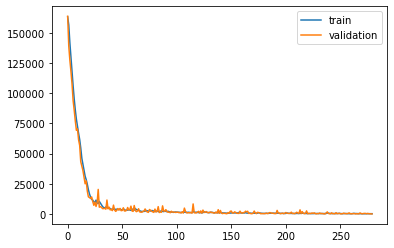

Epoch: 268, Train ELBO: -153.482, Val ELBO: -11552.020


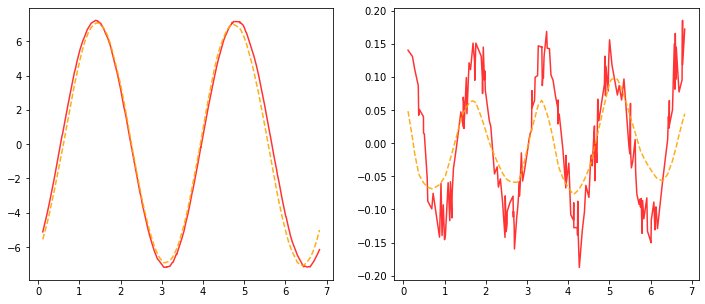

Current LR: [0.0002596621929721049]


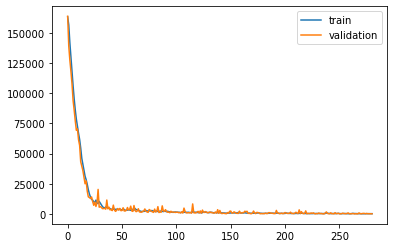

Epoch: 269, Train ELBO: -179.246, Val ELBO: -11437.407


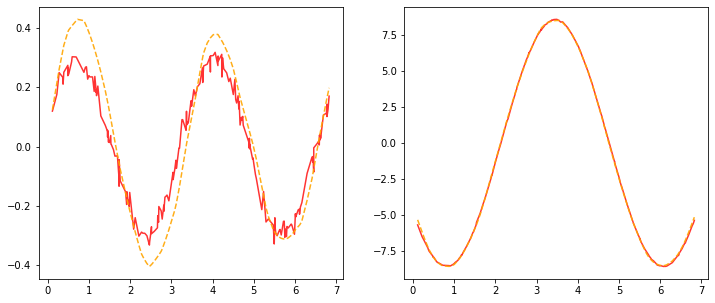

Current LR: [0.0002583638820072444]


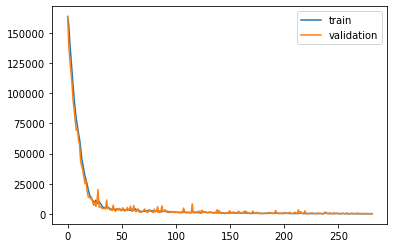

Epoch: 270, Train ELBO: -194.118, Val ELBO: -11323.810


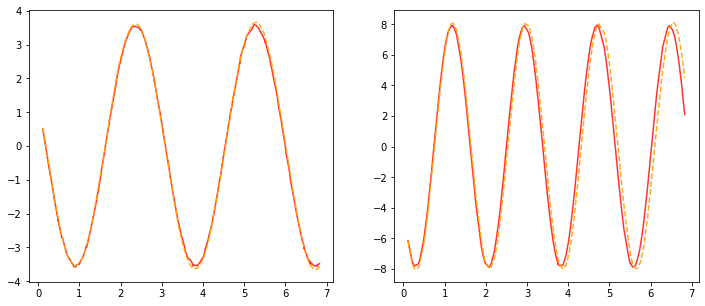

Current LR: [0.00025707206259720813]


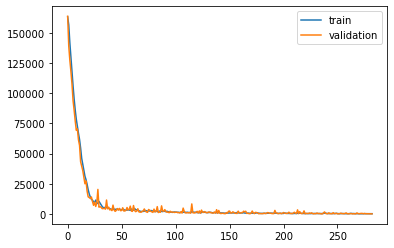

Epoch: 271, Train ELBO: -160.486, Val ELBO: -11210.876


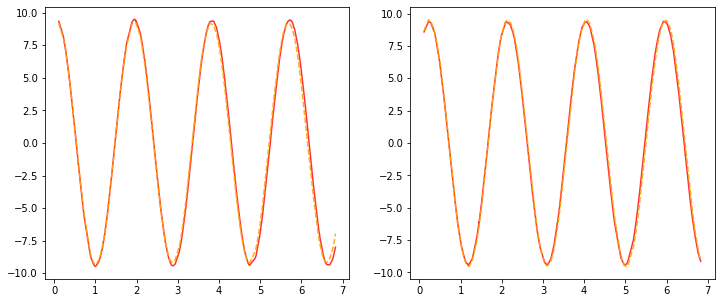

Current LR: [0.0002557867022842221]


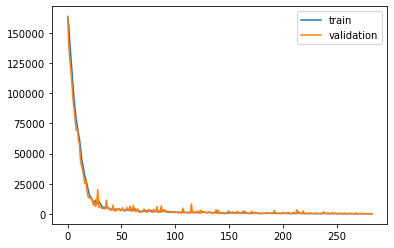

Epoch: 272, Train ELBO: -146.337, Val ELBO: -11100.071


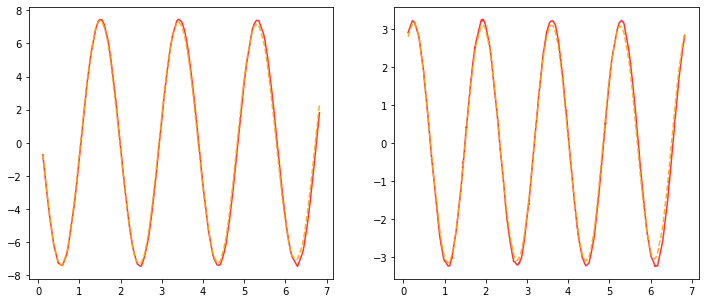

Current LR: [0.00025450776877280096]


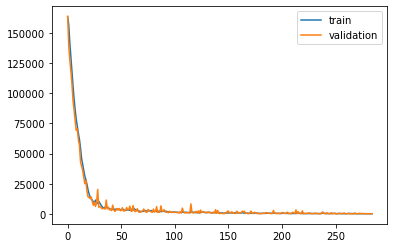

Epoch: 273, Train ELBO: -114.168, Val ELBO: -10990.490


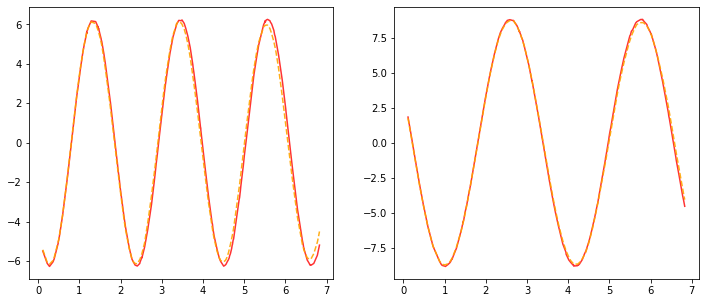

Current LR: [0.00025323522992893693]


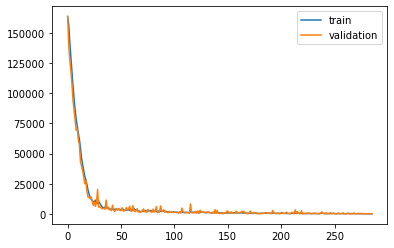

Epoch: 274, Train ELBO: -93.316, Val ELBO: -10881.379


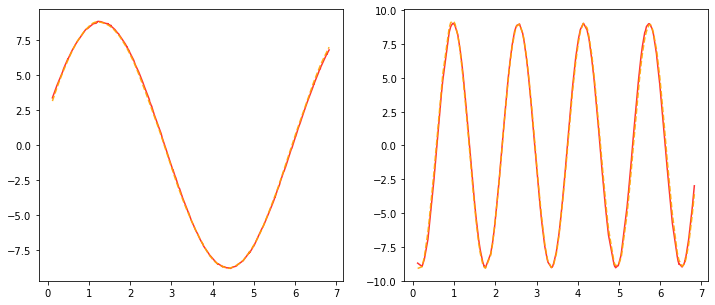

Current LR: [0.00025196905377929227]


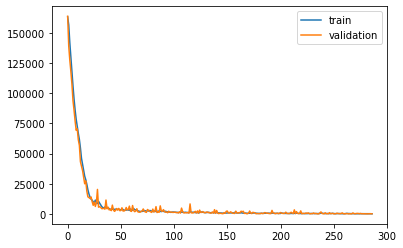

Epoch: 275, Train ELBO: -94.605, Val ELBO: -10773.472


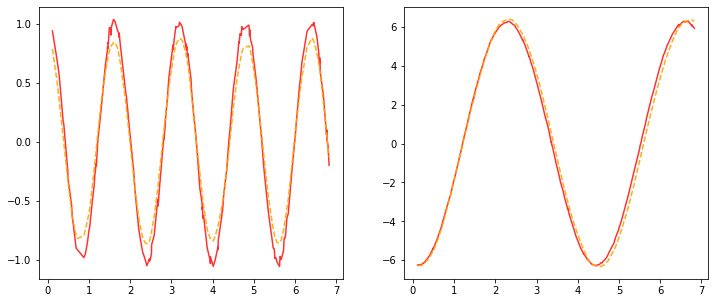

Current LR: [0.0002507092085103958]


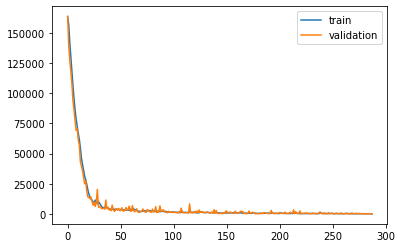

Epoch: 276, Train ELBO: -86.123, Val ELBO: -10666.412


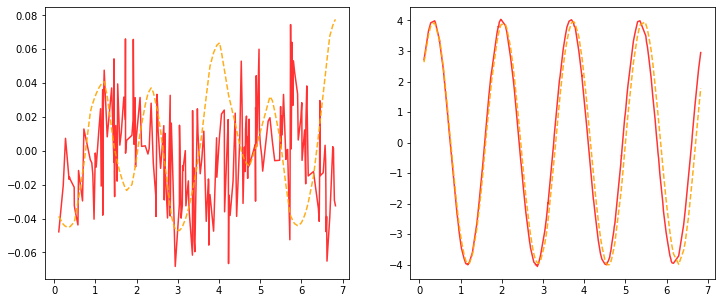

Current LR: [0.0002494556624678438]


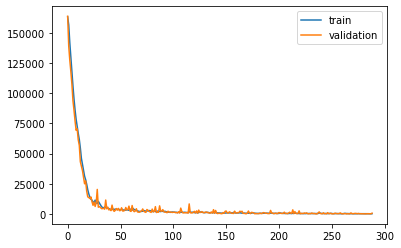

Epoch: 277, Train ELBO: -162.277, Val ELBO: -10565.470


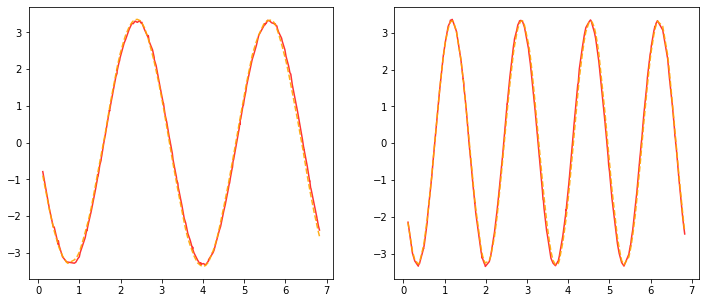

Current LR: [0.0002482083841555046]


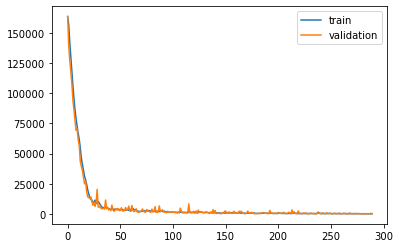

Epoch: 278, Train ELBO: -132.338, Val ELBO: -10460.197


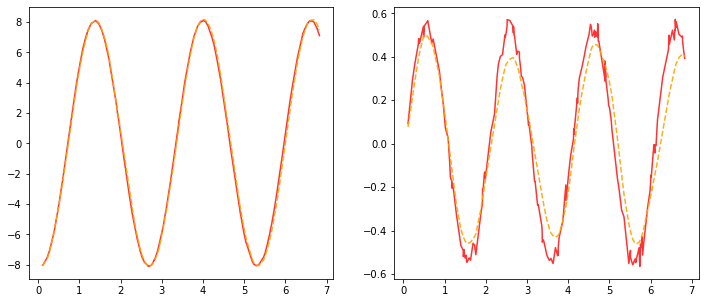

Current LR: [0.00024696734223472706]


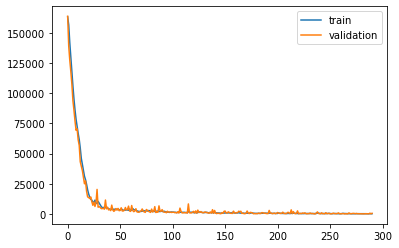

Epoch: 279, Train ELBO: -143.665, Val ELBO: -10360.251


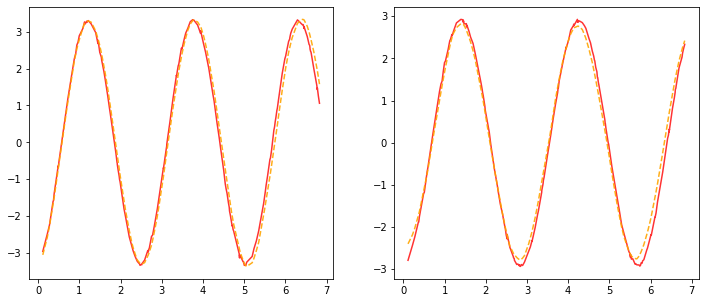

Current LR: [0.00024573250552355344]


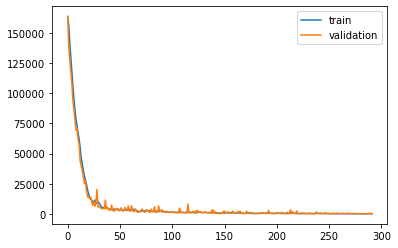

Epoch: 280, Train ELBO: -127.921, Val ELBO: -10257.981


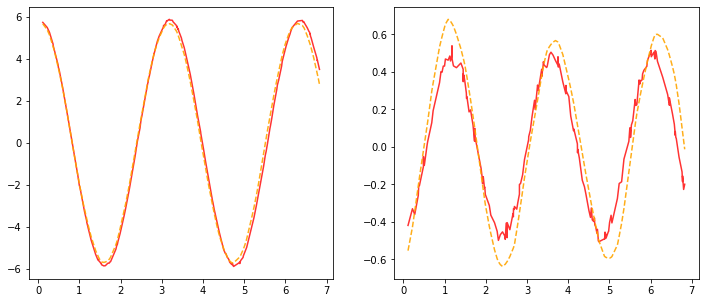

Current LR: [0.00024450384299593567]


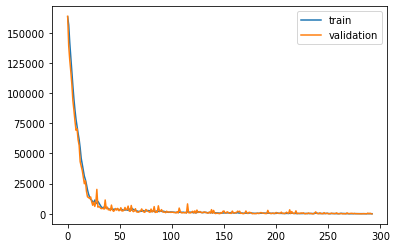

Epoch: 281, Train ELBO: -111.177, Val ELBO: -10154.745


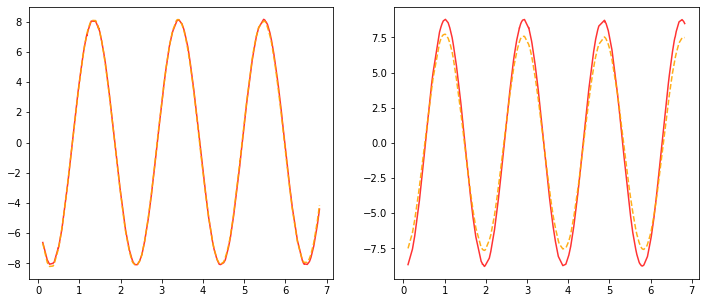

Current LR: [0.000243281323780956]


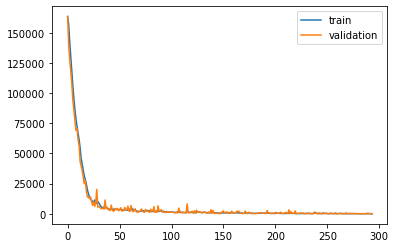

Epoch: 282, Train ELBO: -86.805, Val ELBO: -10054.200


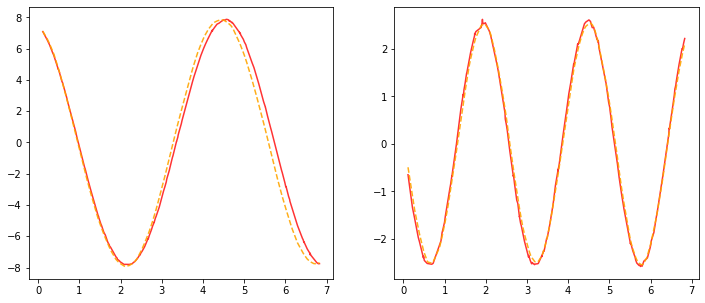

Current LR: [0.0002420649171620512]


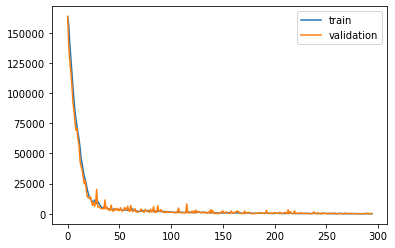

Epoch: 283, Train ELBO: -107.664, Val ELBO: -9957.721


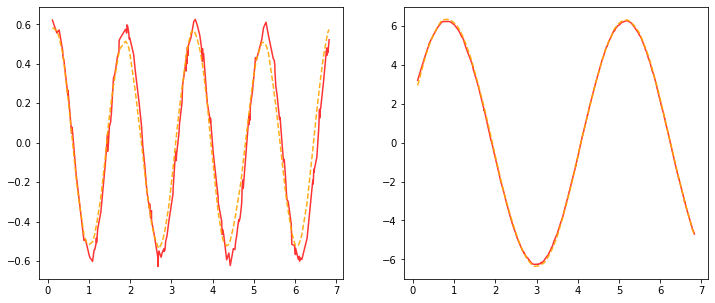

Current LR: [0.00024085459257624093]


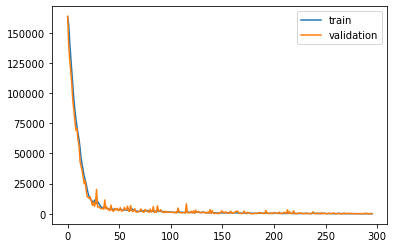

Epoch: 284, Train ELBO: -122.501, Val ELBO: -9858.416


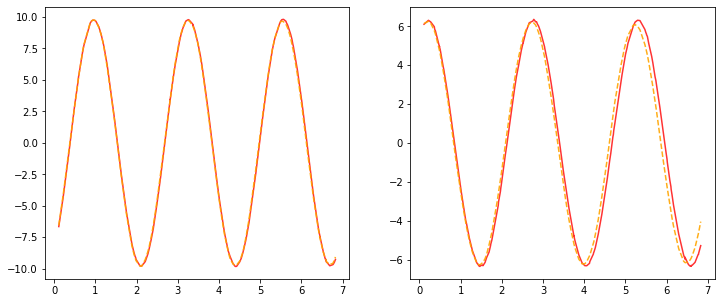

Current LR: [0.00023965031961335973]


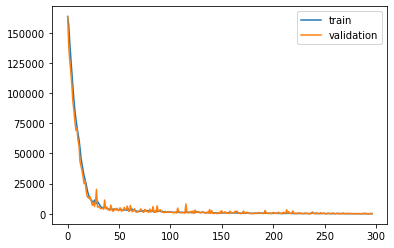

Epoch: 285, Train ELBO: -139.161, Val ELBO: -9762.291


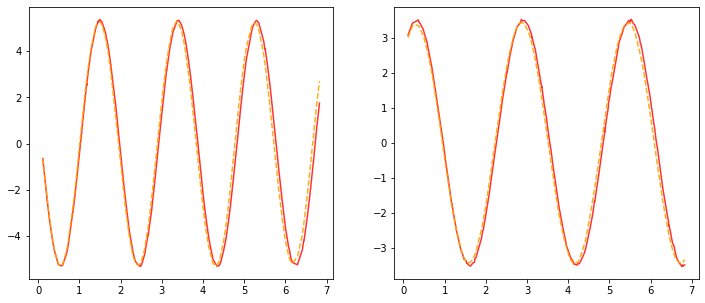

Current LR: [0.00023845206801529294]


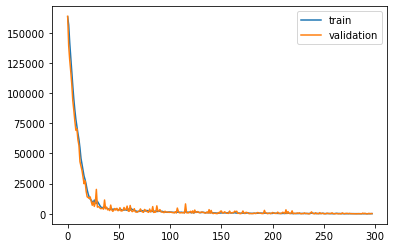

Epoch: 286, Train ELBO: -174.577, Val ELBO: -9666.557


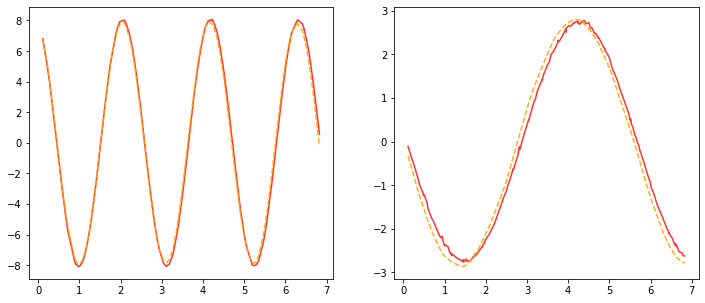

Current LR: [0.00023725980767521648]


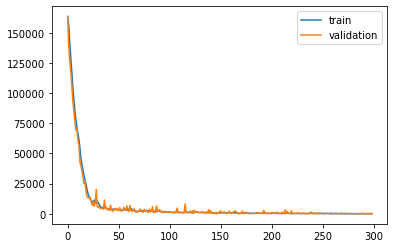

Epoch: 287, Train ELBO: -142.587, Val ELBO: -9572.001


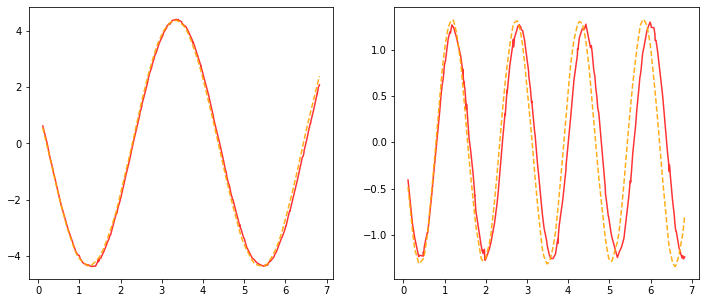

Current LR: [0.00023607350863684038]


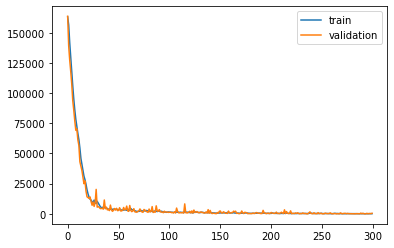

Epoch: 288, Train ELBO: -136.015, Val ELBO: -9480.811


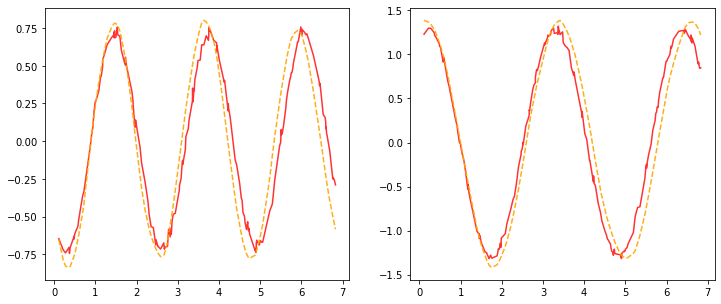

Current LR: [0.00023489314109365617]


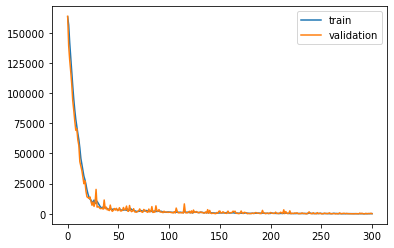

Epoch: 289, Train ELBO: -167.407, Val ELBO: -9387.134


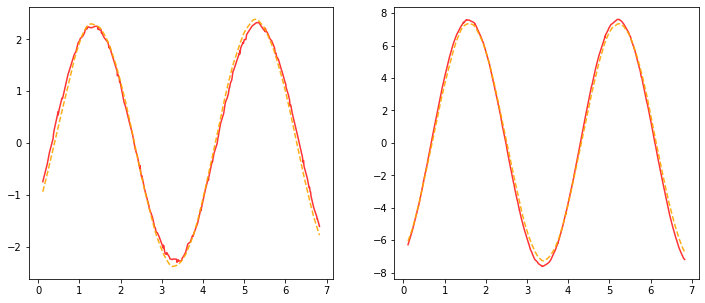

Current LR: [0.0002337186753881879]


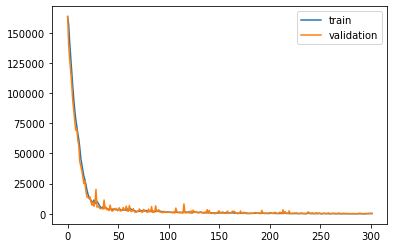

Epoch: 290, Train ELBO: -323.846, Val ELBO: -9295.880


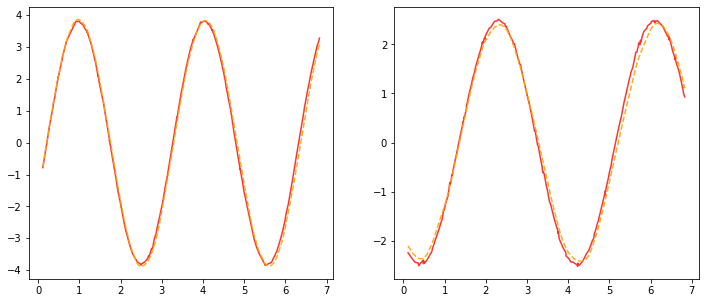

Current LR: [0.00023255008201124696]


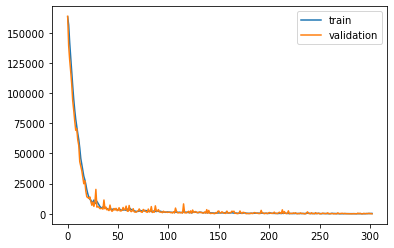

Epoch: 291, Train ELBO: -314.146, Val ELBO: -9202.775


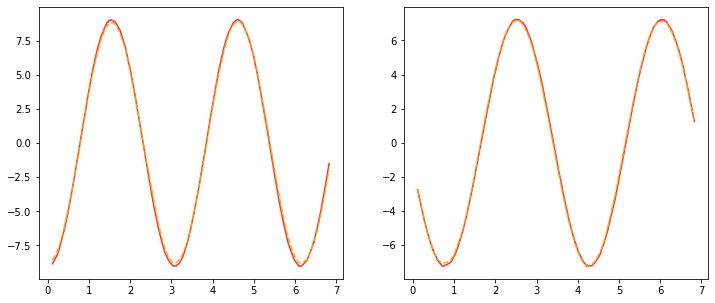

Current LR: [0.00023138733160119073]


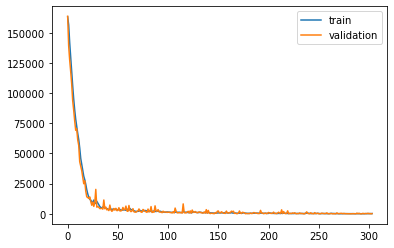

Epoch: 292, Train ELBO: -222.378, Val ELBO: -9112.752


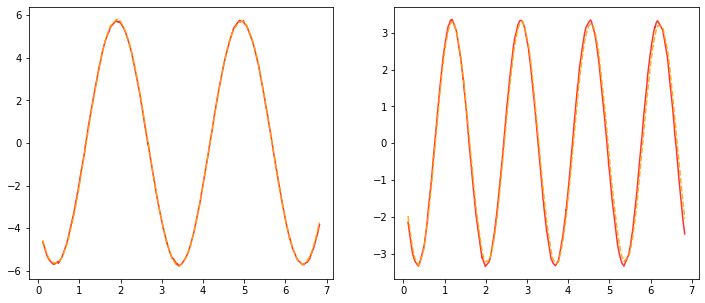

Current LR: [0.0002302303949431848]


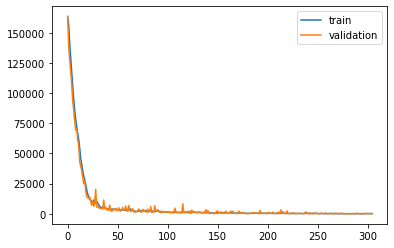

Epoch: 293, Train ELBO: -180.883, Val ELBO: -9022.255


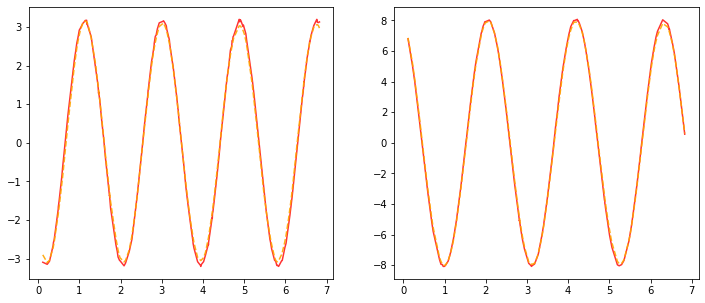

Current LR: [0.00022907924296846886]


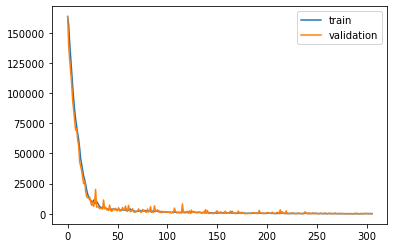

Epoch: 294, Train ELBO: -137.776, Val ELBO: -8933.234


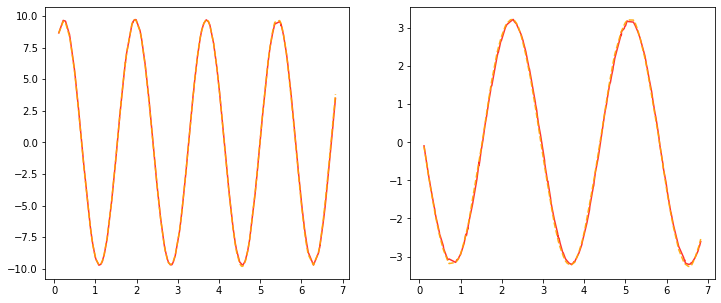

Current LR: [0.0002279338467536265]


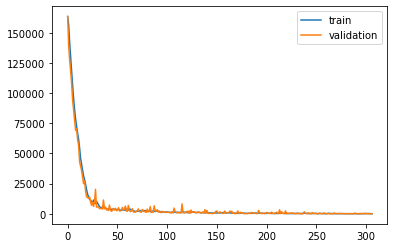

Epoch: 295, Train ELBO: -99.972, Val ELBO: -8843.856


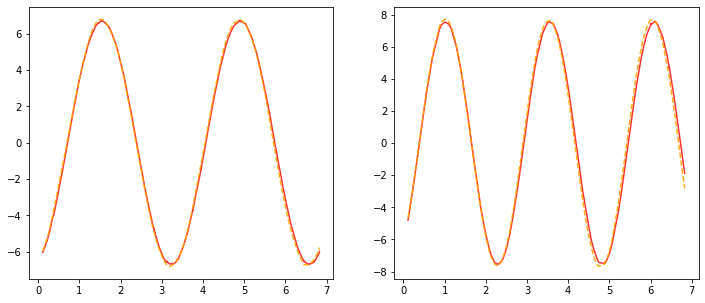

Current LR: [0.00022679417751985838]


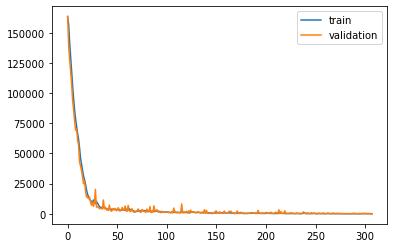

Epoch: 296, Train ELBO: -81.425, Val ELBO: -8756.046


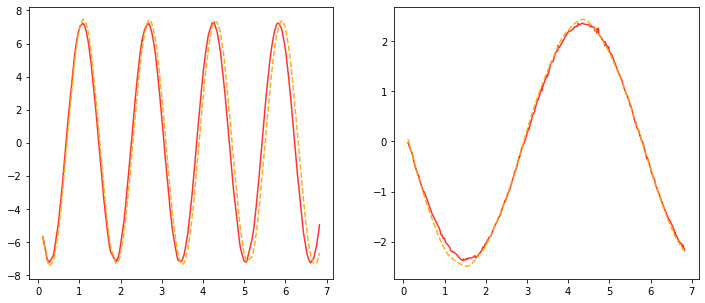

Current LR: [0.00022566020663225908]


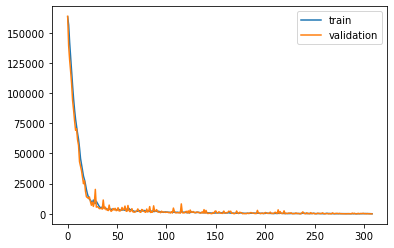

Epoch: 297, Train ELBO: -90.283, Val ELBO: -8668.180


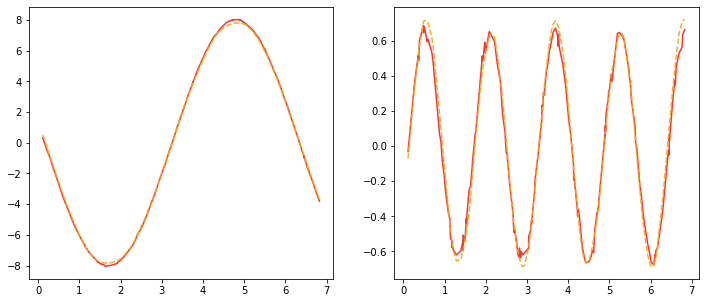

Current LR: [0.00022453190559909778]


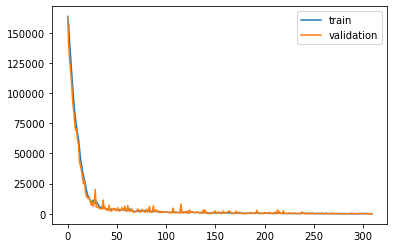

Epoch: 298, Train ELBO: -100.546, Val ELBO: -8581.145


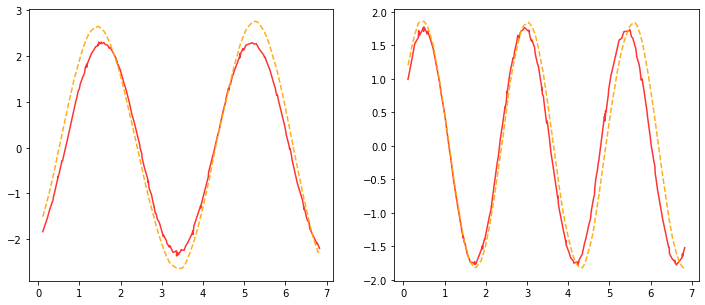

Current LR: [0.00022340924607110228]


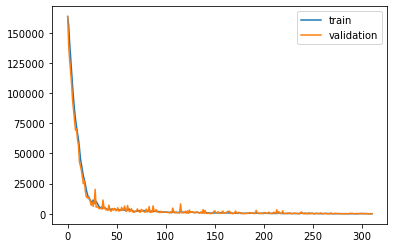

Epoch: 299, Train ELBO: -117.367, Val ELBO: -8496.710


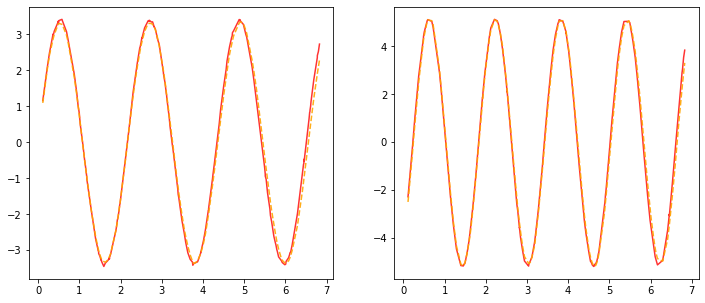

Current LR: [0.00022229219984074678]


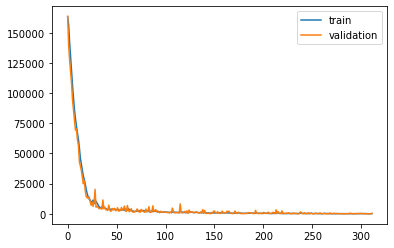

Epoch: 300, Train ELBO: -217.076, Val ELBO: -8415.420


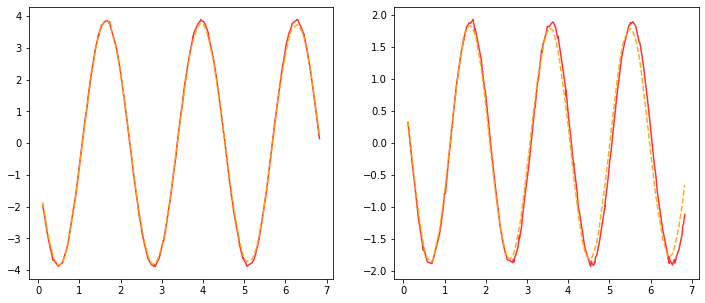

Current LR: [0.00022118073884154303]


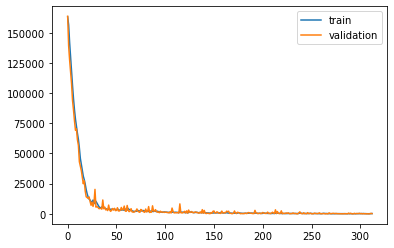

Epoch: 301, Train ELBO: -244.197, Val ELBO: -8333.107


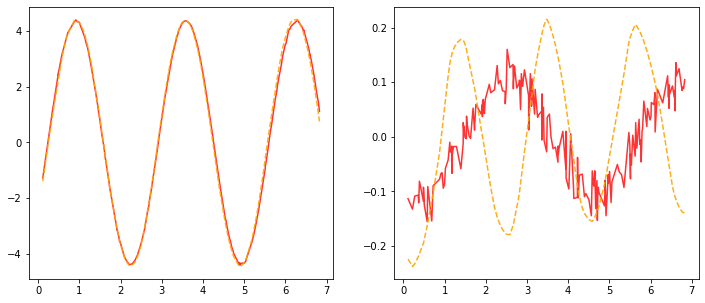

Current LR: [0.00022007483514733533]


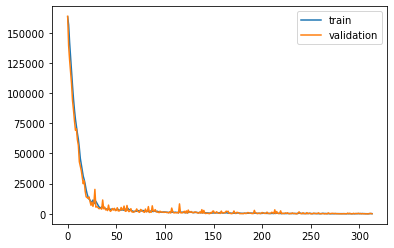

Epoch: 302, Train ELBO: -154.131, Val ELBO: -8250.642


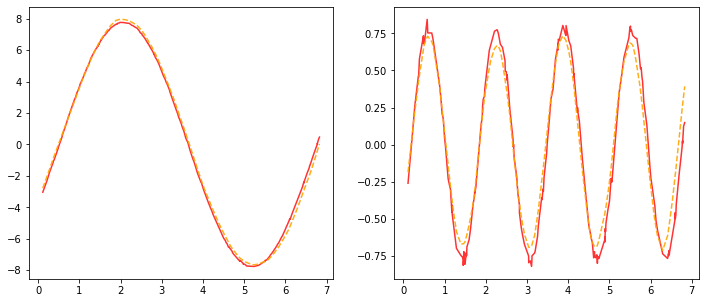

Current LR: [0.00021897446097159866]


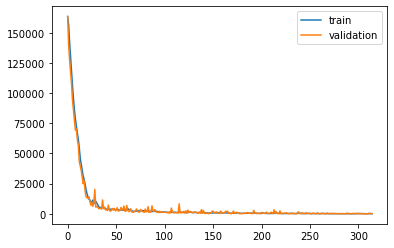

Epoch: 303, Train ELBO: -93.499, Val ELBO: -8169.754


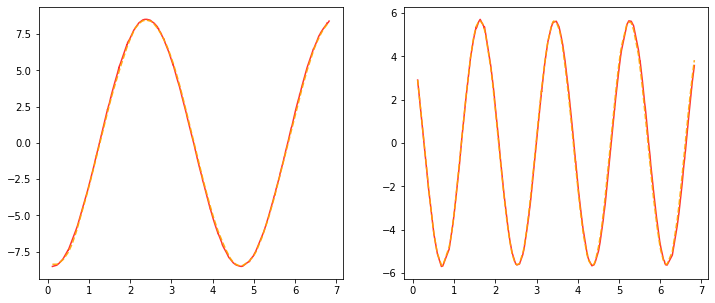

Current LR: [0.00021787958866674066]


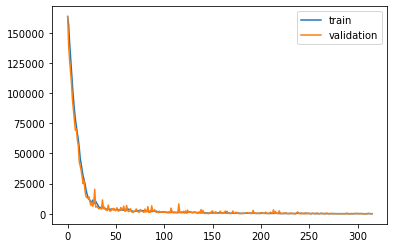

Epoch: 304, Train ELBO: -94.231, Val ELBO: -8089.598


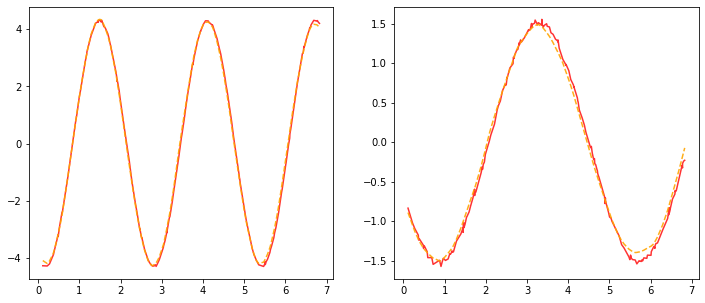

Current LR: [0.00021679019072340695]


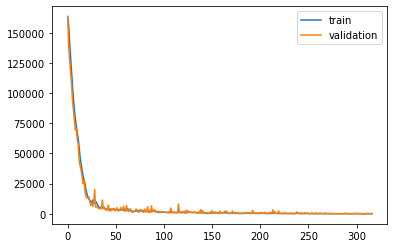

Epoch: 305, Train ELBO: -189.836, Val ELBO: -8008.479


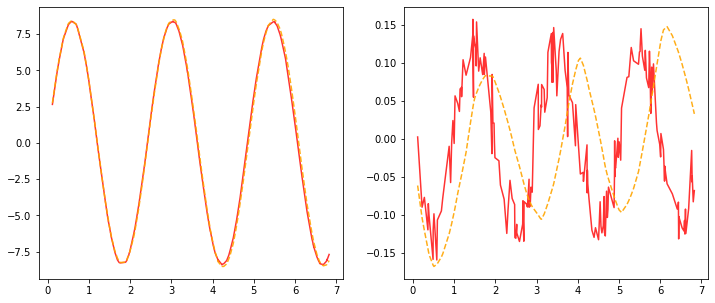

Current LR: [0.0002157062397697899]


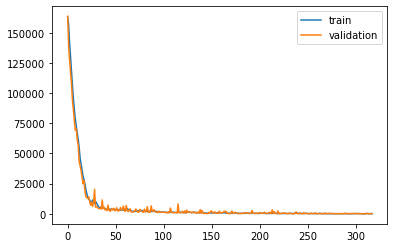

Epoch: 306, Train ELBO: -131.020, Val ELBO: -7930.201


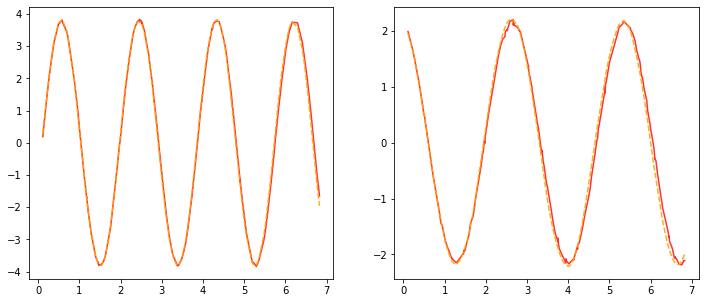

Current LR: [0.00021462770857094097]


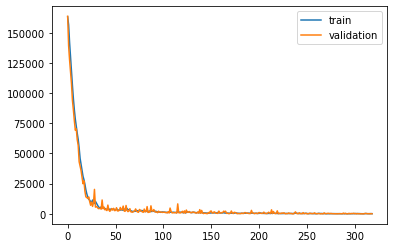

Epoch: 307, Train ELBO: -137.959, Val ELBO: -7851.595


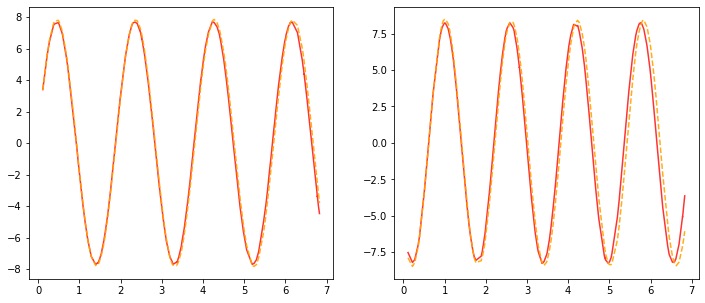

Current LR: [0.00021355457002808625]


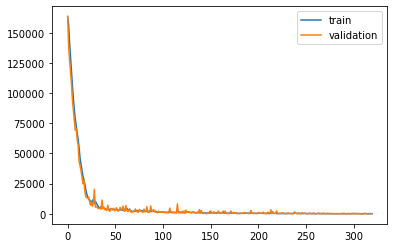

Epoch: 308, Train ELBO: -102.488, Val ELBO: -7774.206


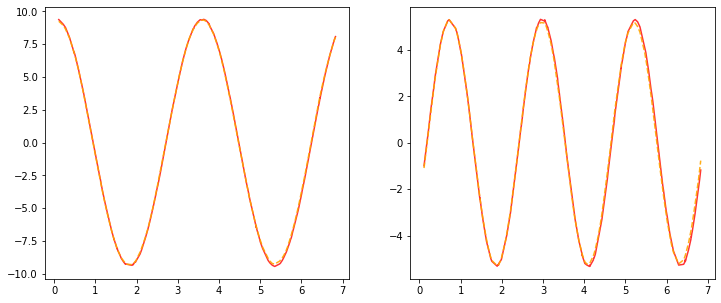

Current LR: [0.00021248679717794582]


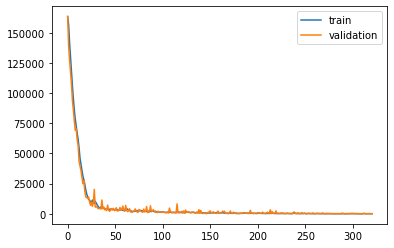

Epoch: 309, Train ELBO: -71.330, Val ELBO: -7697.778


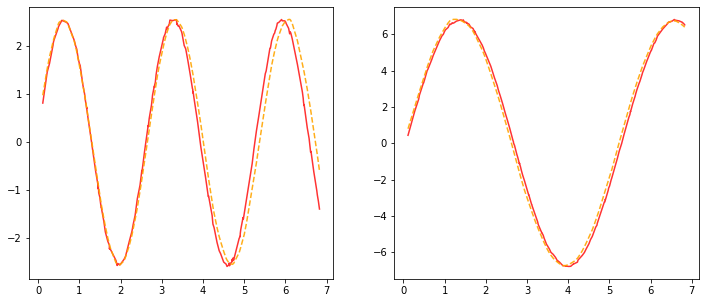

Current LR: [0.0002114243631920561]


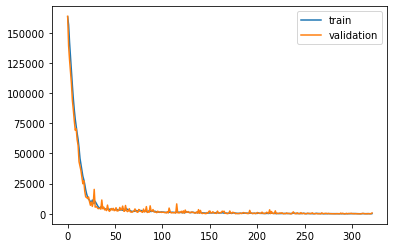

Epoch: 310, Train ELBO: -224.208, Val ELBO: -7627.936


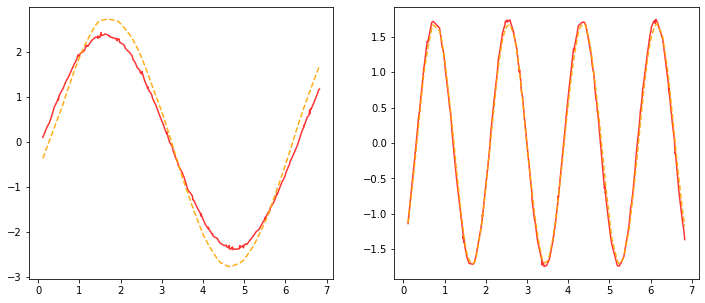

Current LR: [0.0002103672413760958]


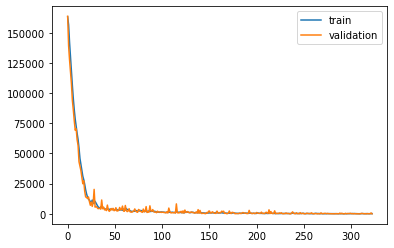

Epoch: 311, Train ELBO: -197.228, Val ELBO: -7551.271


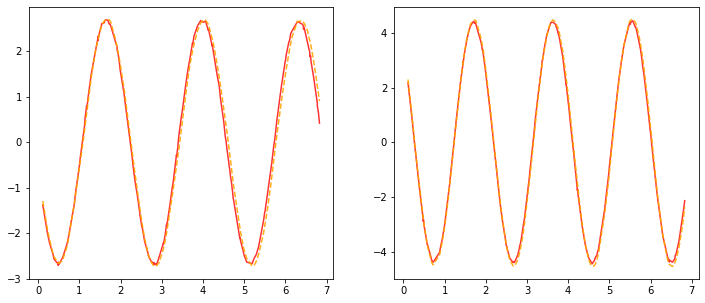

Current LR: [0.00020931540516921533]


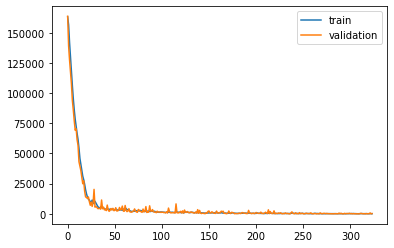

Epoch: 312, Train ELBO: -99.936, Val ELBO: -7478.094


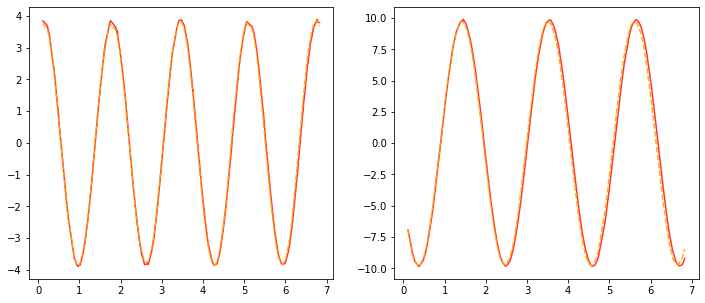

Current LR: [0.00020826882814336926]


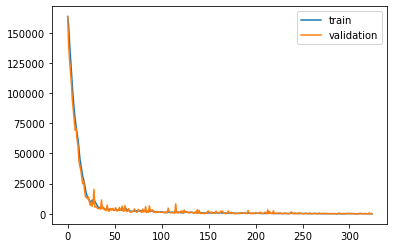

Epoch: 313, Train ELBO: -45.588, Val ELBO: -7404.114


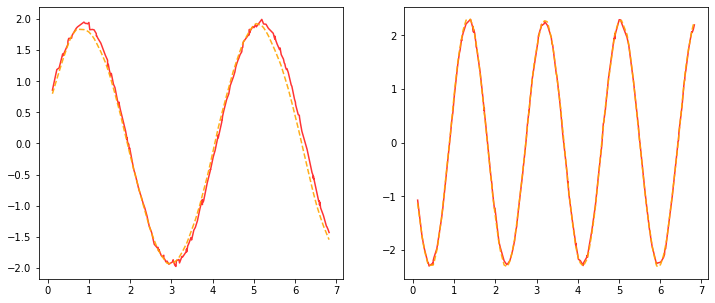

Current LR: [0.00020722748400265242]


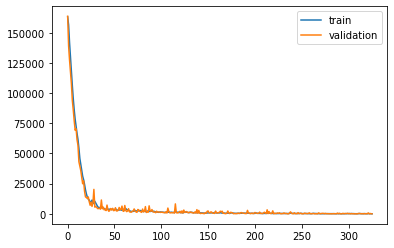

Epoch: 314, Train ELBO: -52.802, Val ELBO: -7330.137


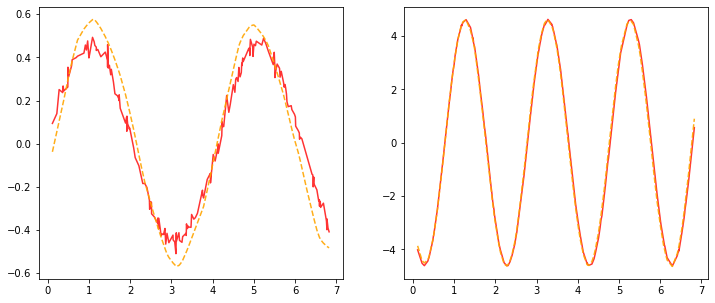

Current LR: [0.00020619134658263915]


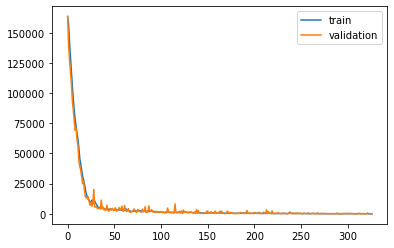

Epoch: 315, Train ELBO: -13.286, Val ELBO: -7256.749


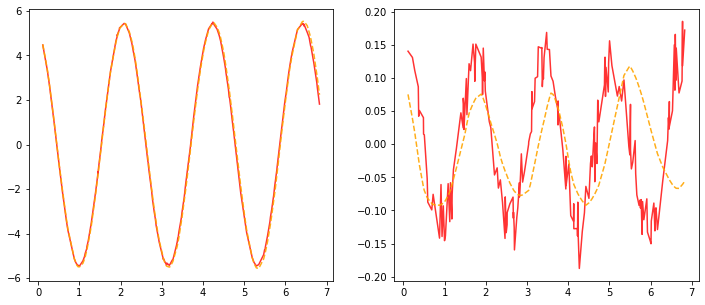

Current LR: [0.00020516038984972595]


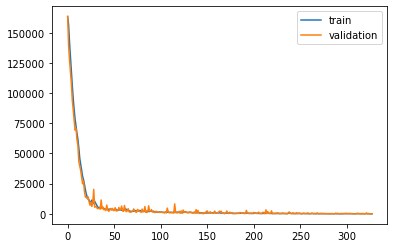

Epoch: 316, Train ELBO: -72.033, Val ELBO: -7184.338


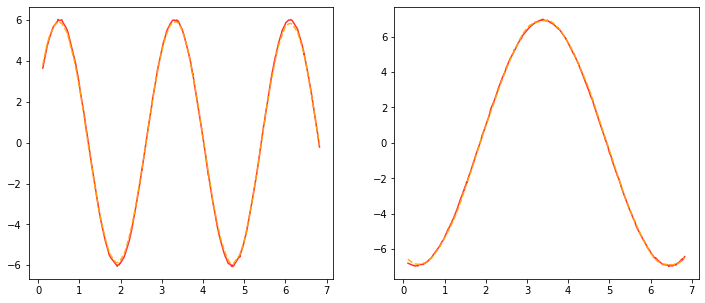

Current LR: [0.00020413458790047732]


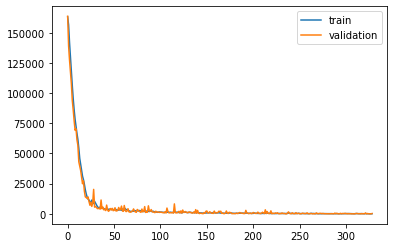

Epoch: 317, Train ELBO: -100.181, Val ELBO: -7114.982


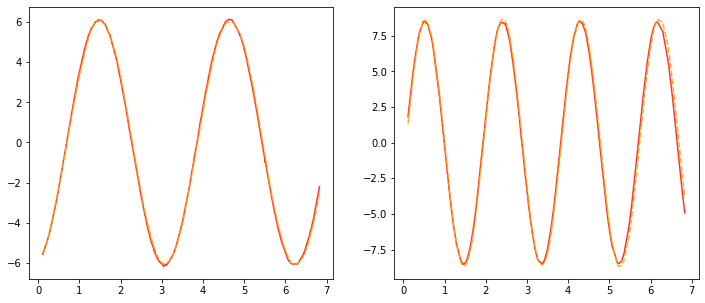

Current LR: [0.00020311391496097492]


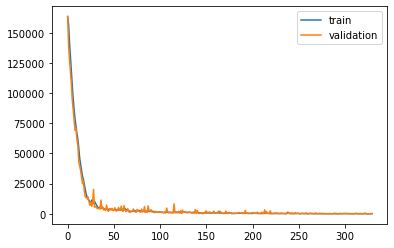

Epoch: 318, Train ELBO: -129.487, Val ELBO: -7046.010


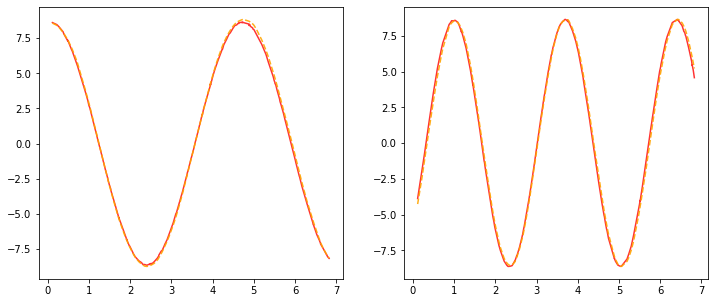

Current LR: [0.00020209834538617005]


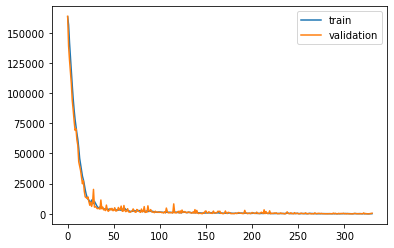

Epoch: 319, Train ELBO: -151.053, Val ELBO: -6980.723


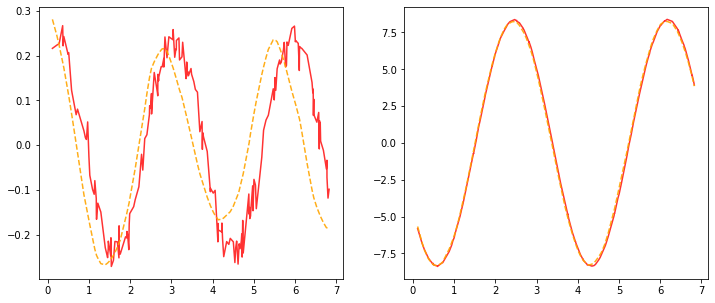

Current LR: [0.0002010878536592392]


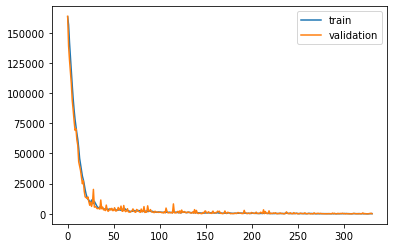

Epoch: 320, Train ELBO: -174.339, Val ELBO: -6911.362


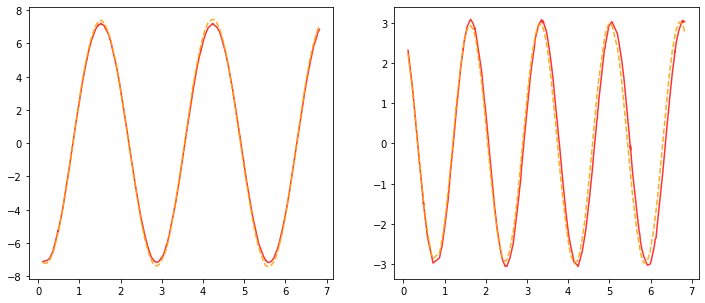

Current LR: [0.00020008241439094303]


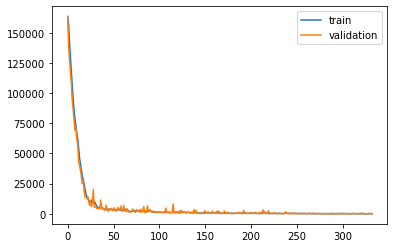

Epoch: 321, Train ELBO: -162.825, Val ELBO: -6841.877


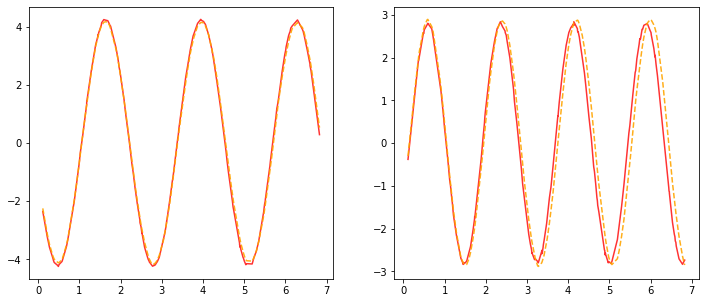

Current LR: [0.00019908200231898832]


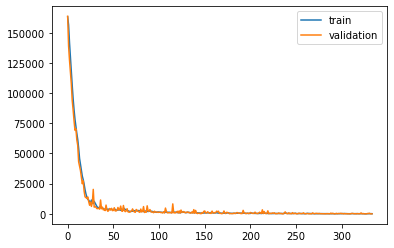

Epoch: 322, Train ELBO: -107.435, Val ELBO: -6773.902


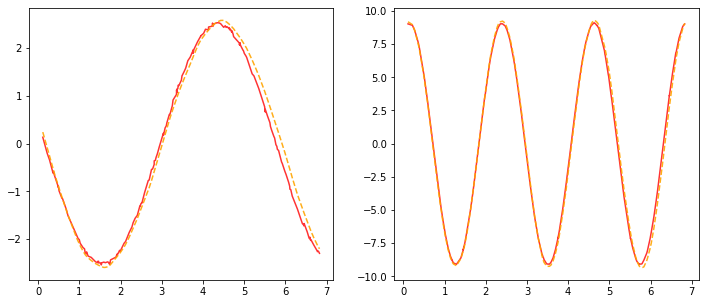

Current LR: [0.00019808659230739339]


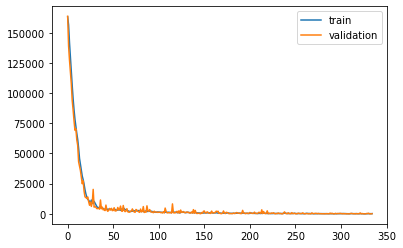

Epoch: 323, Train ELBO: -185.383, Val ELBO: -6707.362


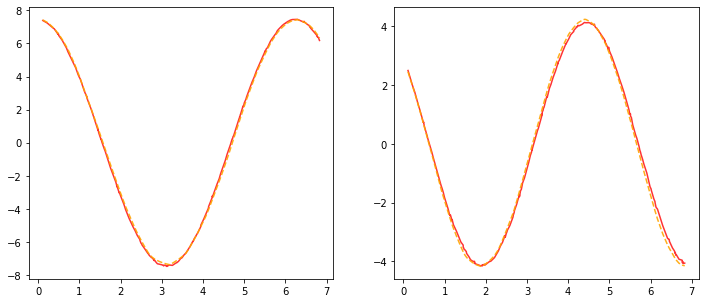

Current LR: [0.00019709615934585643]


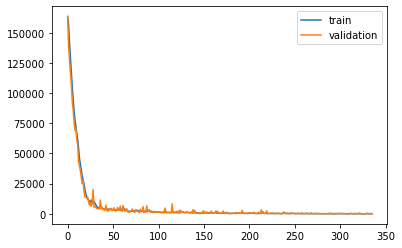

Epoch: 324, Train ELBO: -103.360, Val ELBO: -6640.229


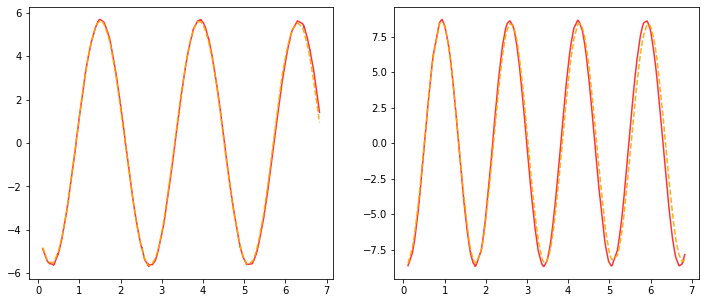

Current LR: [0.00019611067854912714]


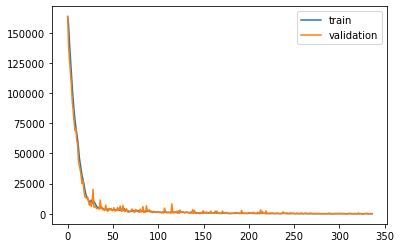

Epoch: 325, Train ELBO: -49.246, Val ELBO: -6575.731


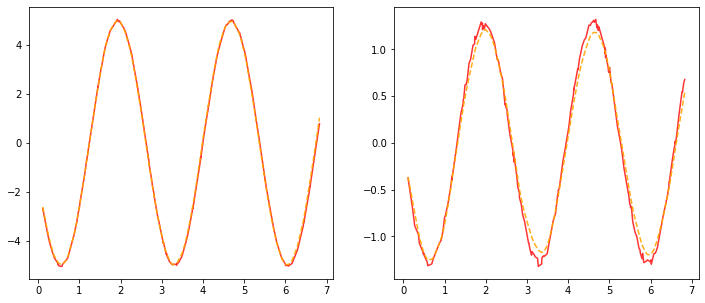

Current LR: [0.0001951301251563815]


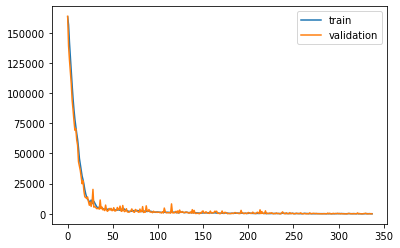

Epoch: 326, Train ELBO: -84.416, Val ELBO: -6509.493


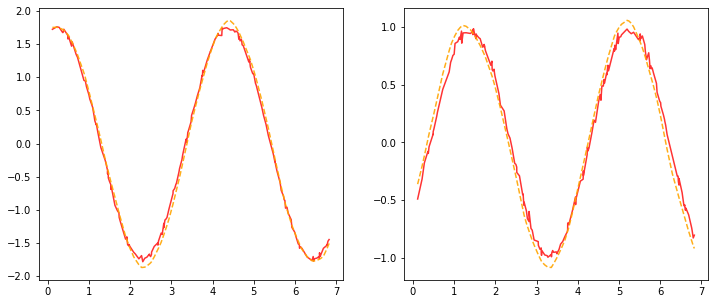

Current LR: [0.0001941544745305996]


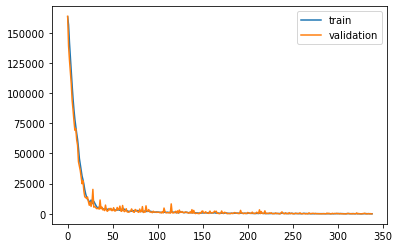

Epoch: 327, Train ELBO: -83.623, Val ELBO: -6444.501


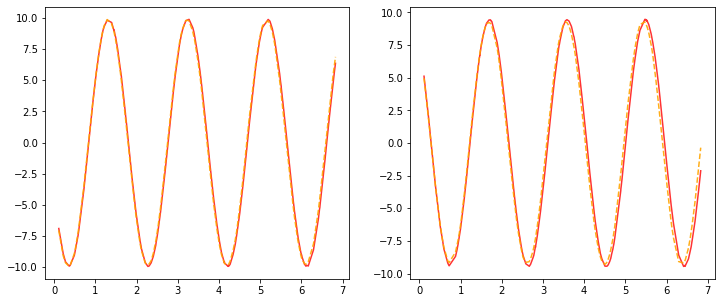

Current LR: [0.0001931837021579466]


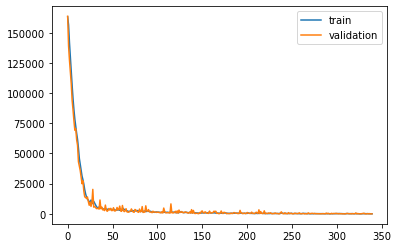

Epoch: 328, Train ELBO: -34.463, Val ELBO: -6380.200


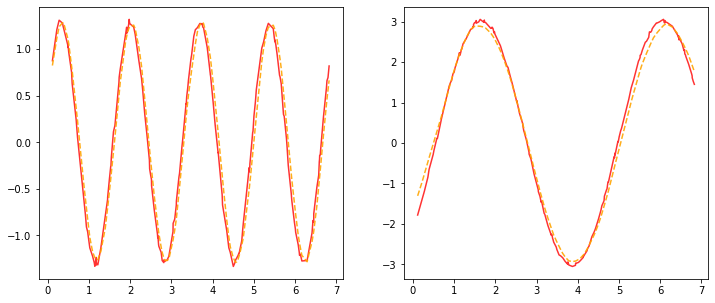

Current LR: [0.00019221778364715686]


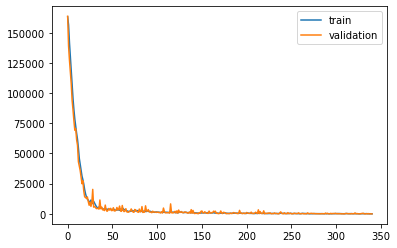

Epoch: 329, Train ELBO: -22.414, Val ELBO: -6316.044


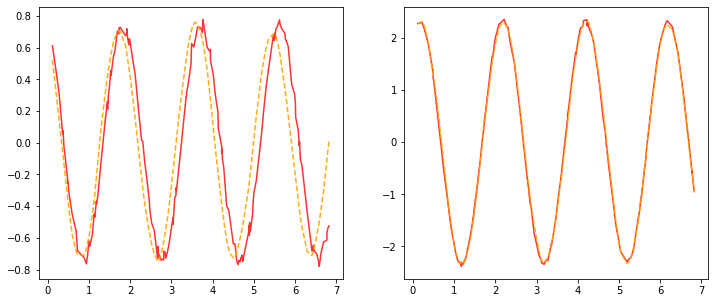

Current LR: [0.00019125669472892107]


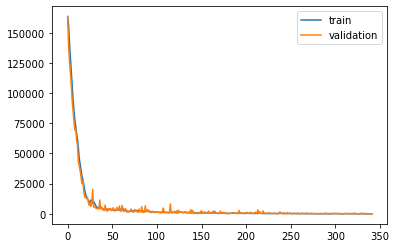

Epoch: 330, Train ELBO: -17.019, Val ELBO: -6252.989


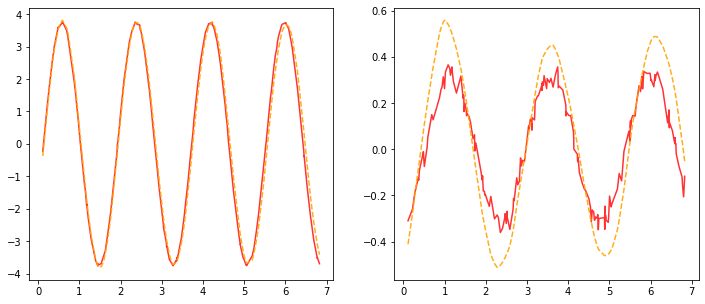

Current LR: [0.00019030041125527646]


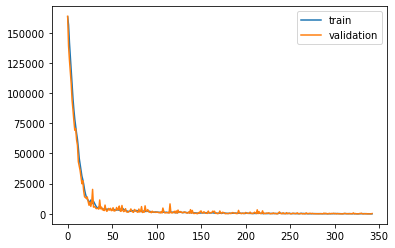

Epoch: 331, Train ELBO: -19.417, Val ELBO: -6192.738


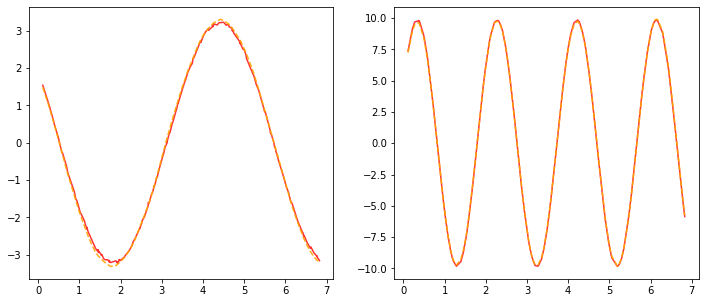

Current LR: [0.00018934890919900007]


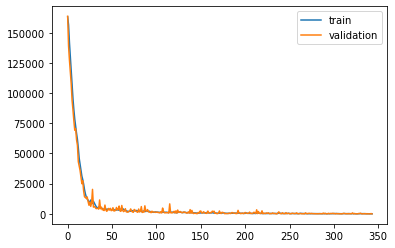

Epoch: 332, Train ELBO: -30.691, Val ELBO: -6130.029


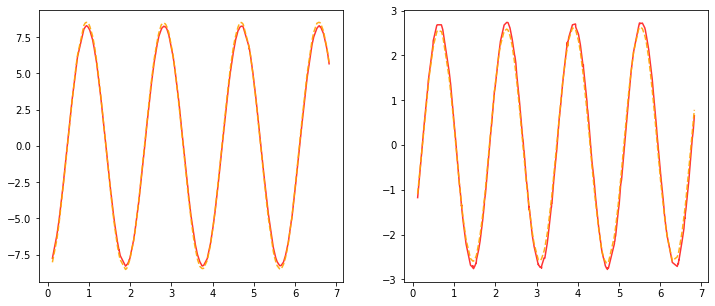

Current LR: [0.00018840216465300507]


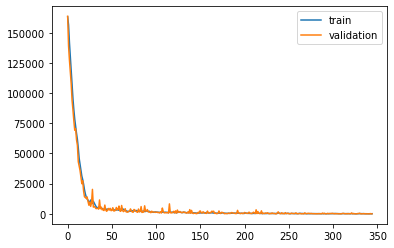

Epoch: 333, Train ELBO: -91.632, Val ELBO: -6069.160


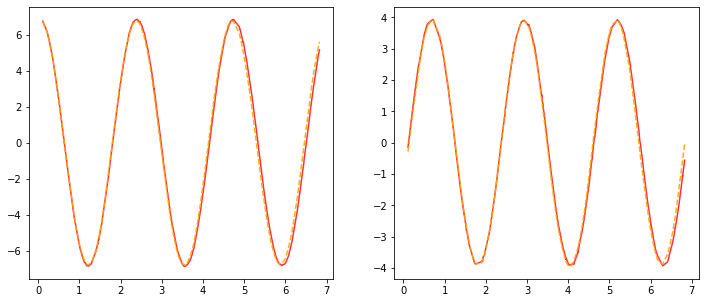

Current LR: [0.00018746015382974004]


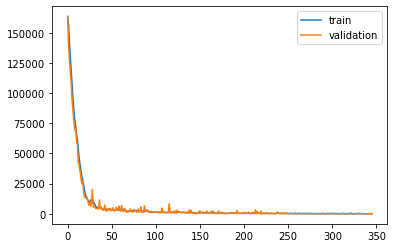

Epoch: 334, Train ELBO: -102.081, Val ELBO: -6009.342


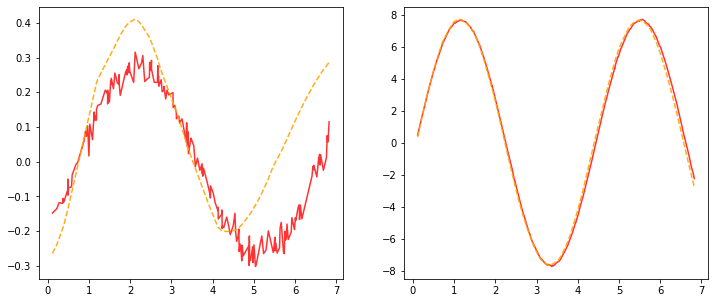

Current LR: [0.00018652285306059135]


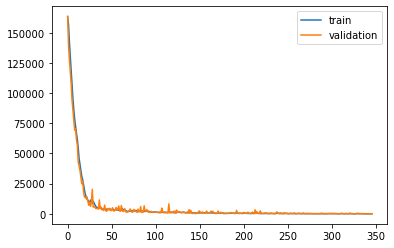

Epoch: 335, Train ELBO: -67.956, Val ELBO: -5949.903


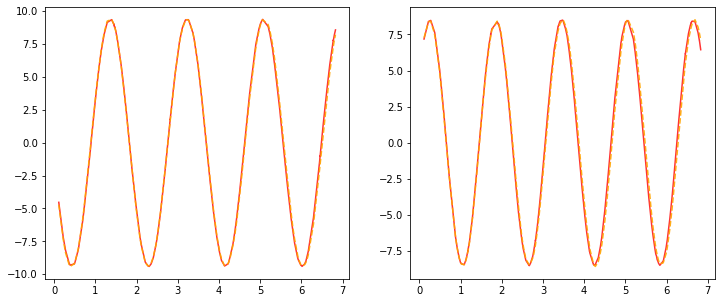

Current LR: [0.00018559023879528838]


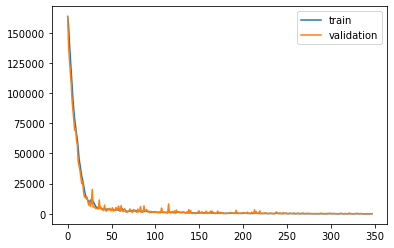

Epoch: 336, Train ELBO: -96.260, Val ELBO: -5891.434


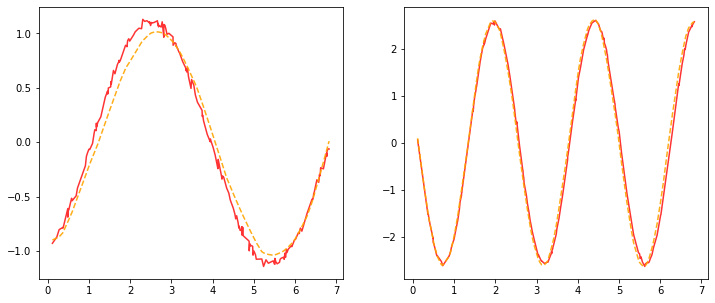

Current LR: [0.00018466228760131195]


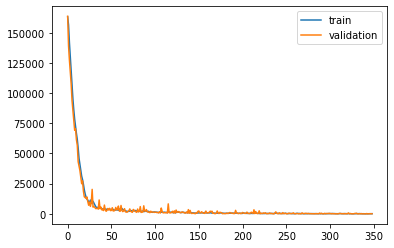

Epoch: 337, Train ELBO: -122.533, Val ELBO: -5833.259


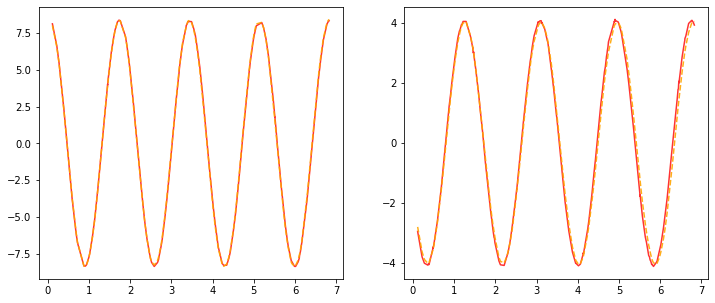

Current LR: [0.00018373897616330538]


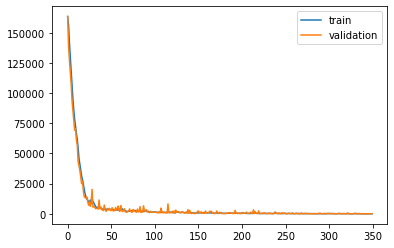

Epoch: 338, Train ELBO: -69.267, Val ELBO: -5775.945


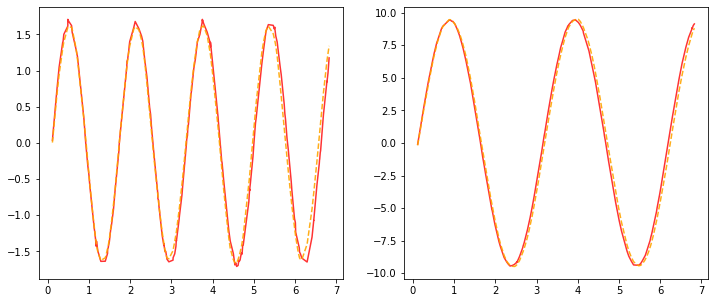

Current LR: [0.00018282028128248885]


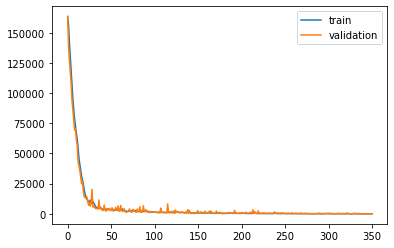

Epoch: 339, Train ELBO: -44.479, Val ELBO: -5717.857


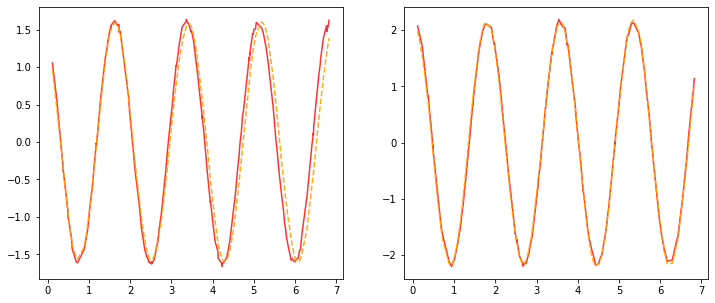

Current LR: [0.0001819061798760764]


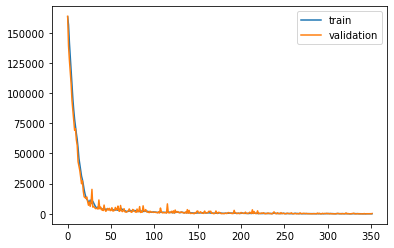

Epoch: 340, Train ELBO: -79.845, Val ELBO: -5663.027


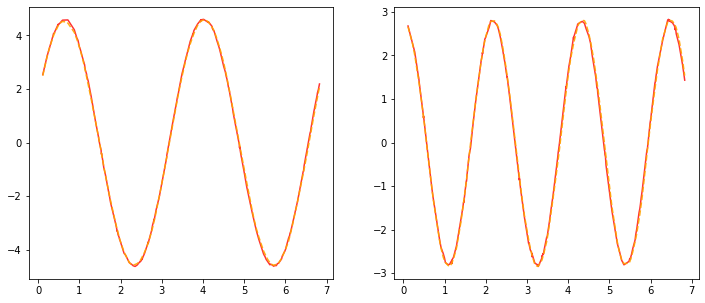

Current LR: [0.000180996648976696]


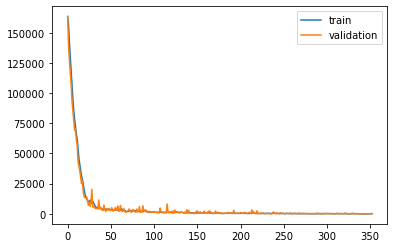

Epoch: 341, Train ELBO: -142.352, Val ELBO: -5606.787


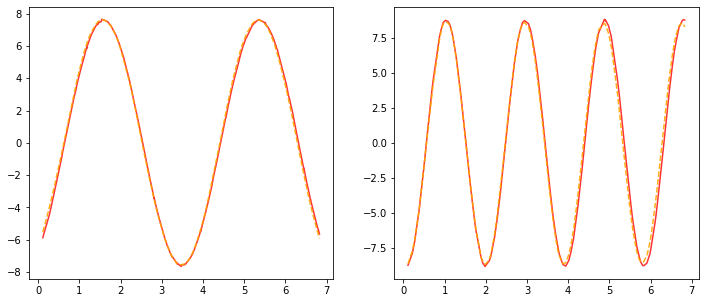

Current LR: [0.0001800916657318125]


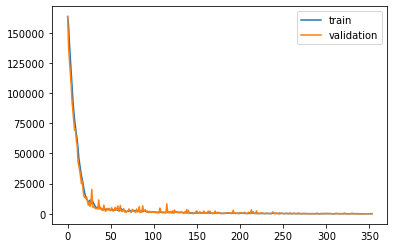

Epoch: 342, Train ELBO: -128.144, Val ELBO: -5551.706


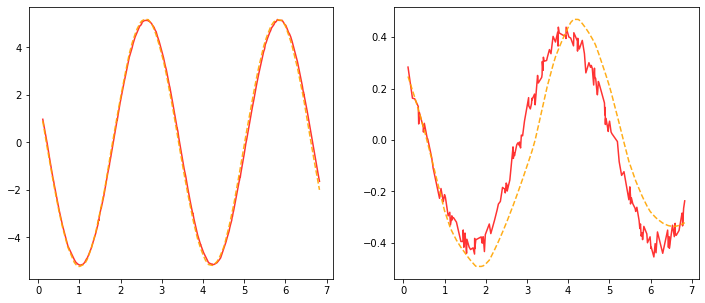

Current LR: [0.00017919120740315345]


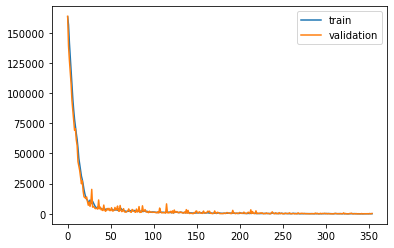

Epoch: 343, Train ELBO: -95.761, Val ELBO: -5498.729


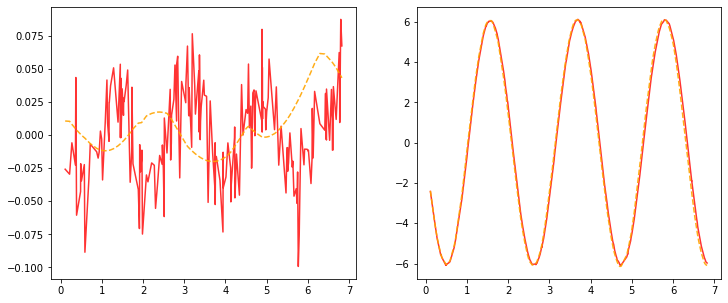

Current LR: [0.00017829525136613768]


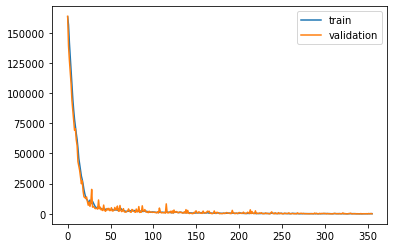

Epoch: 344, Train ELBO: -124.219, Val ELBO: -5443.672


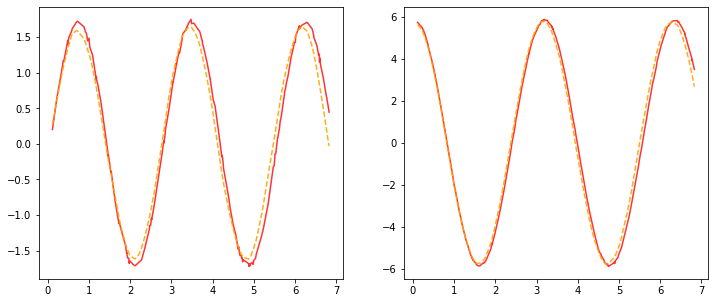

Current LR: [0.00017740377510930697]


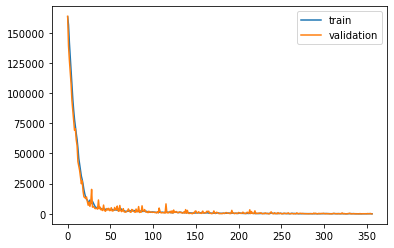

Epoch: 345, Train ELBO: -48.268, Val ELBO: -5388.688


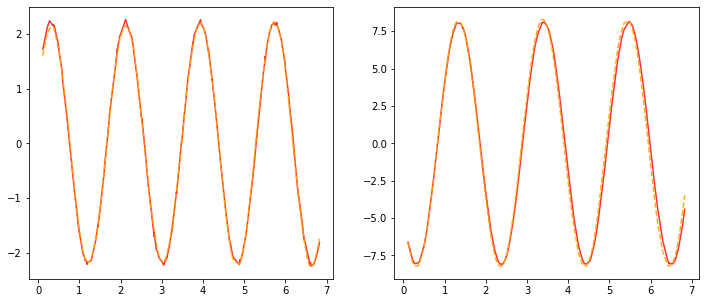

Current LR: [0.00017651675623376044]


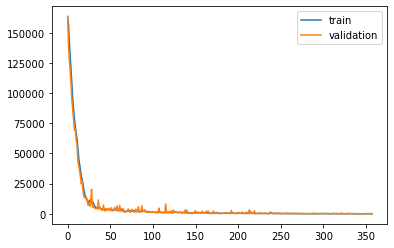

Epoch: 346, Train ELBO: -111.635, Val ELBO: -5335.867


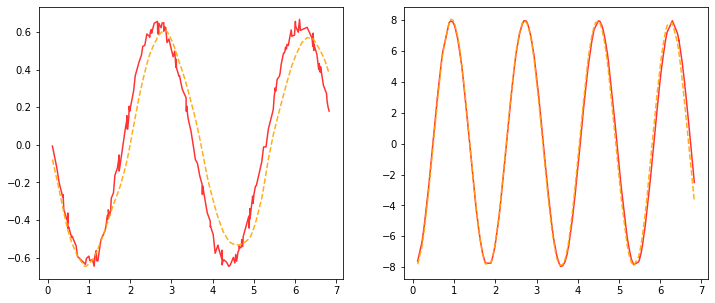

Current LR: [0.00017563417245259163]


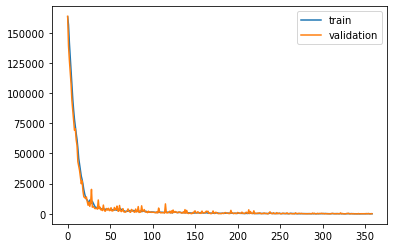

Epoch: 347, Train ELBO: -57.662, Val ELBO: -5283.469


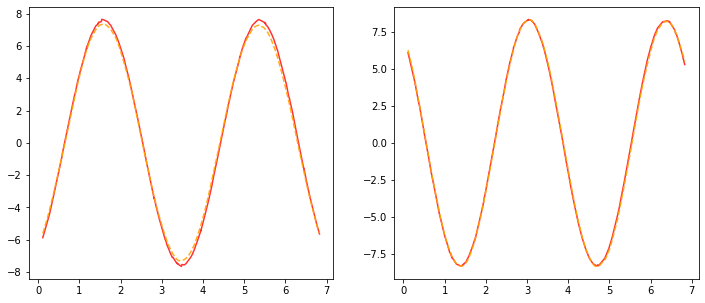

Current LR: [0.00017475600159032868]


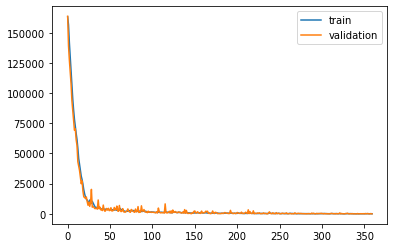

Epoch: 348, Train ELBO: -69.528, Val ELBO: -5230.335


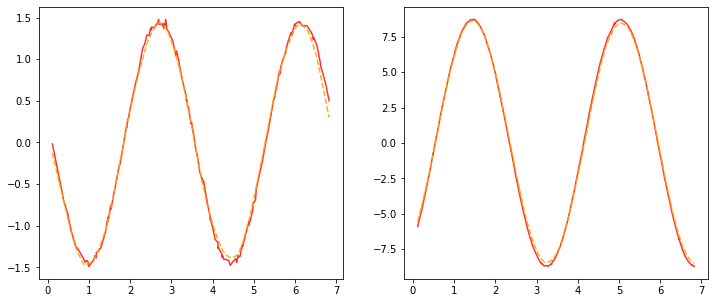

Current LR: [0.00017388222158237703]


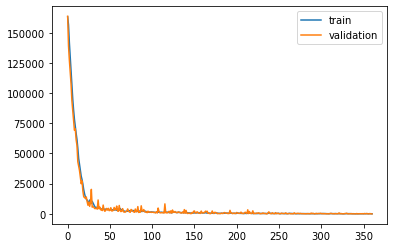

Epoch: 349, Train ELBO: -49.472, Val ELBO: -5177.225


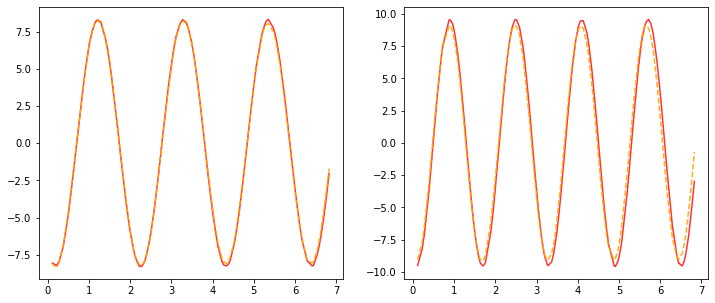

Current LR: [0.00017301281047446513]


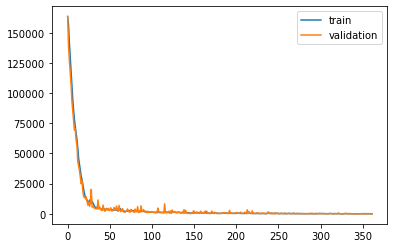

Epoch: 350, Train ELBO: -36.169, Val ELBO: -5124.782


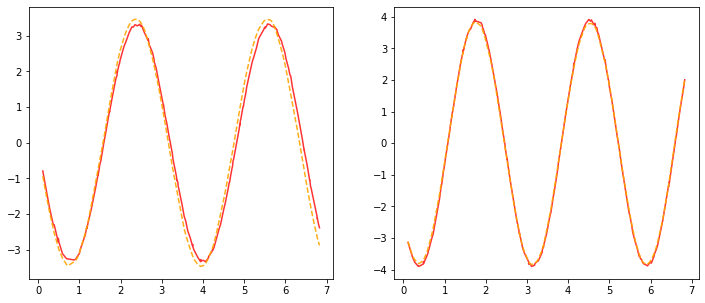

Current LR: [0.0001721477464220928]


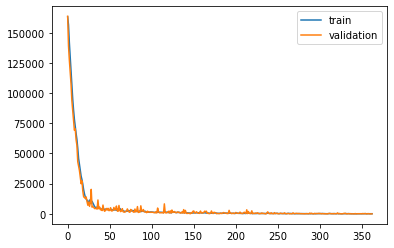

Epoch: 351, Train ELBO: -88.716, Val ELBO: -5073.606


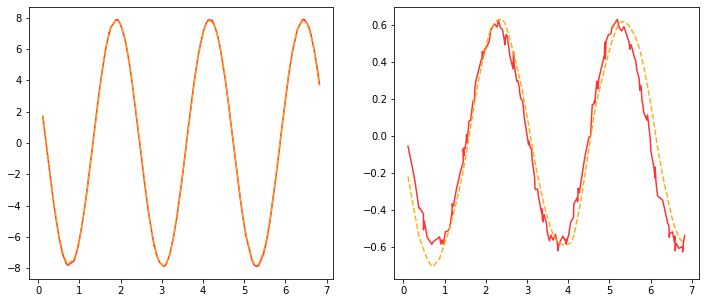

Current LR: [0.00017128700768998233]


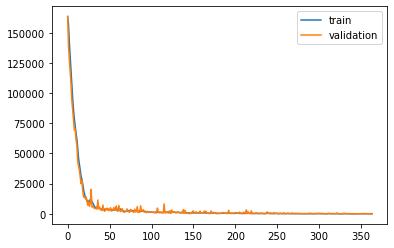

Epoch: 352, Train ELBO: -88.569, Val ELBO: -5022.983


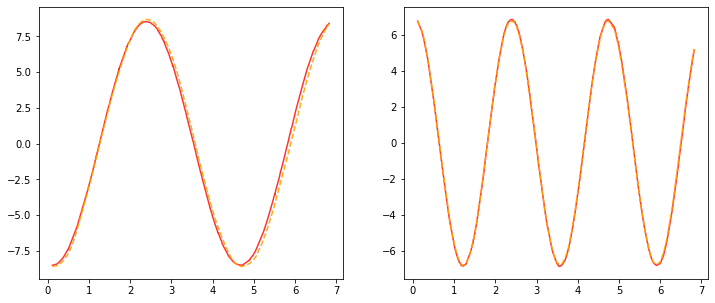

Current LR: [0.00017043057265153243]


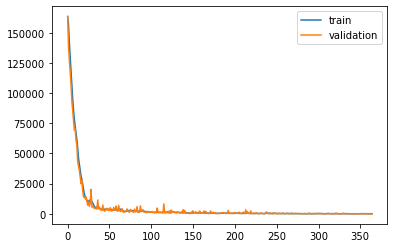

Epoch: 353, Train ELBO: -90.928, Val ELBO: -4972.346


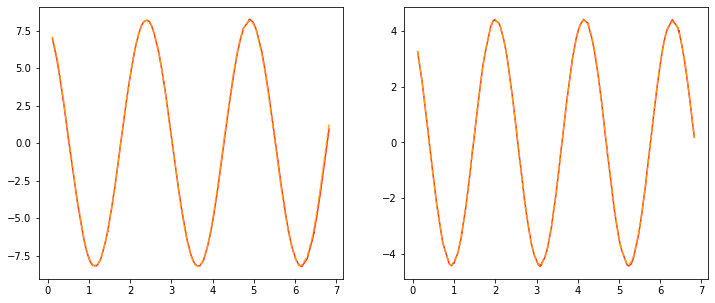

Current LR: [0.00016957841978827476]


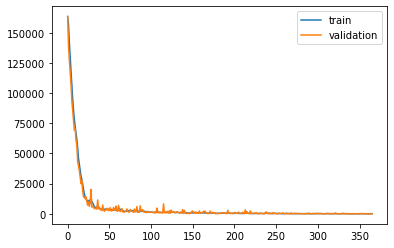

Epoch: 354, Train ELBO: -118.927, Val ELBO: -4922.900


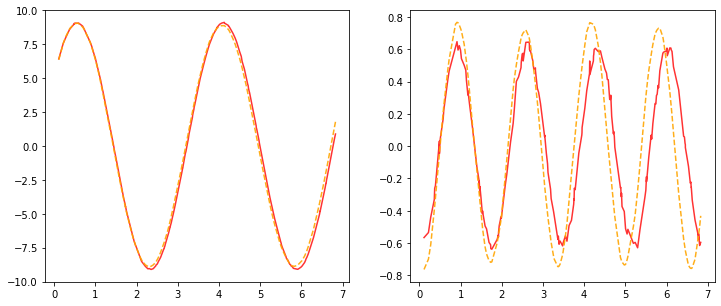

Current LR: [0.00016873052768933338]


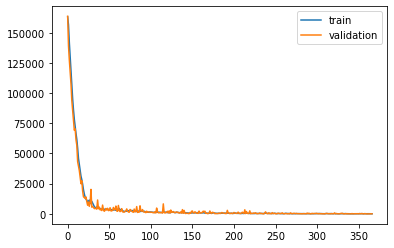

Epoch: 355, Train ELBO: -44.715, Val ELBO: -4874.046


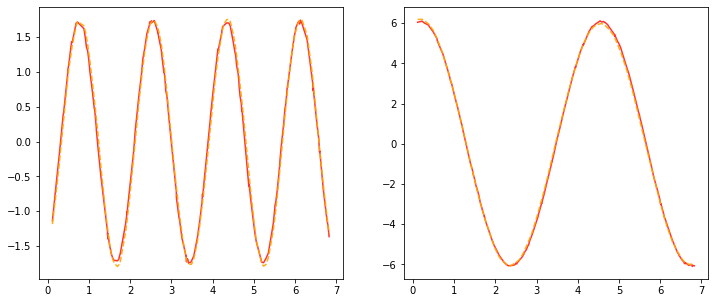

Current LR: [0.00016788687505088672]


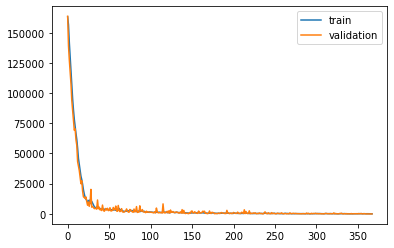

Epoch: 356, Train ELBO: -7.920, Val ELBO: -4824.545


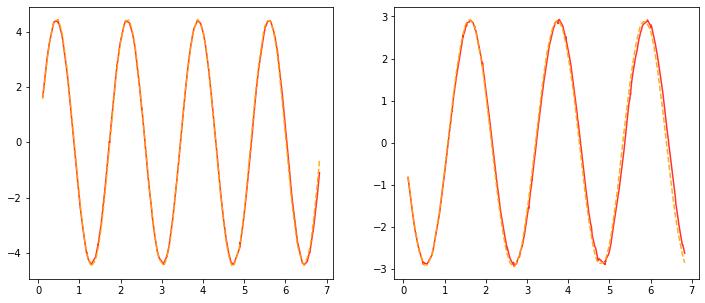

Current LR: [0.00016704744067563227]


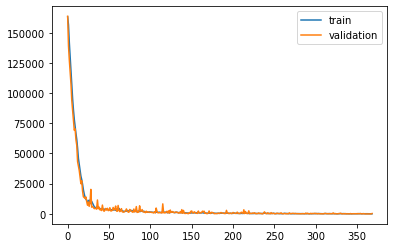

Epoch: 357, Train ELBO: -5.834, Val ELBO: -4778.897


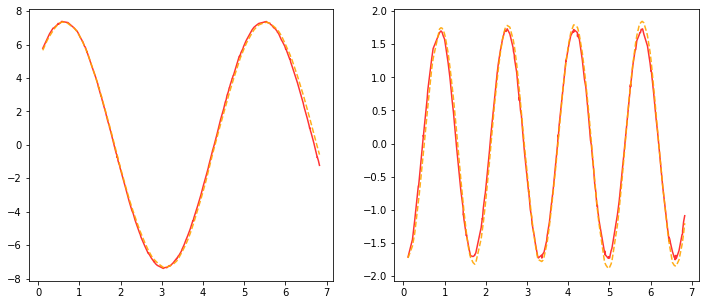

Current LR: [0.0001662122034722541]


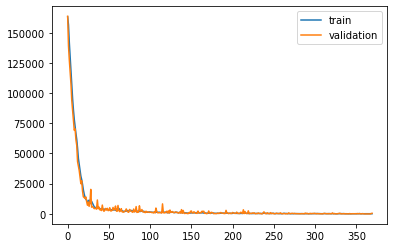

Epoch: 358, Train ELBO: -73.998, Val ELBO: -4735.496


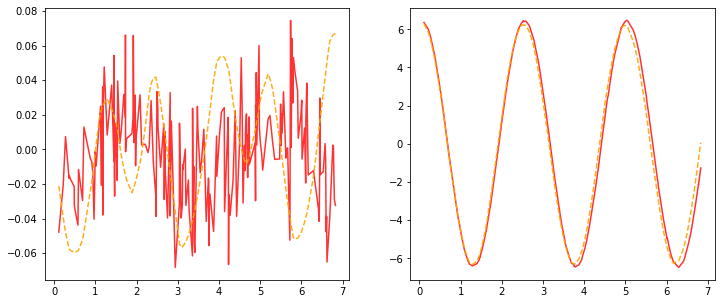

Current LR: [0.00016538114245489283]


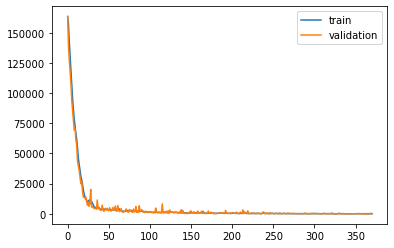

Epoch: 359, Train ELBO: -105.355, Val ELBO: -4688.648


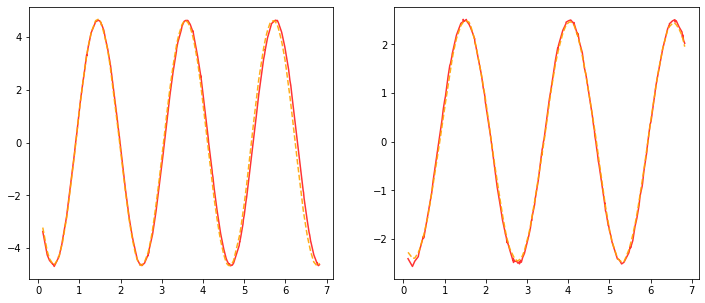

Current LR: [0.00016455423674261837]


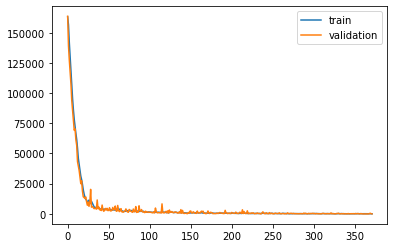

Epoch: 360, Train ELBO: -36.019, Val ELBO: -4640.850


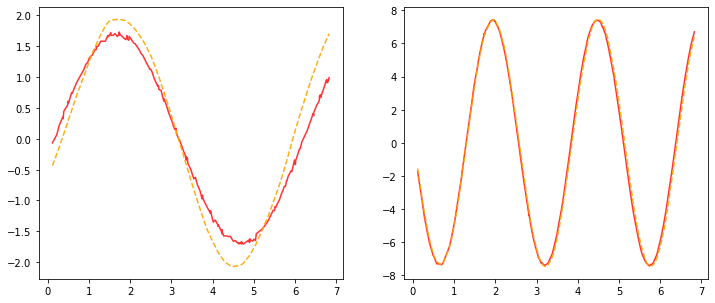

Current LR: [0.00016373146555890528]


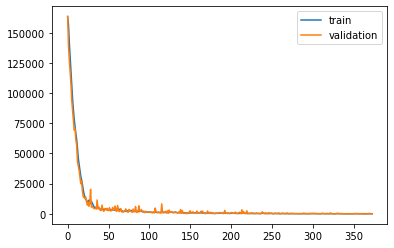

Epoch: 361, Train ELBO: -28.486, Val ELBO: -4593.606


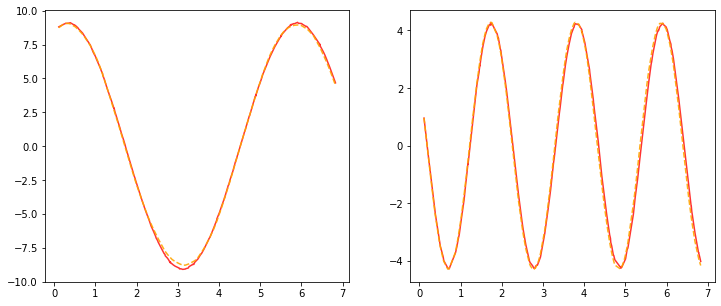

Current LR: [0.00016291280823111076]


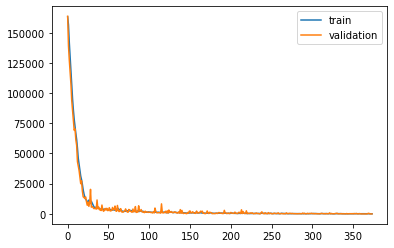

Epoch: 362, Train ELBO: -29.493, Val ELBO: -4546.993


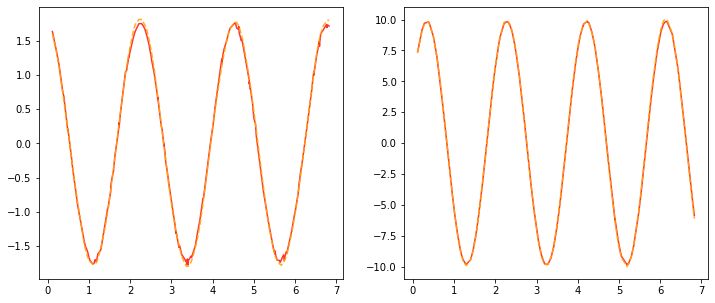

Current LR: [0.0001620982441899552]


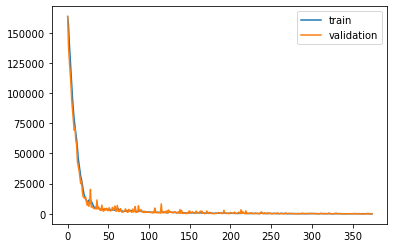

Epoch: 363, Train ELBO: 7.253, Val ELBO: -4501.190


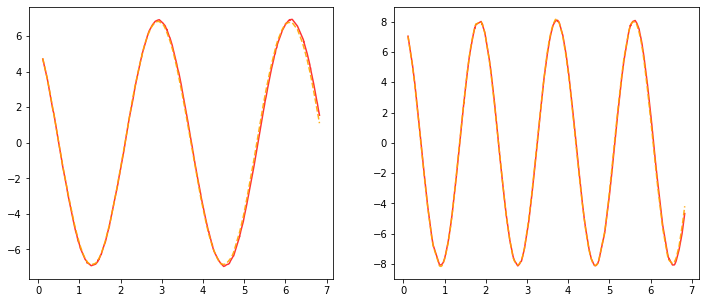

Current LR: [0.00016128775296900543]


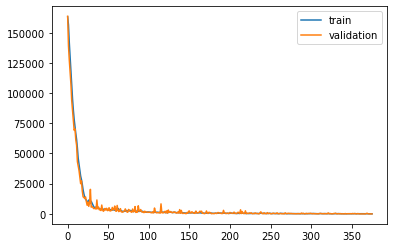

Epoch: 364, Train ELBO: 10.370, Val ELBO: -4455.561


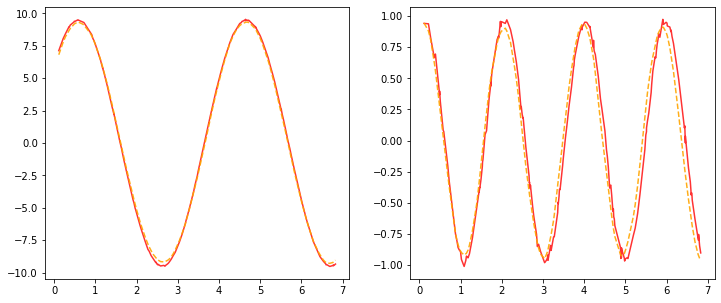

Current LR: [0.0001604813142041604]


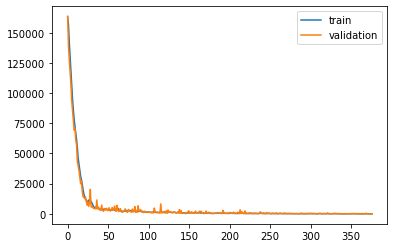

Epoch: 365, Train ELBO: 12.149, Val ELBO: -4410.875


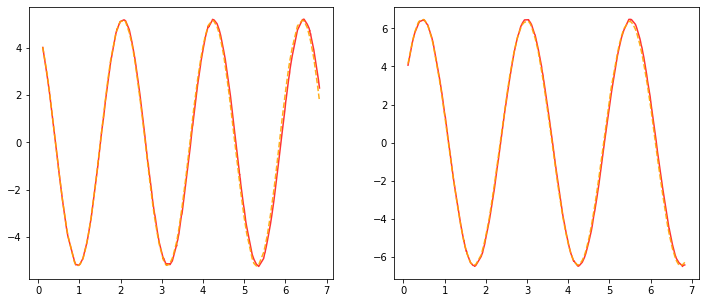

Current LR: [0.0001596789076331396]


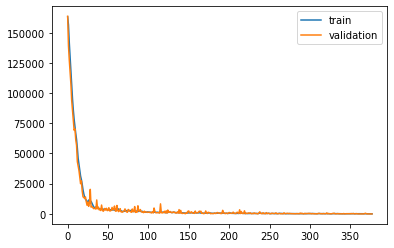

Epoch: 366, Train ELBO: 20.142, Val ELBO: -4365.834


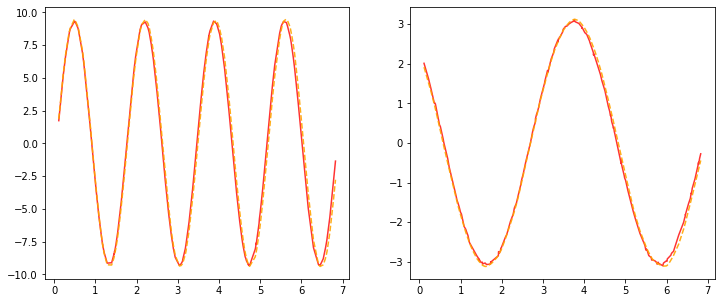

Current LR: [0.00015888051309497392]


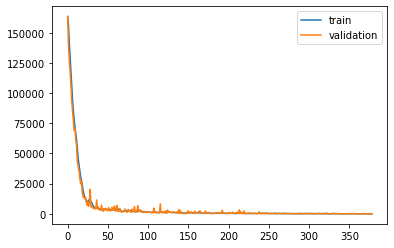

Epoch: 367, Train ELBO: 8.266, Val ELBO: -4322.314


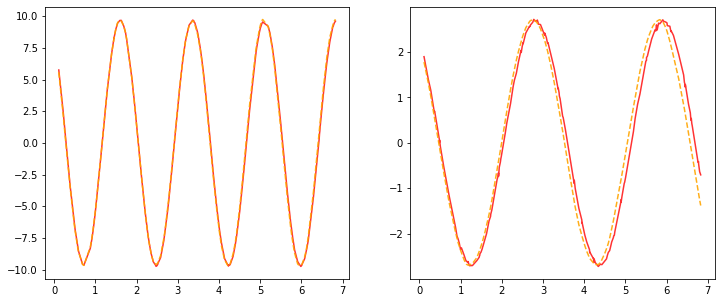

Current LR: [0.00015808611052949906]


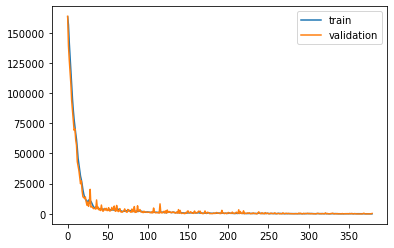

Epoch: 368, Train ELBO: 26.038, Val ELBO: -4282.050


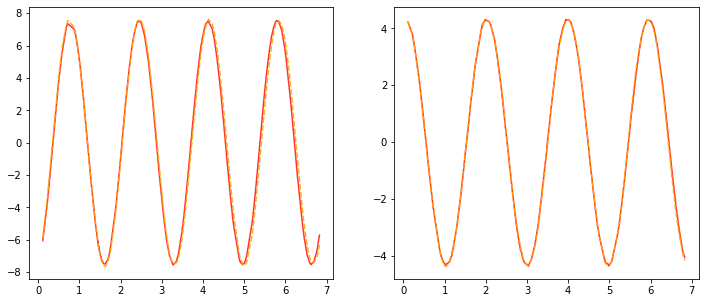

Current LR: [0.00015729567997685158]


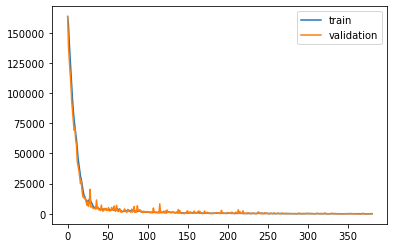

Epoch: 369, Train ELBO: -38.804, Val ELBO: -4239.883


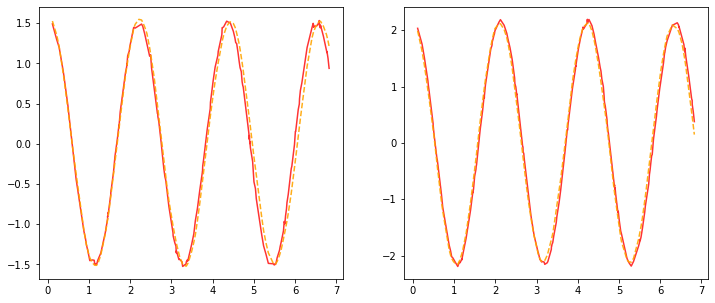

Current LR: [0.00015650920157696732]


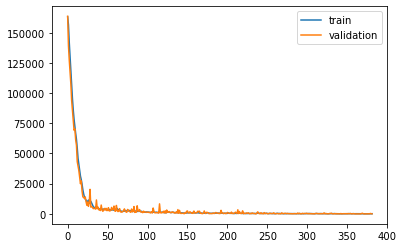

Epoch: 370, Train ELBO: -83.810, Val ELBO: -4197.204


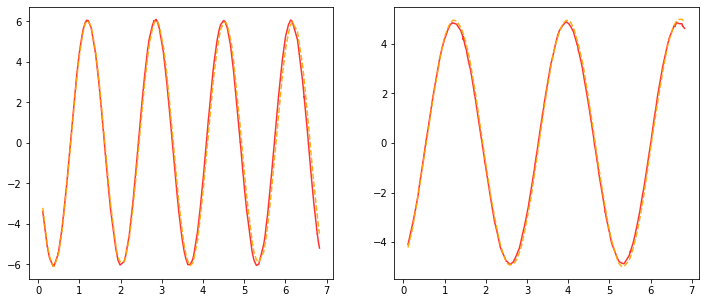

Current LR: [0.0001557266555690825]


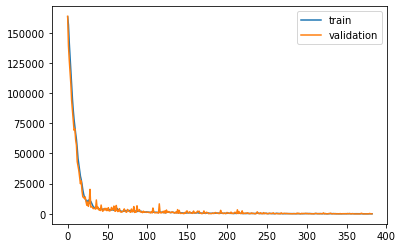

Epoch: 371, Train ELBO: -50.179, Val ELBO: -4155.086


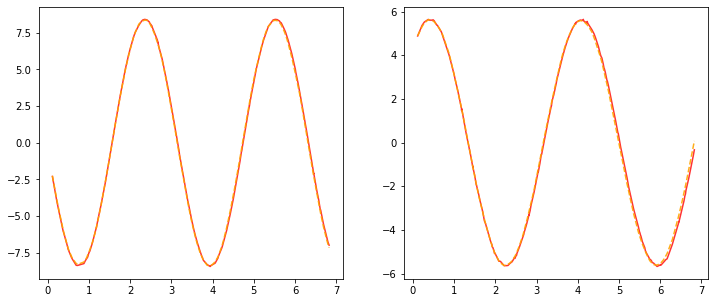

Current LR: [0.00015494802229123707]


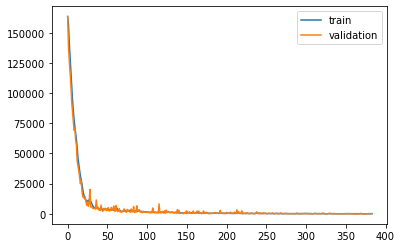

Epoch: 372, Train ELBO: -131.740, Val ELBO: -4113.757


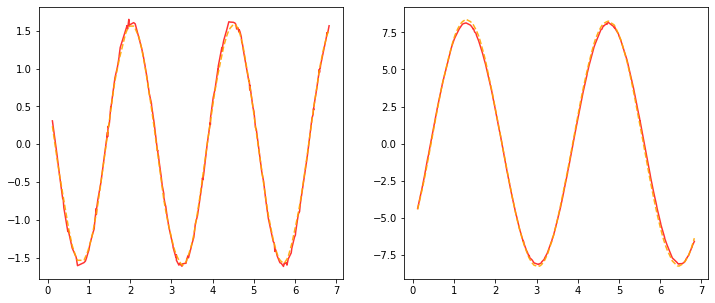

Current LR: [0.0001541732821797809]


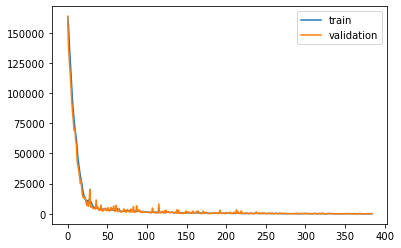

Epoch: 373, Train ELBO: -114.960, Val ELBO: -4073.018


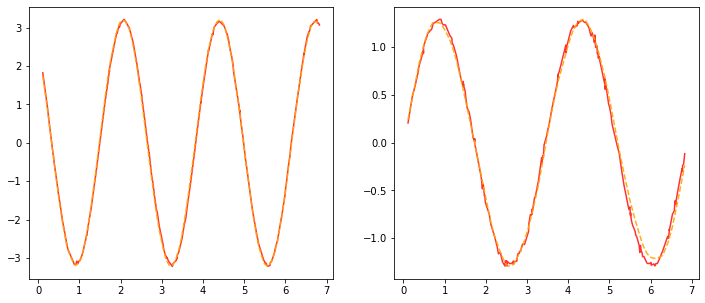

Current LR: [0.000153402415768882]


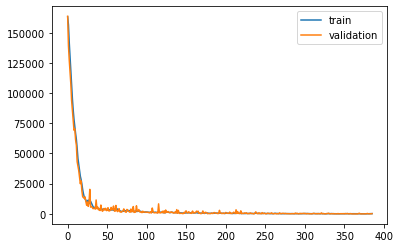

Epoch: 374, Train ELBO: -144.103, Val ELBO: -4033.807


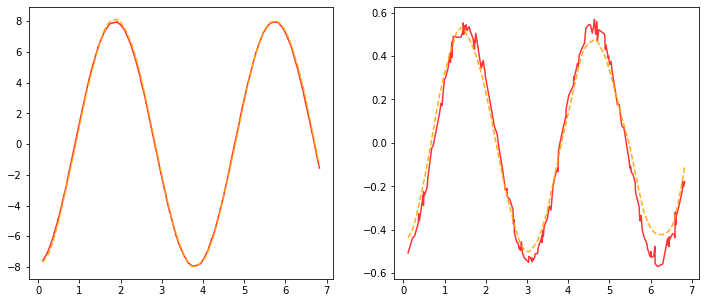

Current LR: [0.00015263540369003757]


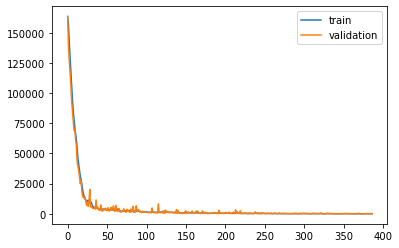

Epoch: 375, Train ELBO: -68.893, Val ELBO: -3992.279


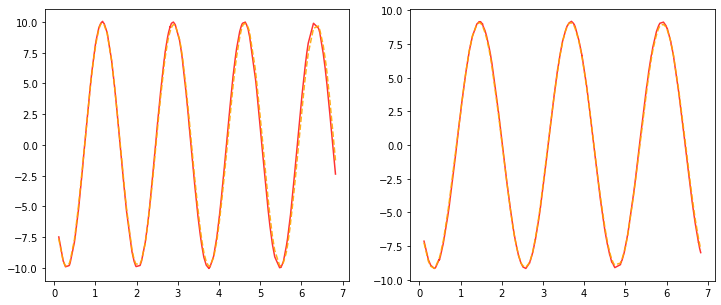

Current LR: [0.00015187222667158737]


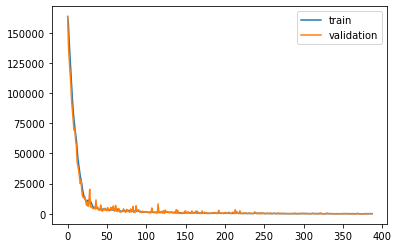

Epoch: 376, Train ELBO: -39.531, Val ELBO: -3953.366


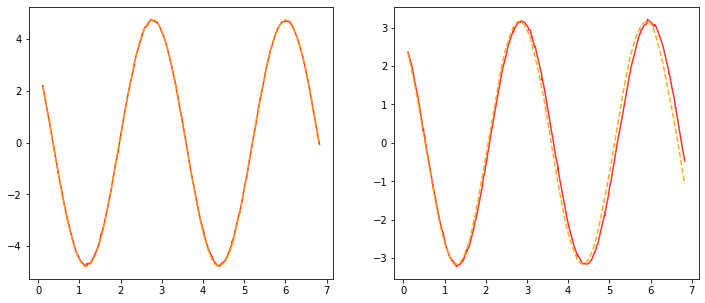

Current LR: [0.00015111286553822943]


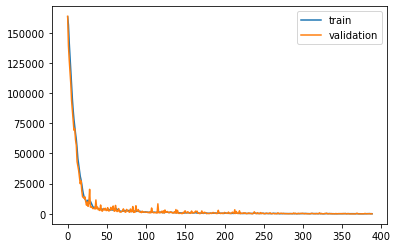

Epoch: 377, Train ELBO: -41.061, Val ELBO: -3913.041


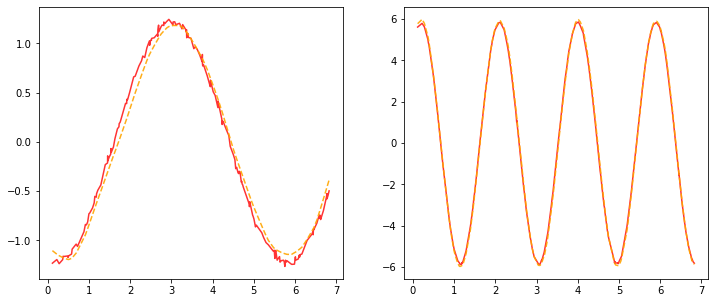

Current LR: [0.00015035730121053828]


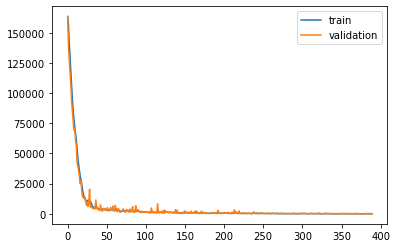

Epoch: 378, Train ELBO: -6.463, Val ELBO: -3873.837


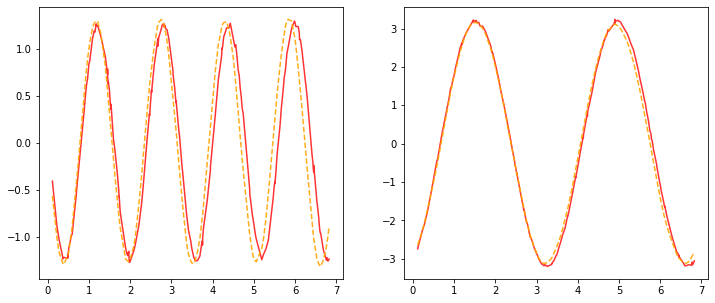

Current LR: [0.00014960551470448558]


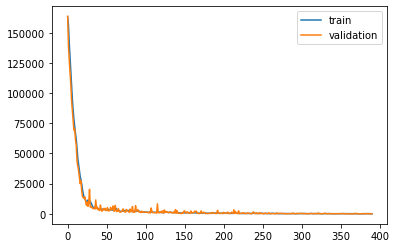

Epoch: 379, Train ELBO: -18.808, Val ELBO: -3834.492


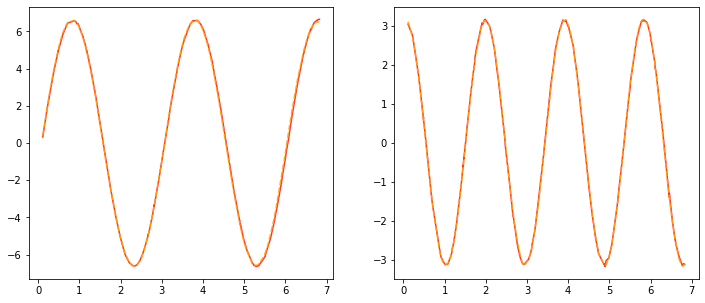

Current LR: [0.00014885748713096316]


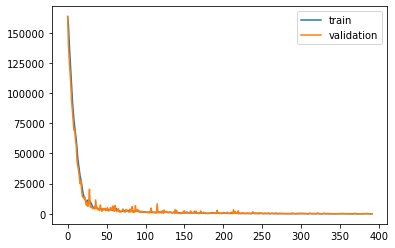

Epoch: 380, Train ELBO: -2.558, Val ELBO: -3796.196


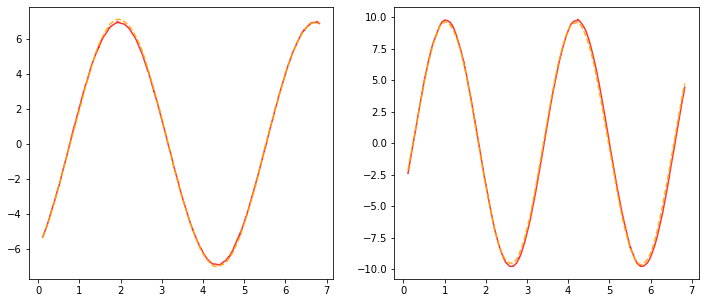

Current LR: [0.00014811319969530834]


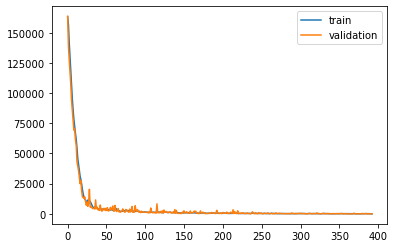

Epoch: 381, Train ELBO: 10.312, Val ELBO: -3757.271


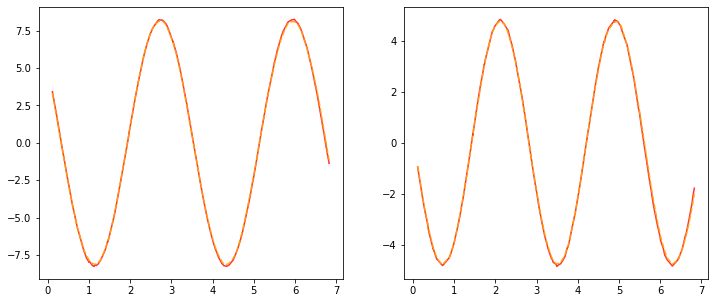

Current LR: [0.0001473726336968318]


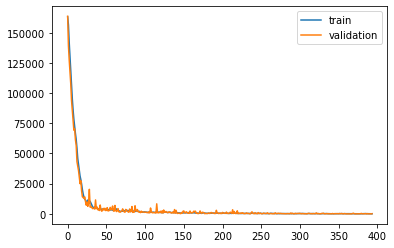

Epoch: 382, Train ELBO: -7.299, Val ELBO: -3720.364


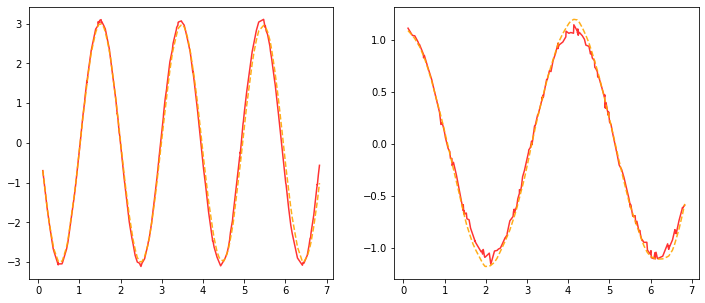

Current LR: [0.00014663577052834764]


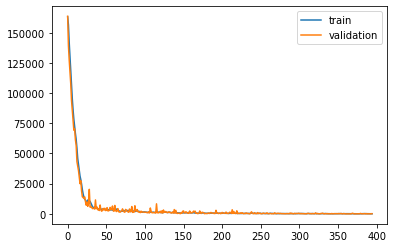

Epoch: 383, Train ELBO: -10.530, Val ELBO: -3683.869


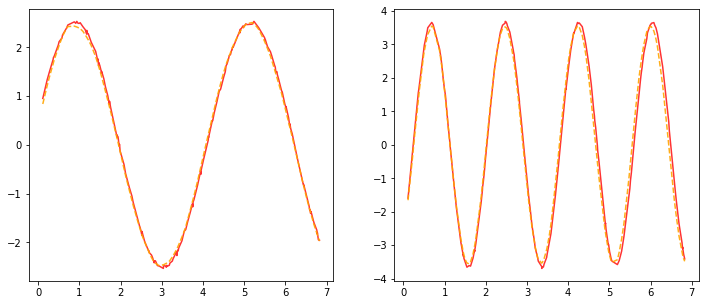

Current LR: [0.0001459025916757059]


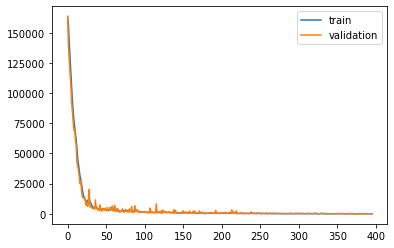

Epoch: 384, Train ELBO: -2.741, Val ELBO: -3647.104


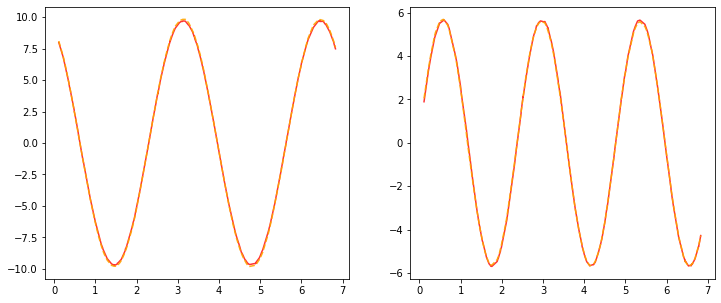

Current LR: [0.00014517307871732738]


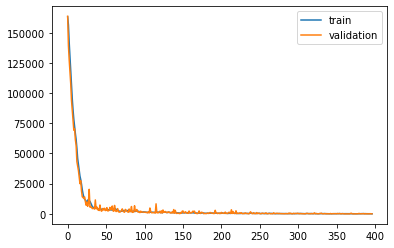

Epoch: 385, Train ELBO: 9.025, Val ELBO: -3610.193


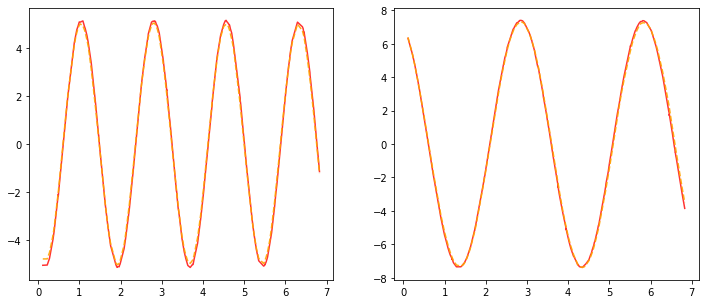

Current LR: [0.00014444721332374075]


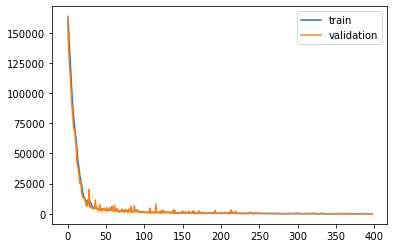

Epoch: 386, Train ELBO: -50.467, Val ELBO: -3573.107


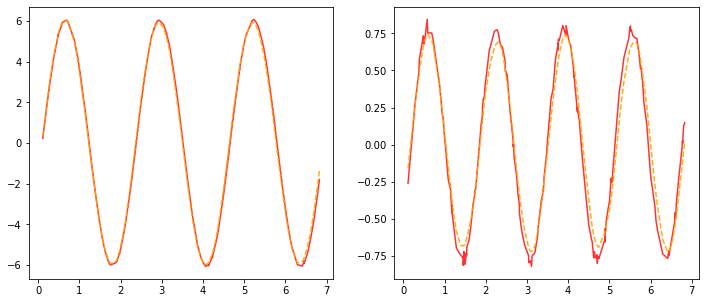

Current LR: [0.00014372497725712204]


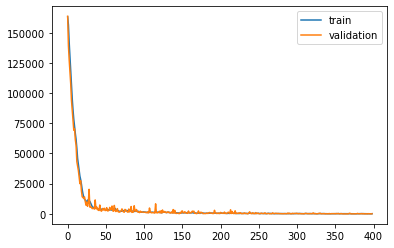

Epoch: 387, Train ELBO: -57.226, Val ELBO: -3537.821


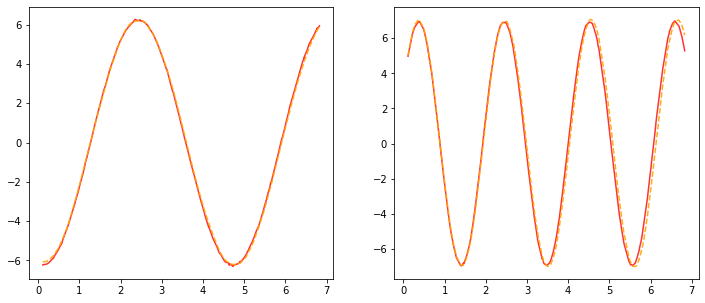

Current LR: [0.00014300635237083641]


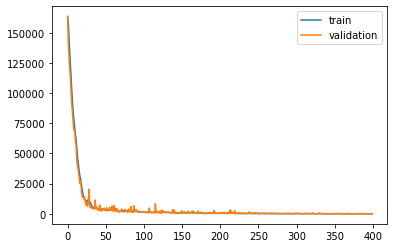

Epoch: 388, Train ELBO: 3.147, Val ELBO: -3504.011


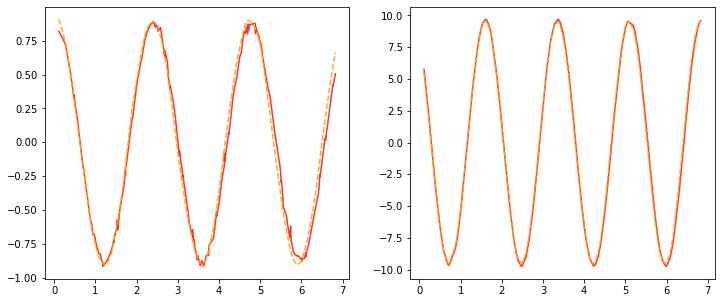

Current LR: [0.00014229132060898224]


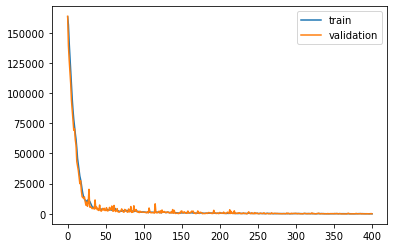

Epoch: 389, Train ELBO: 31.184, Val ELBO: -3468.663


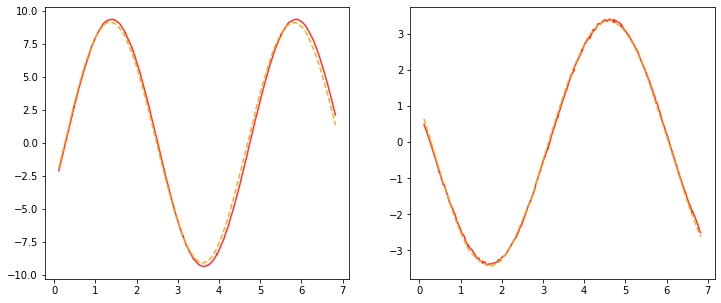

Current LR: [0.00014157986400593732]


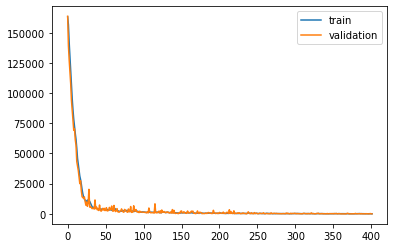

Epoch: 390, Train ELBO: -10.033, Val ELBO: -3433.360


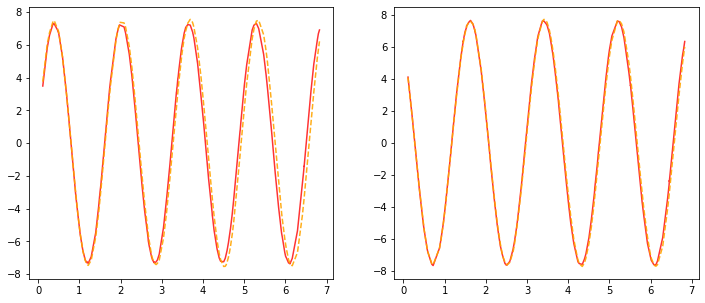

Current LR: [0.00014087196468590764]


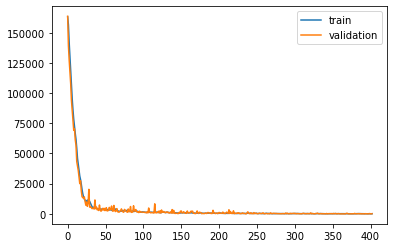

Epoch: 391, Train ELBO: -42.114, Val ELBO: -3399.669


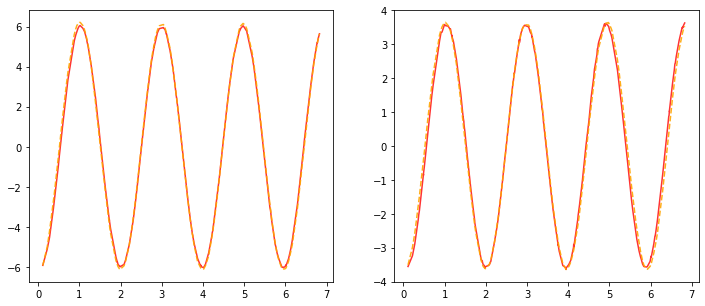

Current LR: [0.0001401676048624781]


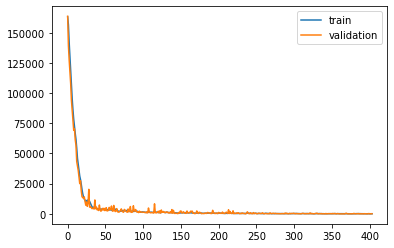

Epoch: 392, Train ELBO: -31.768, Val ELBO: -3365.912


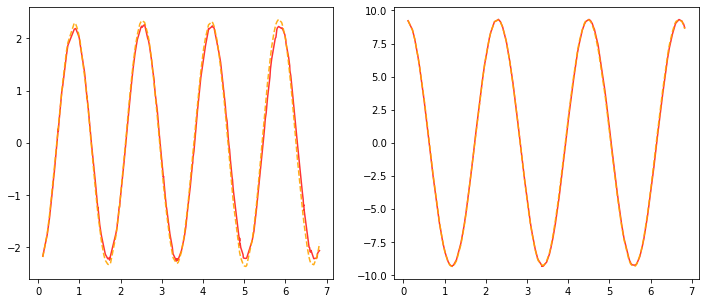

Current LR: [0.0001394667668381657]


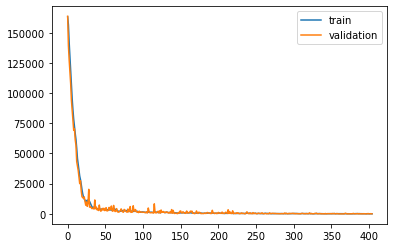

Epoch: 393, Train ELBO: 13.529, Val ELBO: -3331.955


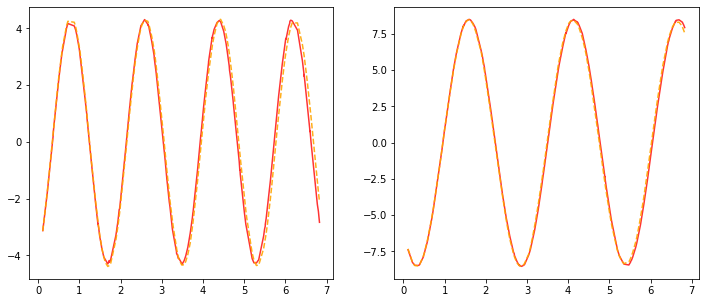

Current LR: [0.00013876943300397486]


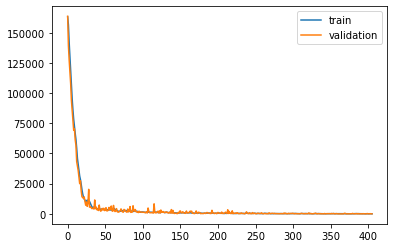

Epoch: 394, Train ELBO: 13.746, Val ELBO: -3298.151


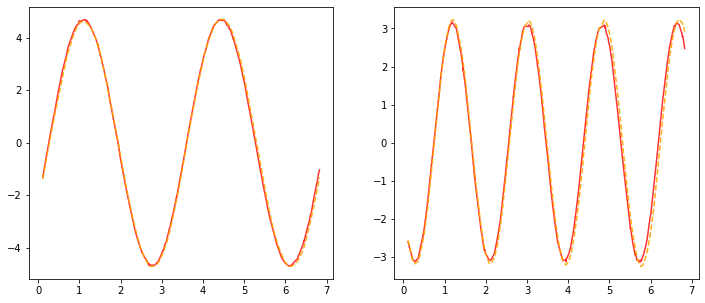

Current LR: [0.000138075585838955]


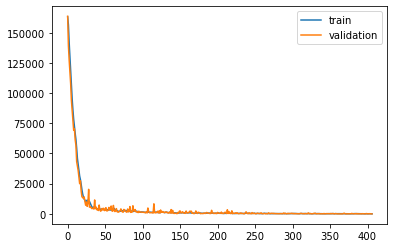

Epoch: 395, Train ELBO: 38.943, Val ELBO: -3264.194


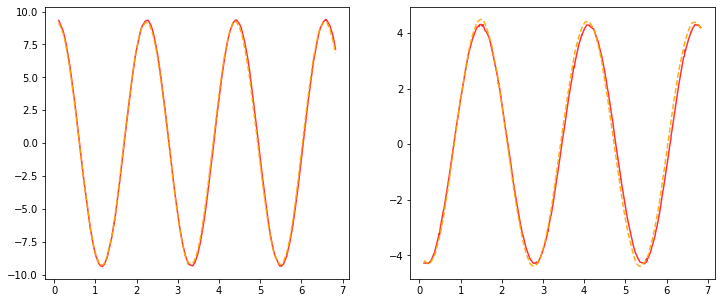

Current LR: [0.00013738520790976022]


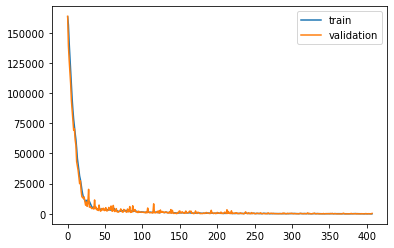

Epoch: 396, Train ELBO: 16.192, Val ELBO: -3234.760


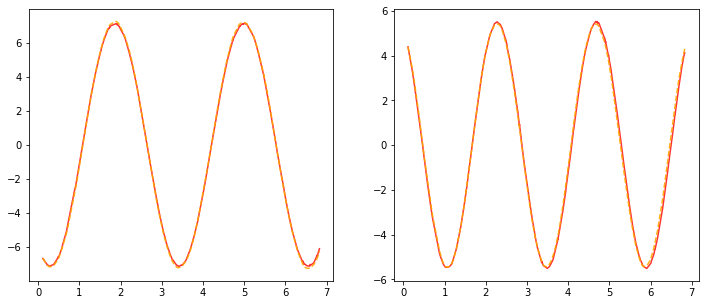

Current LR: [0.00013669828187021143]


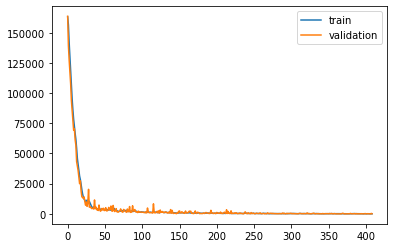

Epoch: 397, Train ELBO: 8.135, Val ELBO: -3202.760


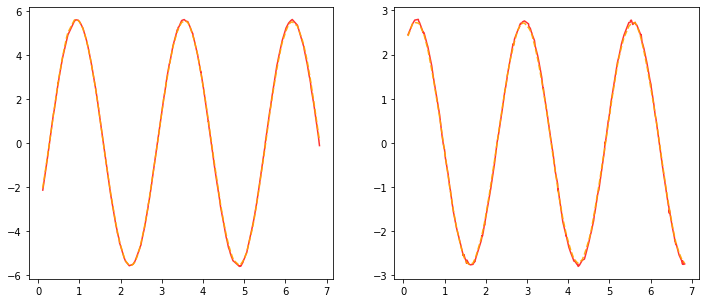

Current LR: [0.00013601479046086037]


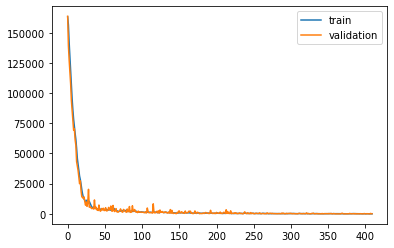

Epoch: 398, Train ELBO: 28.178, Val ELBO: -3171.116


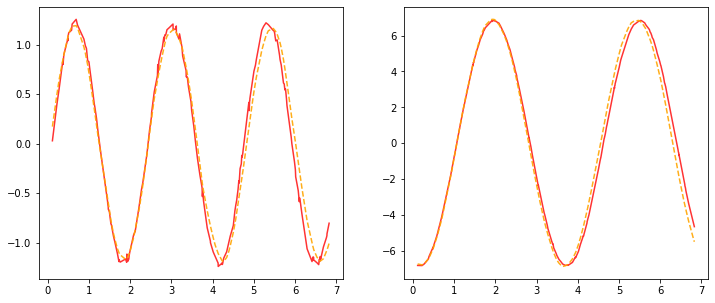

Current LR: [0.00013533471650855608]


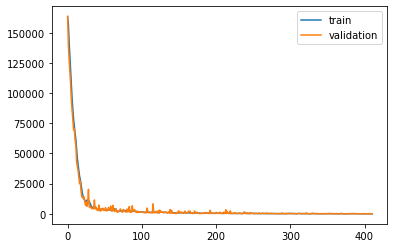

Epoch: 399, Train ELBO: 19.382, Val ELBO: -3139.102


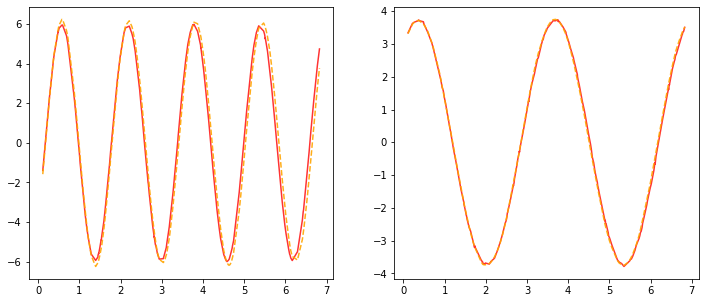

Current LR: [0.00013465804292601329]


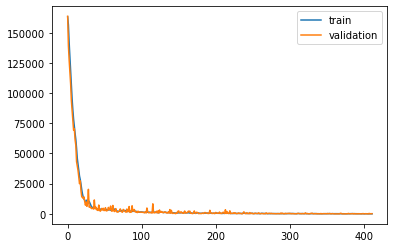

Epoch: 400, Train ELBO: 24.644, Val ELBO: -3108.438


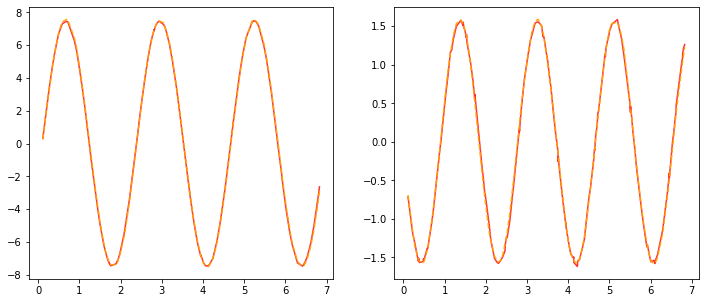

Current LR: [0.0001339847527113832]


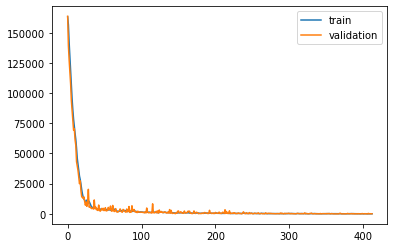

Epoch: 401, Train ELBO: -15.042, Val ELBO: -3077.492


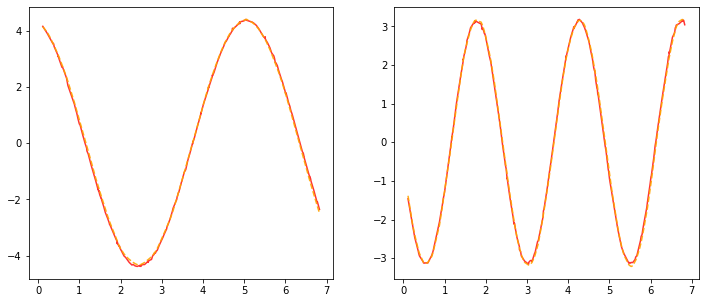

Current LR: [0.00013331482894782628]


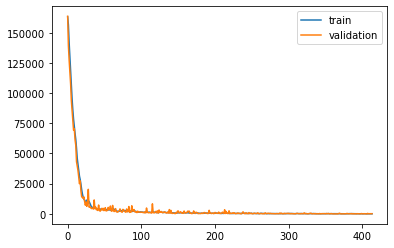

Epoch: 402, Train ELBO: 10.729, Val ELBO: -3047.427


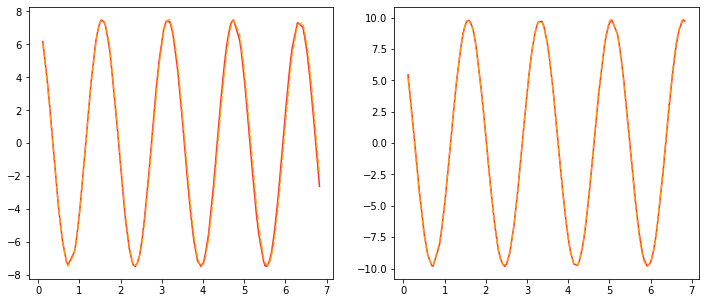

Current LR: [0.00013264825480308715]


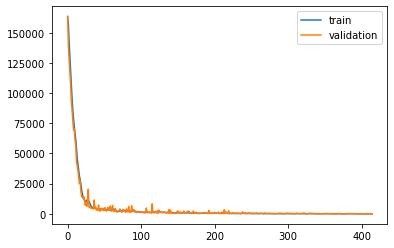

Epoch: 403, Train ELBO: 18.618, Val ELBO: -3015.869


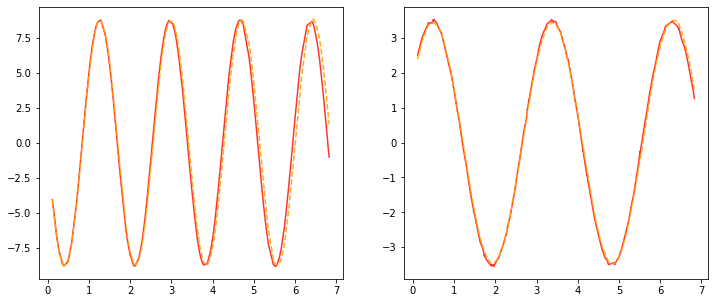

Current LR: [0.0001319850135290717]


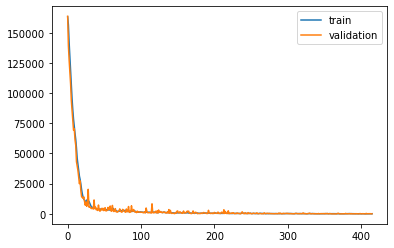

Epoch: 404, Train ELBO: -28.219, Val ELBO: -2985.873


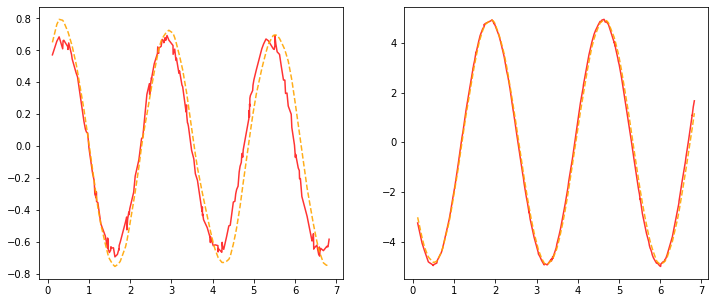

Current LR: [0.00013132508846142634]


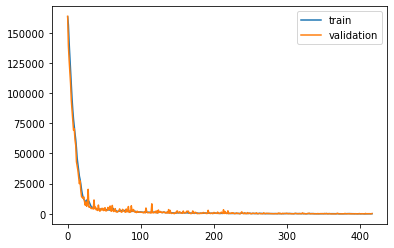

Epoch: 405, Train ELBO: -66.324, Val ELBO: -2957.648


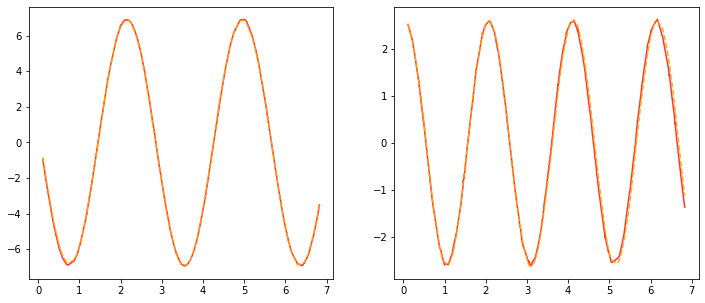

Current LR: [0.0001306684630191192]


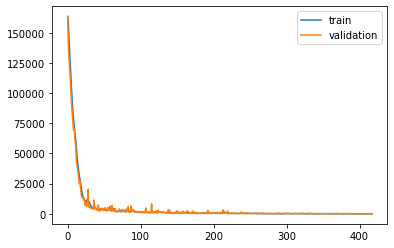

Epoch: 406, Train ELBO: -37.170, Val ELBO: -2927.377


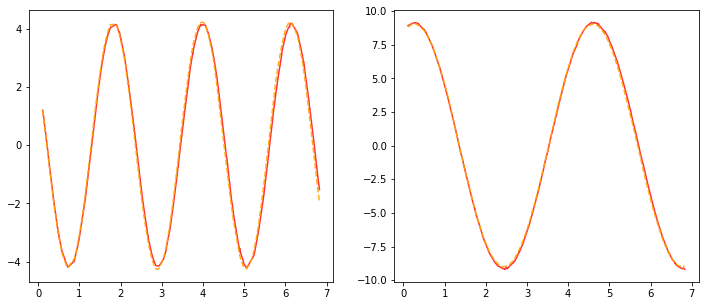

Current LR: [0.0001300151207040236]


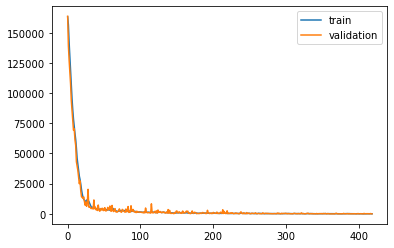

Epoch: 407, Train ELBO: 8.187, Val ELBO: -2897.740


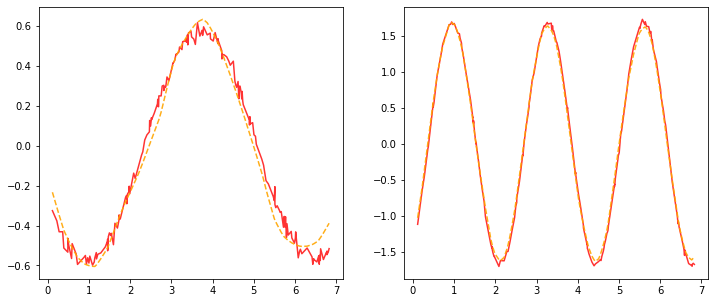

Current LR: [0.00012936504510050348]


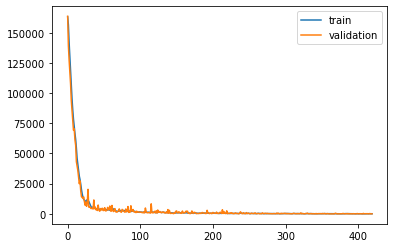

Epoch: 408, Train ELBO: -26.451, Val ELBO: -2868.655


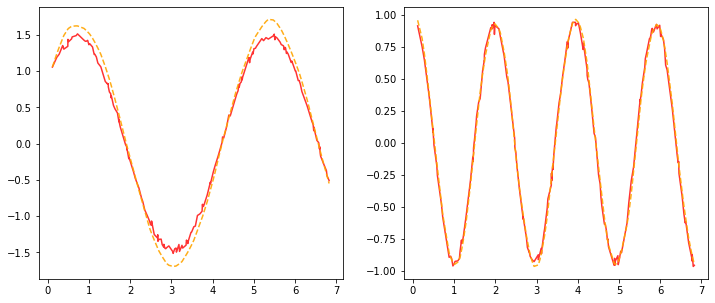

Current LR: [0.00012871821987500096]


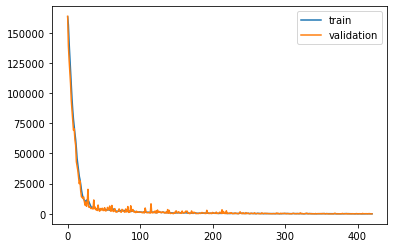

Epoch: 409, Train ELBO: 20.732, Val ELBO: -2839.580


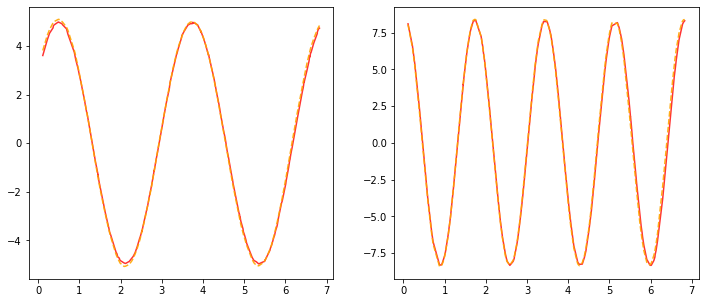

Current LR: [0.00012807462877562596]


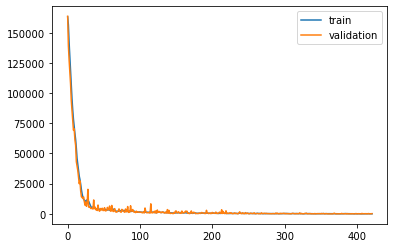

Epoch: 410, Train ELBO: 7.179, Val ELBO: -2812.208


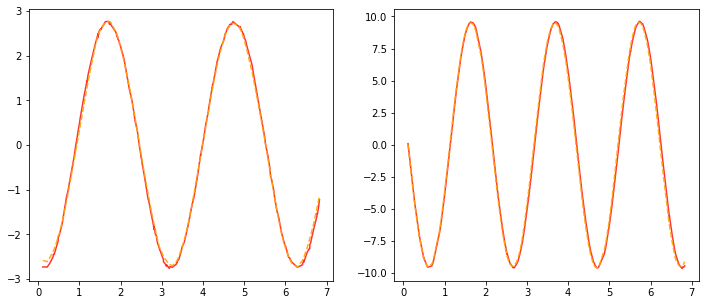

Current LR: [0.00012743425563174784]


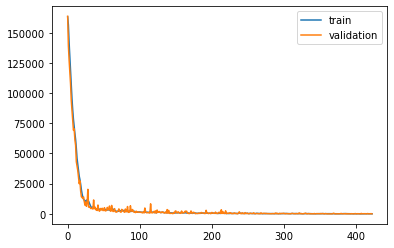

Epoch: 411, Train ELBO: 0.395, Val ELBO: -2783.332


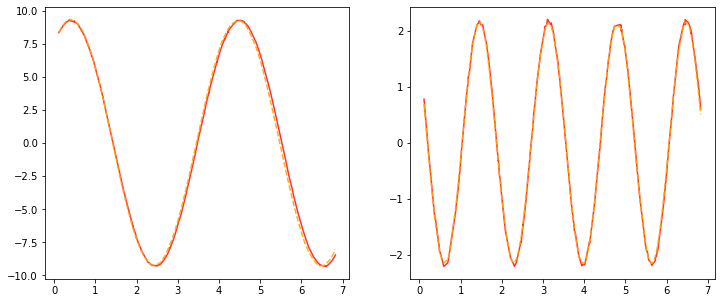

Current LR: [0.0001267970843535891]


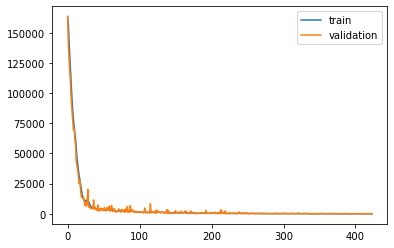

Epoch: 412, Train ELBO: -11.270, Val ELBO: -2758.177


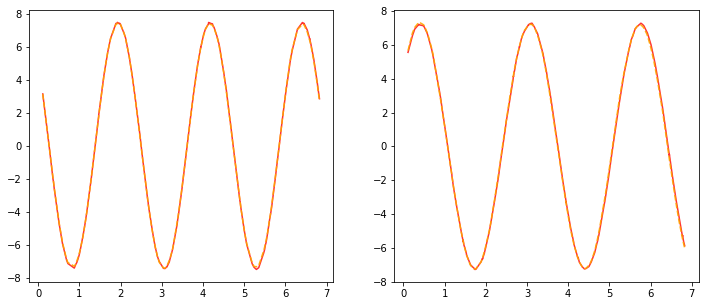

Current LR: [0.00012616309893182117]


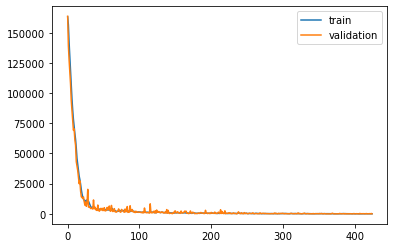

Epoch: 413, Train ELBO: -2.180, Val ELBO: -2730.210


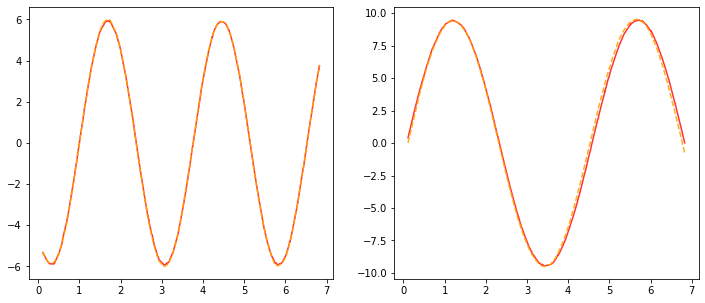

Current LR: [0.00012553228343716206]


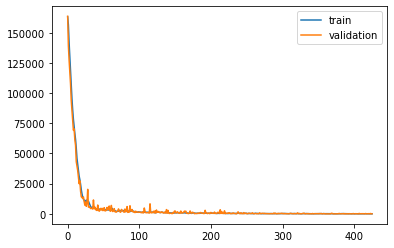

Epoch: 414, Train ELBO: 31.852, Val ELBO: -2702.914


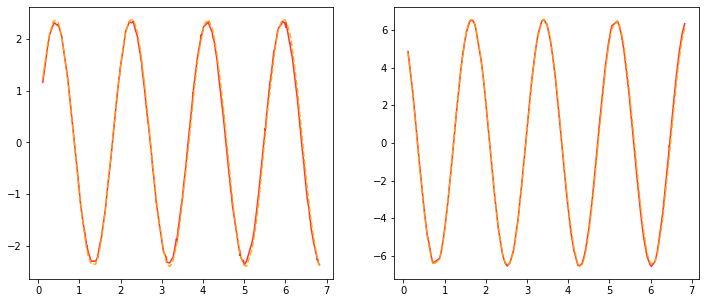

Current LR: [0.00012490462201997625]


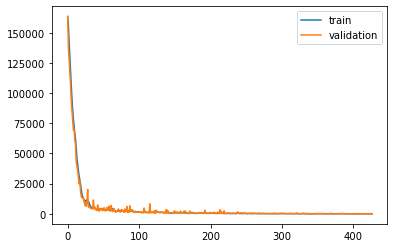

Epoch: 415, Train ELBO: 19.331, Val ELBO: -2674.960


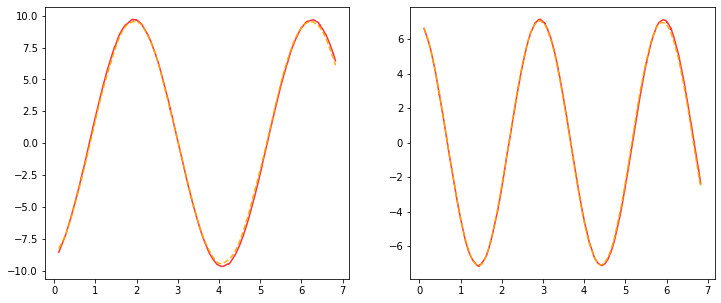

Current LR: [0.00012428009890987638]


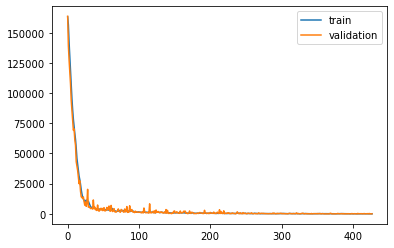

Epoch: 416, Train ELBO: 33.453, Val ELBO: -2648.254


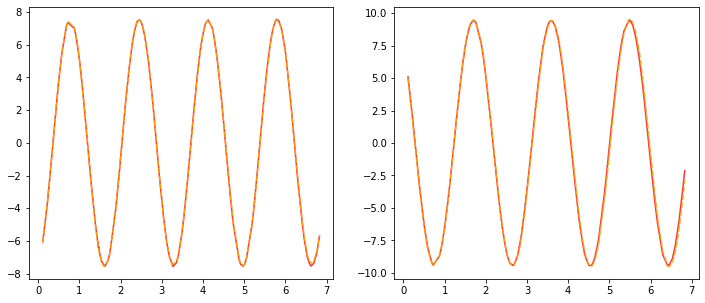

Current LR: [0.000123658698415327]


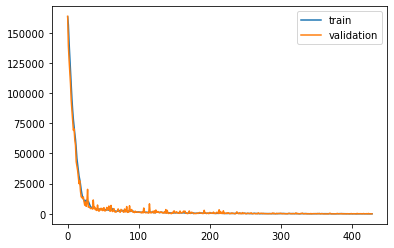

Epoch: 417, Train ELBO: 4.881, Val ELBO: -2621.319


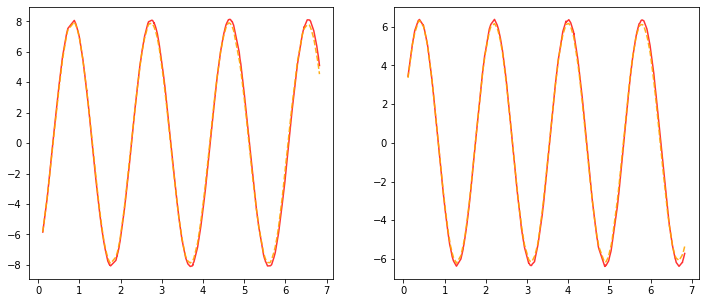

Current LR: [0.00012304040492325035]


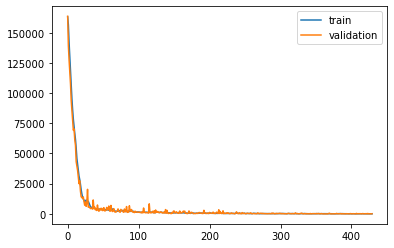

Epoch: 418, Train ELBO: 13.982, Val ELBO: -2595.469


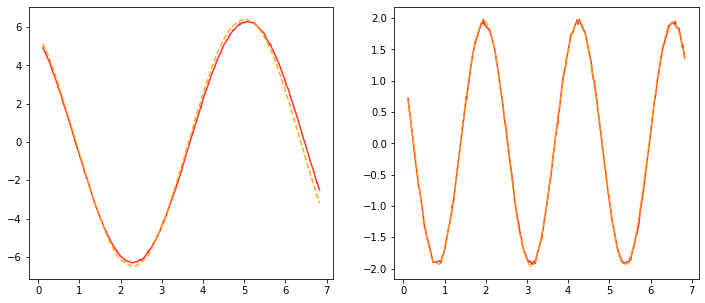

Current LR: [0.0001224252028986341]


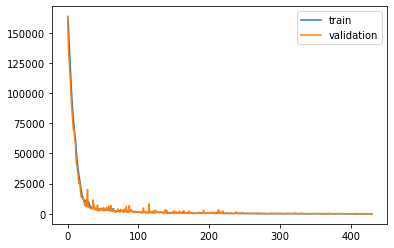

Epoch: 419, Train ELBO: 22.160, Val ELBO: -2569.271


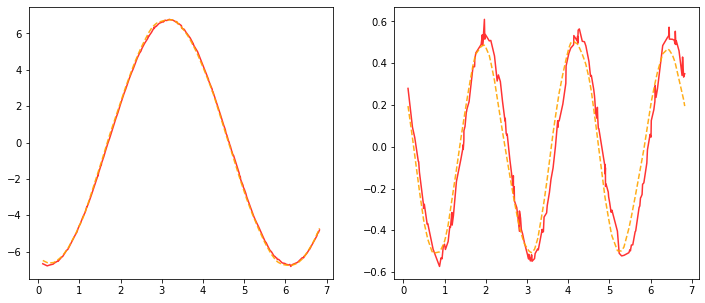

Current LR: [0.00012181307688414093]


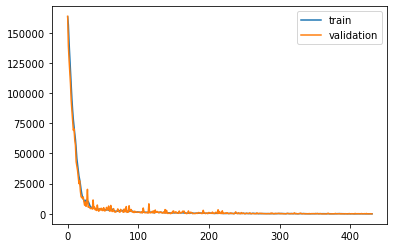

Epoch: 420, Train ELBO: 19.197, Val ELBO: -2542.732


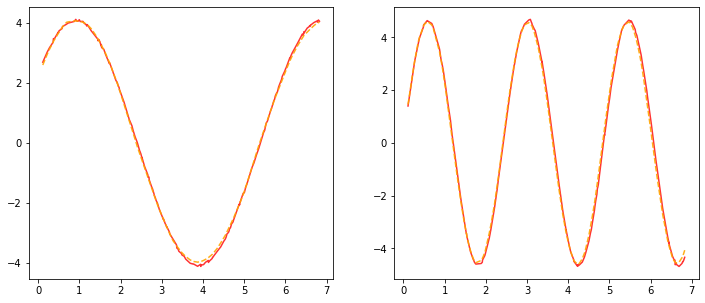

Current LR: [0.00012120401149972023]


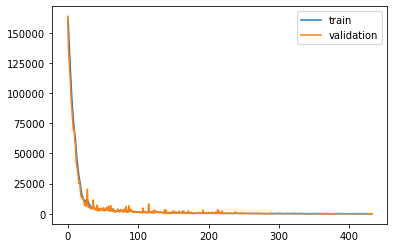

Epoch: 421, Train ELBO: 6.490, Val ELBO: -2515.957


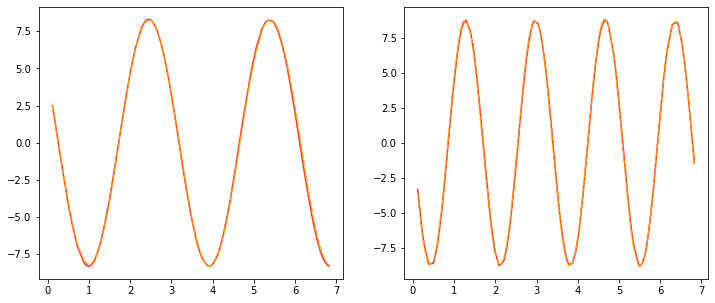

Current LR: [0.00012059799144222163]


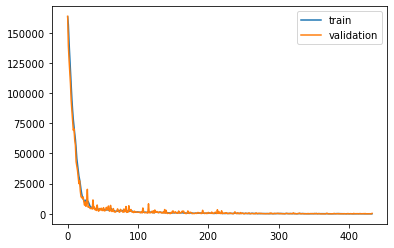

Epoch: 422, Train ELBO: 6.174, Val ELBO: -2494.098


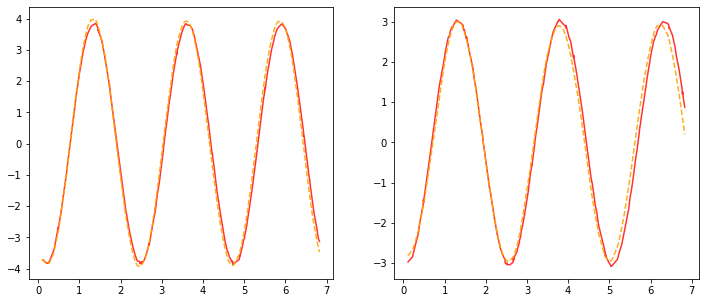

Current LR: [0.00011999500148501051]


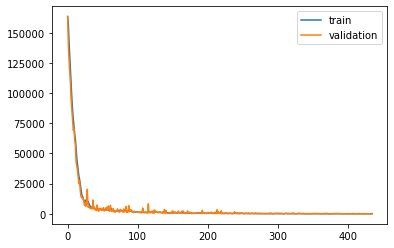

Epoch: 423, Train ELBO: 1.101, Val ELBO: -2469.136


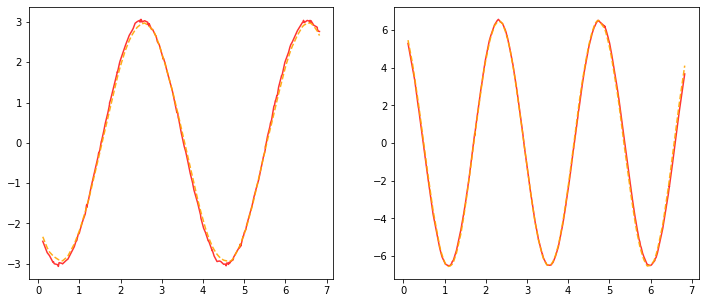

Current LR: [0.00011939502647758546]


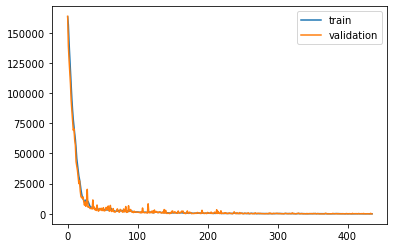

Epoch: 424, Train ELBO: 15.407, Val ELBO: -2443.105


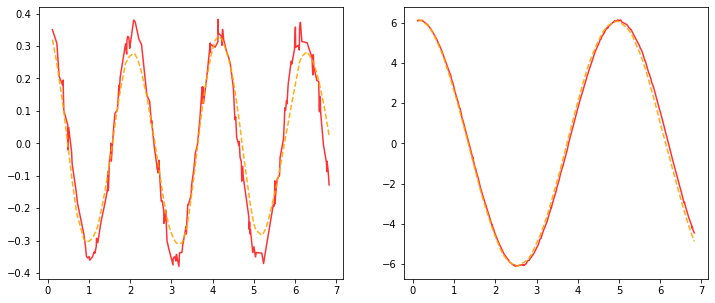

Current LR: [0.00011879805134519753]


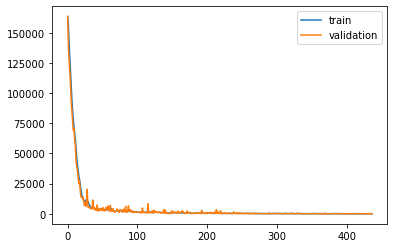

Epoch: 425, Train ELBO: 56.066, Val ELBO: -2418.931


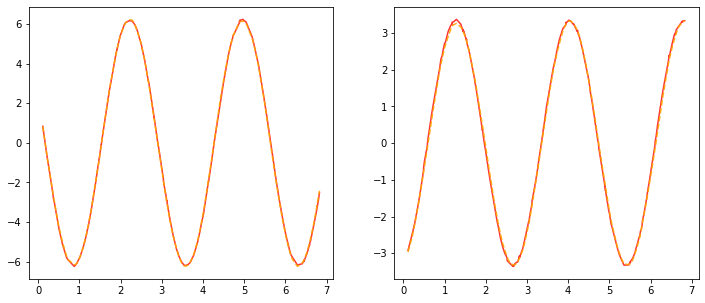

Current LR: [0.00011820406108847154]


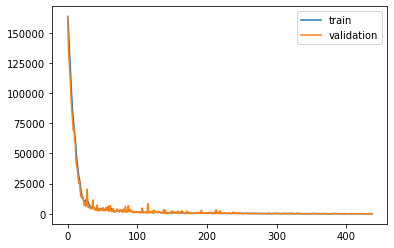

Epoch: 426, Train ELBO: 60.341, Val ELBO: -2395.352


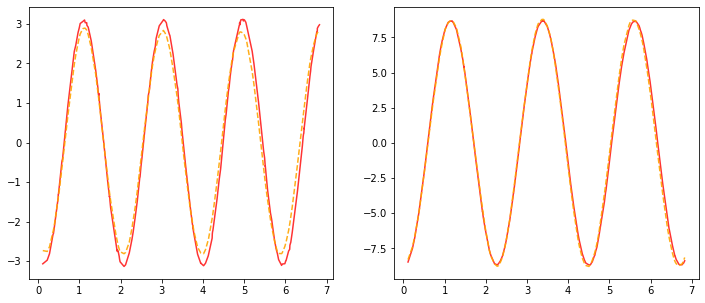

Current LR: [0.00011761304078302919]


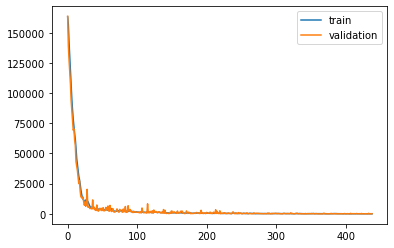

Epoch: 427, Train ELBO: 39.016, Val ELBO: -2371.933


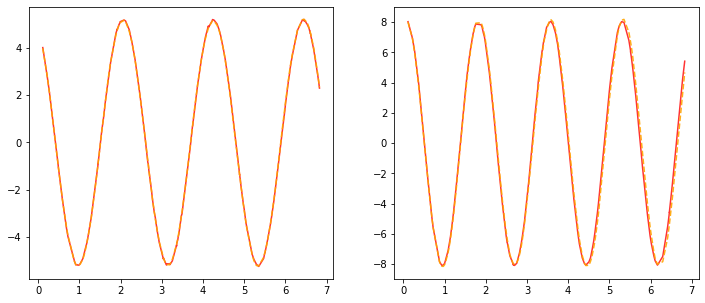

Current LR: [0.00011702497557911404]


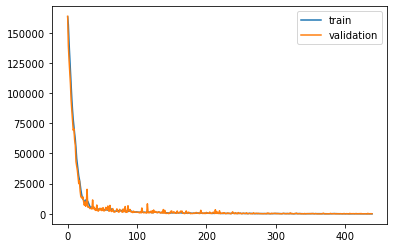

Epoch: 428, Train ELBO: 64.373, Val ELBO: -2348.141


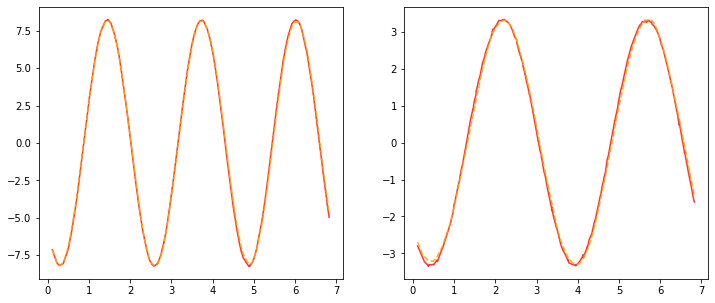

Current LR: [0.00011643985070121847]


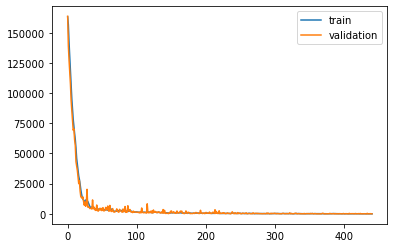

Epoch: 429, Train ELBO: 51.254, Val ELBO: -2323.952


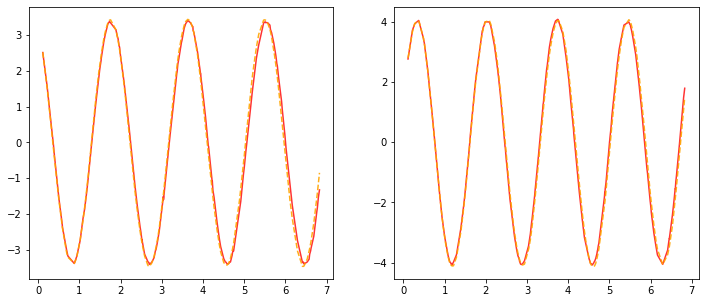

Current LR: [0.00011585765144771237]


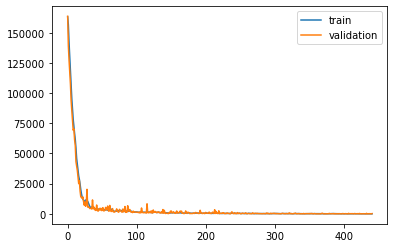

Epoch: 430, Train ELBO: 44.823, Val ELBO: -2301.936


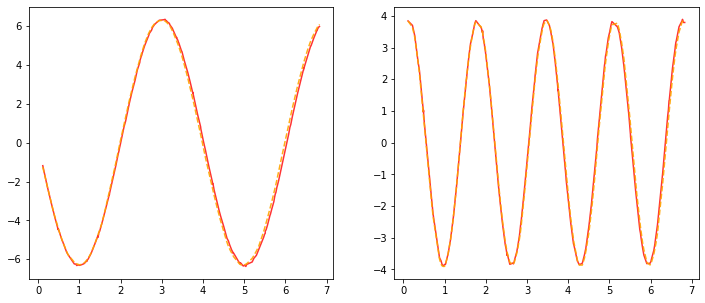

Current LR: [0.0001152783631904738]


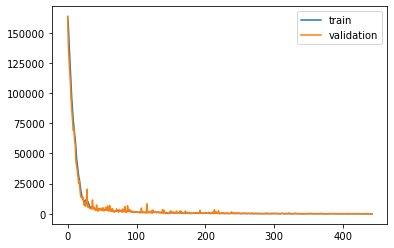

Epoch: 431, Train ELBO: 50.373, Val ELBO: -2277.931


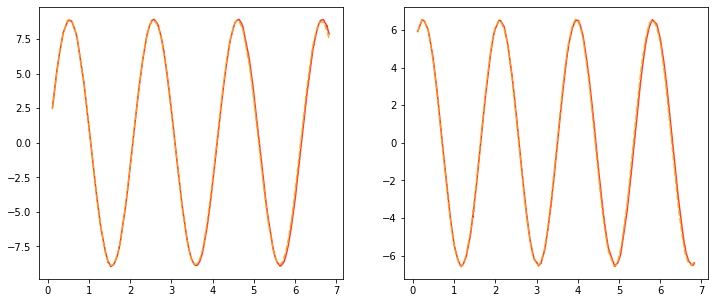

Current LR: [0.00011470197137452144]


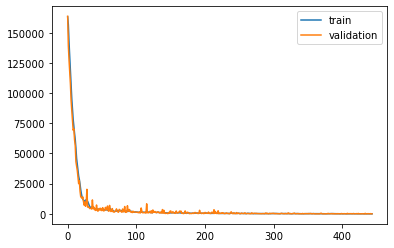

Epoch: 432, Train ELBO: 56.394, Val ELBO: -2254.849


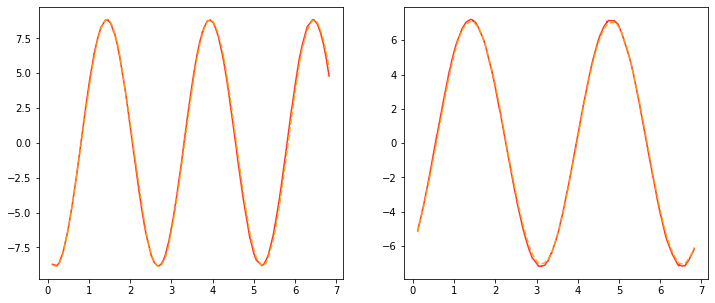

Current LR: [0.00011412846151764883]


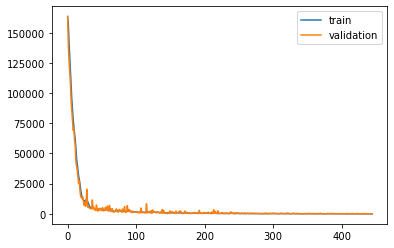

Epoch: 433, Train ELBO: 57.736, Val ELBO: -2232.206


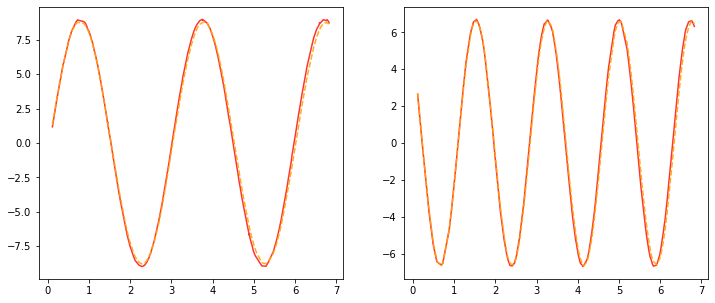

Current LR: [0.00011355781921006058]


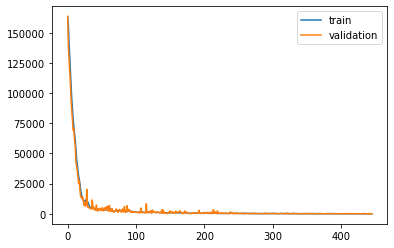

Epoch: 434, Train ELBO: 7.586, Val ELBO: -2208.803


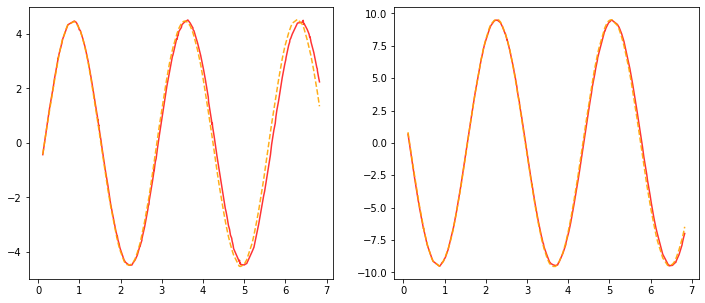

Current LR: [0.00011299003011401029]


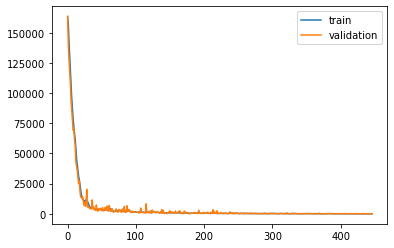

Epoch: 435, Train ELBO: 17.011, Val ELBO: -2187.380


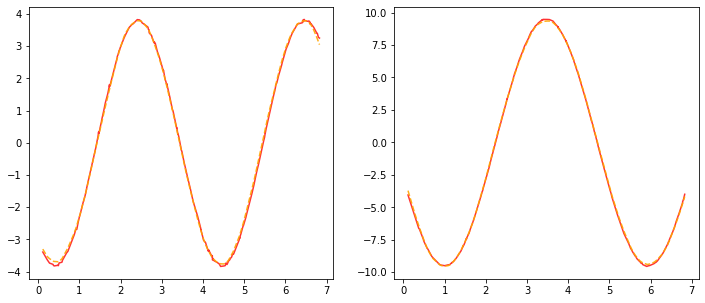

Current LR: [0.00011242507996344023]


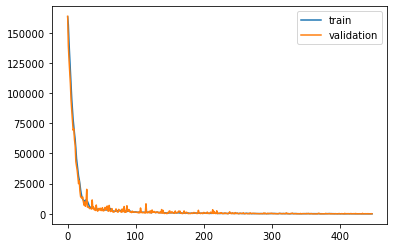

Epoch: 436, Train ELBO: 45.710, Val ELBO: -2165.269


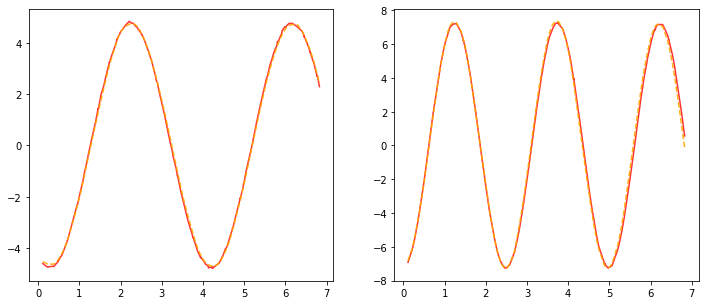

Current LR: [0.00011186295456362303]


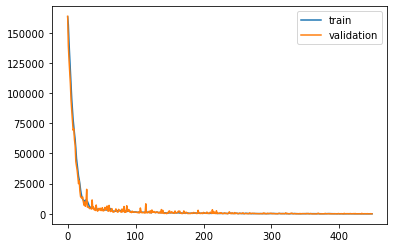

Epoch: 437, Train ELBO: 14.233, Val ELBO: -2142.858


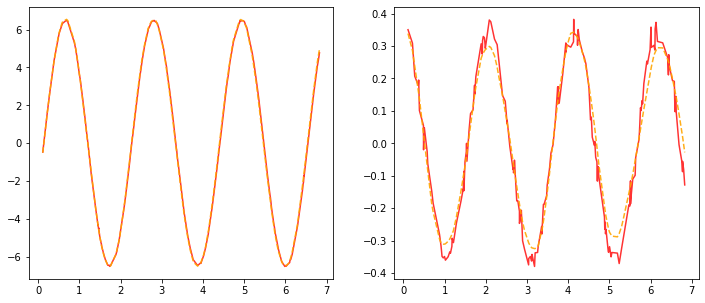

Current LR: [0.00011130363979080492]


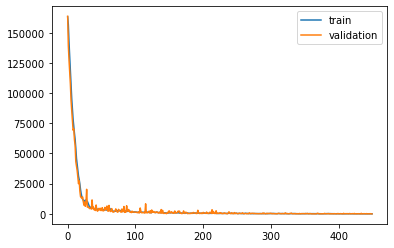

Epoch: 438, Train ELBO: 42.153, Val ELBO: -2120.117


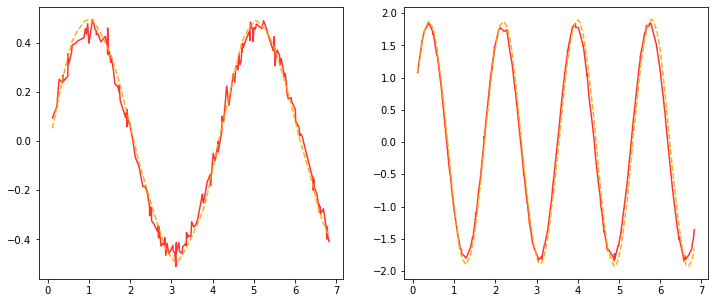

Current LR: [0.00011074712159185089]


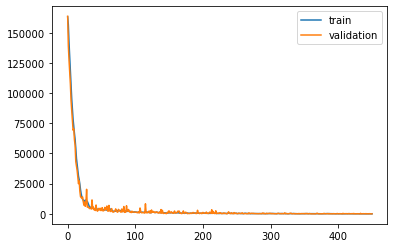

Epoch: 439, Train ELBO: 53.644, Val ELBO: -2098.659


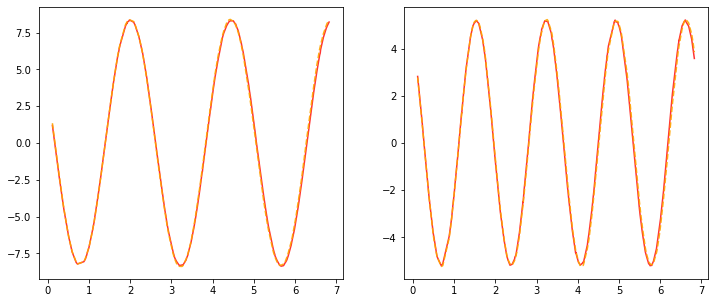

Current LR: [0.00011019338598389164]


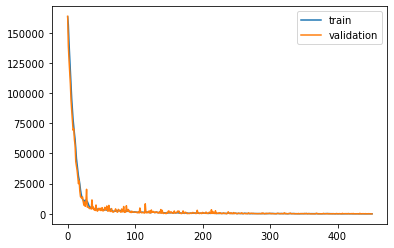

Epoch: 440, Train ELBO: 32.327, Val ELBO: -2076.229


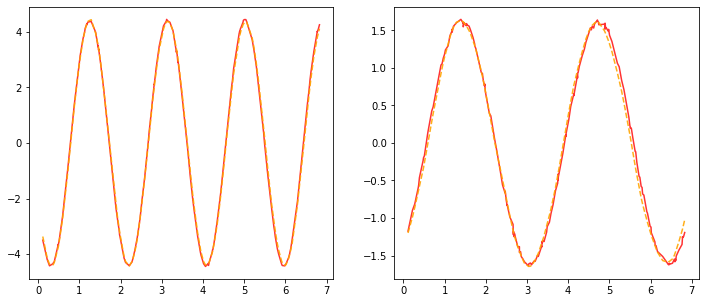

Current LR: [0.00010964241905397218]


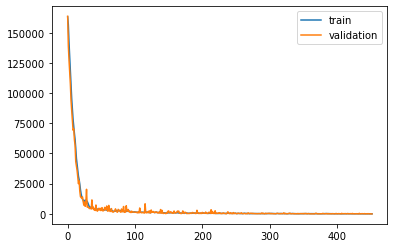

Epoch: 441, Train ELBO: 57.199, Val ELBO: -2054.105


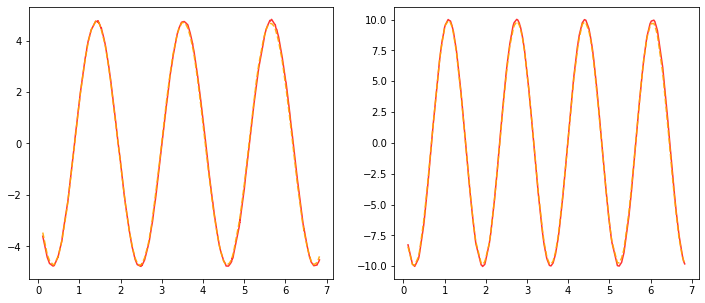

Current LR: [0.00010909420695870231]


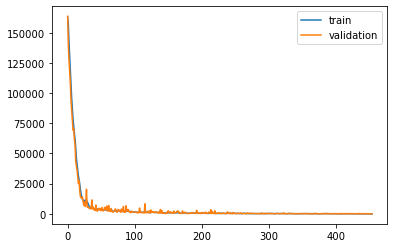

Epoch: 442, Train ELBO: 54.709, Val ELBO: -2032.413


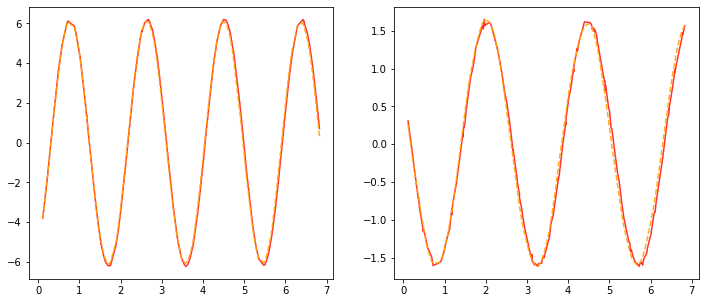

Current LR: [0.0001085487359239088]


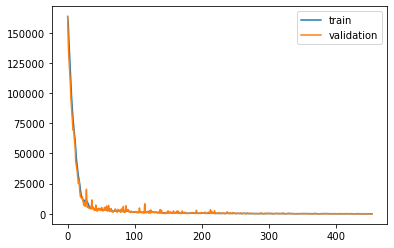

Epoch: 443, Train ELBO: 49.721, Val ELBO: -2011.244


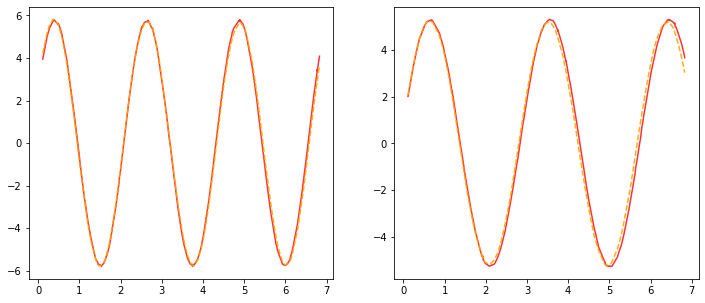

Current LR: [0.00010800599224428925]


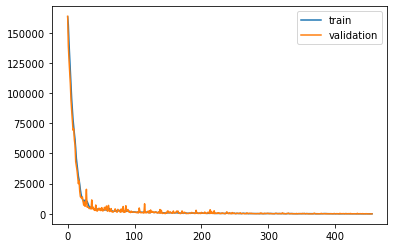

Epoch: 444, Train ELBO: 25.313, Val ELBO: -1990.374


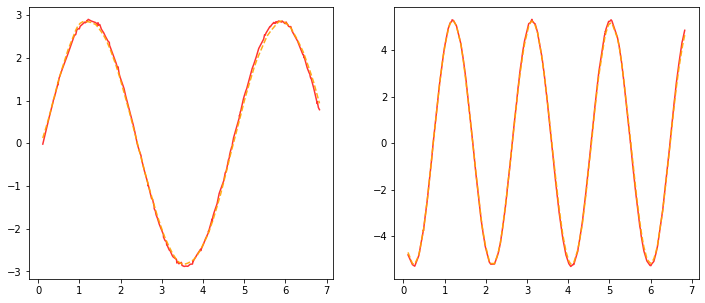

Current LR: [0.0001074659622830678]


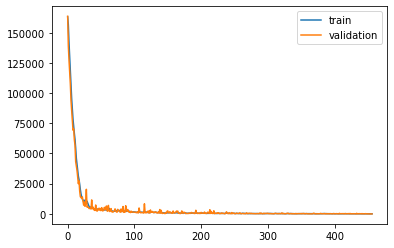

Epoch: 445, Train ELBO: 40.662, Val ELBO: -1969.126


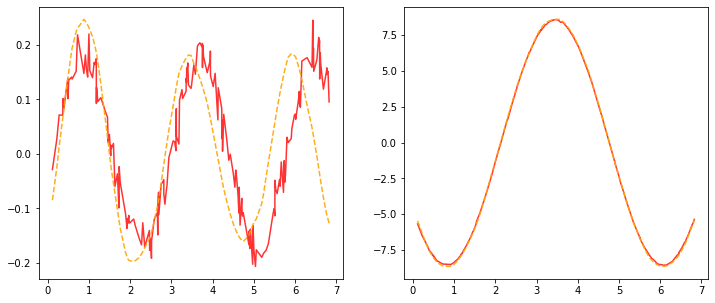

Current LR: [0.00010692863247165246]


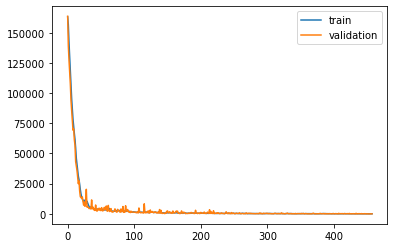

Epoch: 446, Train ELBO: 10.046, Val ELBO: -1948.807


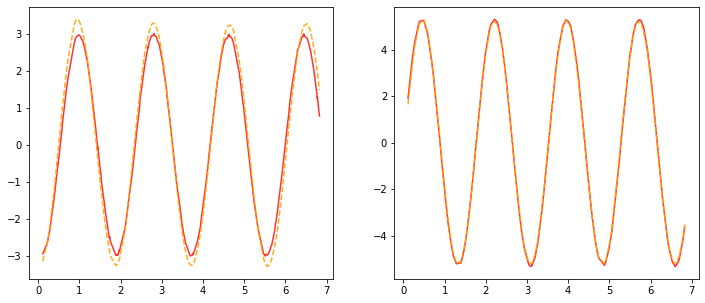

Current LR: [0.0001063939893092942]


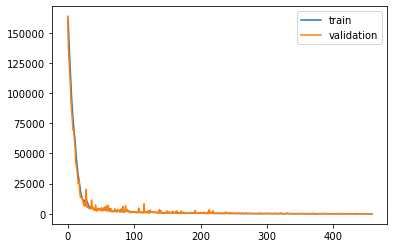

Epoch: 447, Train ELBO: 16.234, Val ELBO: -1928.278


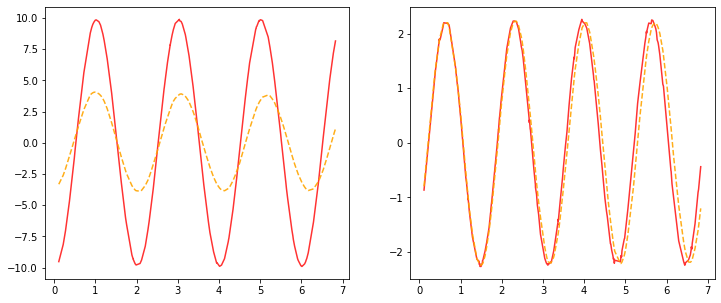

Current LR: [0.00010586201936274773]


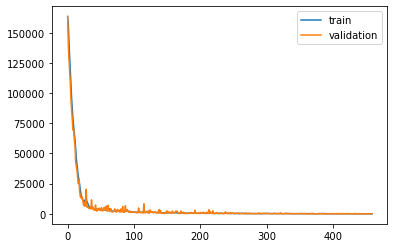

Epoch: 448, Train ELBO: 16.513, Val ELBO: -1908.711


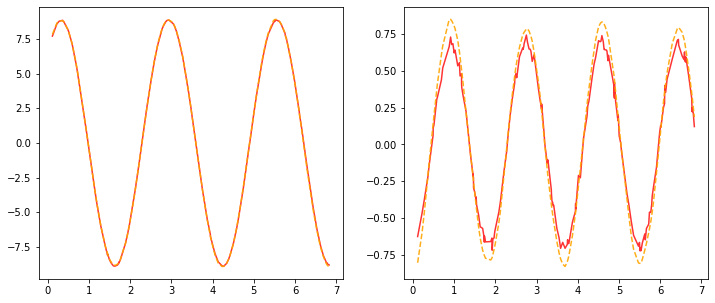

Current LR: [0.00010533270926593399]


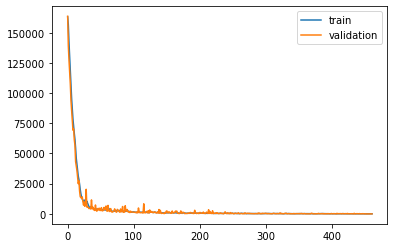

Epoch: 449, Train ELBO: 20.379, Val ELBO: -1888.551


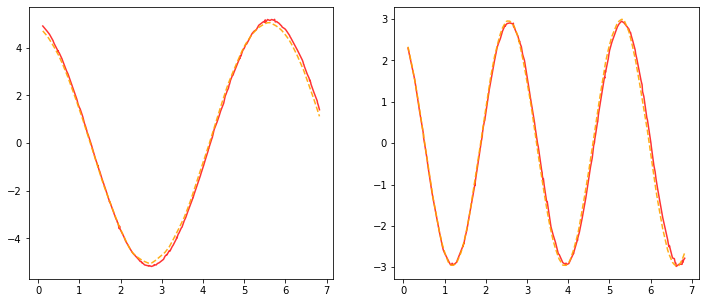

Current LR: [0.00010480604571960432]


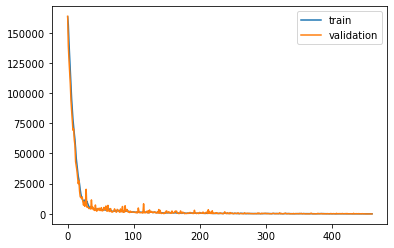

Epoch: 450, Train ELBO: 36.889, Val ELBO: -1868.362


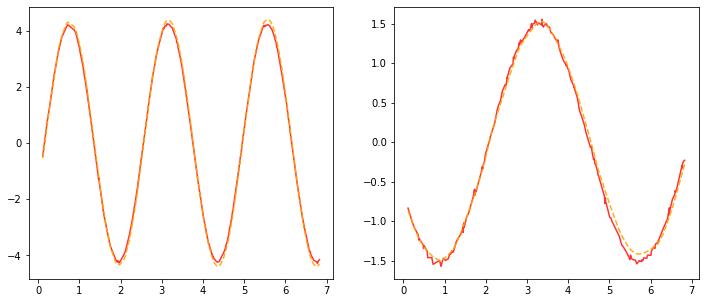

Current LR: [0.0001042820154910063]


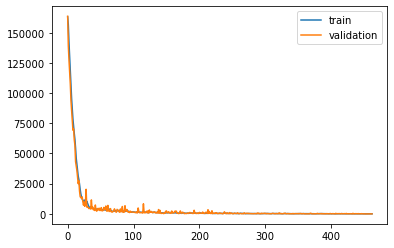

Epoch: 451, Train ELBO: 40.836, Val ELBO: -1848.684


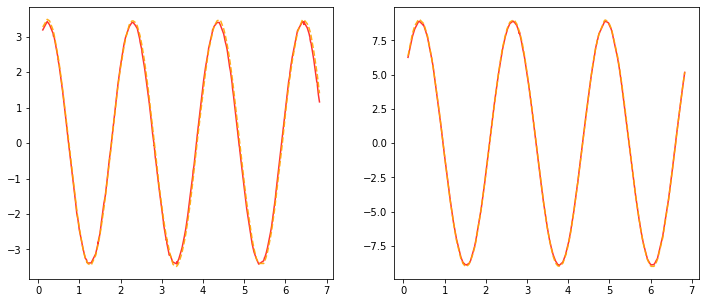

Current LR: [0.00010376060541355126]


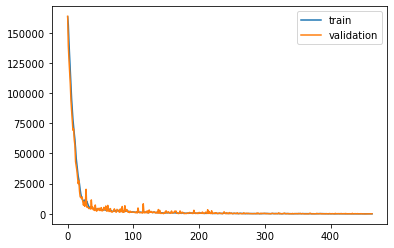

Epoch: 452, Train ELBO: 53.929, Val ELBO: -1830.082


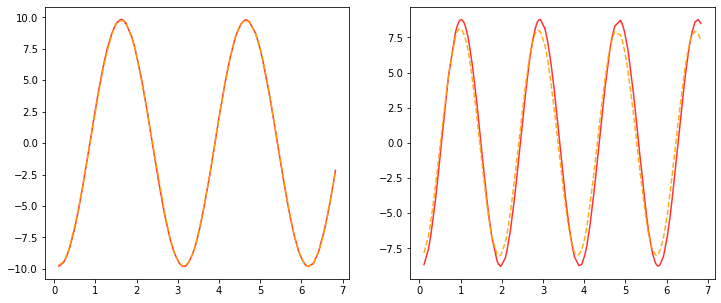

Current LR: [0.0001032418023864835]


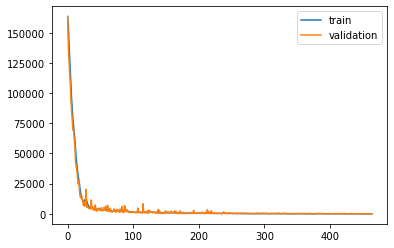

Epoch: 453, Train ELBO: 39.214, Val ELBO: -1811.160


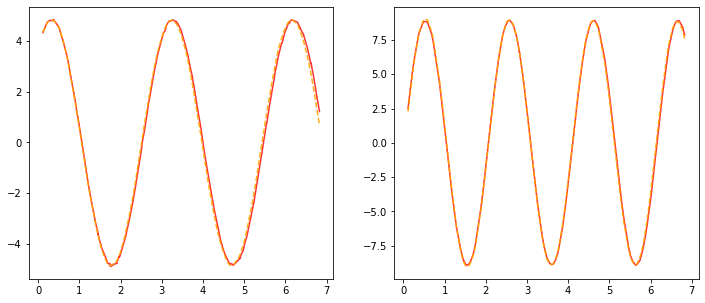

Current LR: [0.00010272559337455109]


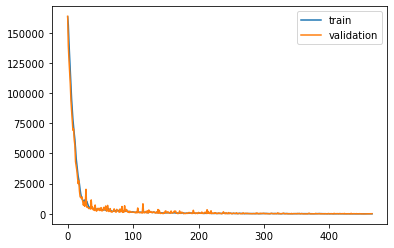

Epoch: 454, Train ELBO: 45.544, Val ELBO: -1793.425


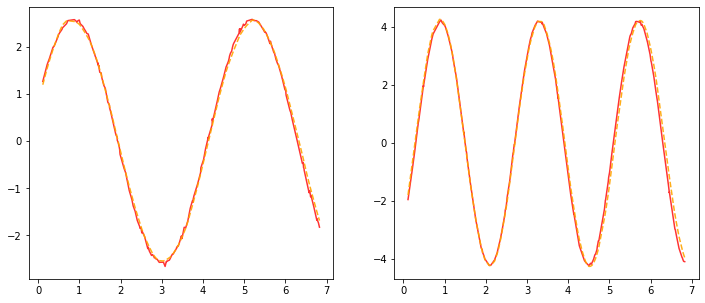

Current LR: [0.00010221196540767833]


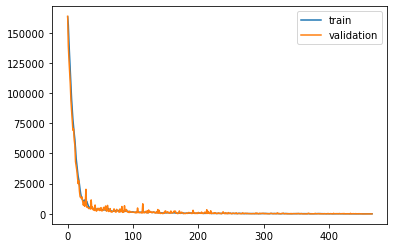

Epoch: 455, Train ELBO: 9.994, Val ELBO: -1774.466


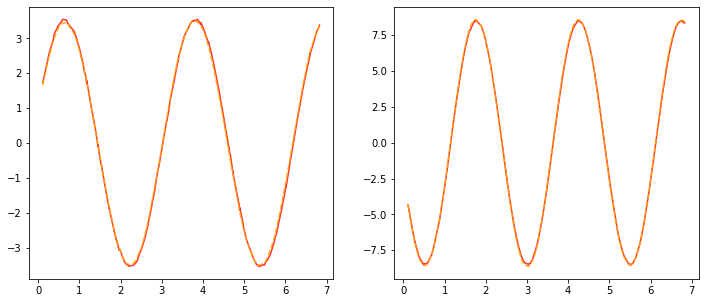

Current LR: [0.00010170090558063994]


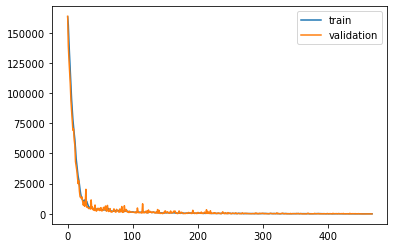

Epoch: 456, Train ELBO: 24.294, Val ELBO: -1755.263


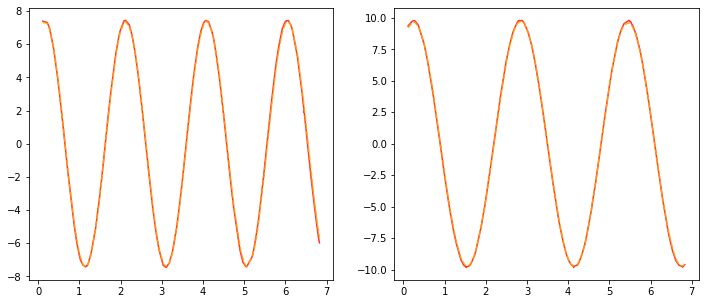

Current LR: [0.00010119240105273675]


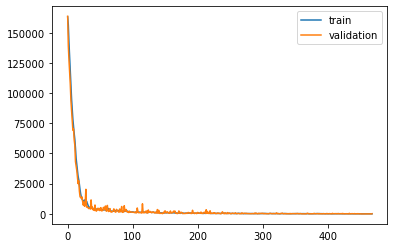

Epoch: 457, Train ELBO: 61.263, Val ELBO: -1737.873


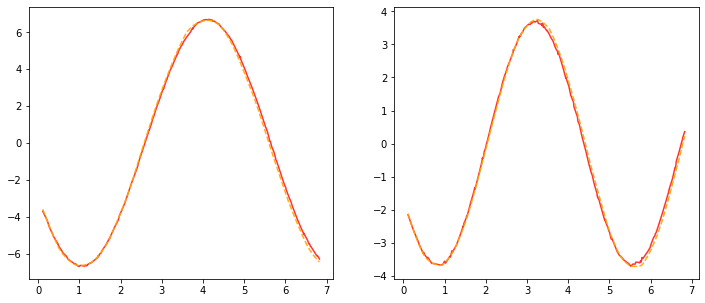

Current LR: [0.00010068643904747306]


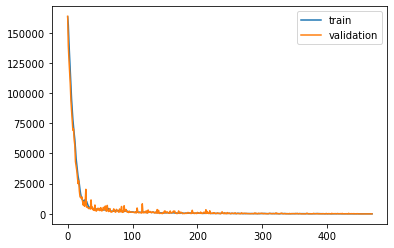

Epoch: 458, Train ELBO: 52.083, Val ELBO: -1719.113


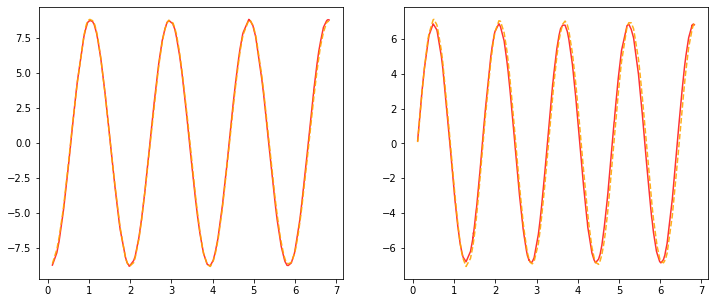

Current LR: [0.0001001830068522357]


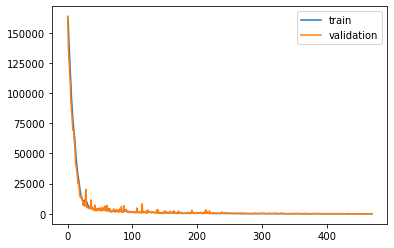

Epoch: 459, Train ELBO: 79.398, Val ELBO: -1703.513


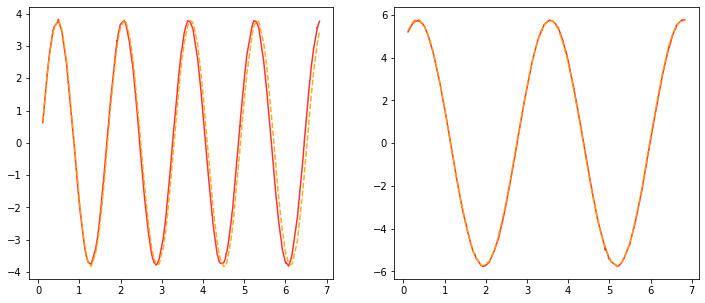

Current LR: [9.968209181797451e-05]


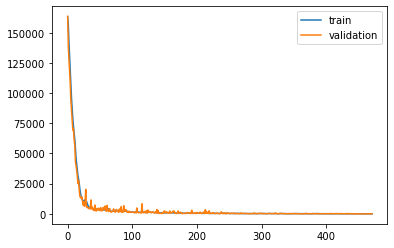

Epoch: 460, Train ELBO: 45.259, Val ELBO: -1685.790


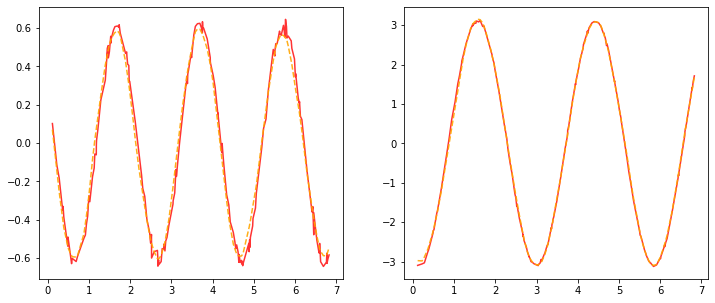

Current LR: [9.918368135888464e-05]


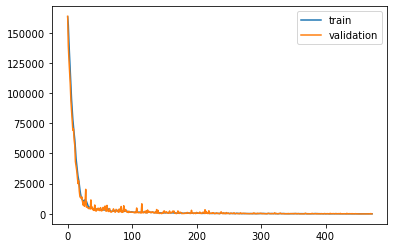

Epoch: 461, Train ELBO: 29.377, Val ELBO: -1667.676


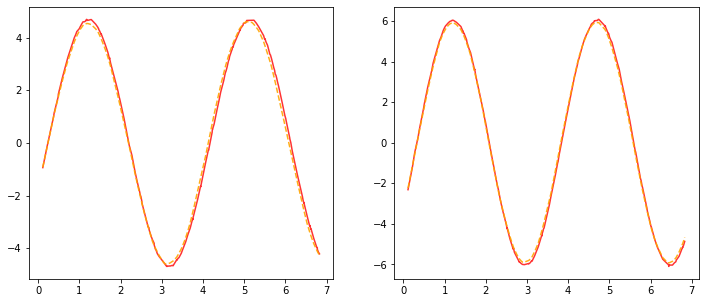

Current LR: [9.868776295209022e-05]


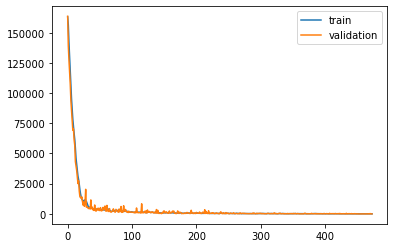

Epoch: 462, Train ELBO: 65.280, Val ELBO: -1649.621


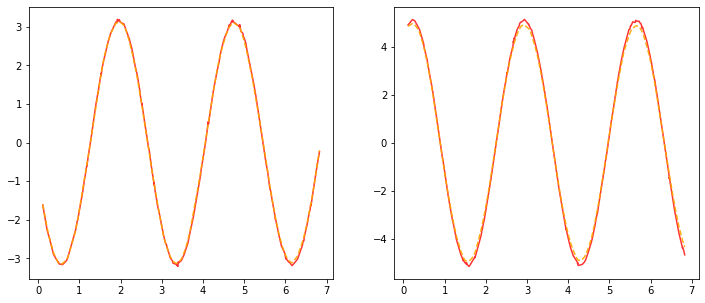

Current LR: [9.819432413732977e-05]


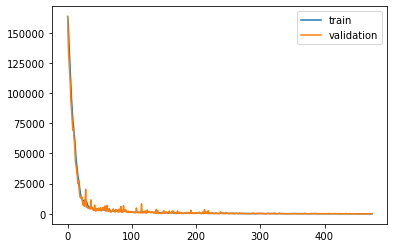

Epoch: 463, Train ELBO: 70.546, Val ELBO: -1633.825


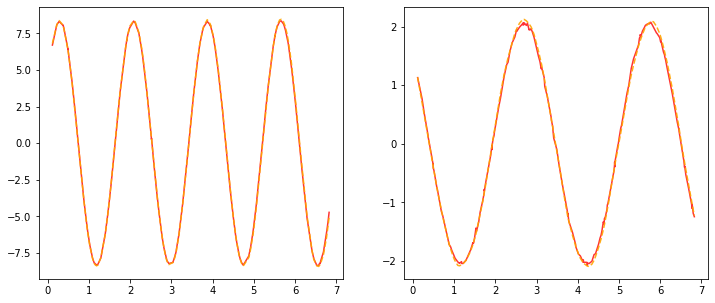

Current LR: [9.770335251664312e-05]


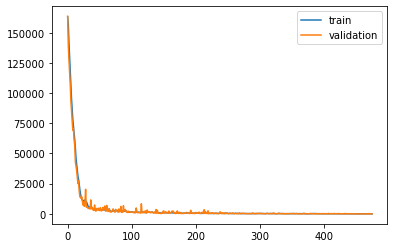

Epoch: 464, Train ELBO: 76.866, Val ELBO: -1616.219


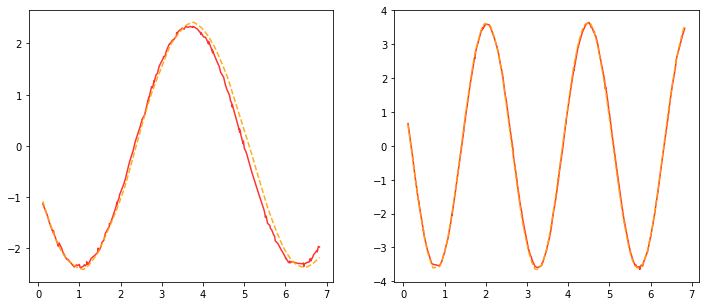

Current LR: [9.72148357540599e-05]


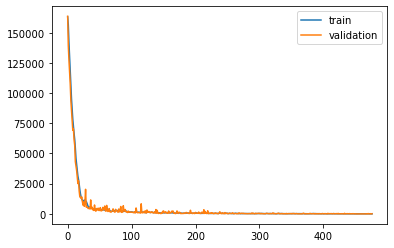

Epoch: 465, Train ELBO: 73.242, Val ELBO: -1599.999


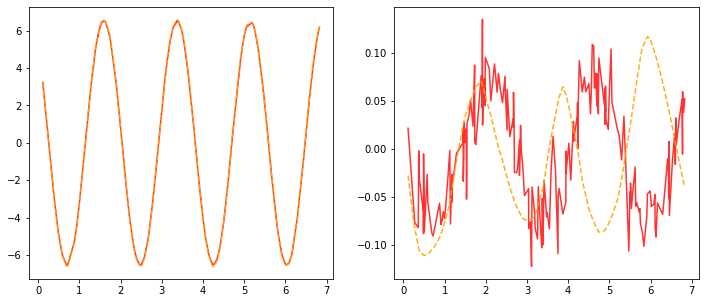

Current LR: [9.672876157528961e-05]


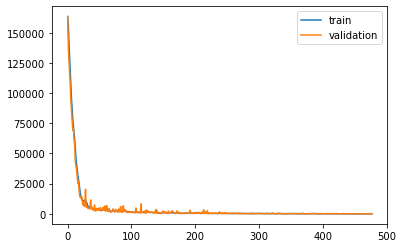

Epoch: 466, Train ELBO: 63.150, Val ELBO: -1584.315


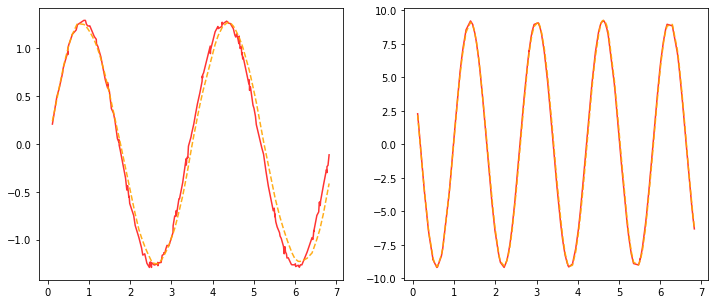

Current LR: [9.624511776741316e-05]


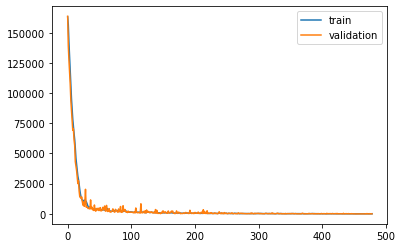

Epoch: 467, Train ELBO: -5.179, Val ELBO: -1567.308


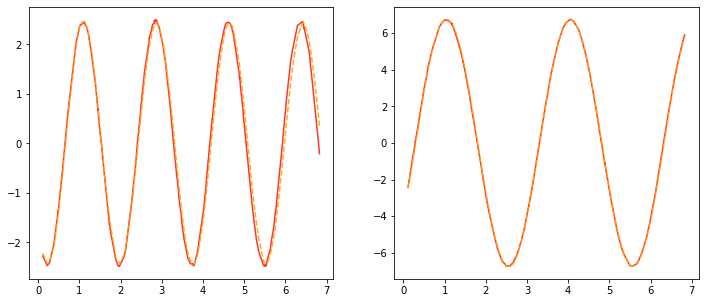

Current LR: [9.576389217857609e-05]


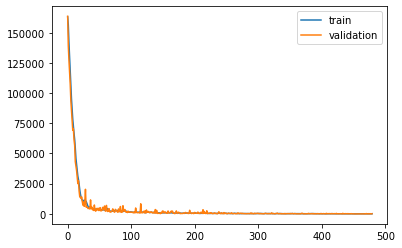

Epoch: 468, Train ELBO: -7.427, Val ELBO: -1551.754


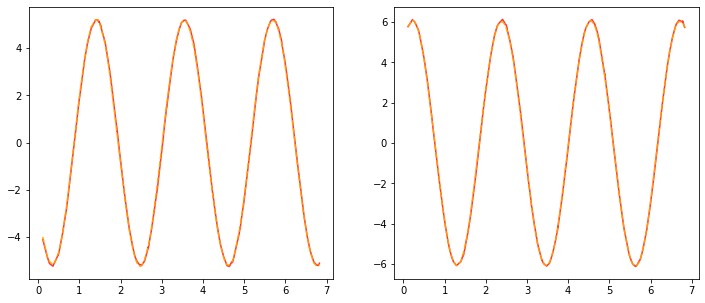

Current LR: [9.528507271768321e-05]


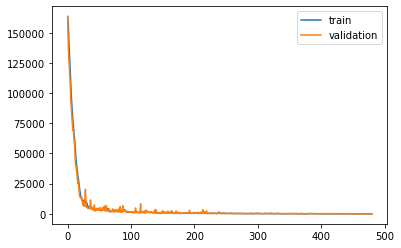

Epoch: 469, Train ELBO: -0.279, Val ELBO: -1536.683


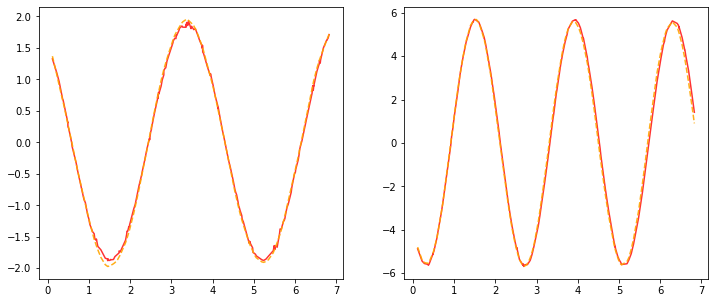

Current LR: [9.48086473540948e-05]


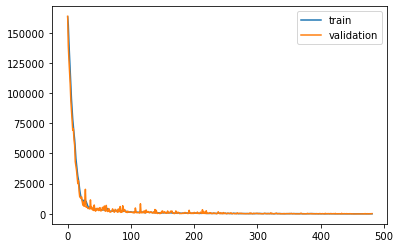

Epoch: 470, Train ELBO: 45.917, Val ELBO: -1522.063


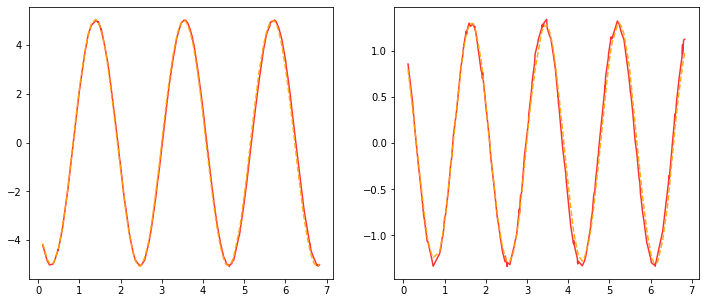

Current LR: [9.433460411732433e-05]


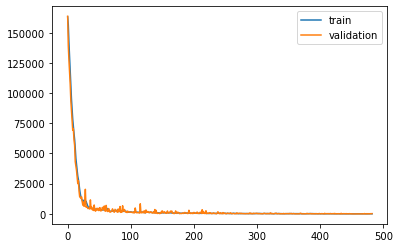

Epoch: 471, Train ELBO: 50.845, Val ELBO: -1507.695


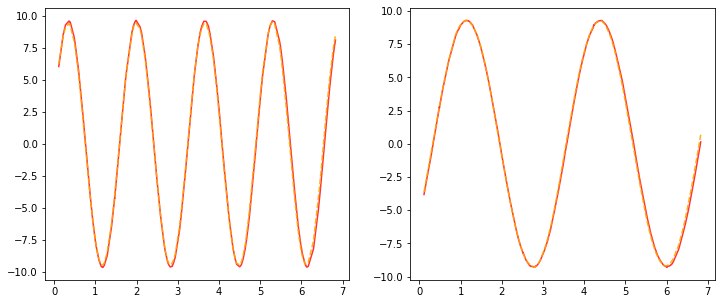

Current LR: [9.38629310967377e-05]


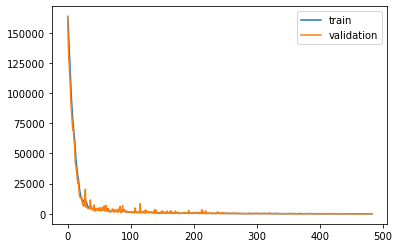

Epoch: 472, Train ELBO: 83.046, Val ELBO: -1491.155


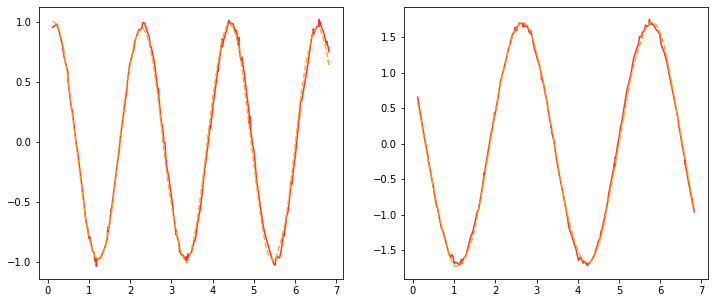

Current LR: [9.339361644125402e-05]


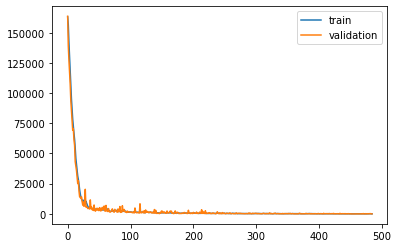

Epoch: 473, Train ELBO: 68.419, Val ELBO: -1475.327


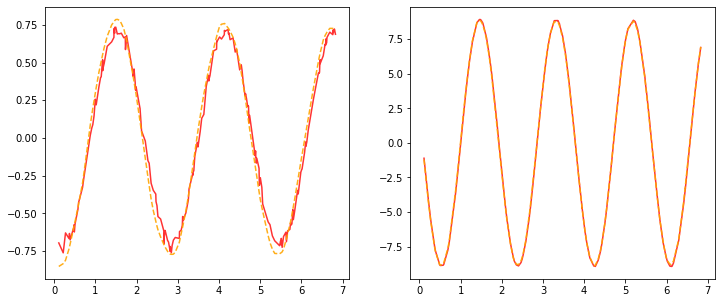

Current LR: [9.292664835904775e-05]


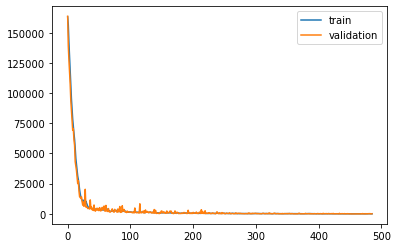

Epoch: 474, Train ELBO: 55.728, Val ELBO: -1460.612


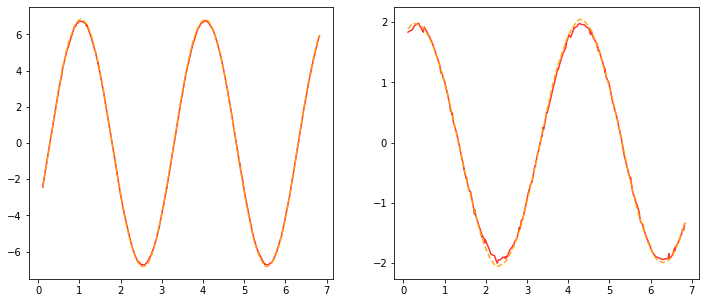

Current LR: [9.246201511725251e-05]


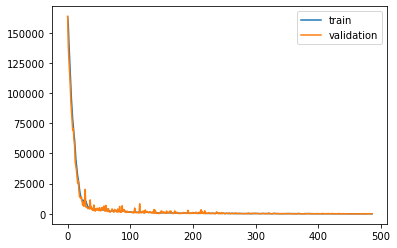

Epoch: 475, Train ELBO: 89.856, Val ELBO: -1445.453


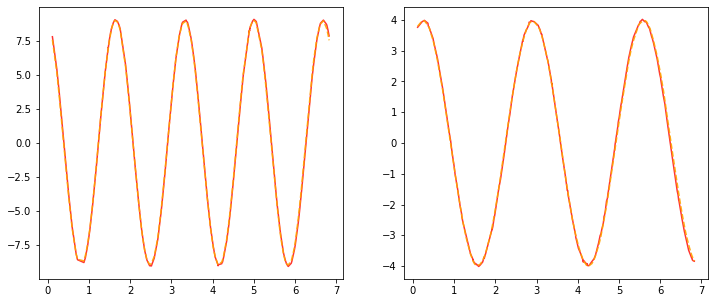

Current LR: [9.199970504166626e-05]


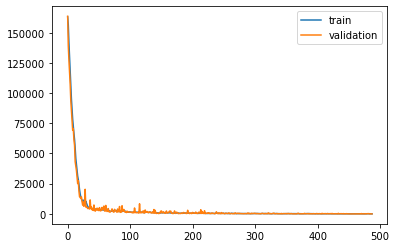

Epoch: 476, Train ELBO: 76.620, Val ELBO: -1429.585


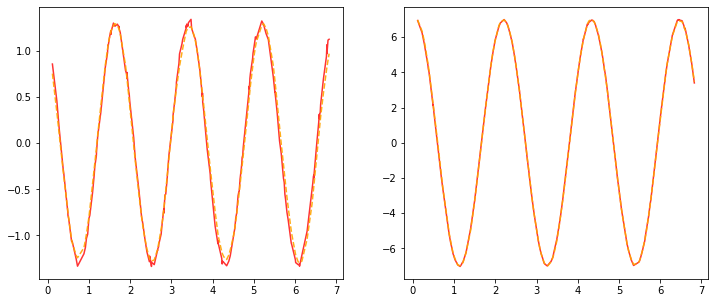

Current LR: [9.153970651645792e-05]


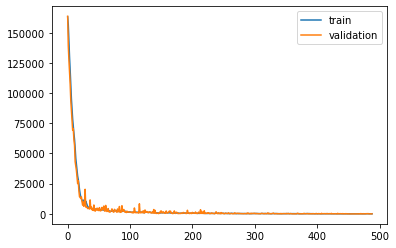

Epoch: 477, Train ELBO: 46.771, Val ELBO: -1414.935


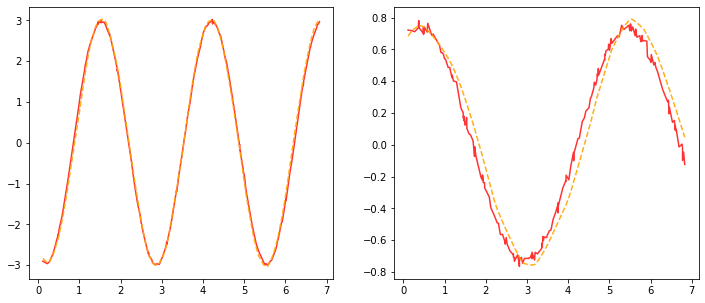

Current LR: [9.108200798387562e-05]


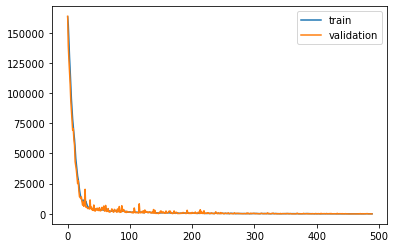

Epoch: 478, Train ELBO: 42.201, Val ELBO: -1399.401


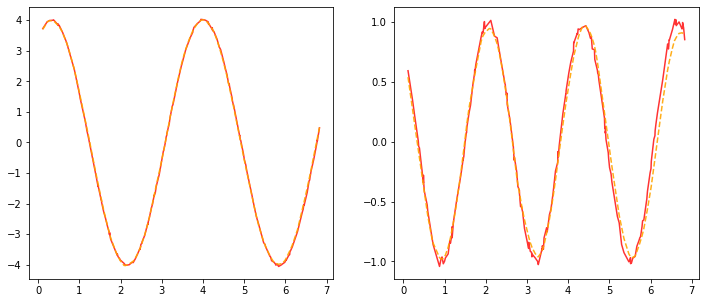

Current LR: [9.062659794395624e-05]


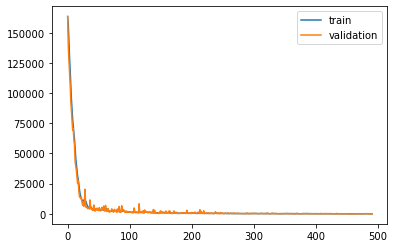

Epoch: 479, Train ELBO: 73.908, Val ELBO: -1383.826


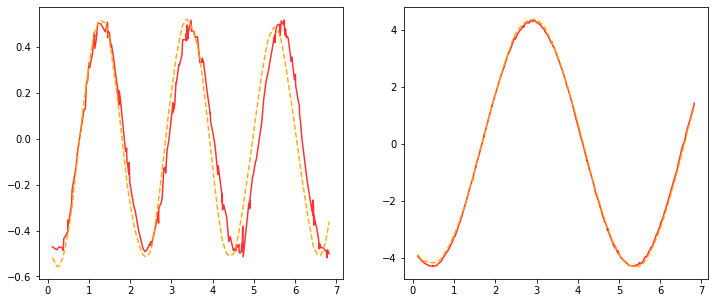

Current LR: [9.017346495423645e-05]


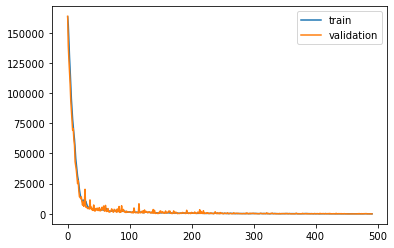

Epoch: 480, Train ELBO: 78.053, Val ELBO: -1368.958


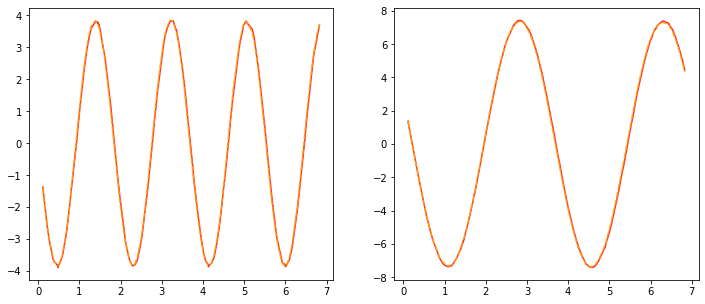

Current LR: [8.972259762946528e-05]


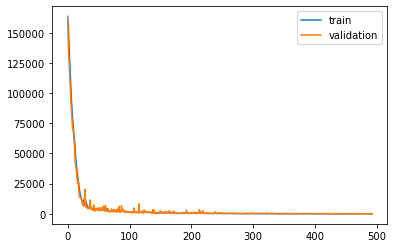

Epoch: 481, Train ELBO: 61.926, Val ELBO: -1354.382


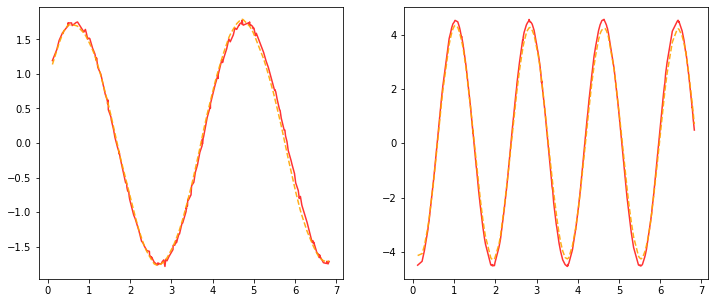

Current LR: [8.927398464131795e-05]


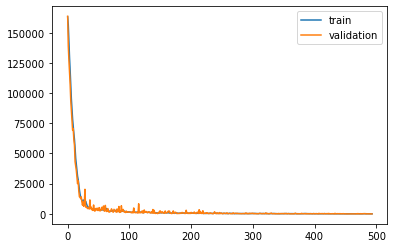

Epoch: 482, Train ELBO: 63.119, Val ELBO: -1339.353


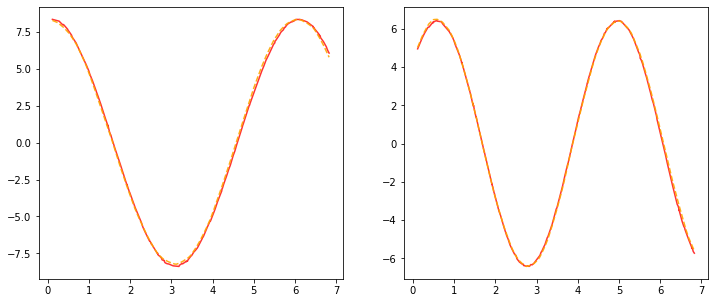

Current LR: [8.882761471811137e-05]


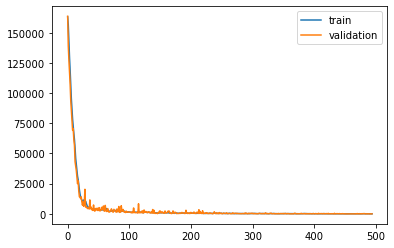

Epoch: 483, Train ELBO: 68.766, Val ELBO: -1325.337


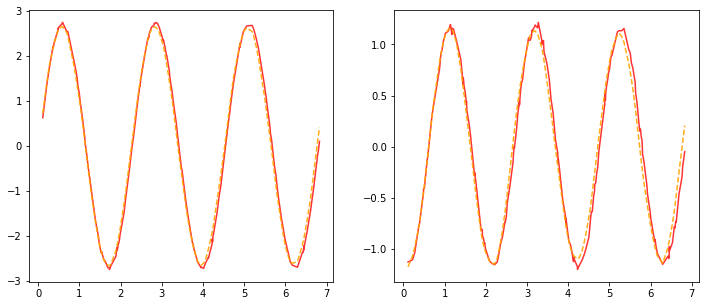

Current LR: [8.83834766445208e-05]


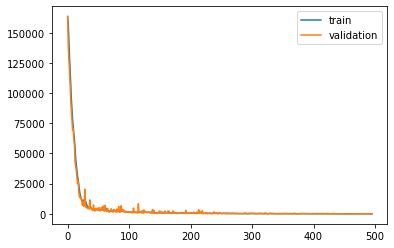

Epoch: 484, Train ELBO: 79.322, Val ELBO: -1312.356


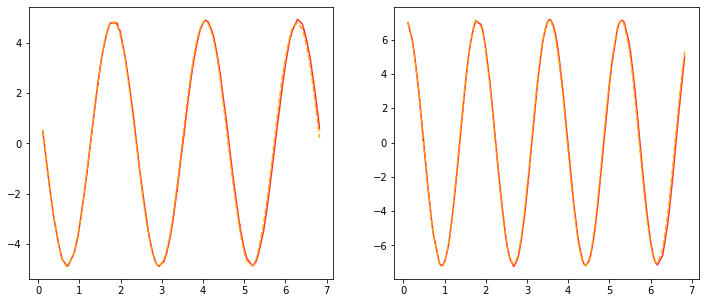

Current LR: [8.79415592612982e-05]


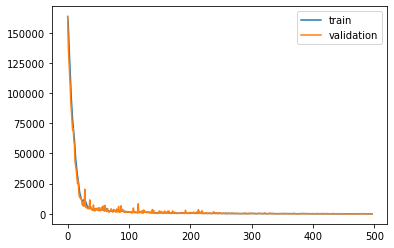

Epoch: 485, Train ELBO: 72.778, Val ELBO: -1297.897


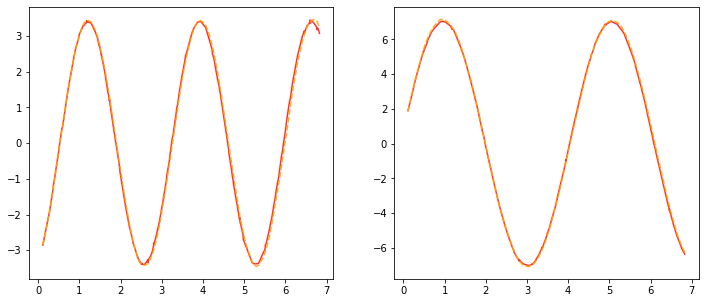

Current LR: [8.750185146499171e-05]


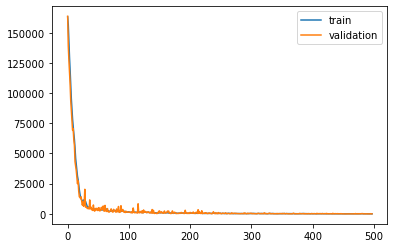

Epoch: 486, Train ELBO: 80.719, Val ELBO: -1284.119


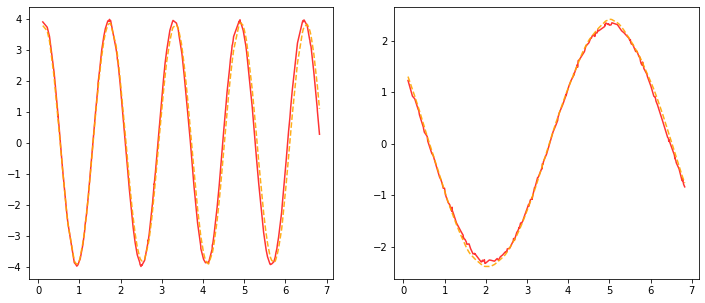

Current LR: [8.706434220766675e-05]


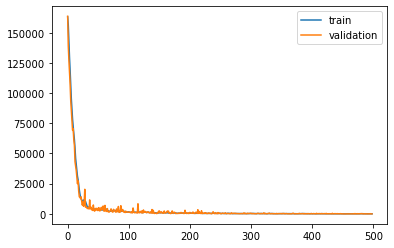

Epoch: 487, Train ELBO: 49.161, Val ELBO: -1270.106


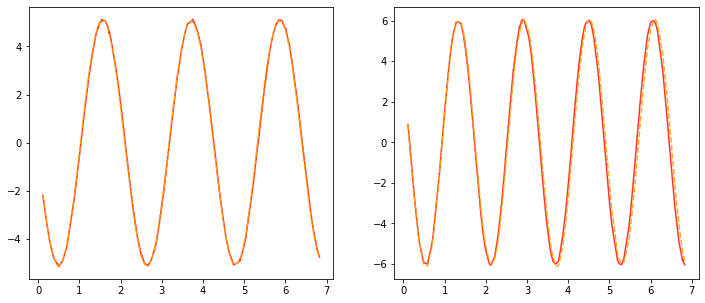

Current LR: [8.662902049662842e-05]


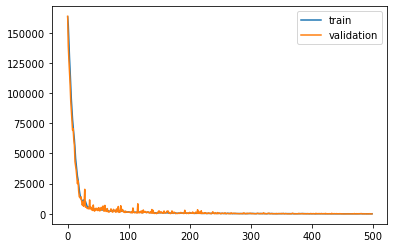

Epoch: 488, Train ELBO: 13.637, Val ELBO: -1256.117


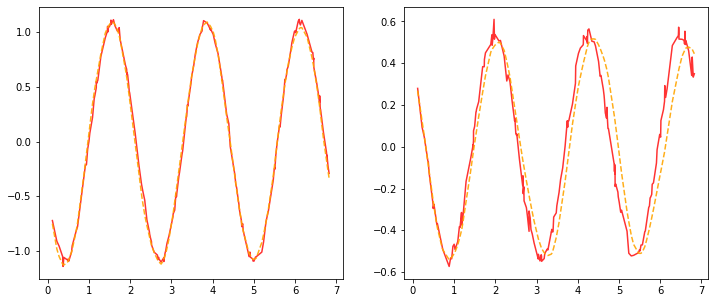

Current LR: [8.619587539414527e-05]


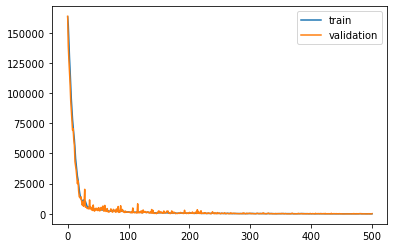

Epoch: 489, Train ELBO: 37.589, Val ELBO: -1243.996


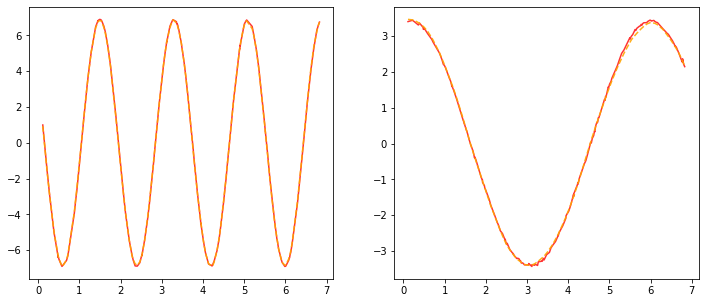

Current LR: [8.576489601717455e-05]


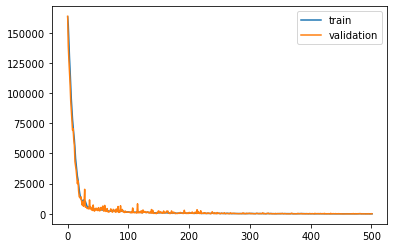

Epoch: 490, Train ELBO: 61.573, Val ELBO: -1231.228


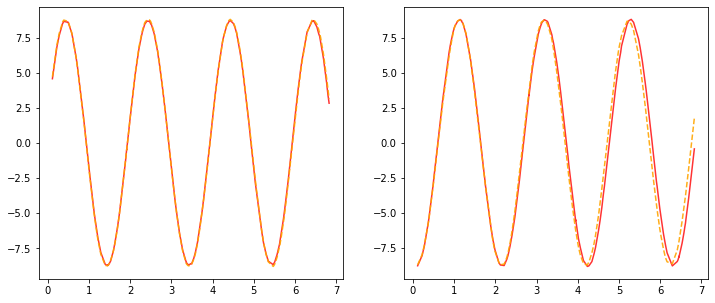

Current LR: [8.533607153708867e-05]


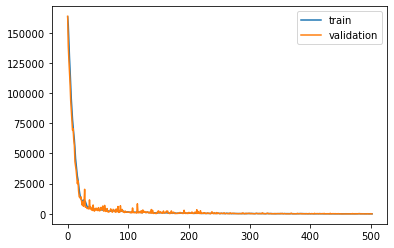

Epoch: 491, Train ELBO: 83.389, Val ELBO: -1217.439


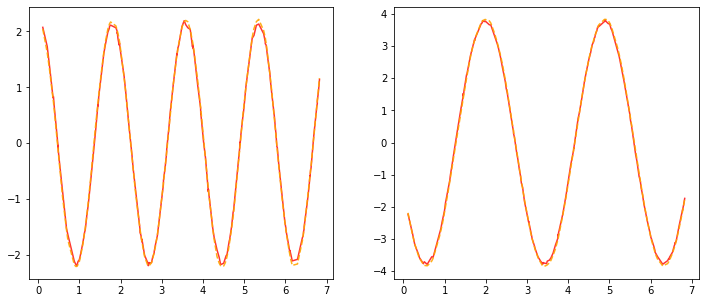

Current LR: [8.490939117940322e-05]


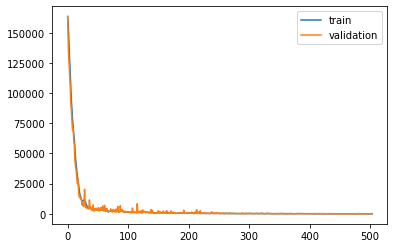

Epoch: 492, Train ELBO: 76.444, Val ELBO: -1205.264


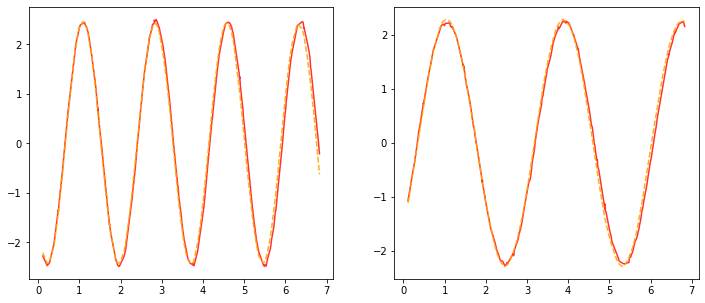

Current LR: [8.44848442235062e-05]


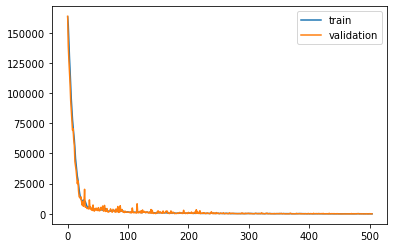

Epoch: 493, Train ELBO: 83.669, Val ELBO: -1192.021


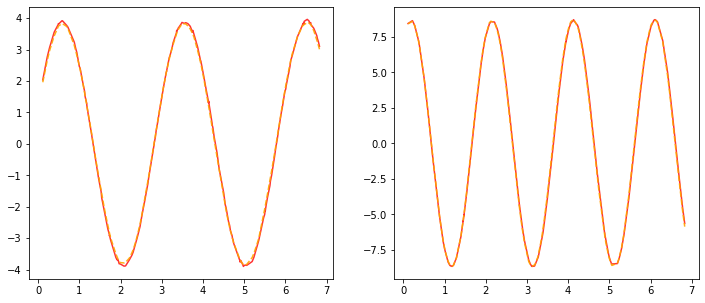

Current LR: [8.406242000238867e-05]


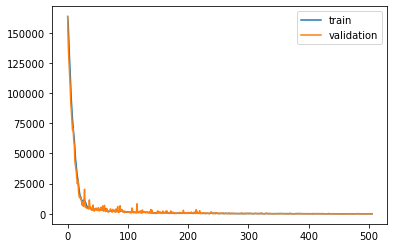

Epoch: 494, Train ELBO: 75.413, Val ELBO: -1179.963


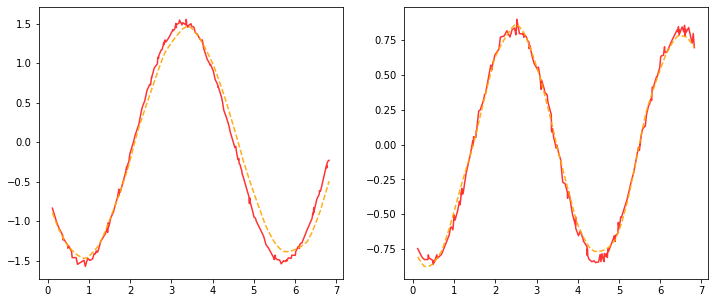

Current LR: [8.364210790237673e-05]


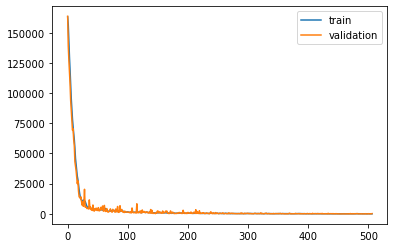

Epoch: 495, Train ELBO: 87.340, Val ELBO: -1169.059


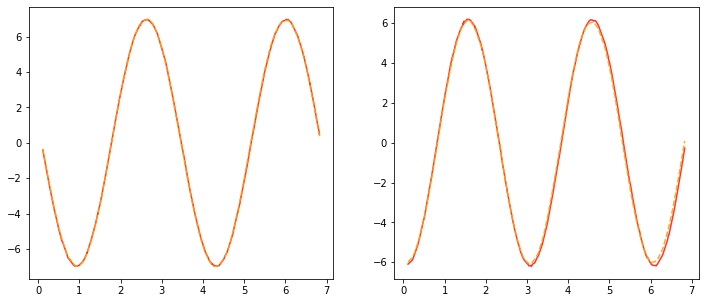

Current LR: [8.322389736286484e-05]


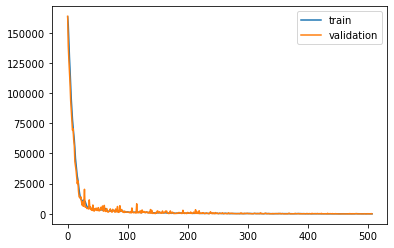

Epoch: 496, Train ELBO: 84.964, Val ELBO: -1156.196


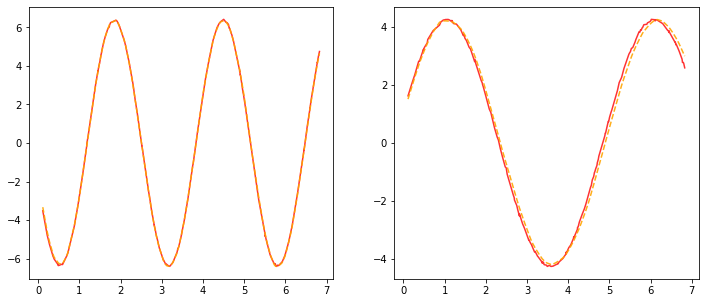

Current LR: [8.280777787605051e-05]


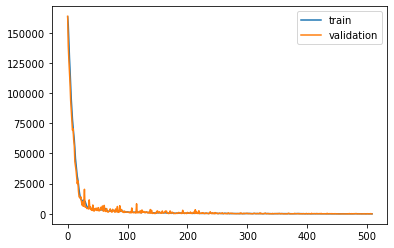

Epoch: 497, Train ELBO: 82.454, Val ELBO: -1143.241


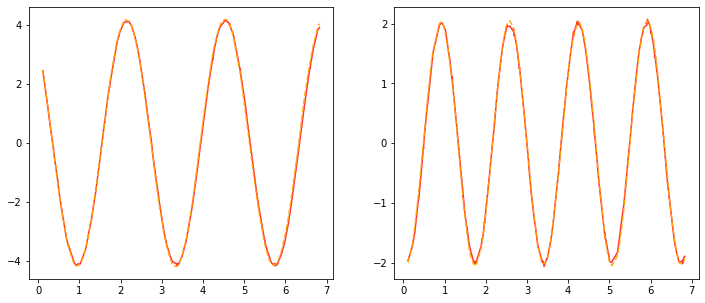

Current LR: [8.239373898667026e-05]


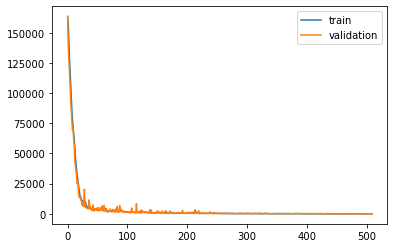

Epoch: 498, Train ELBO: 86.359, Val ELBO: -1130.738


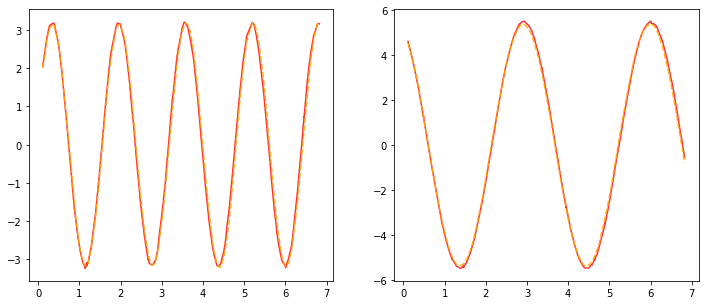

Current LR: [8.19817702917369e-05]


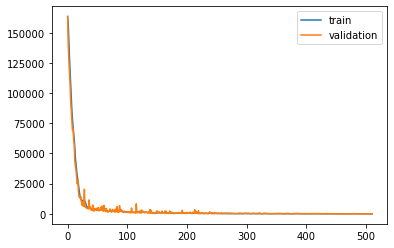

Epoch: 499, Train ELBO: 85.341, Val ELBO: -1118.705


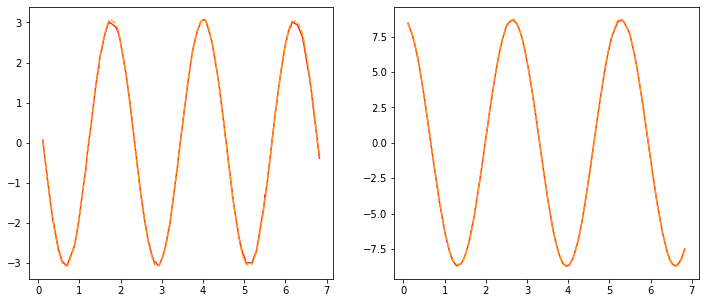

Current LR: [8.157186144027822e-05]


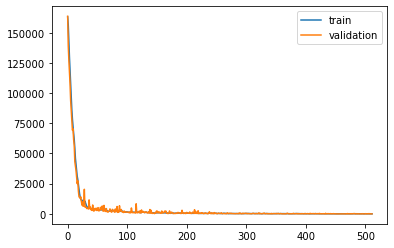

Epoch: 500, Train ELBO: 84.147, Val ELBO: -1106.443


In [12]:
main.train(optimizer, train_args, scheduler, plt_traj=True, plt_loss=True)

In [21]:
torch.save({
    'model_state_dict': model.state_dict(),
    'optimizer_state_dict': optimizer.state_dict(),
    'data_path': data_path,
    'model_args': model_args,
    'train_args': train_args,
    'train_obj': main,
}, '../models/sine_iwlatode_{}'.format(datetime.now()))